# All NASDAQ ANALYSIS

In [1]:
#libraries
import pandas as pd
import numpy as np
import mplfinance as mpf
import matplotlib.pyplot as plt
import talib as ta
import seaborn as sns
from datetime import datetime
sns.set_theme()

pd.set_option('display.max_columns', None);pd.set_option('display.max_rows', None)

In [2]:
def plot_with_mpl(root,tick,day=60,sty='classic',typ='candle'):
    "returns the candle stick of a stock tick for the given root file."

    df=pd.read_csv(root+'/'+tick+'.csv').tail(day)
    df['Date']=df['Date'].apply(lambda x:x.split()[0])

    df['rsi']=ta.RSI(df['Close']);df['sma-5']=ta.SMA(df['Close'],5);df['sma-10']=ta.SMA(df['Close'],10)
    #df.fillna(0,inplace=True)
    apds = [ 
         mpf.make_addplot((df['rsi']),panel=1,color='r',secondary_y=True,type='line',width=0.5),
         #mpf.make_addplot((df['sma-5']),color='g',type='line',width=0.2),
         #mpf.make_addplot((df['sma-10']),color='r',type='line',width=0.2)
       ]
    df.Volume=df.Volume/10**6              #100k volume
    df.Date=pd.to_datetime(df.Date)
    df.set_index('Date',inplace=True)
    fig,axes=mpf.plot(df,type=typ,mav=(5,21),volume=True,tight_layout=False,figratio=(90,36),figscale=1,
                    style=sty,returnfig=True,addplot=apds,scale_width_adjustment=dict(volume=0.5,candle=0.8,lines=0.4))
    axes[0].legend([" "," ","5-SMA","21-SMA"],loc='upper center')
    #axes[0].legend(loc='upper left')
    axes[0].set_title(tick)
    mpf.show()

def make_clickable(url, name):
    return '{}" rel="noopener noreferrer" target="_blank">{}'.format(url,name)

#df['link'] = df.apply(lambda x: make_clickable(x['url'], x['name']), axis=1)

In [3]:


def compare_bars(temp_df,rows=30,title=""):
    choose=['TICKER','CP','VOL','%CHG','%ATR']
    plot_df=temp_df[choose].sort_values(by='CP',ascending=True).reset_index(drop=True,).head(rows)
    columns=plot_df.columns.to_list()
    x=columns[0];y=columns[1:]
    today=datetime.now().strftime("%m/%d/%Y")
    f, axs = plt.subplots(2, 2, figsize=(16, 10), gridspec_kw=dict(width_ratios=[4, 4]))
    cols=axs.flat
    for i,j in enumerate(y):
        g=sns.barplot(data=plot_df,x=x,y=y[i],ax=cols[i])
        for item in g.get_xticklabels():
            item.set_rotation(90)
            item.set_fontsize(10)
            item.set_fontweight('bold')
        for i in g.containers:
            g.bar_label(i,rotation=90,fontsize=10,fontweight='bold',color='b',padding=5)
    f.suptitle(f"{title.upper()} {today}")   
    f.tight_layout()
    f.savefig(title+'.pdf')
    #f.show()

In [4]:
#re-set index
def reset_index(df):
    df.index=np.arange(1,df.shape[0]+1)
    return df

def highlight_max(s):
    '''
    highlight the maximum in a Series yellow.
    '''
    is_max = s == s.max()
    return ['background-color: yellow' if v else '' for v in is_max]


def highlight_min(s):
    '''
    highlight the minimum in a Series yellow.
    '''
    is_min = s == s.min()
    return ['background-color: red' if v else '' for v in is_min]

def color_negative_red(val):
    """
    Takes a scalar and returns a string with
    the css property `'color: red'` for negative
    strings, black otherwise.
    """
    color = 'red' if val < 0 else 'black'
    return 'color: %s' % color

In [5]:
dff=pd.read_csv('/home/thakur/test/sector/XLF.csv')#,index_col='Date')
dff.tail()


,Date,Open,High,Low,Close,Adj Close,Volume
246,2022-11-09 00:00:00-05:00,34.22,34.35,33.80,33.87,33.87,42126200
247,2022-11-10 00:00:00-05:00,34.90,35.63,34.81,35.58,35.58,67677700
248,2022-11-11 00:00:00-05:00,35.76,36.03,35.63,35.87,35.87,46072200
249,2022-11-14 00:00:00-05:00,35.77,35.80,35.33,35.36,35.36,38002700
250,2022-11-15 00:00:00-05:00,35.74,35.87,35.08,35.44,35.44,57266910


In [6]:
sectors=['Technology', 'Health Care', 'Consumer Discretionary', 'Finance',
'Energy', 'Consumer Staples', 'Industrials', 'Utilities',
       'Real Estate', 'Telecommunications', 'Miscellaneous',
       'Basic Materials']

In [7]:
#all sectors
#df.style.highlight_max(color = 'lightgreen', axis = 0)

df_sector=pd.read_csv('/home/thakur/test/combined/all_sectors.csv')
st_df=pd.read_csv("/home/thakur/stock_information/sectors.csv")  #11 sectors
st_list=st_df["TICKER"].to_list()
df_sector['SECTOR']=st_df.SECTOR.to_list()
df_sector['SECTOR'] = df_sector['SECTOR'].apply(lambda x:x.replace(' ', '_'))
df_sector['%ATR']=round(100*df_sector['AVG10ATR']/df_sector['CP'],2)
df_sector=df_sector.sort_values(by='RSI',ascending=False)
df_sector=reset_index(df_sector)

#df_sector.style.apply(highlight_max)

# df_sector.style.\
#     applymap(color_negative_red).\
#     format("{:.2}")
df_sector

,TICKER,CP,HH,HL,LH,LL,HC,RSI,SMA5,SMA21,SMA50,SMA200,VOL,AVGVOL,%CHG,AVG10ATR,SECTOR,%ATR
1,XLB,81.02,False,False,False,True,False,69.25,79.95,74.98,72.98,79.47,7.23,66.95,-0.15,1.95,Materials,2.41
2,XLI,99.60,False,False,False,True,False,69.04,98.64,93.68,90.31,94.37,10.51,97.81,0.69,2.04,Industrials,2.05
3,XLE,94.08,False,False,False,False,False,66.44,91.87,89.34,82.69,78.06,25.74,247.98,1.05,2.38,Energy,2.53
4,XLF,35.44,False,False,False,True,False,64.19,35.22,33.69,32.69,34.69,57.27,471.14,0.23,0.74,Financials,2.09
5,XLP,73.55,False,True,False,False,False,61.14,73.10,71.54,70.46,73.68,15.06,147.19,0.84,1.23,Consumer_Staples,1.67
6,XLK,133.60,True,True,False,False,False,60.81,130.12,125.55,125.61,139.14,6.36,72.02,1.21,3.81,Technology,2.85
7,XLRE,38.18,False,False,True,False,False,59.20,37.88,36.26,37.13,42.68,9.59,77.28,1.25,0.97,Real_Estate,2.54
8,XLV,133.08,False,False,False,False,False,59.06,133.14,130.64,127.34,130.15,8.18,97.41,-0.13,2.40,Healthcare,1.80
9,XLC,50.56,True,True,False,False,False,57.53,49.02,48.61,49.72,58.43,8.97,78.84,1.49,1.39,Communication_Serives,2.75
10,XLU,68.01,False,False,True,True,False,54.77,67.59,65.95,68.27,70.95,13.54,130.31,1.10,1.58,Utilities,2.32


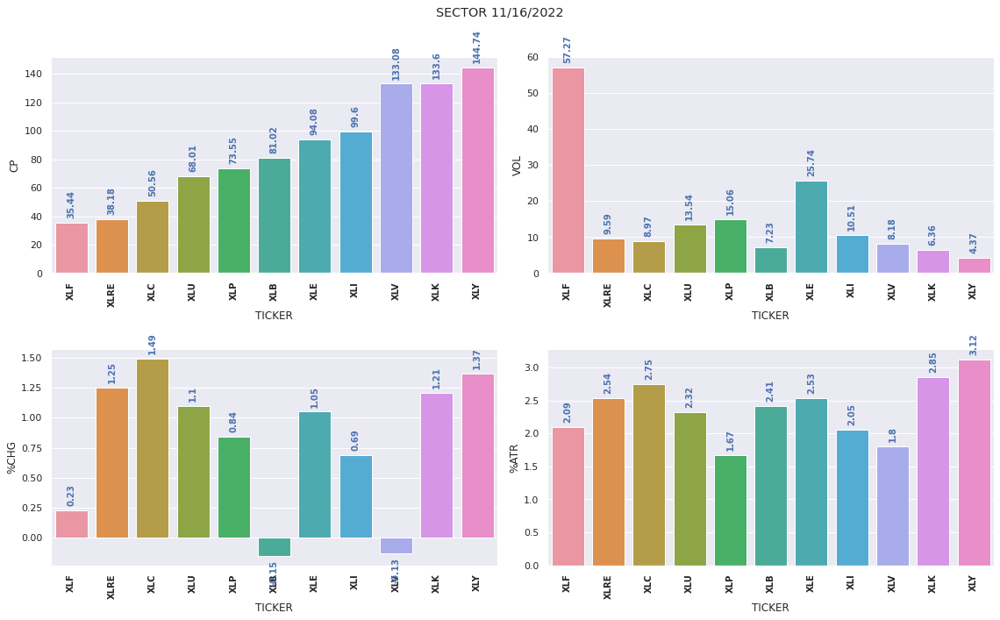

In [8]:
compare_bars(df_sector,title='sector')

In [9]:
# df_sector.style.\
#     applymap(color_negative_red).\
#     format("{:.2}")

df_sector.style.apply(highlight_max, subset=['RSI', 'CP', 'VOL','%CHG','%ATR'])\
.apply(highlight_min, subset=['RSI', 'CP', 'VOL','%CHG','%ATR'])\
#.format({'VOL':"{:.2f}",'CP':"{:.2f}",'RSI':"{:.2f}"})

#.style.format({'VOL':'{:.2f}'})
#df_sector.style.apply(highlight_min, subset=['RSI', 'CP', 'VOL','%CHG','%ATR'])
#df_sector.style.format({'VOL':"{:.2f}",'CP':"{:.2f}",'RSI':"{:.2f}"})
#cols=['CP']#,'RSI','SMA5','SMA21','SMA50','SMA50','SMA200','VOL','AVGVOL','%CHG','AVG10ATR','%ATR']
#df_sector[cols]=df_sector[cols].applymap('{0:.2f}'.format)
#df_sector
#df_sector['CP'].style.format('{:,.3f}')

,TICKER,CP,HH,HL,LH,LL,HC,RSI,SMA5,SMA21,SMA50,SMA200,VOL,AVGVOL,%CHG,AVG10ATR,SECTOR,%ATR
1,XLB,81.020000,False,False,False,True,False,69.250000,79.950000,74.980000,72.980000,79.470000,7.230000,66.950000,-0.150000,1.950000,Materials,2.410000
2,XLI,99.600000,False,False,False,True,False,69.040000,98.640000,93.680000,90.310000,94.370000,10.510000,97.810000,0.690000,2.040000,Industrials,2.050000
3,XLE,94.080000,False,False,False,False,False,66.440000,91.870000,89.340000,82.690000,78.060000,25.740000,247.980000,1.050000,2.380000,Energy,2.530000
4,XLF,35.440000,False,False,False,True,False,64.190000,35.220000,33.690000,32.690000,34.690000,57.270000,471.140000,0.230000,0.740000,Financials,2.090000
5,XLP,73.550000,False,True,False,False,False,61.140000,73.100000,71.540000,70.460000,73.680000,15.060000,147.190000,0.840000,1.230000,Consumer_Staples,1.670000
6,XLK,133.600000,True,True,False,False,False,60.810000,130.120000,125.550000,125.610000,139.140000,6.360000,72.020000,1.210000,3.810000,Technology,2.850000
7,XLRE,38.180000,False,False,True,False,False,59.200000,37.880000,36.260000,37.130000,42.680000,9.590000,77.280000,1.250000,0.970000,Real_Estate,2.540000
8,XLV,133.080000,False,False,False,False,False,59.060000,133.140000,130.640000,127.340000,130.150000,8.180000,97.410000,-0.130000,2.400000,Healthcare,1.800000
9,XLC,50.560000,True,True,False,False,False,57.530000,49.020000,48.610000,49.720000,58.430000,8.970000,78.840000,1.490000,1.390000,Communication_Serives,2.750000
10,XLU,68.010000,False,False,True,True,False,54.770000,67.590000,65.950000,68.270000,70.950000,13.540000,130.310000,1.100000,1.580000,Utilities,2.320000




  TICKER     CP     HH     HL     LH    LL     HC    RSI   SMA5  SMA21  SMA50  SMA200   VOL  AVGVOL  %CHG  AVG10ATR     SECTOR  %ATR
1    XLB  81.02  False  False  False  True  False  69.25  79.95  74.98  72.98   79.47  7.23   66.95 -0.15      1.95  Materials  2.41


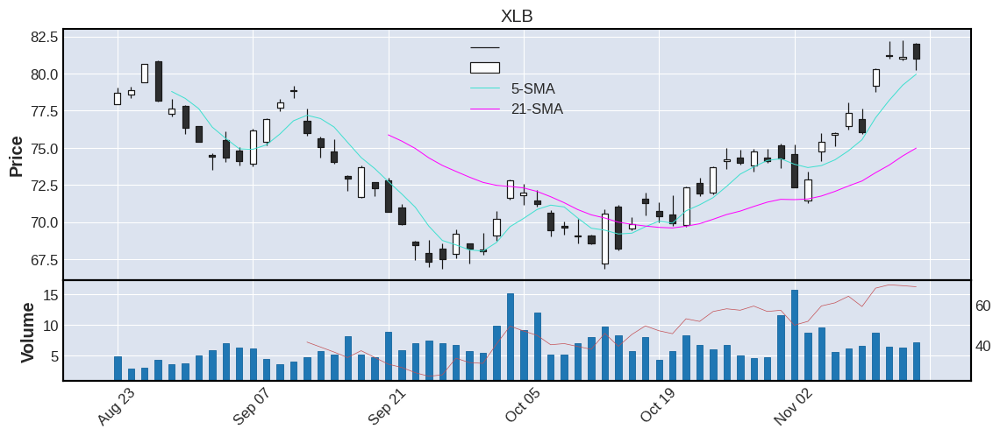



  TICKER    CP     HH     HL     LH    LL     HC    RSI   SMA5  SMA21  SMA50  SMA200    VOL  AVGVOL  %CHG  AVG10ATR       SECTOR  %ATR
2    XLI  99.6  False  False  False  True  False  69.04  98.64  93.68  90.31   94.37  10.51   97.81  0.69      2.04  Industrials  2.05


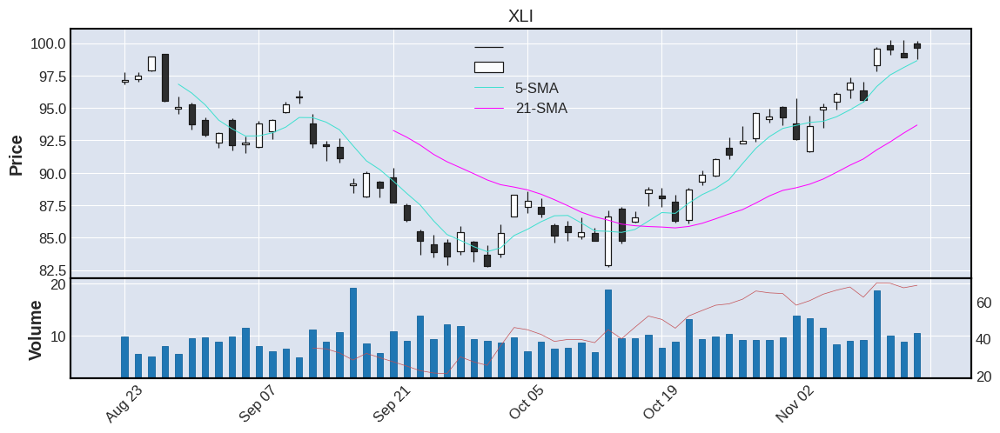



  TICKER     CP     HH     HL     LH     LL     HC    RSI   SMA5  SMA21  SMA50  SMA200    VOL  AVGVOL  %CHG  AVG10ATR  SECTOR  %ATR
3    XLE  94.08  False  False  False  False  False  66.44  91.87  89.34  82.69   78.06  25.74  247.98  1.05      2.38  Energy  2.53


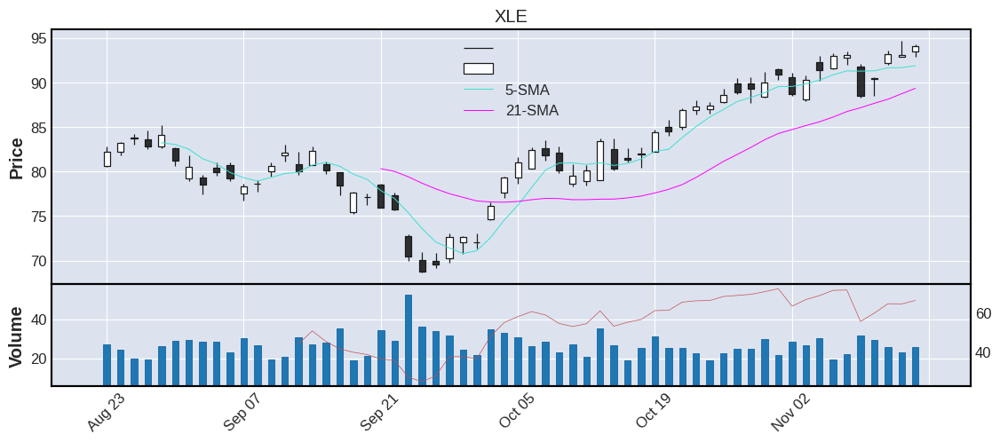



  TICKER     CP     HH     HL     LH    LL     HC    RSI   SMA5  SMA21  SMA50  SMA200    VOL  AVGVOL  %CHG  AVG10ATR      SECTOR  %ATR
4    XLF  35.44  False  False  False  True  False  64.19  35.22  33.69  32.69   34.69  57.27  471.14  0.23      0.74  Financials  2.09


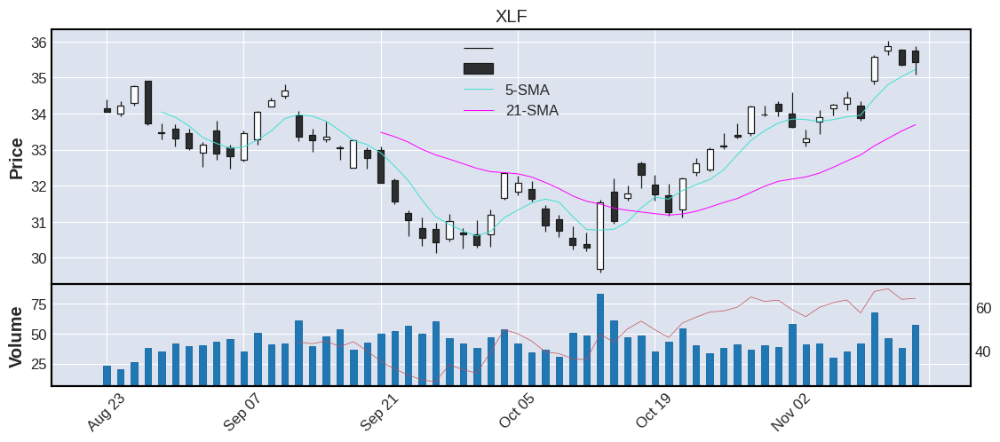



  TICKER     CP     HH    HL     LH     LL     HC    RSI  SMA5  SMA21  SMA50  SMA200    VOL  AVGVOL  %CHG  AVG10ATR            SECTOR  %ATR
5    XLP  73.55  False  True  False  False  False  61.14  73.1  71.54  70.46   73.68  15.06  147.19  0.84      1.23  Consumer_Staples  1.67


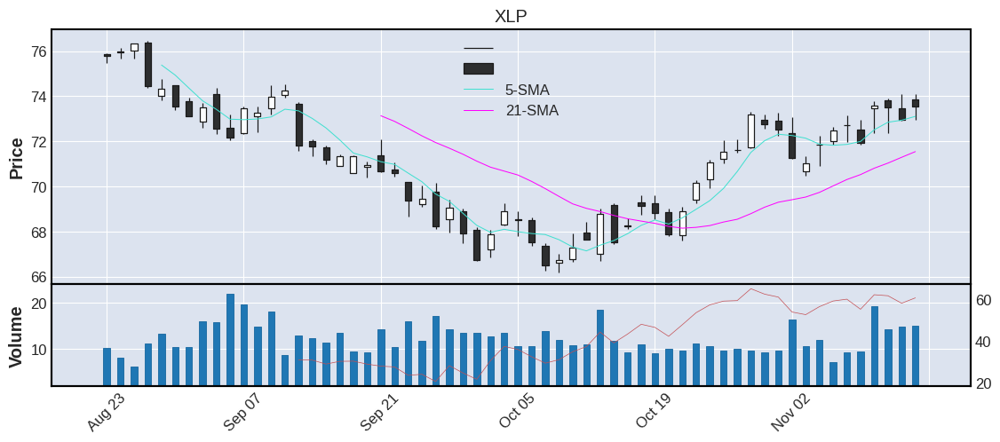



  TICKER     CP    HH    HL     LH     LL     HC    RSI    SMA5   SMA21   SMA50  SMA200   VOL  AVGVOL  %CHG  AVG10ATR      SECTOR  %ATR
6    XLK  133.6  True  True  False  False  False  60.81  130.12  125.55  125.61  139.14  6.36   72.02  1.21      3.81  Technology  2.85


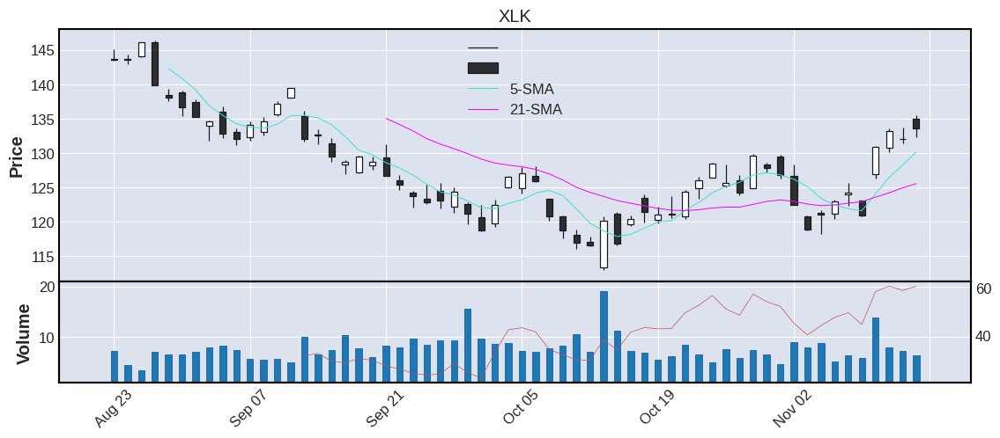



  TICKER     CP     HH     HL    LH     LL     HC   RSI   SMA5  SMA21  SMA50  SMA200   VOL  AVGVOL  %CHG  AVG10ATR       SECTOR  %ATR
7   XLRE  38.18  False  False  True  False  False  59.2  37.88  36.26  37.13   42.68  9.59   77.28  1.25      0.97  Real_Estate  2.54


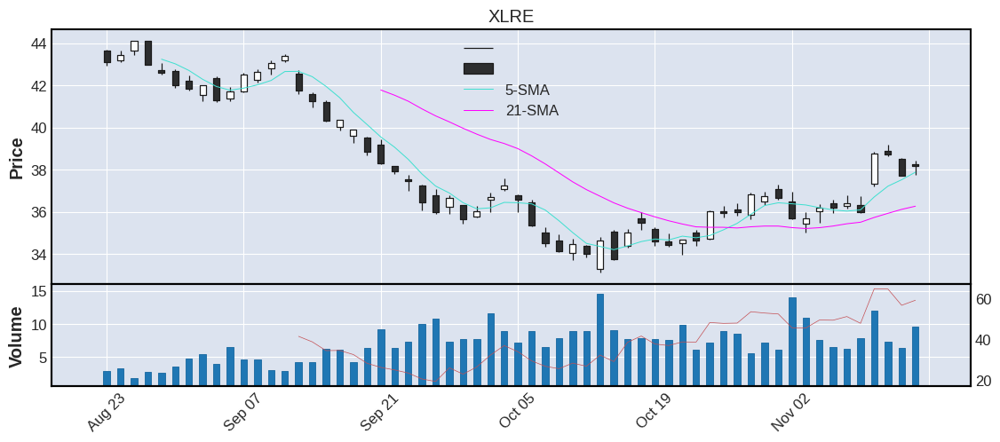



  TICKER      CP     HH     HL     LH     LL     HC    RSI    SMA5   SMA21   SMA50  SMA200   VOL  AVGVOL  %CHG  AVG10ATR      SECTOR  %ATR
8    XLV  133.08  False  False  False  False  False  59.06  133.14  130.64  127.34  130.15  8.18   97.41 -0.13       2.4  Healthcare   1.8


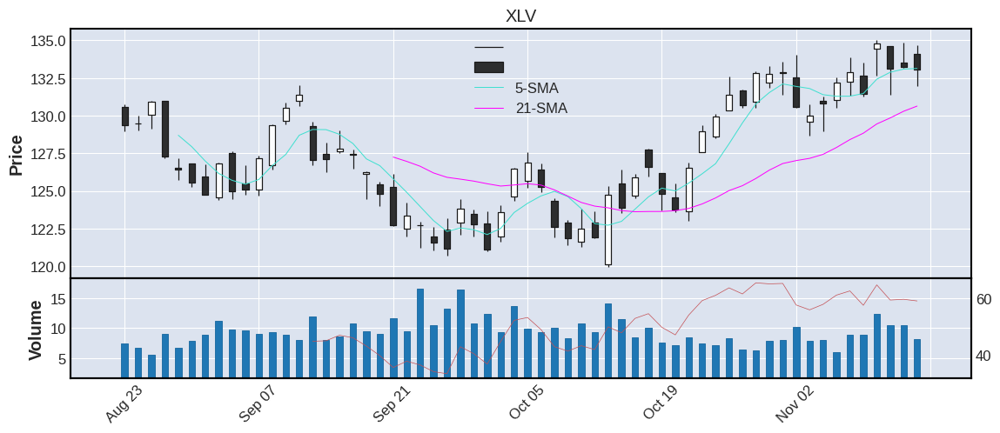



  TICKER     CP    HH    HL     LH     LL     HC    RSI   SMA5  SMA21  SMA50  SMA200   VOL  AVGVOL  %CHG  AVG10ATR                 SECTOR  %ATR
9    XLC  50.56  True  True  False  False  False  57.53  49.02  48.61  49.72   58.43  8.97   78.84  1.49      1.39  Communication_Serives  2.75


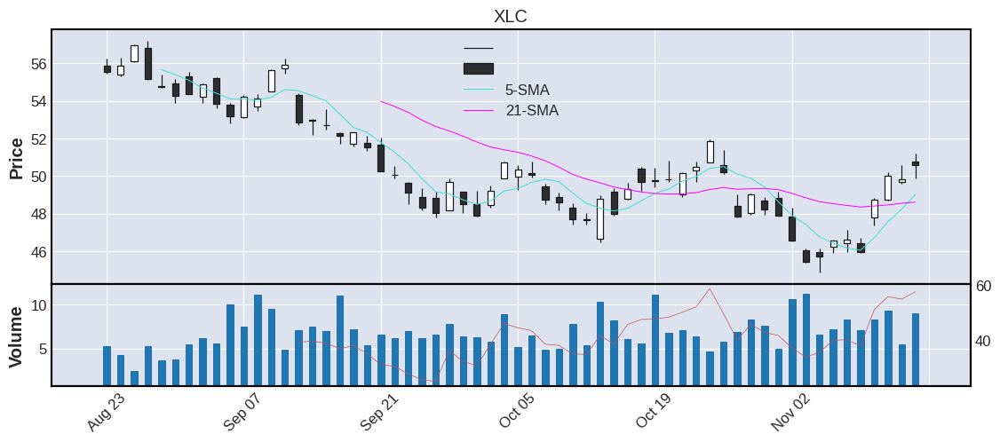



   TICKER     CP     HH     HL    LH    LL     HC    RSI   SMA5  SMA21  SMA50  SMA200    VOL  AVGVOL  %CHG  AVG10ATR     SECTOR  %ATR
10    XLU  68.01  False  False  True  True  False  54.77  67.59  65.95  68.27   70.95  13.54  130.31   1.1      1.58  Utilities  2.32


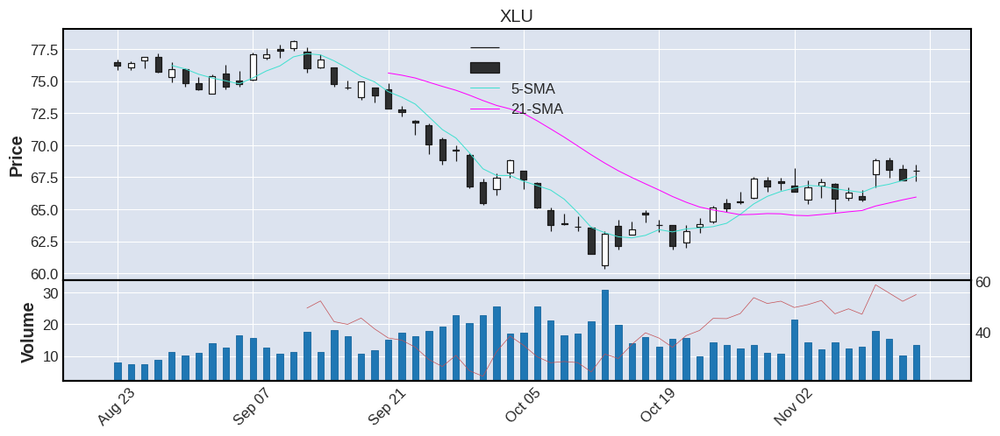



   TICKER      CP     HH    HL     LH     LL     HC    RSI    SMA5   SMA21   SMA50  SMA200   VOL  AVGVOL  %CHG  AVG10ATR                  SECTOR  %ATR
11    XLY  144.74  False  True  False  False  False  53.79  141.27  141.24  146.17   159.1  4.37    59.8  1.37      4.51  Consumer_Discretionary  3.12


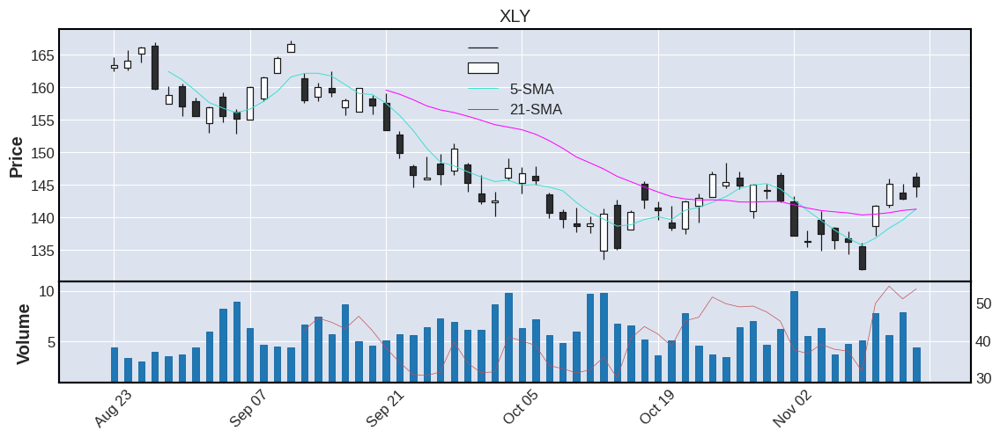

In [10]:
#plotting the sectors

tick=df_sector['TICKER'].to_list()
sec=df_sector['SECTOR'].to_list()
root='/home/thakur/test/sector'
for c,i in enumerate(tick):
    #file=root.format(cat[c],i)
    #print(f"file: {file}")
    print(f"\n\n{df_sector[df_sector['TICKER']==i].to_string()}")
    plot_with_mpl(root,i,sty='default')

In [11]:
#dataframe which includes the information about the performance
df=pd.read_csv('/home/thakur/test/combined/all_nasdaq.csv')
df['IPO'].fillna(0,inplace=True);df['IPO'].astype(float)
df.fillna('N-A',inplace=True)
df=df[(df['%CHG']!=np.inf) & (df['%CHG']!='N/A') & (df['CP']>0)]
df['%ATR']=round(100*df['ATR']/df['CP'],2)
df['SECTOR'] = df['SECTOR'].apply(lambda x:x.replace(' ', '_'))

df.head()

,TICKER,CP,EMA8,HH,HL,LH,LL,HC,HV,RSI,SMA5,SMA21,SMA50,SMA200,VOL,AVGVOL,%CHG,ATR,SECTOR,INDUSTRY,IPO,COUNTRY,CATEGORY,%ATR
0,AAPL,150.04,146.01,True,True,False,False,False,False,54.73,145.95,145.92,147.42,155.45,89.49,90.11,1.19,5.68,Technology,Computer Manufacturing,1980.0,United States,mega,3.79
1,ABBV,153.04,149.94,False,False,False,False,True,False,64.01,150.46,148.02,144.08,148.11,5.91,5.99,0.86,3.86,Health_Care,Other Pharmaceuticals,2012.0,United States,mega,2.52
2,AMZN,98.94,96.79,False,True,False,False,False,False,44.17,96.20,103.31,112.81,128.76,108.54,116.75,0.46,5.60,Consumer_Discretionary,Catalog/Specialty Distribution,1997.0,United States,mega,5.66
3,BAC,37.70,37.38,False,False,False,True,False,False,65.24,37.70,36.16,33.98,36.67,45.97,38.61,-0.16,0.88,Finance,Major Banks,0.0,United States,mega,2.33
4,BRK-A,468233.00,455547.93,True,True,False,False,False,False,67.18,459498.00,440536.86,425000.20,455427.60,0.00,0.00,0.35,13178.87,N-A,N-A,0.0,United States,mega,2.81


# NASDAQ BEST

In [12]:
# HH, HL, HC
temp_df=df.copy()\
.query('HH & HL & HC & HV & (CP>SMA50) & (CP>SMA200) & (`%CHG`>0) & VOL>0.5') \
.sort_values(by='CP',ascending=True)\
.replace(['micro','nano','mega','large'],np.nan,inplace=False)\
.pipe(lambda x:x.loc[(x.COUNTRY=='United States')])\
.dropna()\
.drop(['LL','LH','SMA21','HL','HH','HC','HV','COUNTRY'],axis=1)\
.reset_index(drop=True)\


temp_df

,TICKER,CP,EMA8,RSI,SMA5,SMA50,SMA200,VOL,AVGVOL,%CHG,ATR,SECTOR,INDUSTRY,IPO,CATEGORY,%ATR
0,MMAT,1.88,1.52,73.98,1.52,0.96,1.28,26.64,13.88,11.24,0.18,Technology,Semiconductors,0.0,small,9.57
1,INO,2.50,2.31,71.62,2.36,1.93,2.44,7.91,8.83,3.73,0.20,Health_Care,Biotechnology: Biological Products (No Diagnos...,0.0,small,8.00
2,AMKR,28.47,24.55,87.17,25.19,19.37,19.96,2.21,1.32,8.79,1.17,Technology,Semiconductors,1998.0,medium,4.11
3,ASO,48.06,44.55,63.90,44.52,45.05,39.86,2.31,1.78,6.52,2.09,Consumer_Discretionary,Recreational Games/Products/Toys,2020.0,medium,4.35
4,HLI,101.58,95.83,78.51,96.69,83.11,86.66,0.69,0.38,3.65,3.03,Finance,Investment Managers,2015.0,medium,2.98


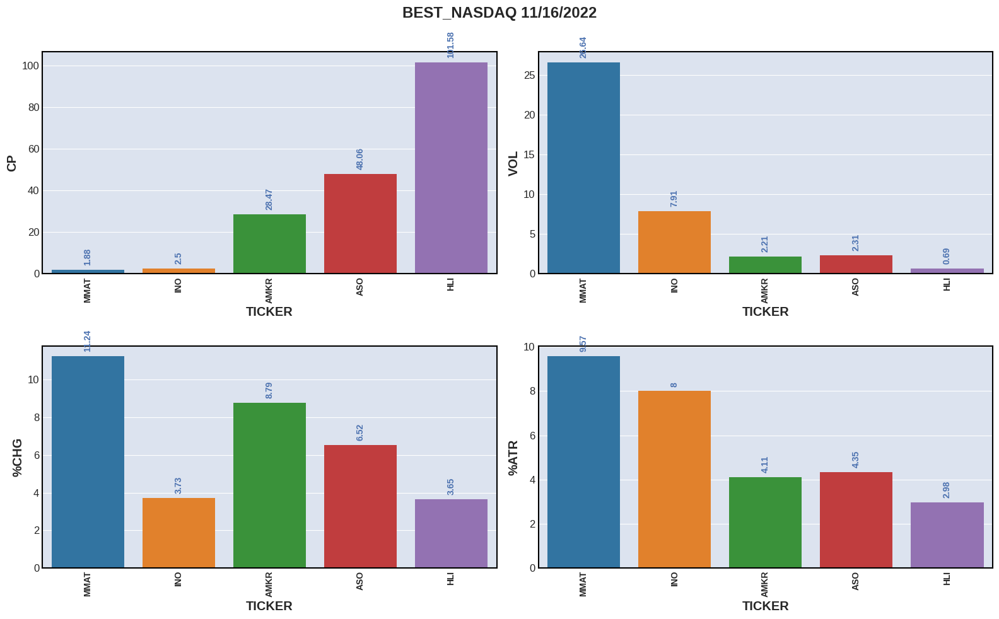

In [13]:
compare_bars(temp_df,title='best_nasdaq')



  TICKER    CP  EMA8    RSI  SMA5  SMA50  SMA200    VOL  AVGVOL   %CHG   ATR      SECTOR        INDUSTRY  IPO CATEGORY  %ATR
0   MMAT  1.88  1.52  73.98  1.52   0.96    1.28  26.64   13.88  11.24  0.18  Technology  Semiconductors  0.0    small  9.57


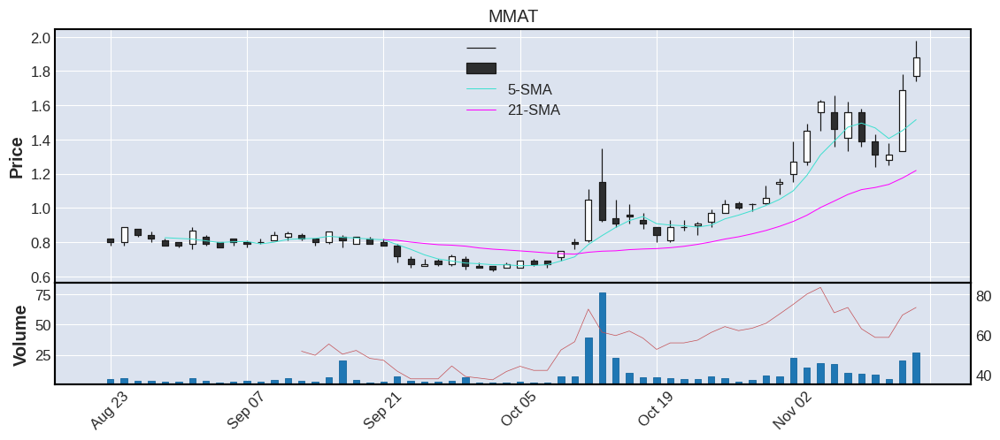



  TICKER   CP  EMA8    RSI  SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG  ATR       SECTOR                                                       INDUSTRY  IPO CATEGORY  %ATR
1    INO  2.5  2.31  71.62  2.36   1.93    2.44  7.91    8.83  3.73  0.2  Health_Care  Biotechnology: Biological Products (No Diagnostic Substances)  0.0    small   8.0


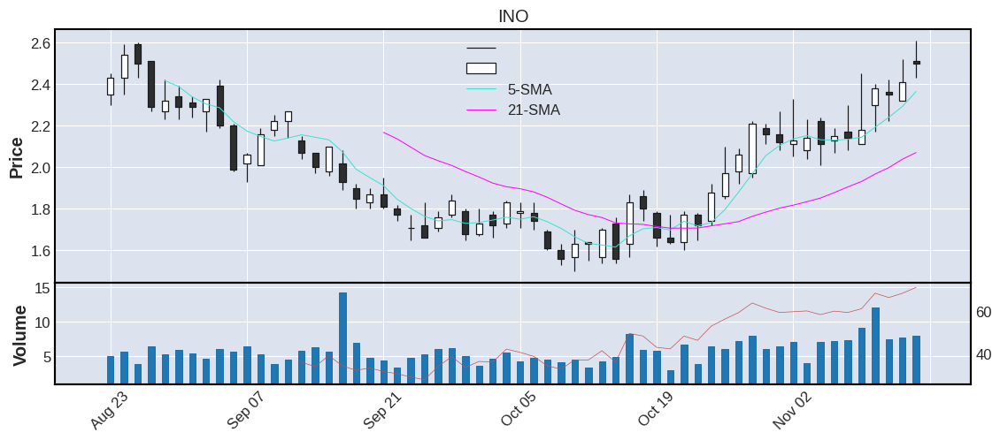



  TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR      SECTOR        INDUSTRY     IPO CATEGORY  %ATR
2   AMKR  28.47  24.55  87.17  25.19  19.37   19.96  2.21    1.32  8.79  1.17  Technology  Semiconductors  1998.0   medium  4.11


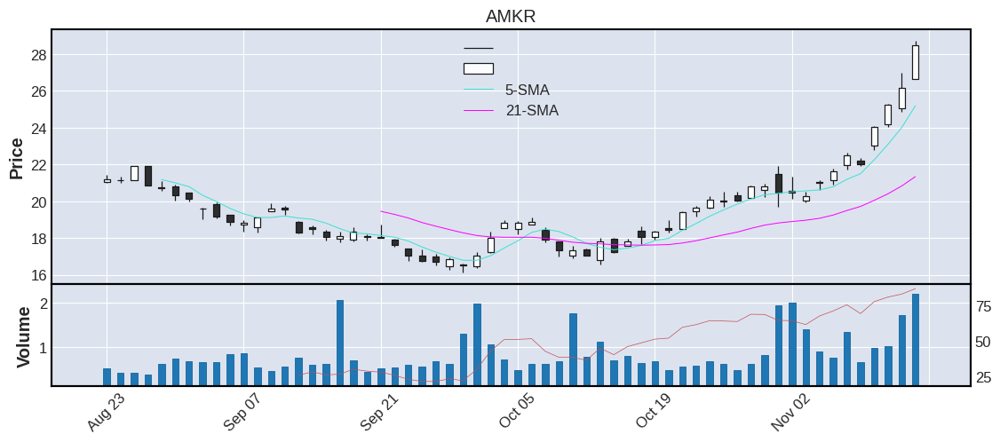



  TICKER     CP   EMA8   RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR                  SECTOR                          INDUSTRY     IPO CATEGORY  %ATR
3    ASO  48.06  44.55  63.9  44.52  45.05   39.86  2.31    1.78  6.52  2.09  Consumer_Discretionary  Recreational Games/Products/Toys  2020.0   medium  4.35


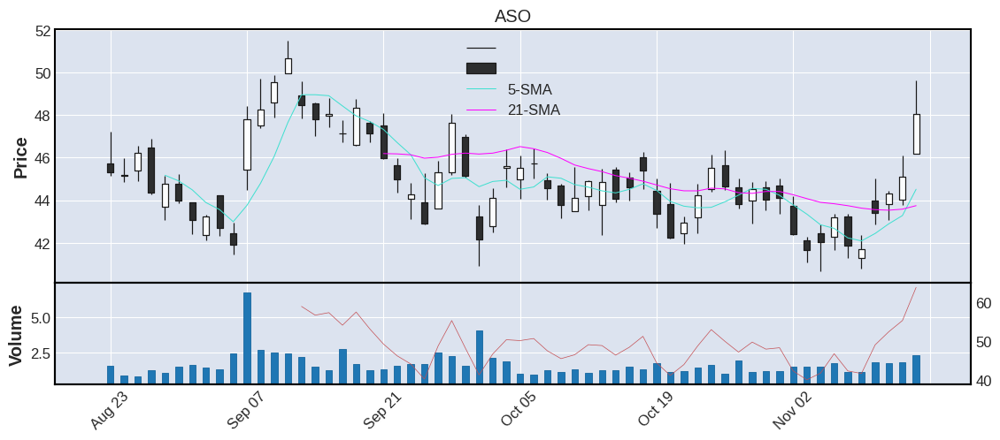



  TICKER      CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR   SECTOR             INDUSTRY     IPO CATEGORY  %ATR
4    HLI  101.58  95.83  78.51  96.69  83.11   86.66  0.69    0.38  3.65  3.03  Finance  Investment Managers  2015.0   medium  2.98


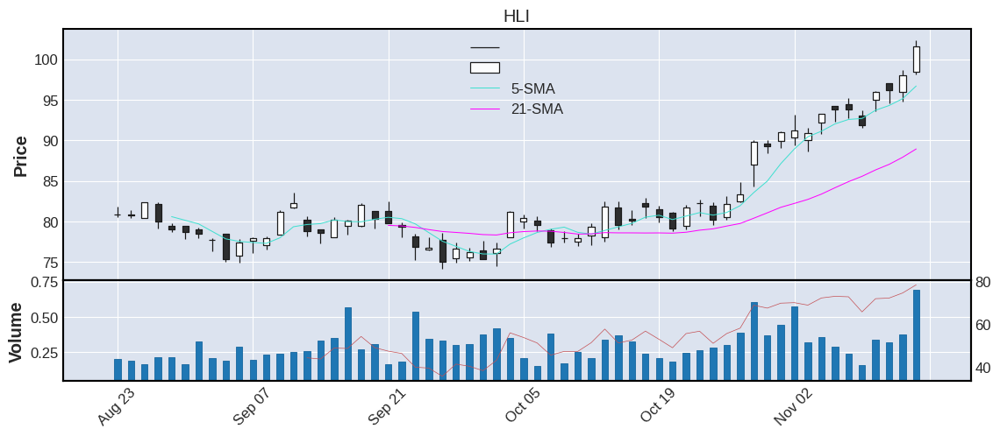

In [14]:
root='/home/thakur/test/{}'
plot=True

tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
if plot:
    for c,i in enumerate(tick):print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')

In [15]:
df.SECTOR.unique()
# df_test=df.sort_values(by='%CHG')
# df_test

array(['Technology', 'Health_Care', 'Consumer_Discretionary', 'Finance',
       'N-A', 'Energy', 'Consumer_Staples', 'Industrials', 'Utilities',
       'Real_Estate', 'Telecommunications', 'Miscellaneous',
       'Basic_Materials'], dtype=object)

In [16]:
df.SECTOR.value_counts()
# #column names
# df.dtypes

Finance                   1552
Health_Care               1251
Consumer_Discretionary    1034
Industrials                825
Technology                 813
N-A                        403
Real_Estate                290
Energy                     193
Utilities                  175
Consumer_Staples           142
Telecommunications          67
Basic_Materials             53
Miscellaneous               39
Name: SECTOR, dtype: int64

In [17]:
countries=df['COUNTRY'].value_counts()
countries


United States           5005
N-A                      729
Canada                   216
China                    199
Israel                   113
United Kingdom            77
Bermuda                   42
Hong Kong                 32
Brazil                    31
Cayman Islands            31
Switzerland               27
Netherlands               24
Singapore                 23
Ireland                   22
Germany                   22
Greece                    21
Australia                 18
France                    17
Mexico                    16
Argentina                 14
Luxembourg                14
Taiwan                    13
Japan                     12
India                     12
South Korea               10
Sweden                     8
Denmark                    8
South Africa               7
Belgium                    6
Malaysia                   5
Colombia                   5
Chile                      5
Monaco                     5
Spain                      4
United Arab Em

In [18]:
countries=list(df['COUNTRY'].unique())
countries

['United States',
 'Denmark',
 'Netherlands',
 'Taiwan',
 'Switzerland',
 'N-A',
 'Bermuda',
 'Ireland',
 'Canada',
 'Mexico',
 'United Kingdom',
 'China',
 'Peru',
 'Brazil',
 'Spain',
 'Cayman Islands',
 'Australia',
 'Germany',
 'Belgium',
 'Japan',
 'Israel',
 'Italy',
 'Colombia',
 'Norway',
 'Sweden',
 'Singapore',
 'India',
 'South Korea',
 'Argentina',
 'Luxembourg',
 'Finland',
 'France',
 'Chile',
 'South Africa',
 'Indonesia',
 'Panama',
 'Hong Kong',
 'Uruguay',
 'Guernsey',
 'Puerto Rico',
 'Kazakhstan',
 'Jersey',
 'Philippines',
 'Monaco',
 'Turkey',
 'Greece',
 'Costa Rica',
 'Jordan',
 'Malta',
 'Isle of Man',
 'Curacao',
 'Bahamas',
 'United Arab Emirates',
 'Gibraltar',
 'New Zealand',
 'Cyprus',
 'Macau',
 'Malaysia']

# DOW JONES & SNP-500


In [19]:
dow=pd.read_csv('/home/thakur/stock_information/dow.csv')['Symbol'].to_list()
snp=pd.read_csv('/home/thakur/stock_information/snp500finalwvol.csv')['SYMBOL'].to_list()

In [20]:
temp_df=df[df['TICKER'].isin(snp)].copy()
#temp_df


# DOW JONES

In [21]:
#%%script false --no-raise-error
yahoo='https://finance.yahoo.com/quote/{}?p={}&.tsrc=fin-srch'
fmt=33*'=='
fmt1=35*'**'
choose=['%CHG','VOL','%ATR','RSI']
how=False
plot=False #False
show_number=10

temp_df=df[df['TICKER'].isin(dow)].copy()

temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))
temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))

root='/home/thakur/test/{}'
columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'CATEGORY']
temp_df=temp_df[columns_selected]
for ch in choose:
    temp_df=temp_df.sort_values(by=ch,ascending=how).head(30)
    #temp_df['yahoo']=temp_df['TICKER'].apply(lambda x:yahoo.format(x,x))
    #temp_df['link'] = temp_df['TICKER'].apply(lambda x: make_clickable(yahoo.format(x,x),x))
    temp_df=reset_index(temp_df)

    print(f"\n\n{fmt} [ { ch } ] {fmt} \n\n {temp_df.to_string()}\n\n")#{fmt}{fmt}")
    
    tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
    if plot and ch==choose[-1]:
        for c,i in enumerate(tick):print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')



================================================================== [ %CHG ] ================================================================== 

    TICKER      CP    RSI    VOL  AVGVOL  %CHG    ATR  %ATR                  SECTOR                                    INDUSTRY     IPO CATEGORY
1     WMT  147.44  65.36  25.49   11.30  6.54   3.48  2.36  Consumer_Discretionary          Department/Specialty Retail Stores     0.0     mega
2     NKE  106.71  66.58   7.22    8.57  2.22   3.98  3.73  Consumer_Discretionary                          Shoe Manufacturing     0.0    large
3     CRM  162.07  57.95   8.09    7.28  2.15   6.43  3.97              Technology                           Computer Software  2004.0    large
4      HD  311.93  62.84   9.24    6.29  1.63   9.73  3.12  Consumer_Discretionary                   ETAIL: Building Materials     0.0     mega
5       V  209.99  62.92   6.12    7.38  1.51   6.21  2.96  Consumer_Discretionary                           Business Services     0

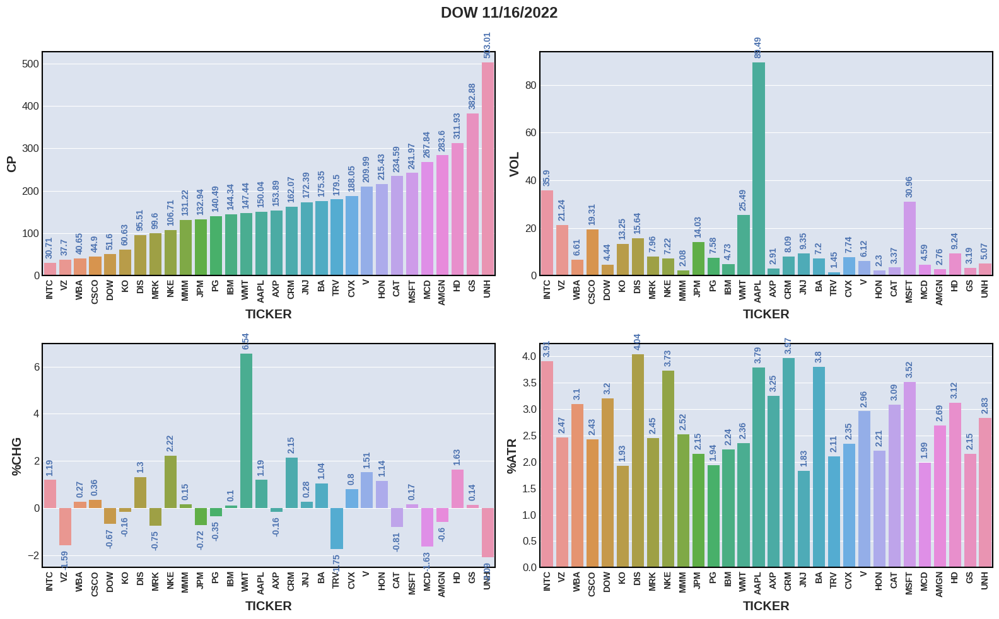

In [22]:
compare_bars(temp_df,title='dow')

/tmp/ipykernel_14441/2843022622.py:55: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(choose)


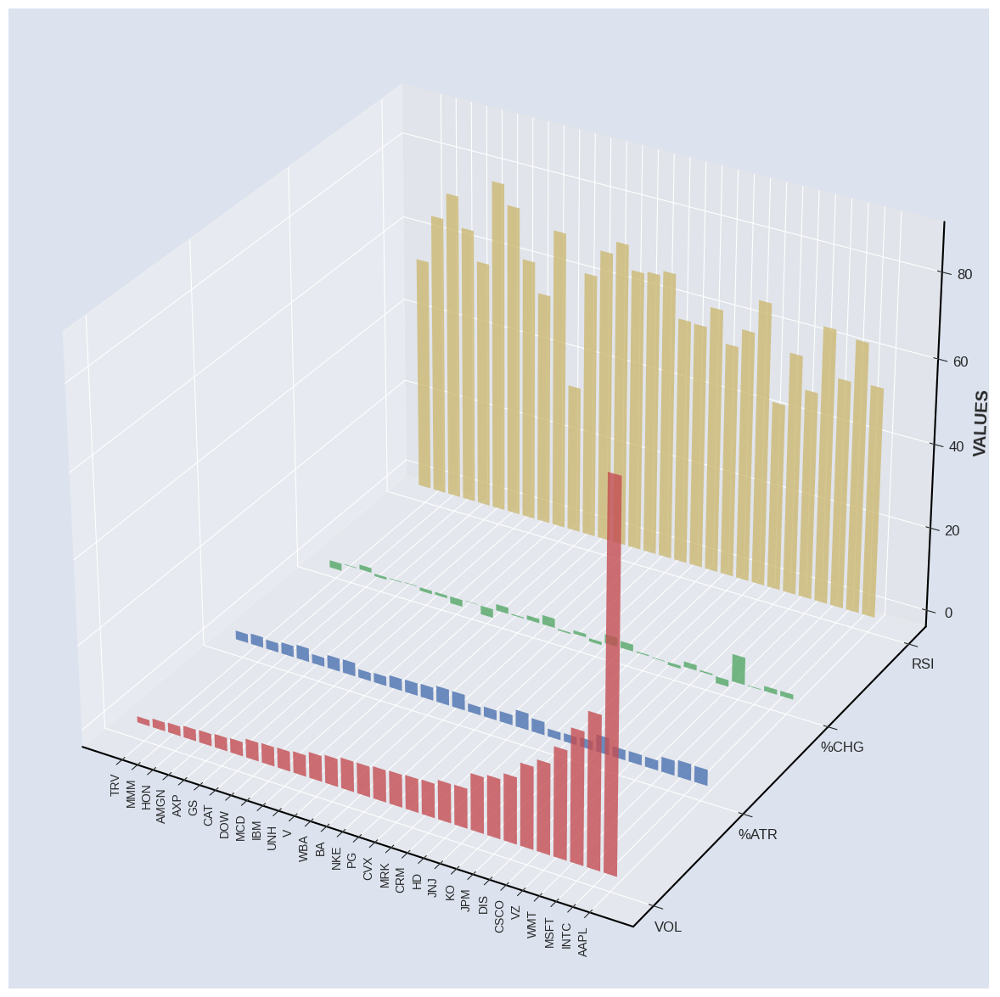

In [23]:
import matplotlib.pyplot as plt
import numpy as np
#from random import randint
#from mpl_toolkits.mplot3d import Axes3D

# Fixing random state for reproducibility
#np.random.seed(19680801)


fig = plt.figure(figsize=(25,15))
ax = fig.add_subplot(projection='3d')

n=30 #30 different colors

#colors_ = lambda n: list(map(lambda i: "#" + "%06x" % random.randint(0, 0xFFFFFF),range(n)))

# def get_cmap(n, name='hsv'):
#     '''Returns a function that maps each index in 0, 1, ..., n-1 to a distinct 
#     RGB color; the keyword argument name must be a standard mpl colormap name.'''
#     return plt.cm.get_cmap(name, n)

temp_df=temp_df.sort_values(by='VOL')

col = []
dx = .10 * np.ones(n)
dy = .10 * np.ones(n)
z=np.zeros(n)

# for i in range(n):
#    col.append('#%06X' % randint(0, 0xFFFFFF))

colors = ['r', 'g', 'b', 'y']
yticks = [0,2,1,3]
choose=['VOL','%CHG','%ATR','RSI']
for i, (c, k) in enumerate(zip(colors, yticks)):
    # Generate the random data for the y=k 'layer'.
    #xs = np.arange(20)
    xs=temp_df['TICKER'].to_list()
    #ys = np.random.rand(30)
    ys = temp_df[choose[i]].to_list()

    # You can provide either a single color or an array with the same length as
    # xs and ys. To demonstrate this, we color the first bar of each set cyan.
    cs = [c] * len(xs)
    #cs[0] = 'c'

    # Plot the bar graph given by xs and ys on the plane y=k with 80% opacity.
    ax.bar(xs, ys, zs=k, zdir='y', color=cs, alpha=0.8)
    #ax.set_xlabel('TICKERS',labelpad=0)
    #ax.bar3d(x=np.arange(30),y=k,z=z,dx=dx,dy=dy,dz=ys)

#ax.set_xlabel('TICKERS',labelpad=10)
ax.set_zlabel('VALUES')
ax.tick_params(axis='x', rotation=90,labelsize='small',pad=0)
ax.set_yticklabels(choose)
# ax.set_xticklabels(xs)
fig.align_xlabels()

# labelx = -0.5  # axes coords

# ax.xaxis.set_label_coords(labelx, 0.5)

# On the y axis let's only label the discrete values that we have data for.
ax.set_yticks(yticks)

plt.show()

# SNP-500

In [24]:
#%%script false --no-raise-error
fmt=30*'=='
fmt1=35*'**'
choose=['%CHG','%CHG','VOL','RSI','RSI','%ATR','CP','CP']
how=False
plot=False
show_number=30

temp_df=df[df['TICKER'].isin(snp)].copy()

temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))
temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))

root='/home/thakur/test/{}'
columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR',  'IPO', 'COUNTRY','CATEGORY']#,'INDUSTRY',]
temp_df=temp_df[columns_selected]
ch_count=0
for c,ch in enumerate(choose,start=0):
    how=False
    if c in [1,4,7]:how=True
    temp_dff=temp_df.copy().sort_values(by=ch,ascending=how).head(show_number)
    #if ch=='%CHG':how=~how
    #if ch_count==1:how=True
    temp_dff=reset_index(temp_dff)

    print(f"\n\n{fmt} [ { ch } ] {fmt} \n\n {temp_dff.to_string()}\n\n")#{fmt}{fmt}")
    tick=temp_dff['TICKER'].to_list();cat=temp_dff['CATEGORY'].to_list()
    if plot and c==2:
        for c,i in enumerate(tick):print(f"\n\n{temp_dff[temp_dff['TICKER']==i].to_string()}");print(yahoo.format(i,i));plot_with_mpl(root.format(cat[c]),i,sty='default')



============================================================ [ %CHG ] ============================================================ 

    TICKER      CP    RSI     VOL  AVGVOL  %CHG    ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
1    SIVB  239.93  43.90    1.63    1.40  9.18  17.22  7.18                 Finance     0.0  United States    large
2    CDAY   72.68  67.33    2.58    3.11   8.3   4.16  5.72              Technology  2018.0  United States   medium
3    MTCH   51.92  60.62    5.18    4.84  6.66   3.13  6.03              Technology     0.0  United States    large
4    SBNY  147.94  48.89    1.94    1.85  6.61   8.88  6.00                 Finance  2004.0  United States   medium
5     WMT  147.44  65.36   25.49   11.30  6.54   3.48  2.36  Consumer_Discretionary     0.0  United States     mega
6     FRC  130.56  57.80    1.88    2.48  5.45   4.83  3.70                 Finance     0.0  United States    large
7     CZR   54.30  74.02    3.99    4.93  5.42   3.0

In [25]:
snp_df=df[df['TICKER'].isin(snp)].copy()
snp_df.head()

,TICKER,CP,EMA8,HH,HL,LH,LL,HC,HV,RSI,SMA5,SMA21,SMA50,SMA200,VOL,AVGVOL,%CHG,ATR,SECTOR,INDUSTRY,IPO,COUNTRY,CATEGORY,%ATR
0,AAPL,150.04,146.01,True,True,False,False,False,False,54.73,145.95,145.92,147.42,155.45,89.49,90.11,1.19,5.68,Technology,Computer Manufacturing,1980.0,United States,mega,3.79
1,ABBV,153.04,149.94,False,False,False,False,True,False,64.01,150.46,148.02,144.08,148.11,5.91,5.99,0.86,3.86,Health_Care,Other Pharmaceuticals,2012.0,United States,mega,2.52
2,AMZN,98.94,96.79,False,True,False,False,False,False,44.17,96.20,103.31,112.81,128.76,108.54,116.75,0.46,5.60,Consumer_Discretionary,Catalog/Specialty Distribution,1997.0,United States,mega,5.66
3,BAC,37.70,37.38,False,False,False,True,False,False,65.24,37.70,36.16,33.98,36.67,45.97,38.61,-0.16,0.88,Finance,Major Banks,0.0,United States,mega,2.33
5,BRK-B,309.98,301.55,True,False,False,False,False,False,67.32,304.09,291.62,281.48,302.90,3.67,4.67,0.35,6.75,N-A,N-A,0.0,United States,mega,2.18


# SNP500 Best

In [26]:
# HH, HL, HC
temp_df=snp_df.copy()\
.query('HH & HL & (CP>SMA50) & (CP>SMA200) & (`%CHG`>0) & VOL>0.5') \
.sort_values(by='CP',ascending=True)\
.replace(['micro','nano','mega','large'],np.nan,inplace=False)\
.pipe(lambda x:x.loc[(x.COUNTRY=='United States')])\
.dropna()\
.drop(['LL','LH','SMA21','HL','HH','HC','HV','COUNTRY'],axis=1)\
.reset_index(drop=True)\


temp_df

,TICKER,CP,EMA8,RSI,SMA5,SMA50,SMA200,VOL,AVGVOL,%CHG,ATR,SECTOR,INDUSTRY,IPO,CATEGORY,%ATR
0,NCLH,18.30,17.37,66.84,17.38,14.79,16.01,20.26,22.03,2.41,1.01,Consumer_Discretionary,Hotels/Resorts,0.0,medium,5.52
1,BWA,42.79,40.56,76.01,41.34,36.00,37.62,2.44,2.31,1.93,1.30,Consumer_Discretionary,Auto Parts:O.E.M.,0.0,medium,3.04
2,CDAY,72.68,64.93,67.33,64.77,59.87,60.19,2.58,3.11,8.30,4.16,Technology,EDP Services,2018.0,medium,5.72
3,WYNN,78.40,73.66,69.24,74.95,64.42,68.31,2.67,4.29,0.42,3.77,Consumer_Discretionary,Hotels/Resorts,2002.0,medium,4.81
4,UHS,127.63,120.51,75.32,122.36,101.26,118.36,0.87,0.84,1.55,5.08,Health_Care,Hospital/Nursing Management,0.0,medium,3.98


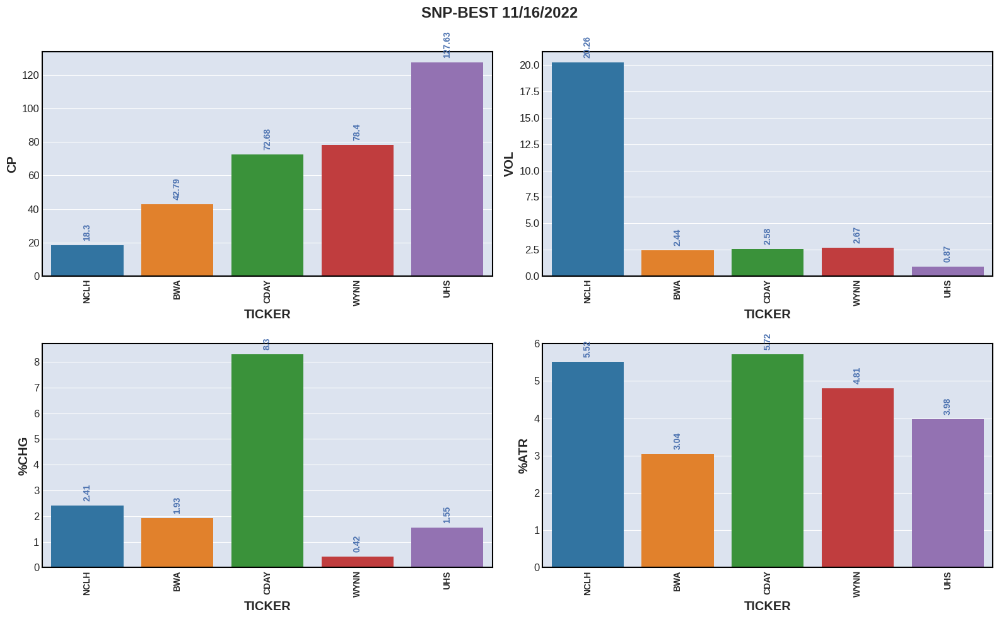

In [27]:
compare_bars(temp_df,title='snp-best')



  TICKER    CP   EMA8    RSI   SMA5  SMA50  SMA200    VOL  AVGVOL  %CHG   ATR                  SECTOR        INDUSTRY  IPO CATEGORY  %ATR
0   NCLH  18.3  17.37  66.84  17.38  14.79   16.01  20.26   22.03  2.41  1.01  Consumer_Discretionary  Hotels/Resorts  0.0   medium  5.52


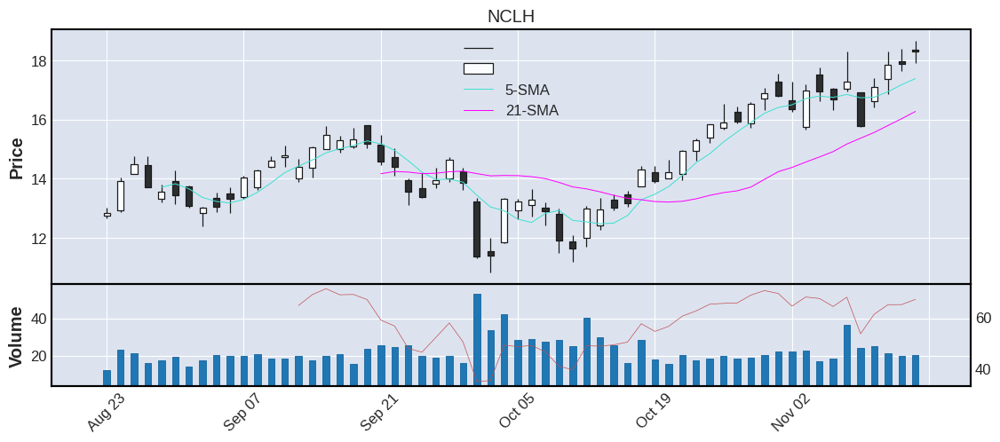



  TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG  ATR                  SECTOR           INDUSTRY  IPO CATEGORY  %ATR
1    BWA  42.79  40.56  76.01  41.34   36.0   37.62  2.44    2.31  1.93  1.3  Consumer_Discretionary  Auto Parts:O.E.M.  0.0   medium  3.04


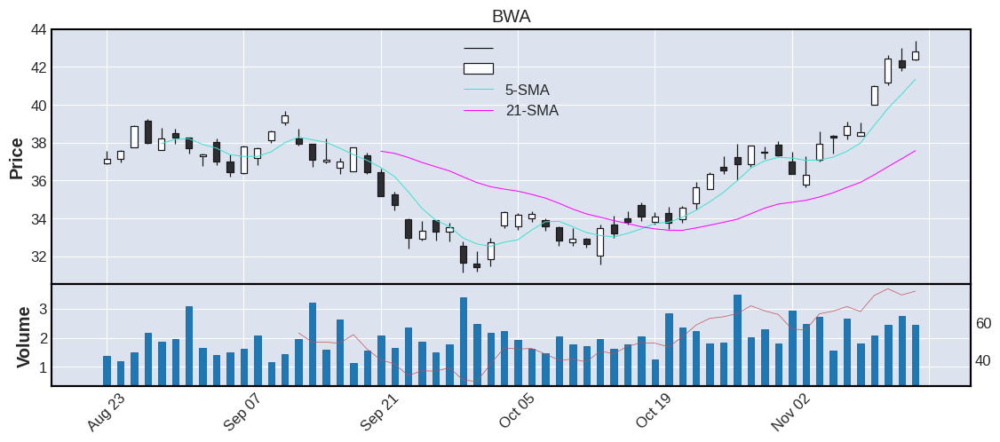



  TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR      SECTOR      INDUSTRY     IPO CATEGORY  %ATR
2   CDAY  72.68  64.93  67.33  64.77  59.87   60.19  2.58    3.11   8.3  4.16  Technology  EDP Services  2018.0   medium  5.72


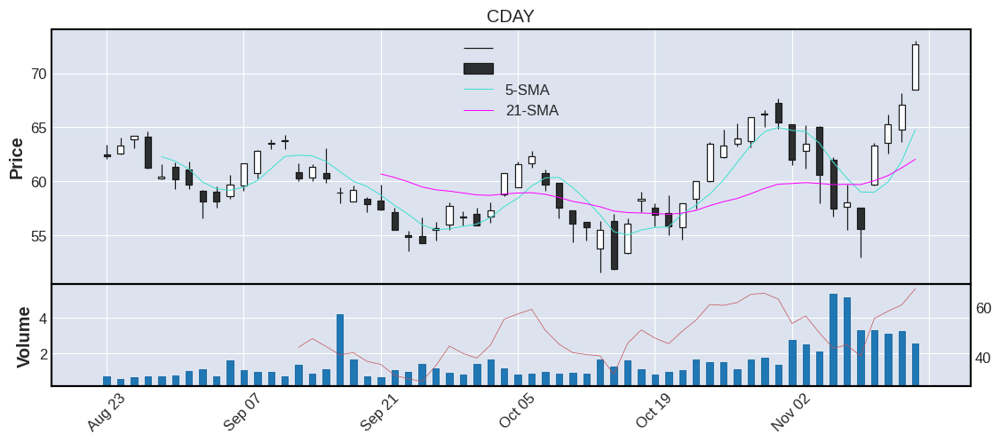



  TICKER    CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR                  SECTOR        INDUSTRY     IPO CATEGORY  %ATR
3   WYNN  78.4  73.66  69.24  74.95  64.42   68.31  2.67    4.29  0.42  3.77  Consumer_Discretionary  Hotels/Resorts  2002.0   medium  4.81


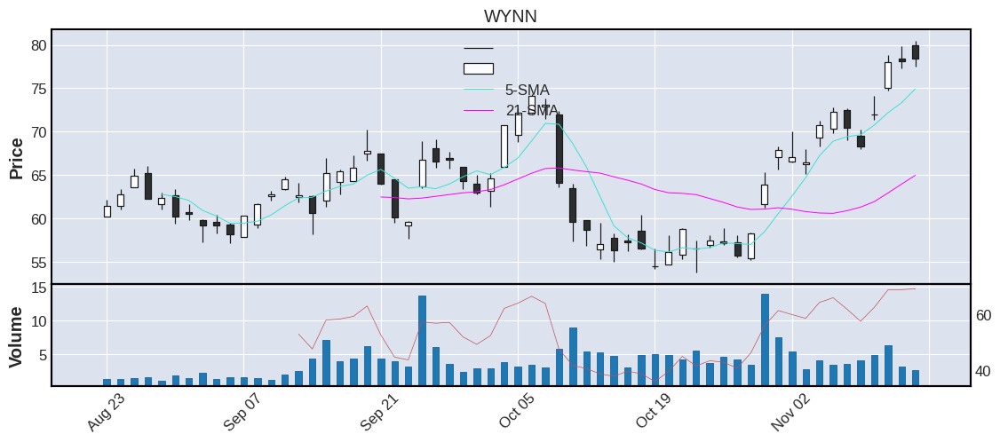



  TICKER      CP    EMA8    RSI    SMA5   SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                     INDUSTRY  IPO CATEGORY  %ATR
4    UHS  127.63  120.51  75.32  122.36  101.26  118.36  0.87    0.84  1.55  5.08  Health_Care  Hospital/Nursing Management  0.0   medium  3.98


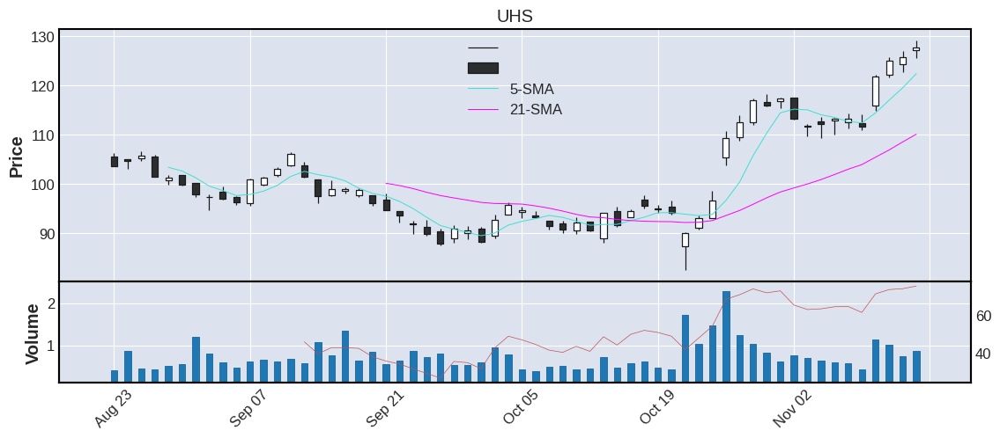

In [28]:
plot=True
tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
if plot:
    for c,i in enumerate(tick):print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')

# SNP-500



================================================== SECTOR 1: TECHNOLOGY [ %CHG ] ================================================== 

    TICKER      CP    RSI     VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
1    CDAY   72.68  67.33    2.58    3.11   8.3   4.16  5.72  Technology  2018.0  United States   medium
2    MTCH   51.92  60.62    5.18    4.84  6.66   3.13  6.03  Technology     0.0  United States    large
3    PAYC  347.19  56.88    0.45    0.48  5.27  18.24  5.25  Technology  2014.0            N-A    large
4     TYL  337.20  56.92    0.38    0.41  5.26  12.26  3.64  Technology     0.0  United States    large
5     NOW  419.48  58.64    1.82    1.92  4.77  22.17  5.29  Technology  2012.0  United States    large
6    MPWR  405.03  64.99    0.60    0.71   4.4  18.36  4.53  Technology  2004.0  United States    large
7    QCOM  126.02  61.03   12.47   10.02  4.32   5.20  4.13  Technology  1991.0  United States    large
8    ADSK  232.30  65.83    1.9

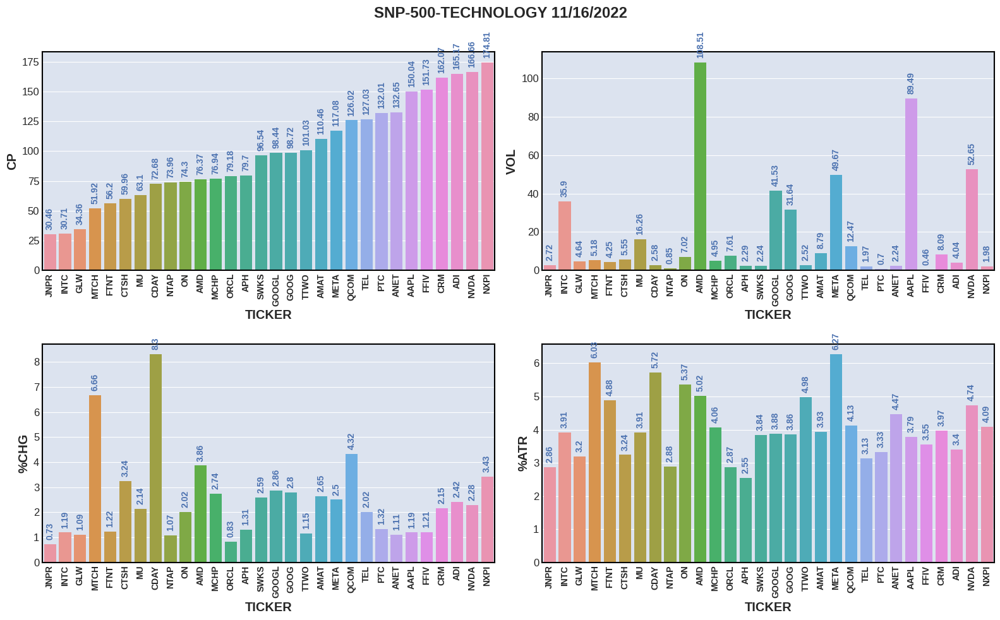

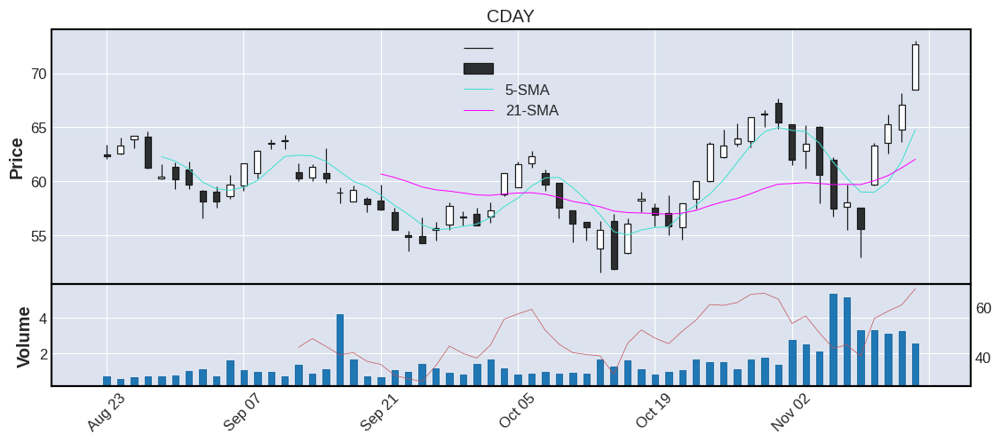



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
2   MTCH  51.92  60.62  5.18    4.84  6.66  3.13  6.03  Technology  0.0  United States    large


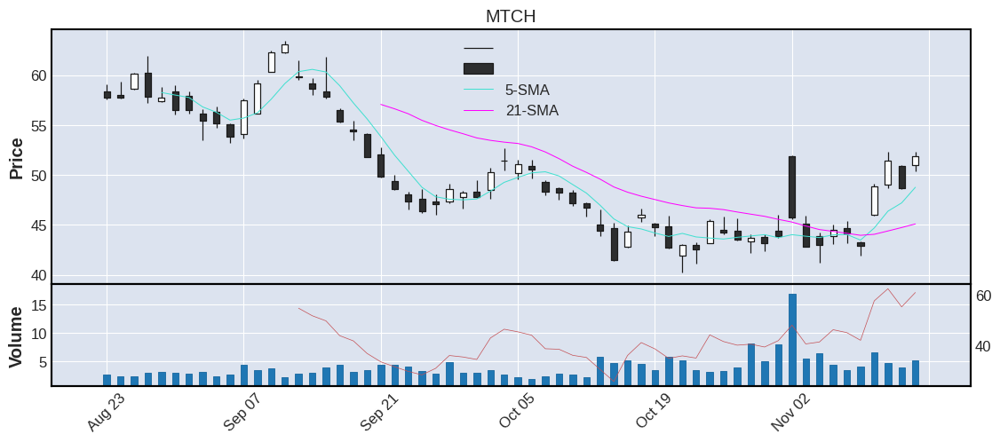



  TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO COUNTRY CATEGORY
3   PAYC  347.19  56.88  0.45    0.48  5.27  18.24  5.25  Technology  2014.0     N-A    large


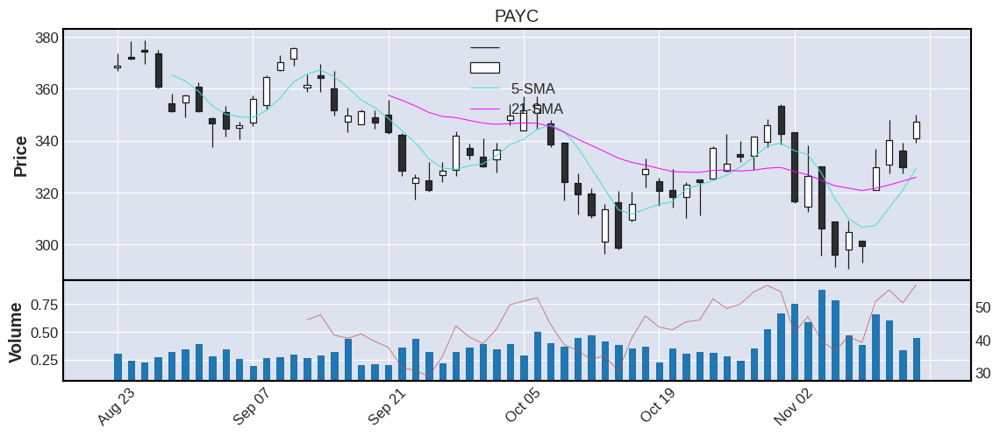



  TICKER     CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
4    TYL  337.2  56.92  0.38    0.41  5.26  12.26  3.64  Technology  0.0  United States    large


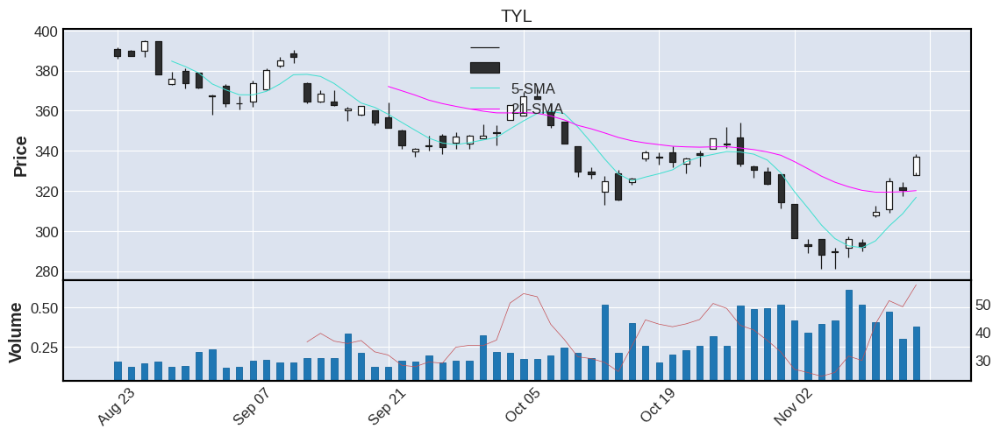



  TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
5    NOW  419.48  58.64  1.82    1.92  4.77  22.17  5.29  Technology  2012.0  United States    large


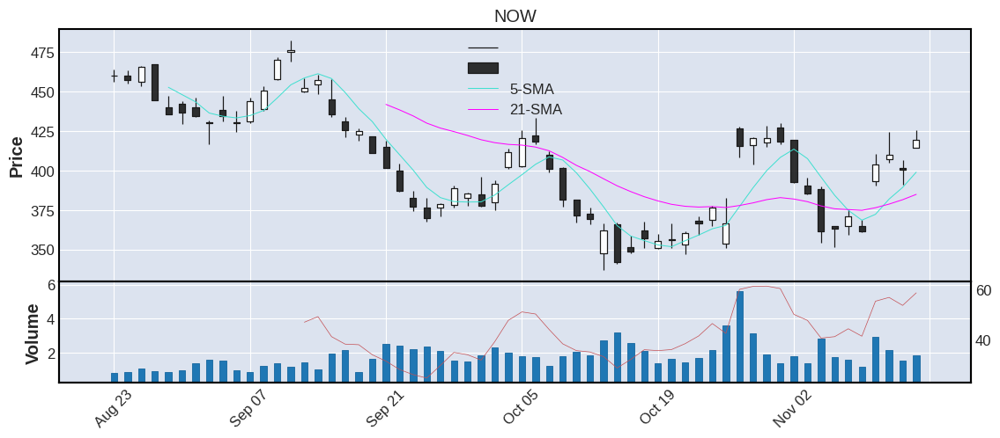



  TICKER      CP    RSI  VOL  AVGVOL %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
6   MPWR  405.03  64.99  0.6    0.71  4.4  18.36  4.53  Technology  2004.0  United States    large


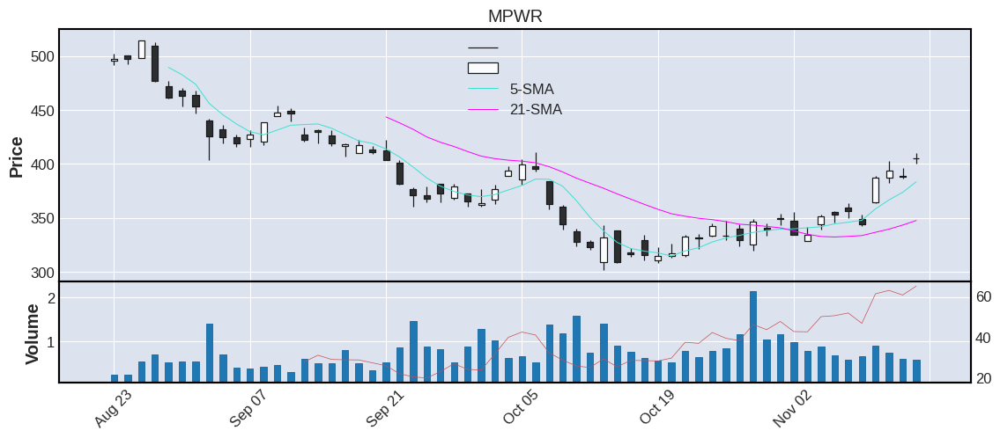



  TICKER      CP    RSI    VOL  AVGVOL  %CHG  ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
7   QCOM  126.02  61.03  12.47   10.02  4.32  5.2  4.13  Technology  1991.0  United States    large


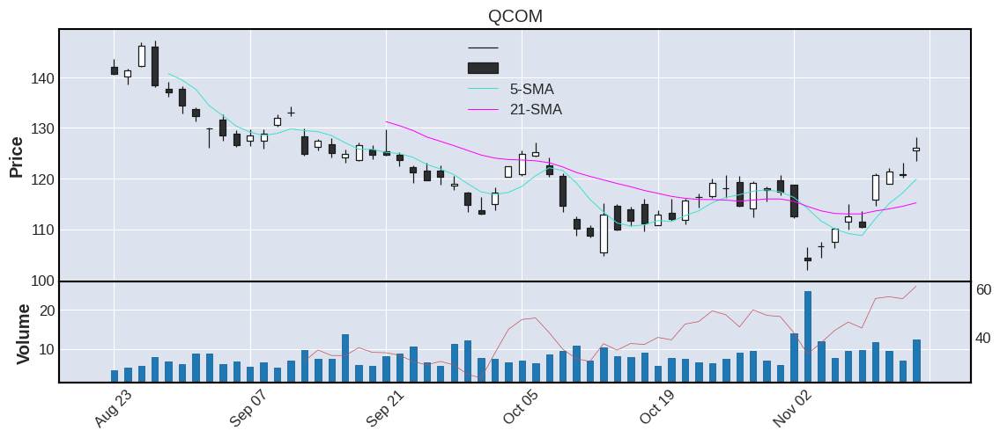



  TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
8   ADSK  232.3  65.83  1.9    1.69  4.03  9.26  3.99  Technology  0.0  United States    large


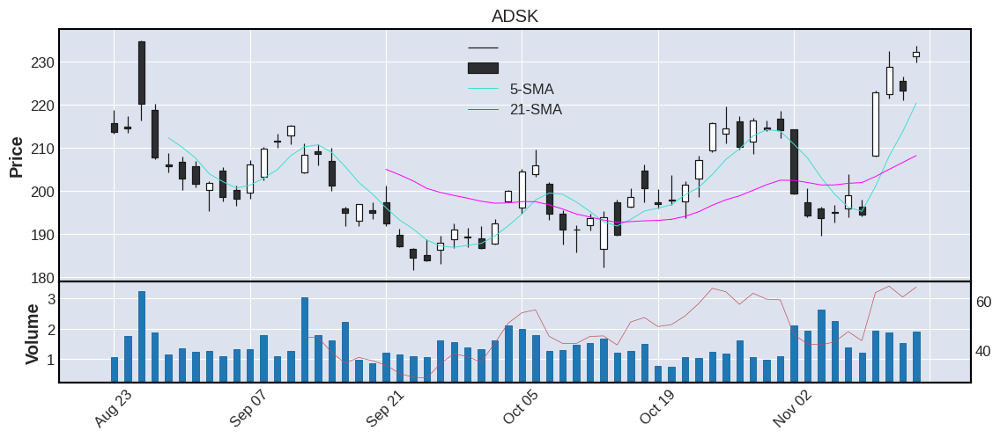



  TICKER      CP    RSI  VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
9   ZBRA  261.59  51.78  0.7    0.58  4.02  13.42  5.13  Technology  1991.0  United States    large


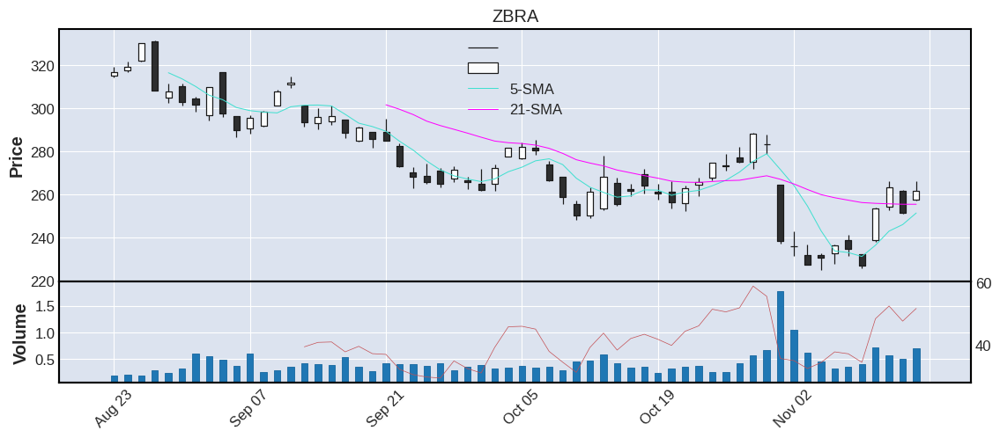



   TICKER      CP    RSI  VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
10    NOC  500.72  45.13  1.9    1.64  3.94  17.34  3.46  Technology  0.0  United States    large


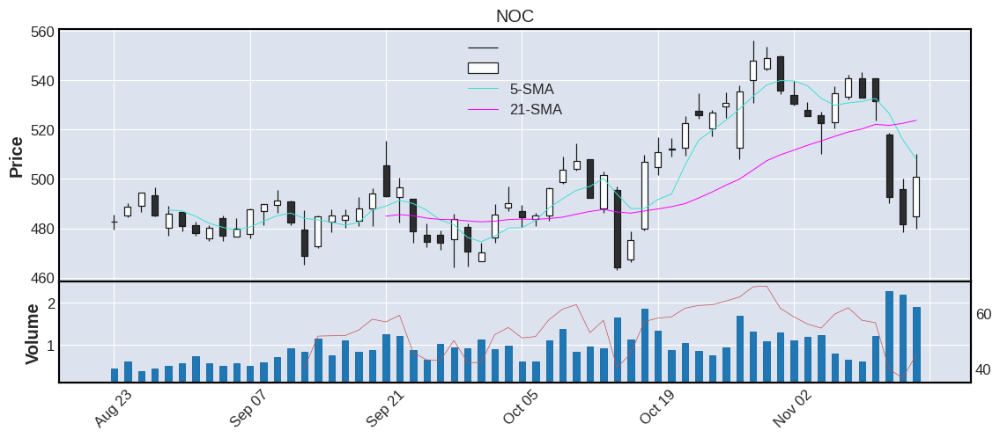



   TICKER     CP    RSI     VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
11    AMD  76.37  69.15  108.51   100.0  3.86  3.83  5.02  Technology  0.0  United States    large


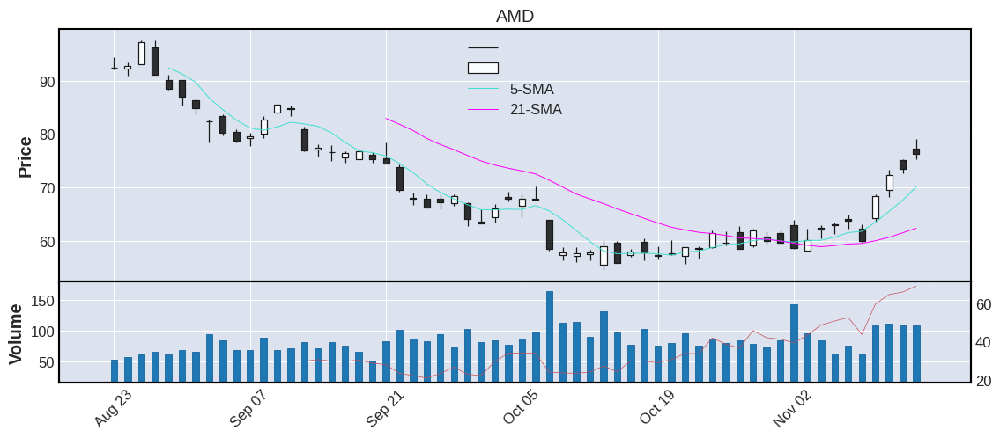



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO      COUNTRY CATEGORY
12   NXPI  174.81  65.77  1.98    2.72  3.43  7.15  4.09  Technology  2010.0  Netherlands    large


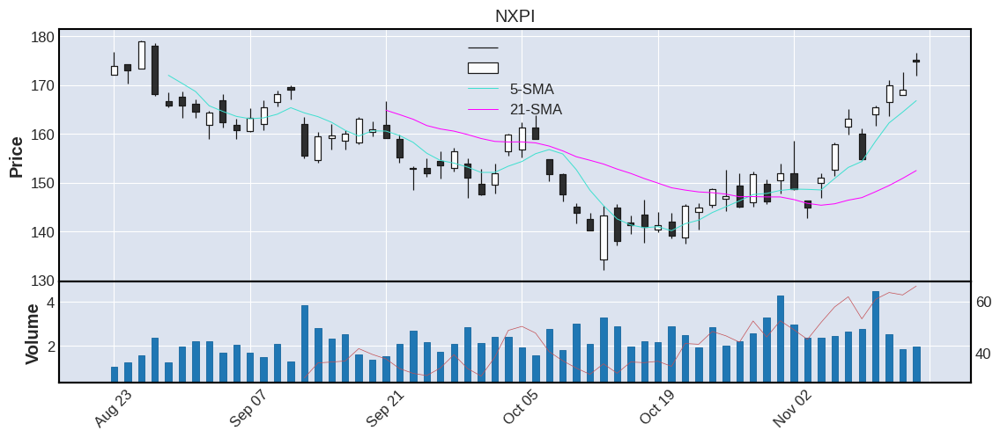



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
13   CTSH  59.96  54.25  5.55    4.98  3.24  1.94  3.24  Technology  1998.0  United States    large


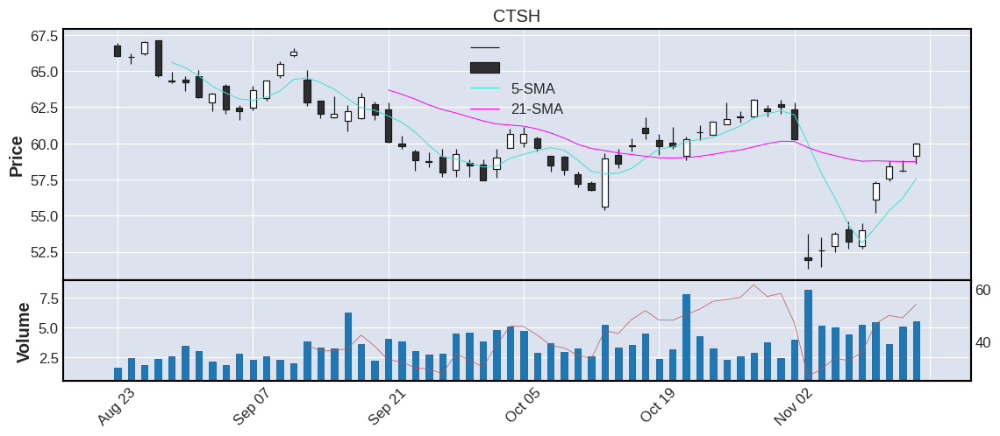



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
14  GOOGL  98.44  55.18  41.53   37.64  2.86  3.82  3.88  Technology  2004.0  United States     mega


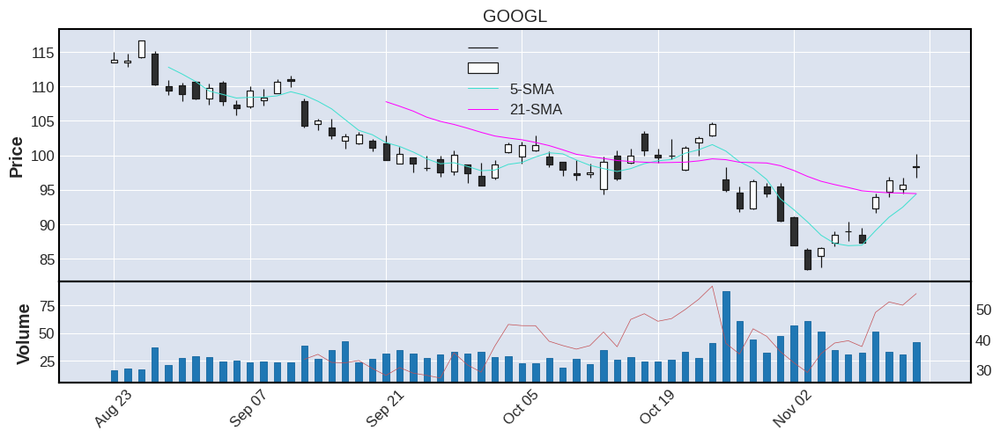



   TICKER     CP    RSI    VOL  AVGVOL %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
15   GOOG  98.72  55.08  31.64   31.09  2.8  3.81  3.86  Technology  2004.0  United States     mega


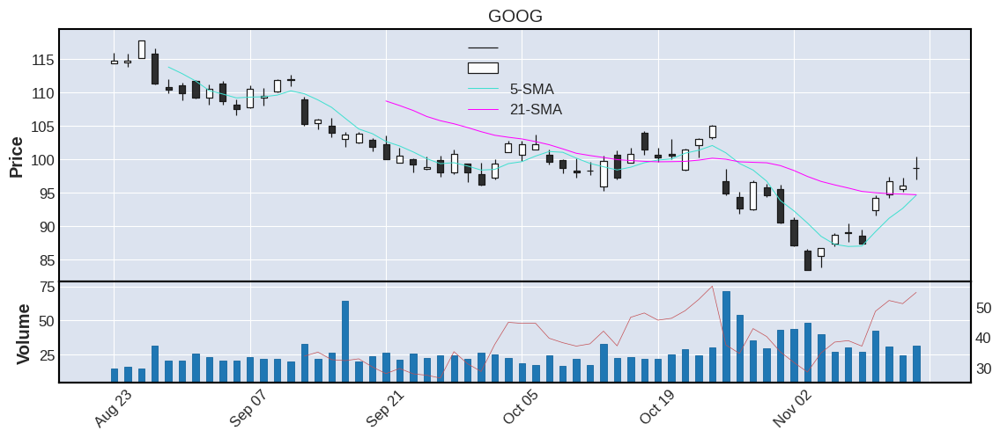



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
16   MCHP  76.94  71.03  4.95    6.17  2.74  3.12  4.06  Technology  1993.0  United States    large


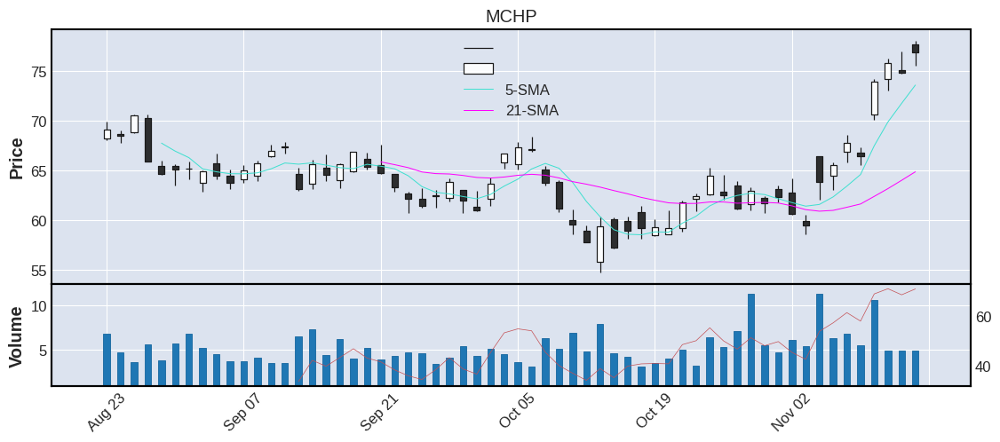



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
17   VRSN  195.53  59.53  0.49    0.62  2.67  6.25   3.2  Technology  1998.0  United States    large


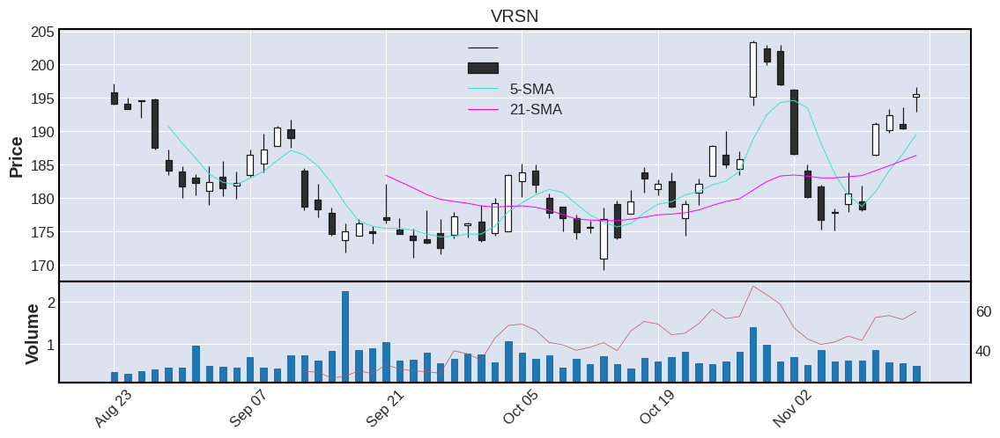



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
18   AMAT  110.46  71.34  8.79    9.25  2.65  4.34  3.93  Technology  1972.0  United States    large


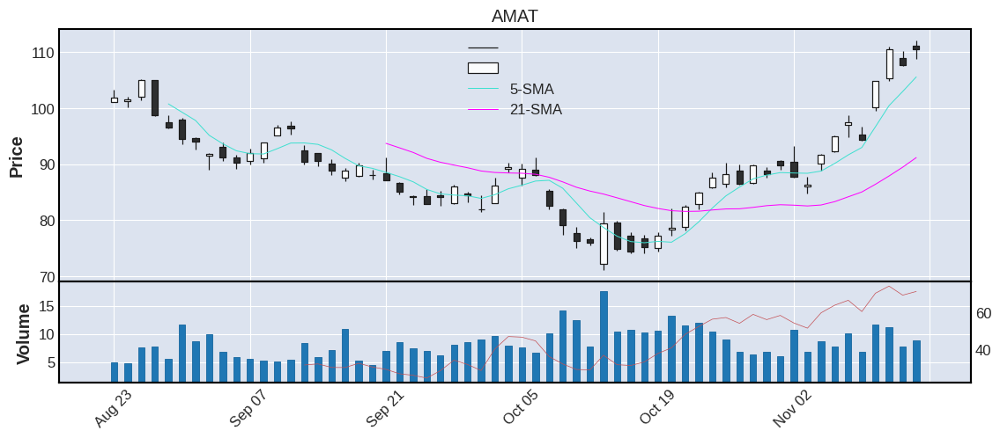



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
19   SWKS  96.54  61.78  2.24    2.35  2.59  3.71  3.84  Technology  0.0  United States    large


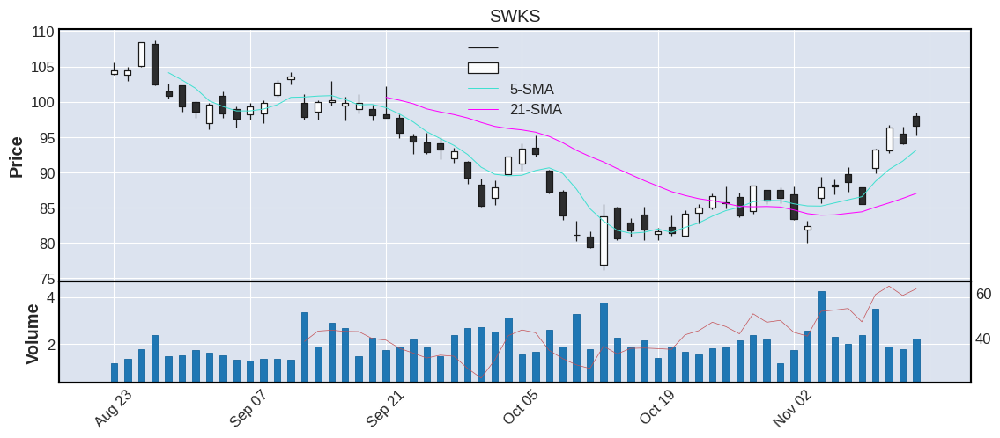



   TICKER      CP   RSI    VOL  AVGVOL %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
20   META  117.08  52.0  49.67   70.25  2.5  7.34  6.27  Technology  2012.0  United States     mega


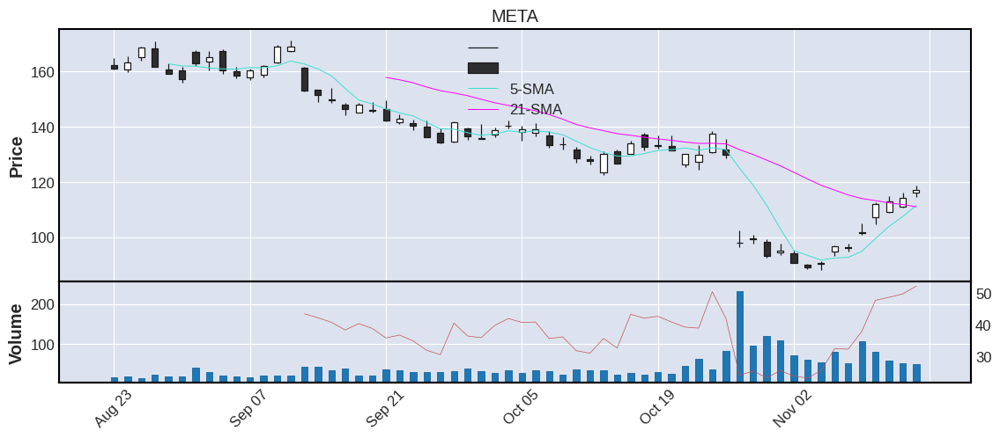



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
21    ADI  165.17  66.58  4.04    4.17  2.42  5.62   3.4  Technology  0.0  United States    large


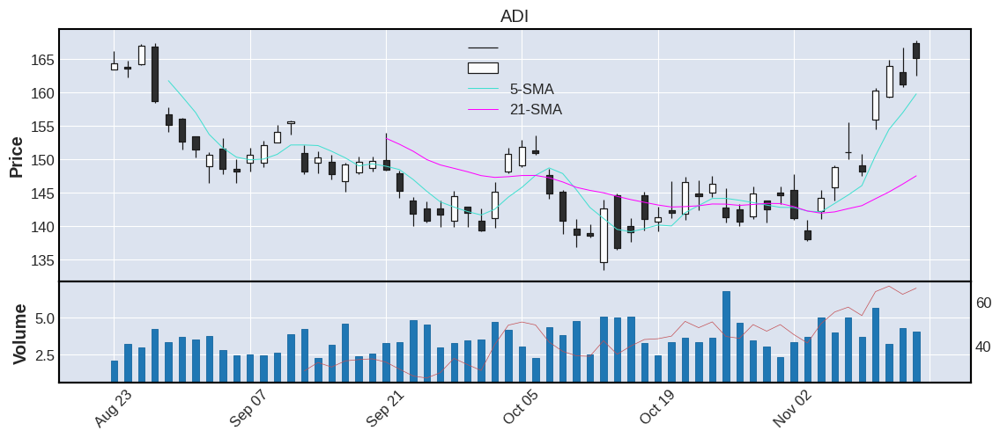



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
22   INTU  407.02  52.57  2.08    2.03  2.35  19.05  4.68  Technology  1993.0  United States    large


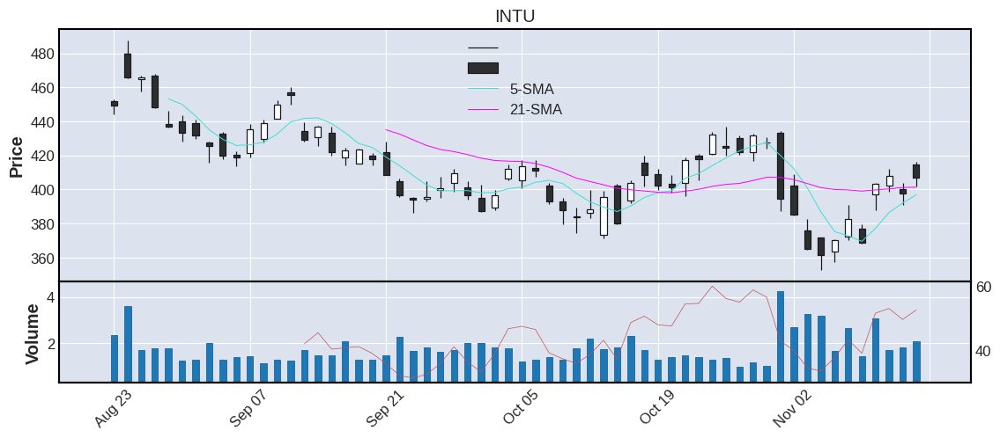



   TICKER      CP    RSI    VOL  AVGVOL  %CHG  ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
23   NVDA  166.66  71.98  52.65   57.29  2.28  7.9  4.74  Technology  1999.0  United States     mega


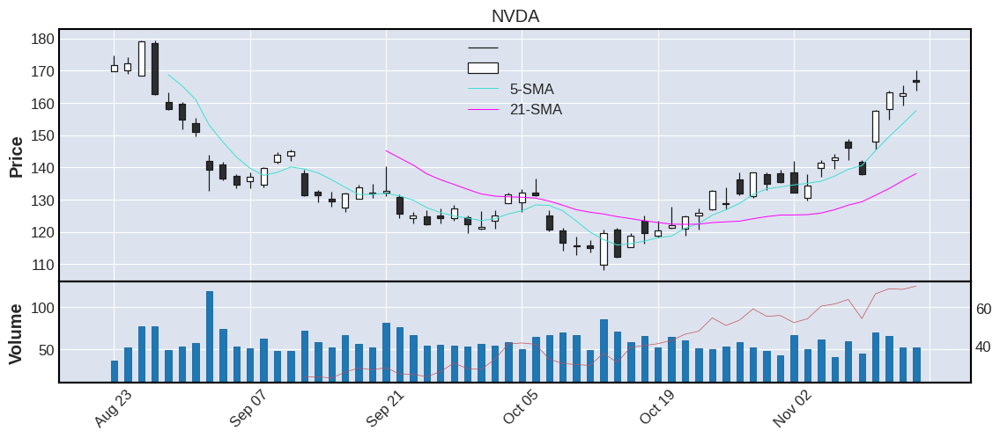



   TICKER      CP   RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
24   AVGO  524.42  67.0  2.33    2.59  2.18  16.96  3.23  Technology  2009.0  United States    large


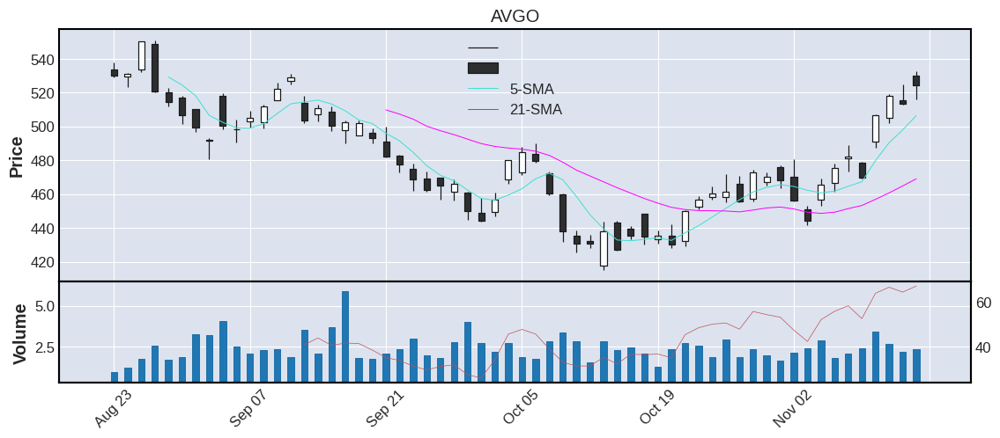



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
25    CRM  162.07  57.95  8.09    7.28  2.15  6.43  3.97  Technology  2004.0  United States    large


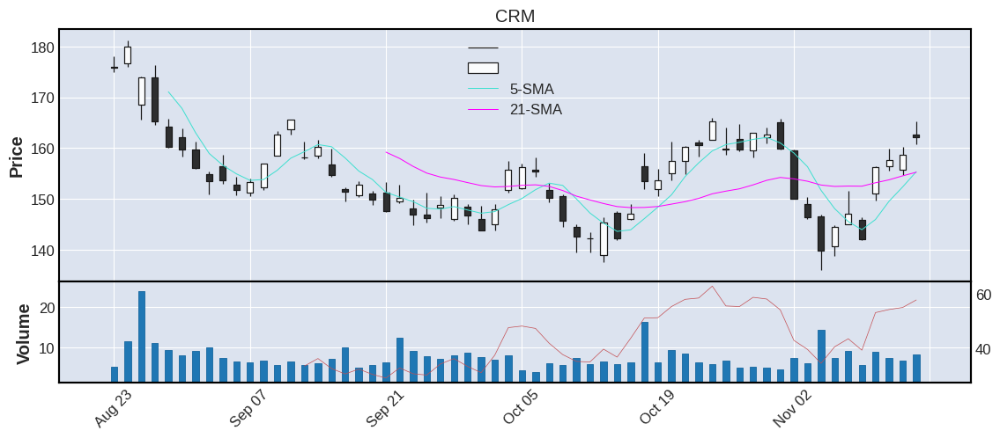



   TICKER    CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
26     MU  63.1  68.37  16.26   18.55  2.14  2.47  3.91  Technology  0.0  United States    large


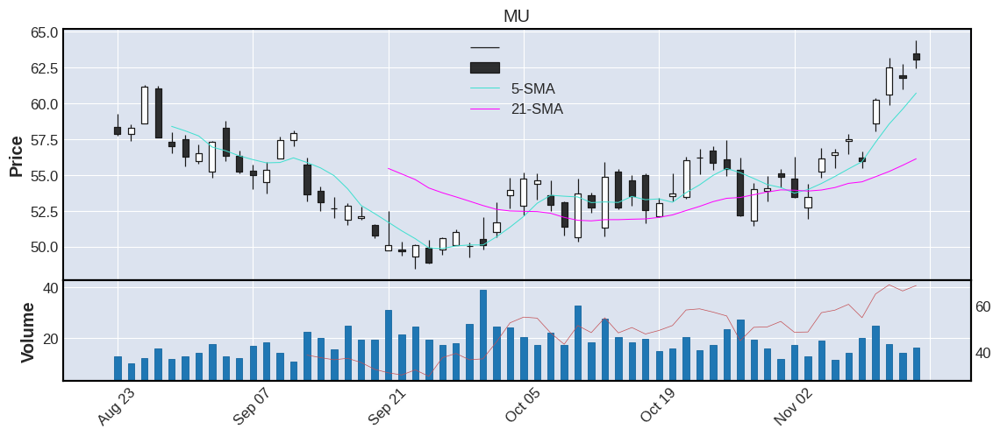



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
27   JKHY  181.2  45.63  0.57     0.8  2.12  5.76  3.18  Technology  1985.0  United States    large


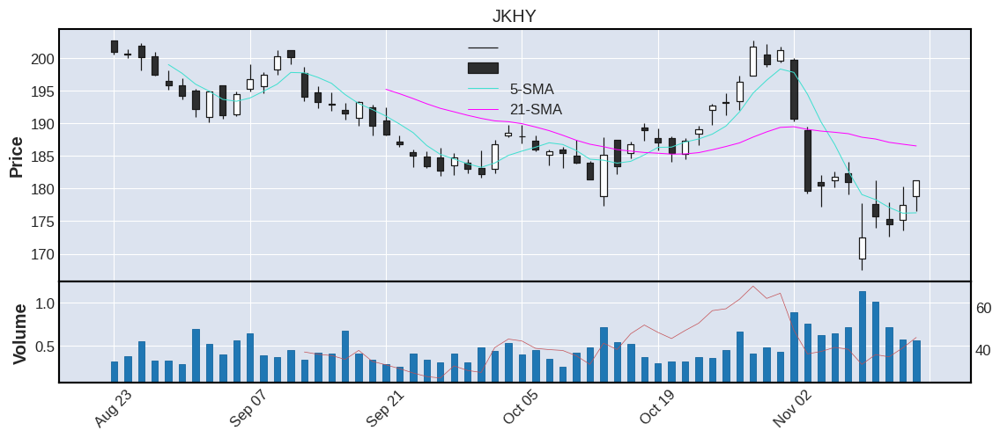



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
28   LRCX  490.74  69.18  2.22    2.52  2.09  21.08   4.3  Technology  1984.0  United States    large


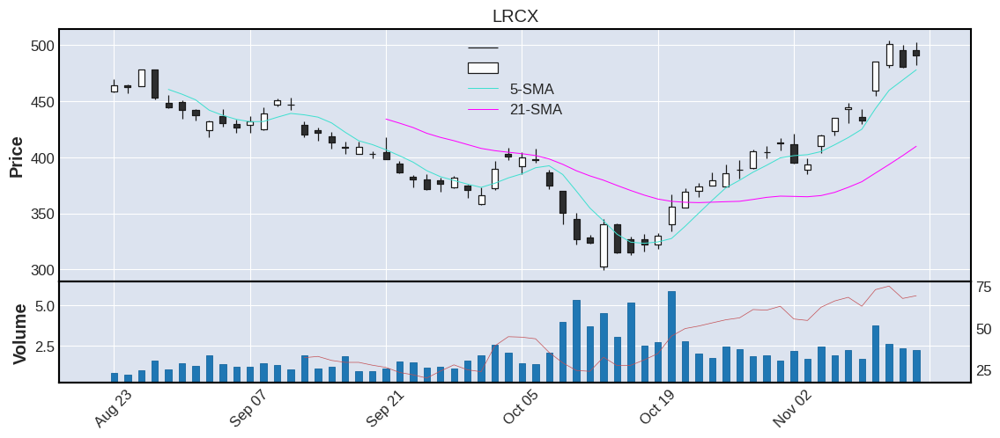



   TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
29     ON  74.3  62.17  7.02    8.08  2.02  3.99  5.37  Technology  0.0  United States    large


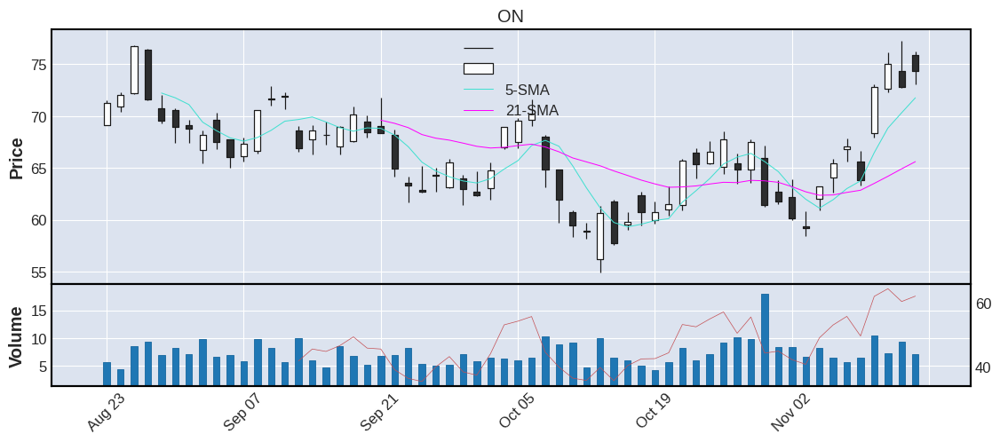



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
30   KLAC  385.55  75.15  1.69    1.76  2.02  13.14  3.41  Technology  1980.0  United States    large


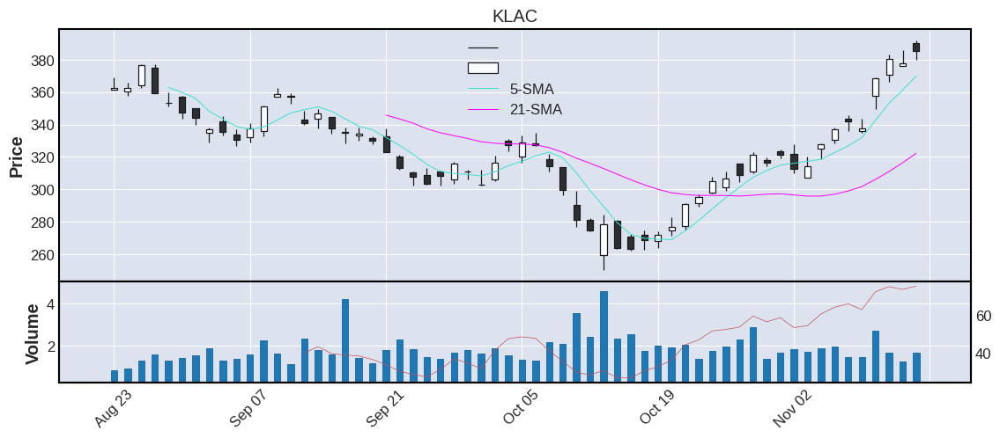



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO      COUNTRY CATEGORY
31    TEL  127.03  63.42  1.97    2.19  2.02  3.98  3.13  Technology  0.0  Switzerland    large


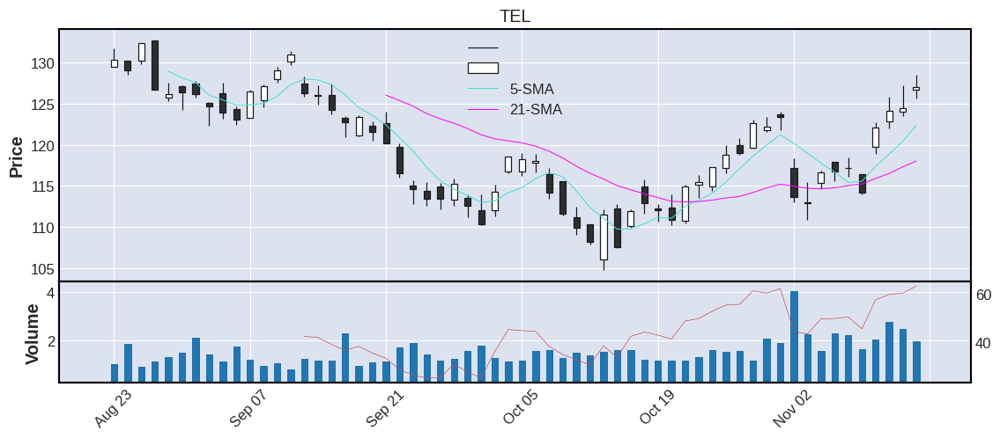



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
32   ADBE  345.96  65.89  2.95    3.76  1.64  12.21  3.53  Technology  1986.0  United States    large


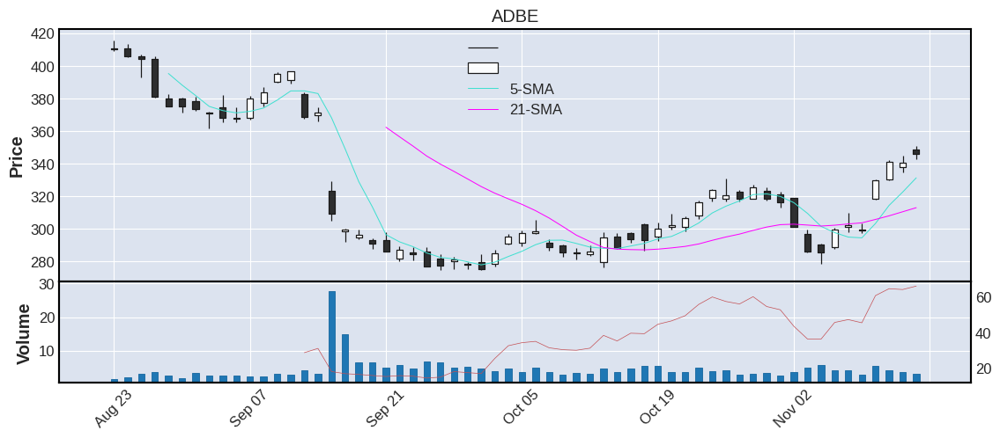



   TICKER     CP    RSI  VOL  AVGVOL  %CHG  ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
33    FLT  195.6  59.15  0.4     0.7  1.45  7.1  3.63  Technology  2010.0  United States    large


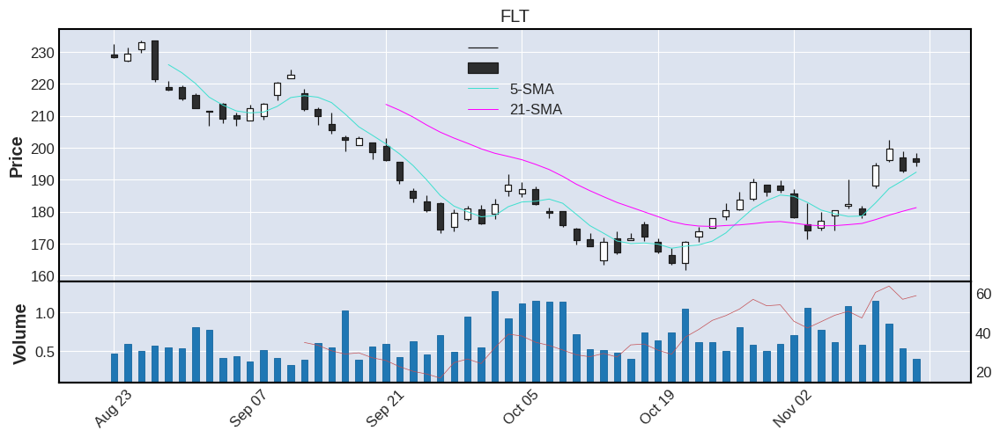



   TICKER      CP   RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO COUNTRY CATEGORY
34   SEDG  287.97  68.7  0.88    1.69  1.39  16.08  5.58  Technology  2015.0  Israel    large


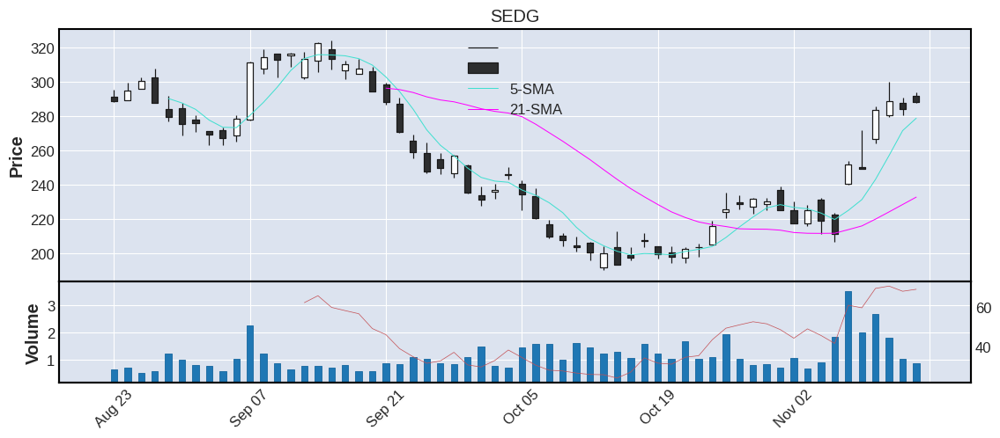



   TICKER      CP   RSI  VOL  AVGVOL  %CHG  ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
35    PTC  132.01  73.9  0.7     0.9  1.32  4.4  3.33  Technology  0.0  United States    large


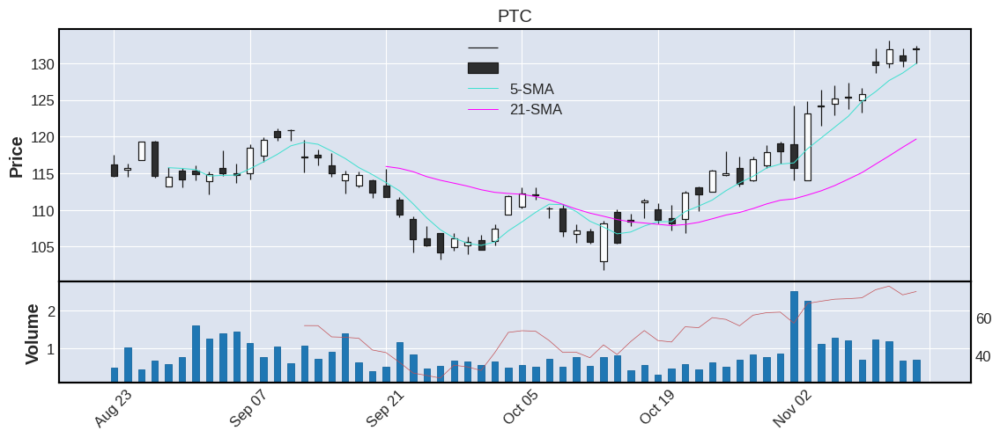



   TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
36    APH  79.7  65.56  2.29    2.44  1.31  2.03  2.55  Technology  0.0  United States    large


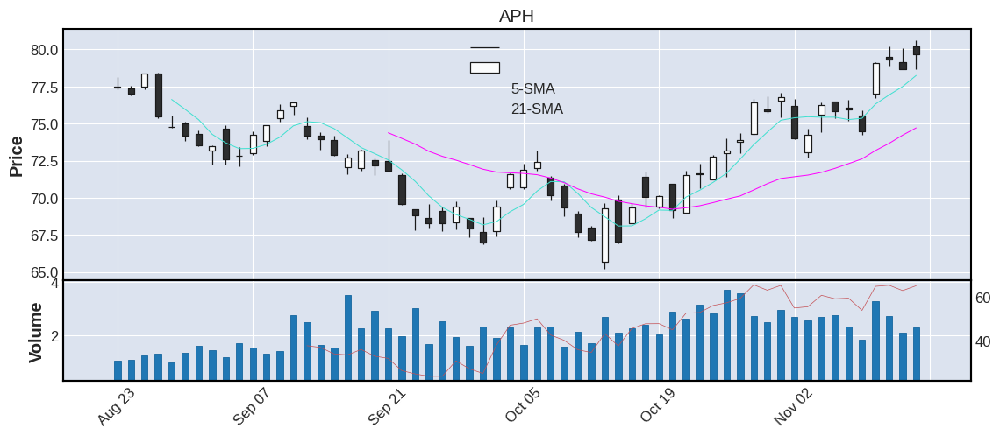



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO  COUNTRY CATEGORY
37    ACN  292.65  62.56  1.96    2.41  1.29  8.83  3.02  Technology  2001.0  Ireland    large


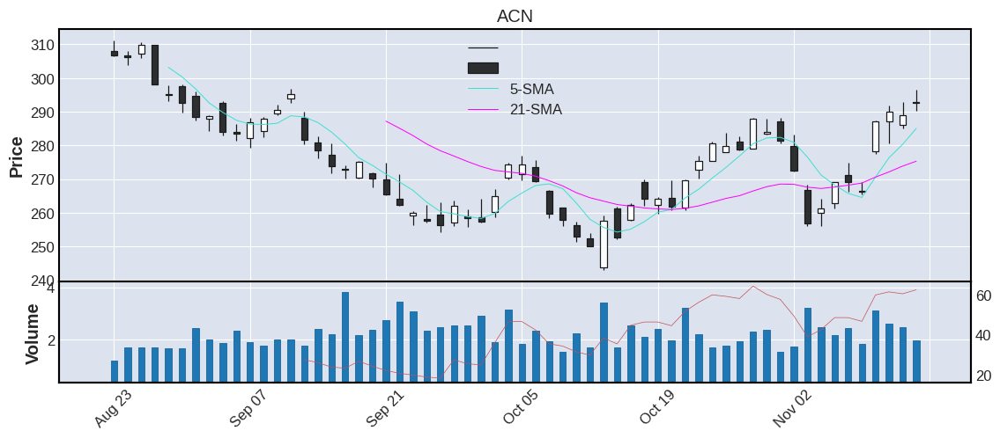



   TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
38   FTNT  56.2  58.72  4.25    5.67  1.22  2.74  4.88  Technology  2009.0  United States    large


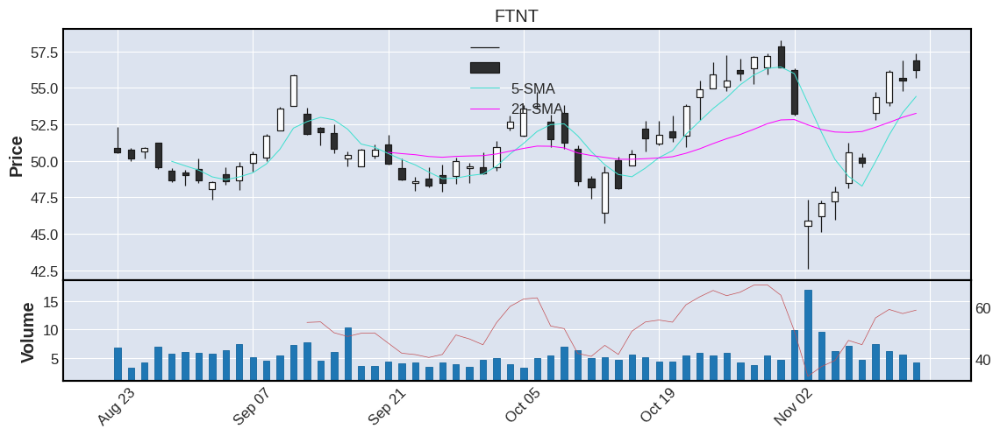



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
39   FFIV  151.73  58.81  0.46    0.56  1.21  5.39  3.55  Technology  1999.0  United States   medium


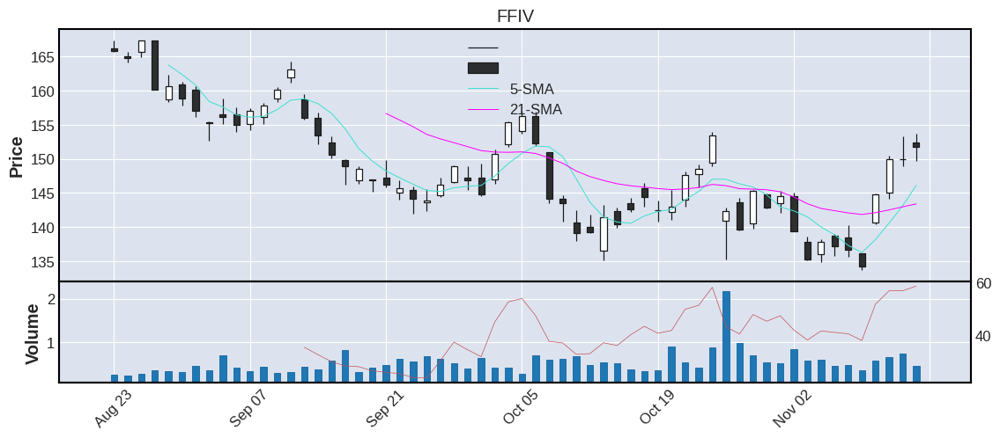



   TICKER      CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
40   AAPL  150.04  54.73  89.49   90.11  1.19  5.68  3.79  Technology  1980.0  United States     mega


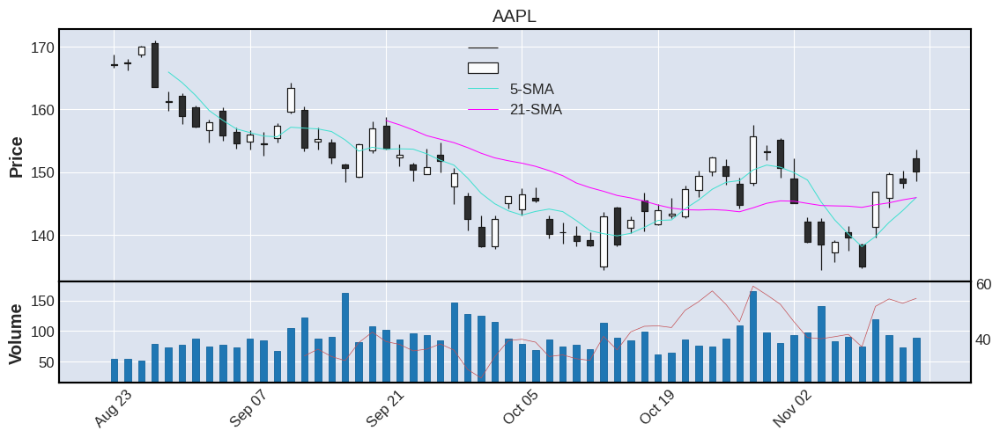



   TICKER     CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
41   INTC  30.71  64.29  35.9   43.72  1.19  1.2  3.91  Technology  0.0  United States    large


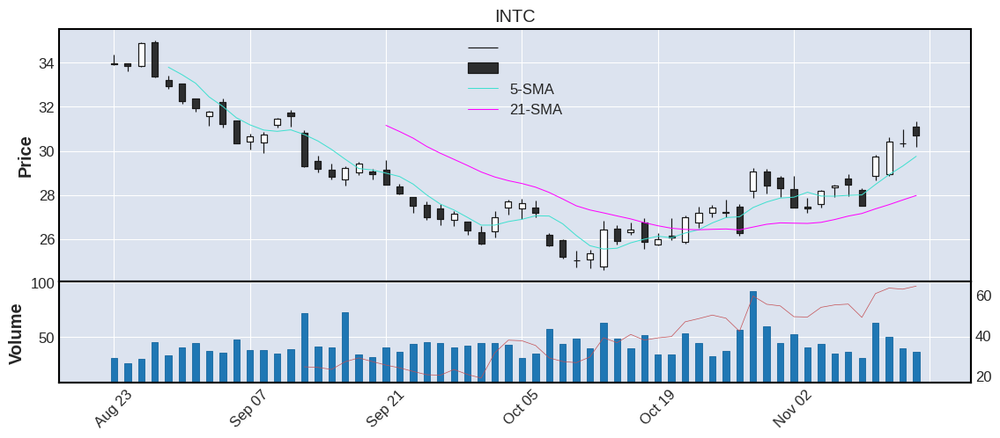



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
42   TTWO  101.03  36.63  2.52     3.3  1.15  5.03  4.98  Technology  1997.0  United States    large


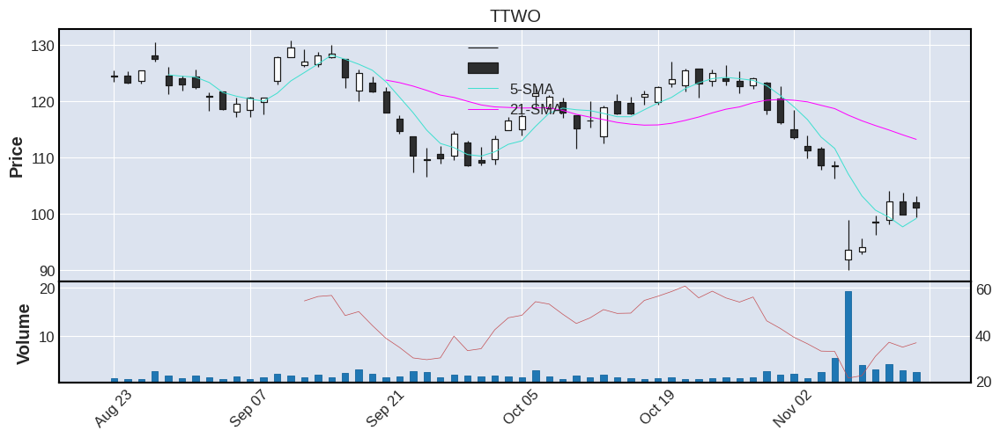



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO COUNTRY CATEGORY
43   ANET  132.65  63.8  2.24    3.02  1.11  5.93  4.47  Technology  2014.0     N-A    large


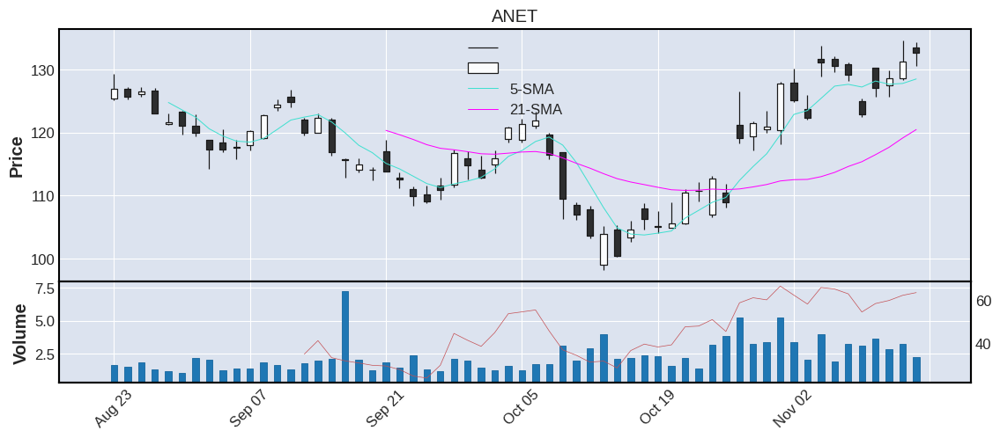



   TICKER     CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
44    GLW  34.36  62.33  4.64    4.61  1.09  1.1   3.2  Technology  0.0  United States    large


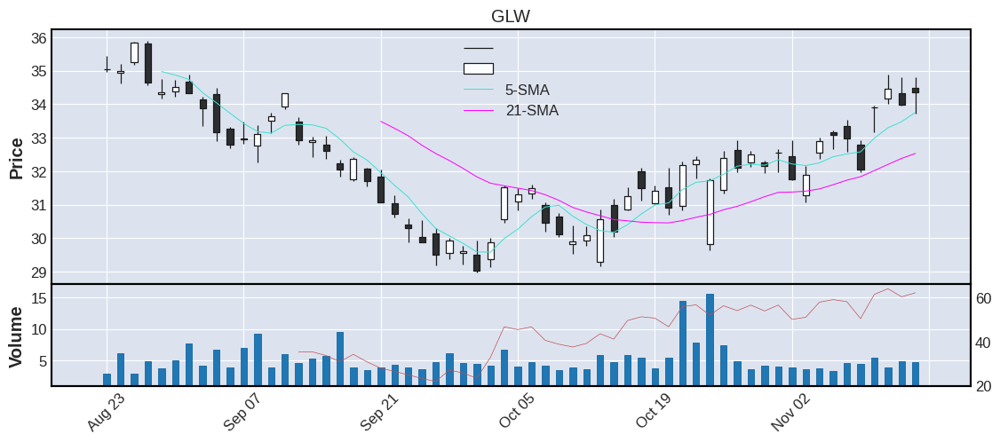



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
45   NTAP  73.96  66.66  0.85    1.27  1.07  2.13  2.88  Technology  1995.0  United States    large


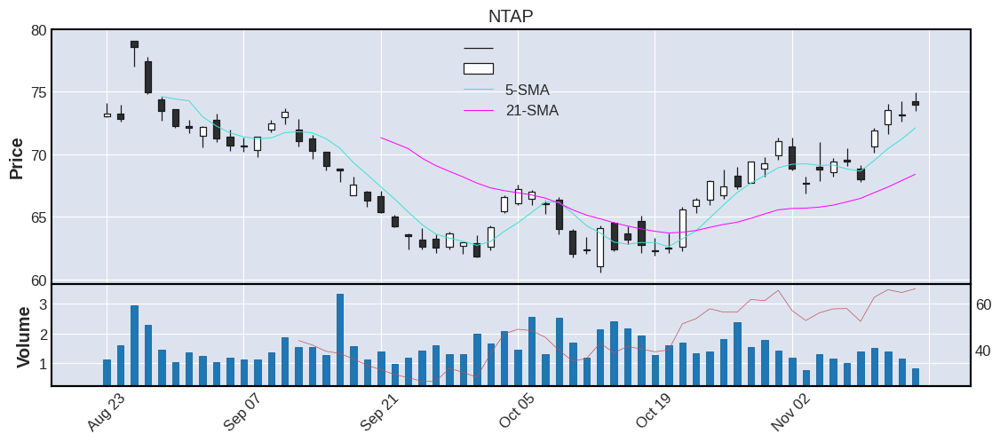



   TICKER     CP    RSI  VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
46   SNPS  334.2  68.26  0.7    1.04  1.06  10.83  3.24  Technology  1992.0  United States    large


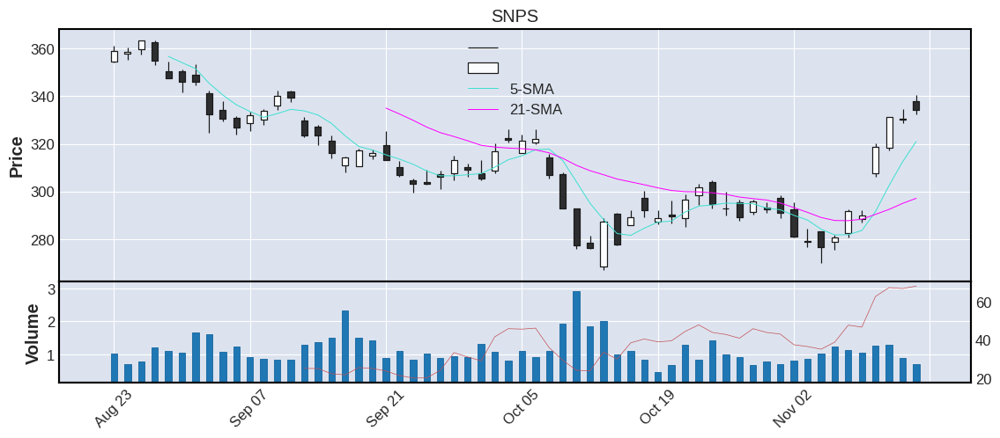



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
47   ANSS  254.21  68.38  0.65    0.82  0.94  8.43  3.32  Technology  1996.0  United States    large


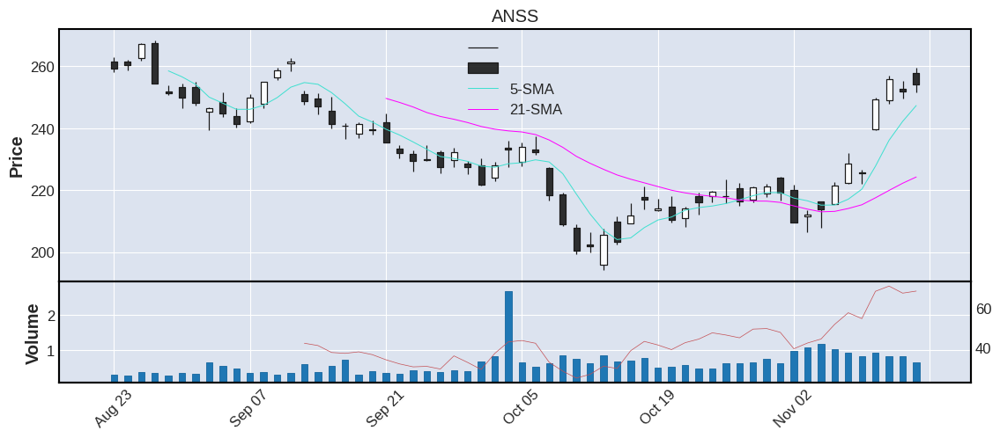



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
48   ENPH  300.73  56.93  3.03    4.03  0.94  19.62  6.52  Technology  2012.0  United States    large


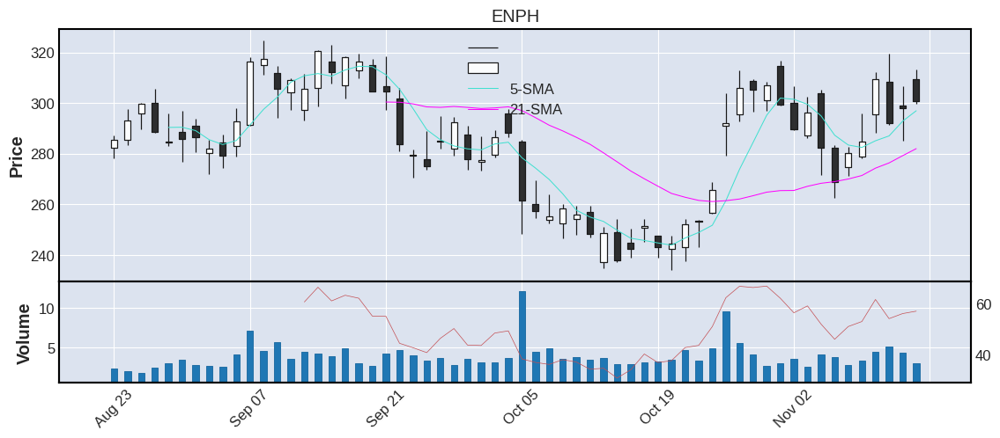



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
49   ORCL  79.18  69.85  7.61    7.79  0.83  2.27  2.87  Technology  1986.0  United States     mega


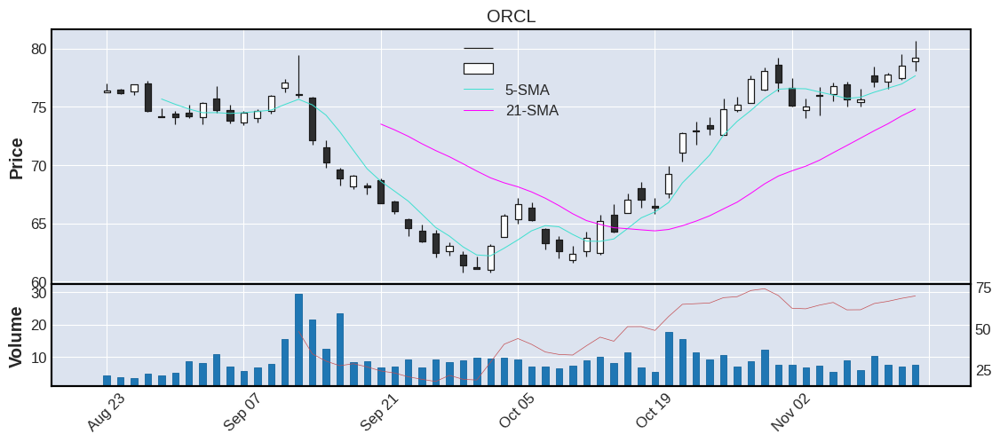



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
50   JNPR  30.46  59.66  2.72    2.89  0.73  0.87  2.86  Technology  1999.0  United States   medium


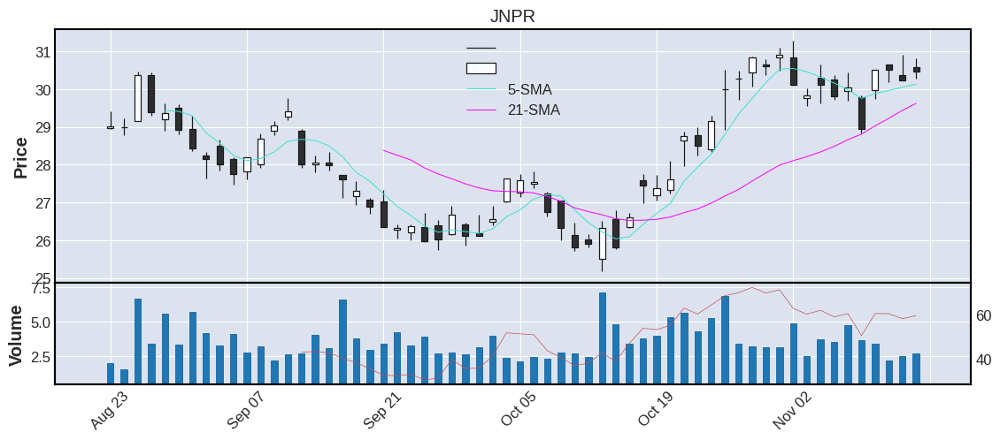



================================================== SECTOR 2: HEALTH_CARE [ %CHG ] ================================================== 

    TICKER      CP    RSI    VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
1    CTLT   48.91  35.26   3.78    3.56   4.6   3.62  7.40  Health_Care  2014.0  United States   medium
2    MRNA  185.47  77.52   5.10    4.82   3.6   9.44  5.09  Health_Care  2018.0  United States    large
3      EW   75.96  47.04   7.60    6.42  3.33   3.39  4.46  Health_Care     0.0  United States    large
4    XRAY   31.34  57.18   3.26    3.65  3.26   1.49  4.75  Health_Care  1987.0  United States   medium
5    DXCM  116.31  60.57   2.25    2.86  2.94   5.52  4.75  Health_Care  2005.0  United States    large
6     HCA  229.05  63.96   1.57    1.34  2.89   8.46  3.69  Health_Care  2011.0  United States    large
7     TFX  215.02  55.36   0.49    0.42  2.39   7.94  3.69  Health_Care     0.0  United States   medium
8     ZTS  149.82  53.77   2.9

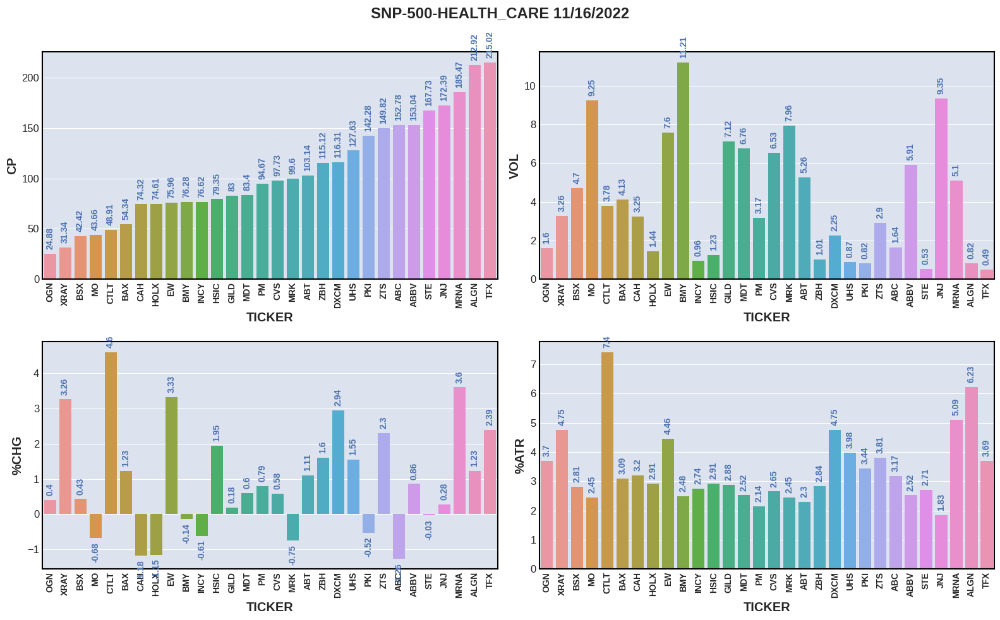

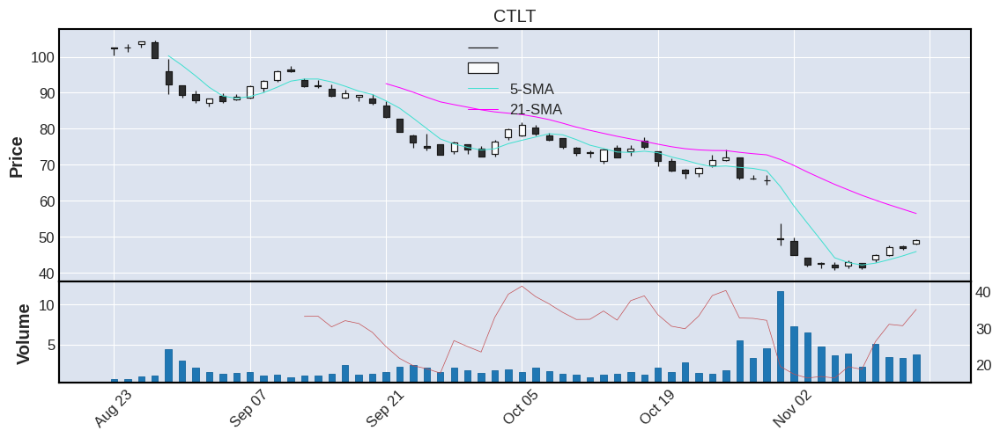



  TICKER      CP    RSI  VOL  AVGVOL %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
2   MRNA  185.47  77.52  5.1    4.82  3.6  9.44  5.09  Health_Care  2018.0  United States    large


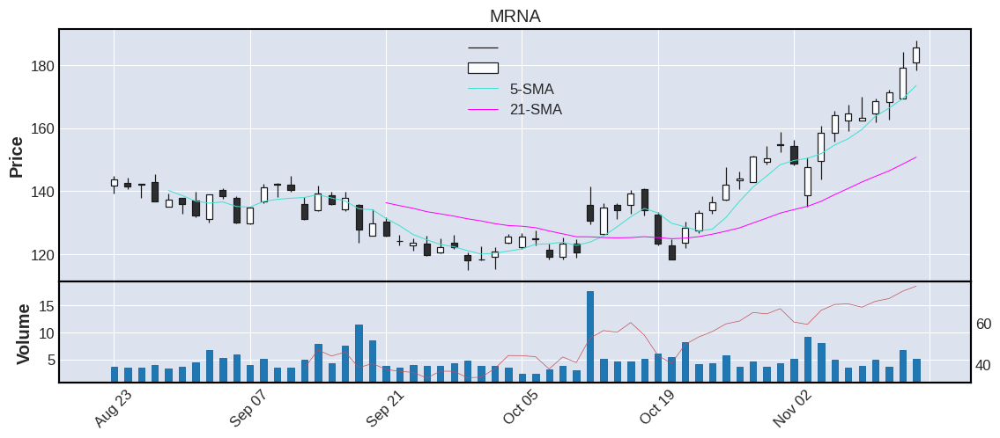



  TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
3     EW  75.96  47.04  7.6    6.42  3.33  3.39  4.46  Health_Care  0.0  United States    large


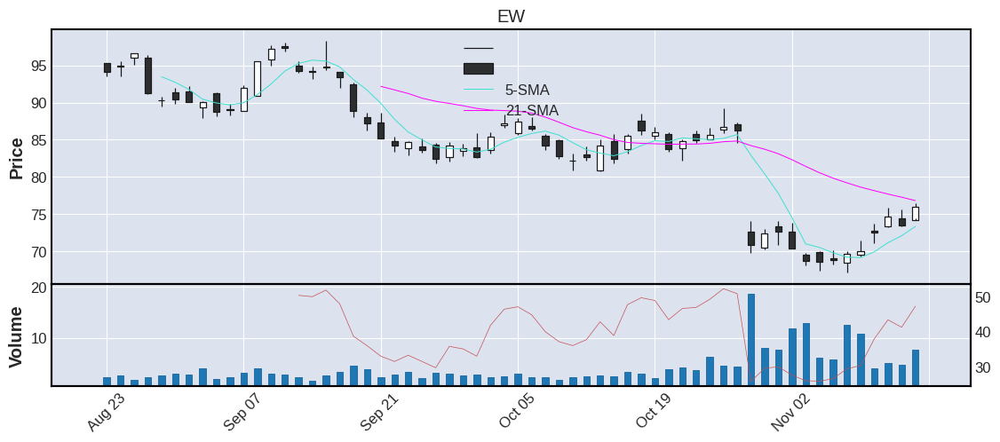



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
4   XRAY  31.34  57.18  3.26    3.65  3.26  1.49  4.75  Health_Care  1987.0  United States   medium


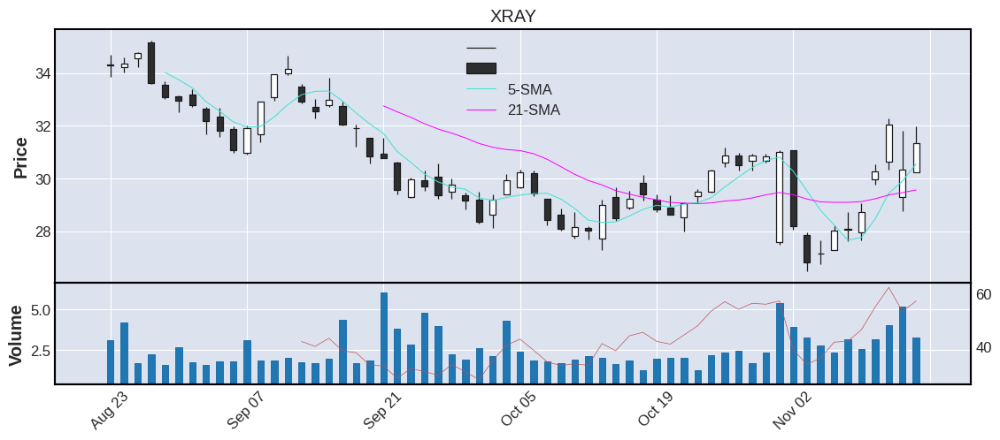



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
5   DXCM  116.31  60.57  2.25    2.86  2.94  5.52  4.75  Health_Care  2005.0  United States    large


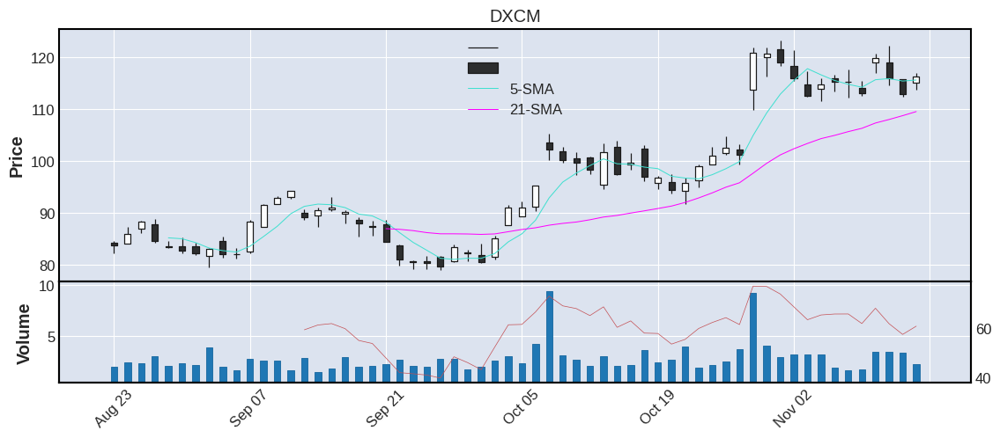



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
6    HCA  229.05  63.96  1.57    1.34  2.89  8.46  3.69  Health_Care  2011.0  United States    large


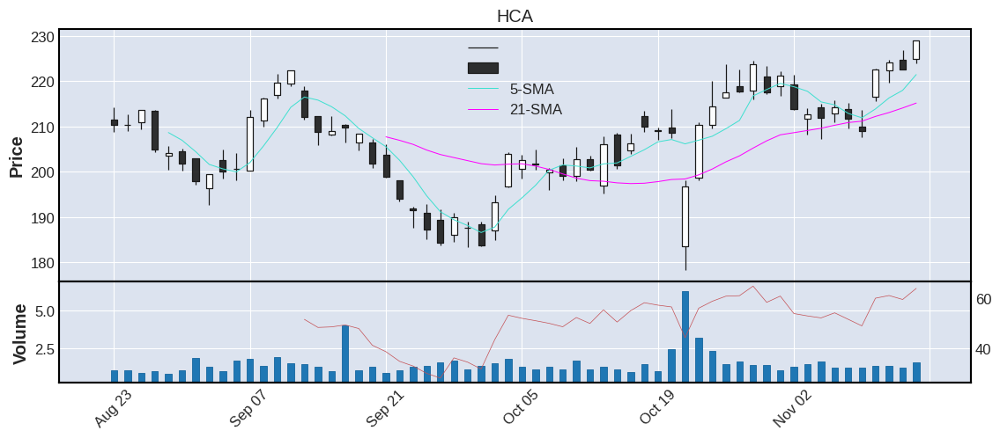



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
7    TFX  215.02  55.36  0.49    0.42  2.39  7.94  3.69  Health_Care  0.0  United States   medium


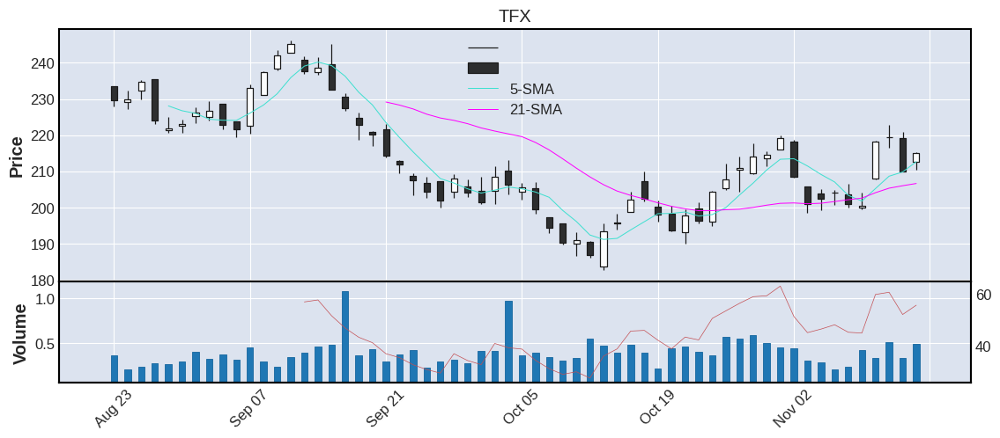



  TICKER      CP    RSI  VOL  AVGVOL %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
8    ZTS  149.82  53.77  2.9    3.42  2.3  5.71  3.81  Health_Care  2013.0  United States    large


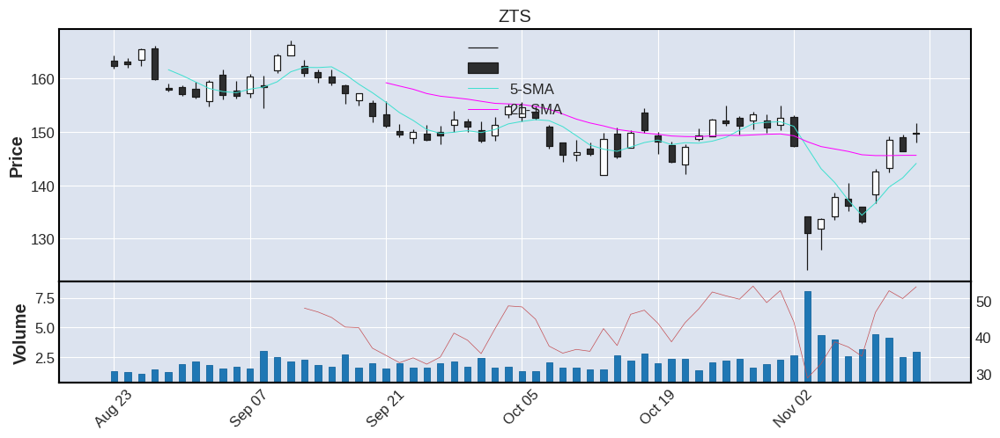



  TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
9    WST  247.69  53.85  0.57    0.71  2.22  12.17  4.91  Health_Care  0.0  United States    large


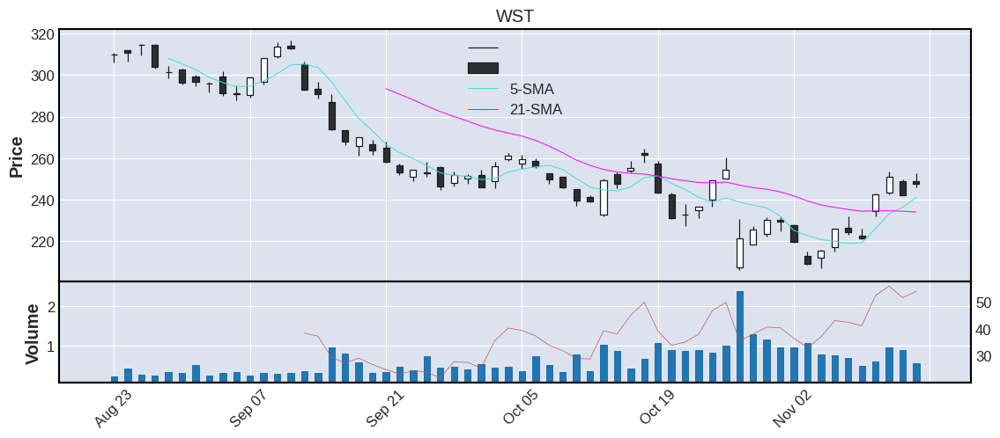



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
10   TECH  352.29  69.89  0.29    0.36  2.07  14.31  4.06  Health_Care  0.0  United States    large


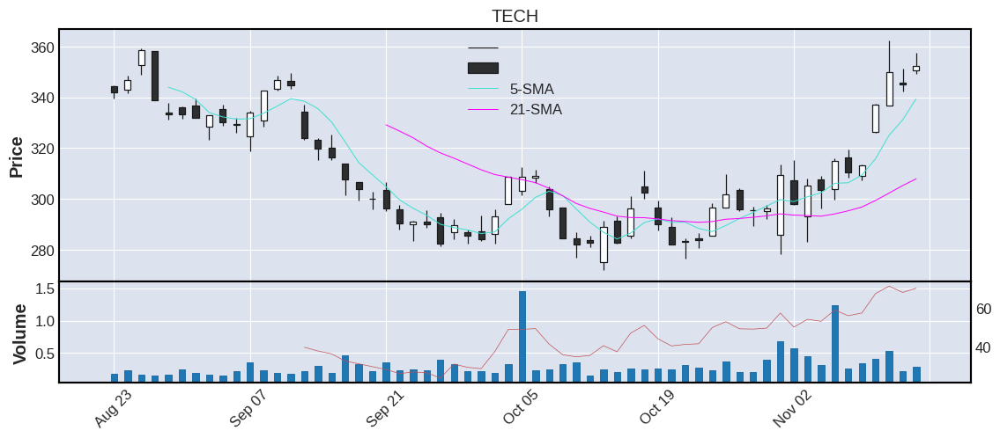



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
11   HSIC  79.35  70.46  1.23    1.29  1.95  2.31  2.91  Health_Care  1995.0  United States   medium


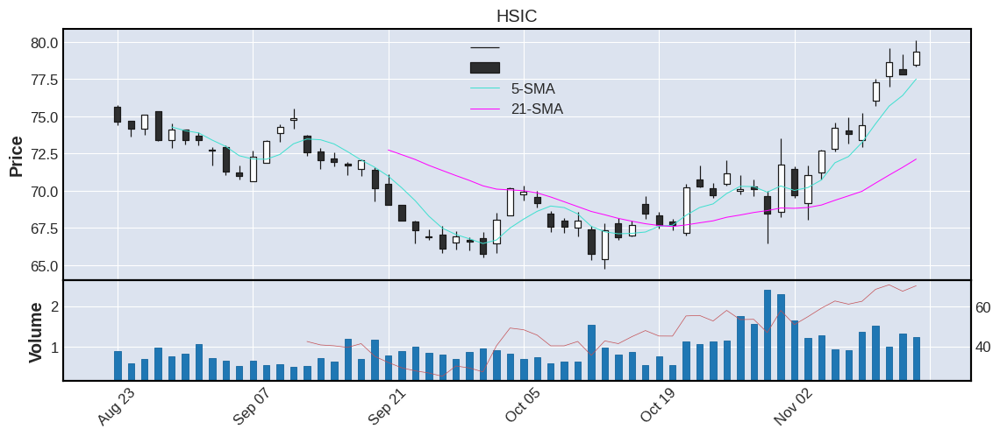



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
12   ISRG  264.18  70.86  1.95    2.63  1.83  9.16  3.47  Health_Care  2000.0  United States    large


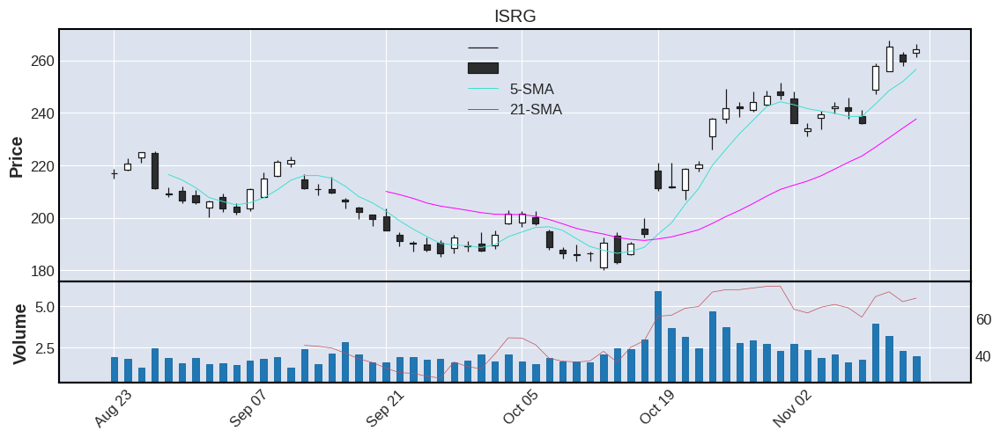



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
13   ILMN  238.49  60.55  1.18    1.32  1.67  11.04  4.63  Health_Care  2000.0  United States    large


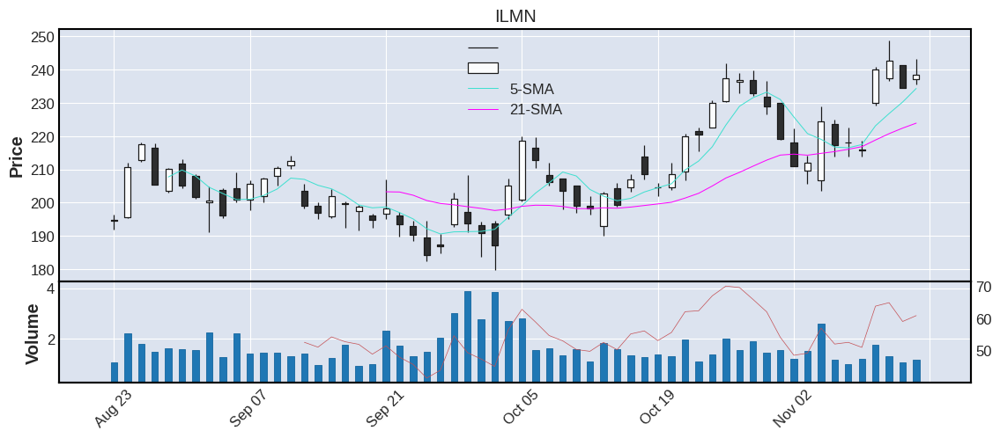



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
14    ZBH  115.12  59.23  1.01    1.24  1.6  3.27  2.84  Health_Care  0.0  United States    large


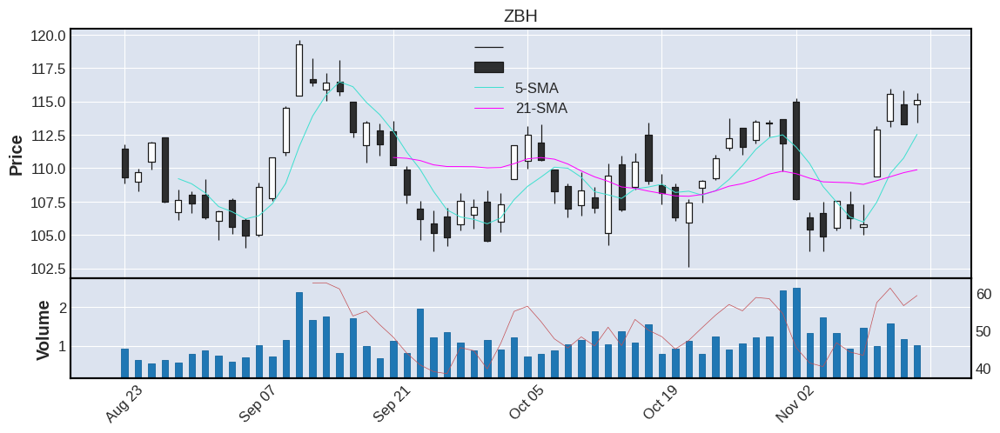



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
15    UHS  127.63  75.32  0.87    0.84  1.55  5.08  3.98  Health_Care  0.0  United States   medium


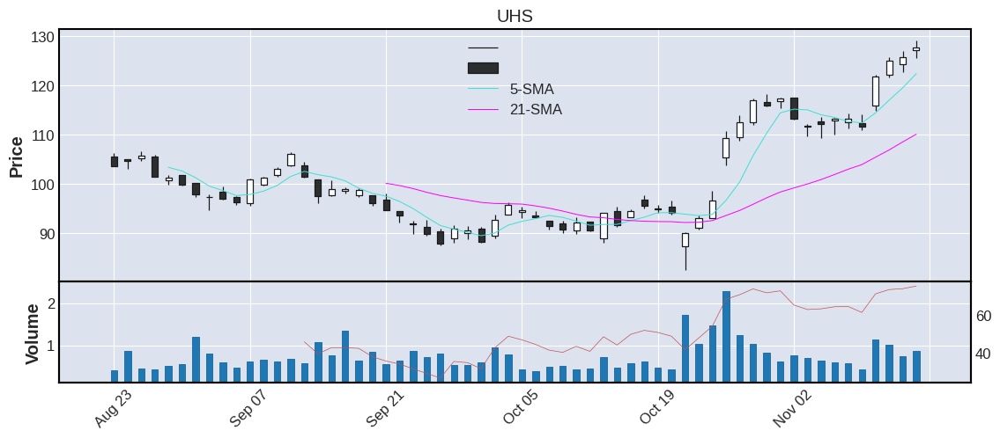



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
16   IDXX  434.38  70.22  0.55     0.6  1.48  17.42  4.01  Health_Care  1991.0  United States    large


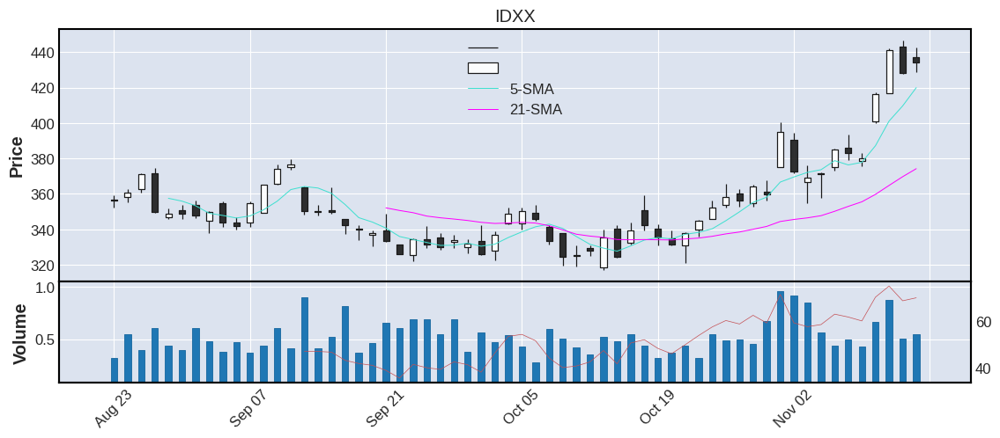



   TICKER      CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
17    SYK  221.97  54.72  1.59    1.68  1.36  6.6  2.97  Health_Care  0.0  United States    large


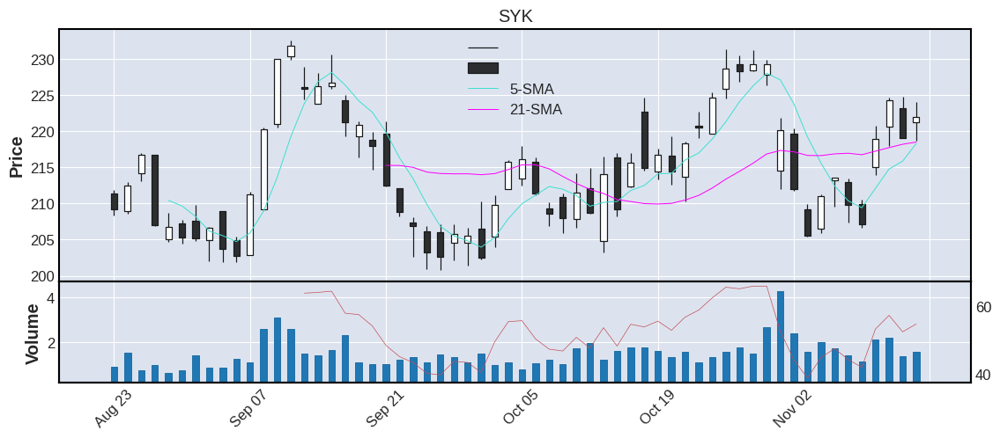



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
18    DHR  270.33  58.32  2.56     2.8  1.35  8.82  3.26  Health_Care  0.0  United States    large


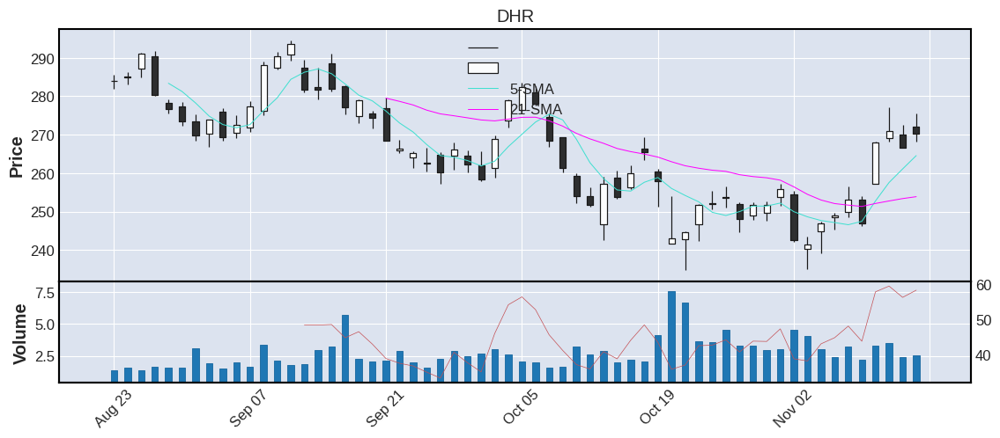



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
19    RMD  223.63  53.54  0.52    0.43  1.25  7.75  3.47  Health_Care  0.0  United States    large


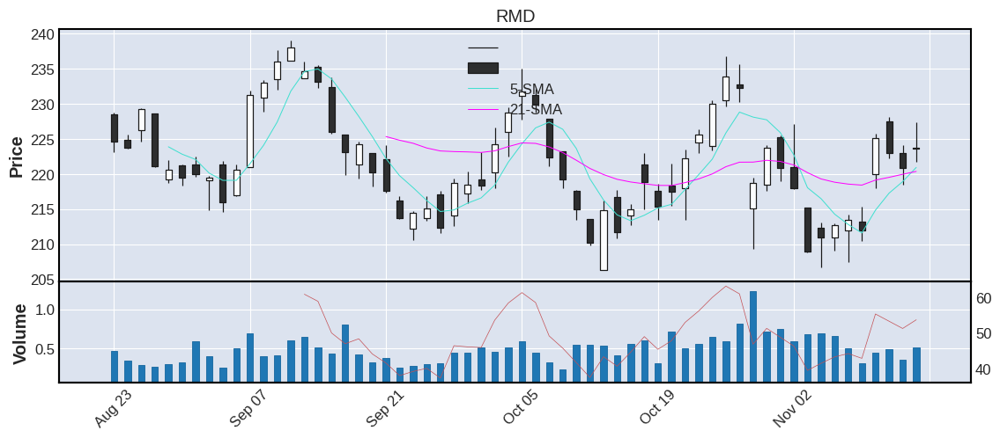



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
20   ALGN  212.92  55.02  0.82    1.37  1.23  13.26  6.23  Health_Care  2001.0  United States    large


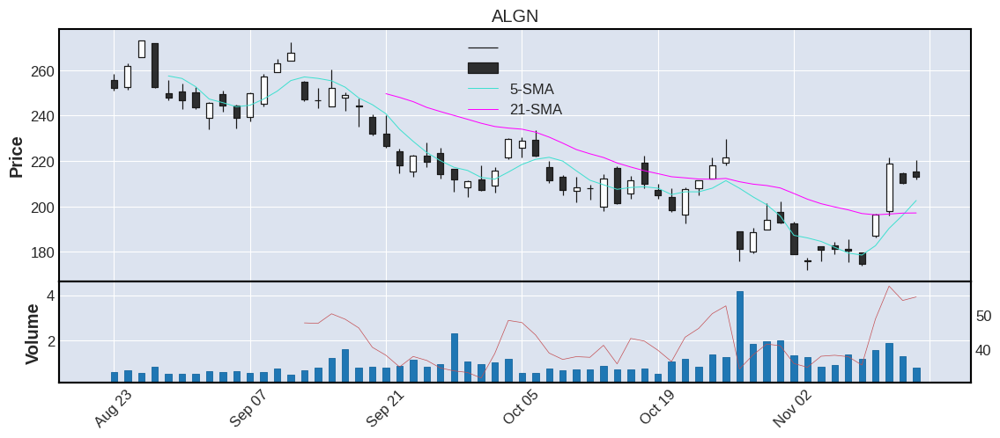



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
21    BAX  54.34  50.25  4.13    5.54  1.23  1.68  3.09  Health_Care  0.0  United States    large


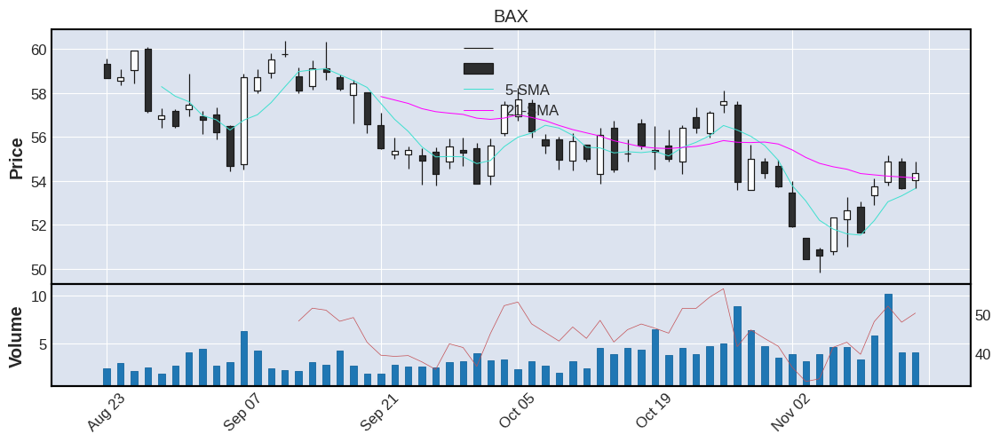



   TICKER      CP   RSI   VOL  AVGVOL %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
22    WAT  329.79  67.5  0.23    0.34  1.2  10.39  3.15  Health_Care  1995.0  United States    large


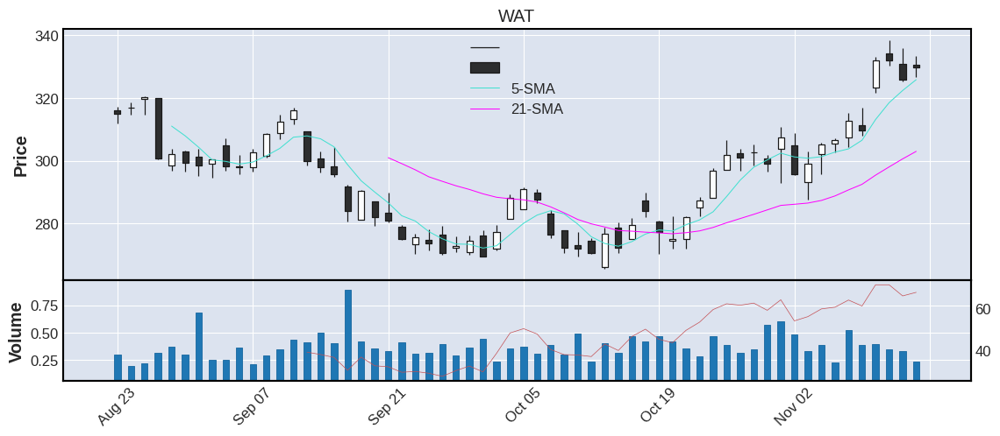



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
23    ABT  103.14  56.7  5.26    5.86  1.11  2.37   2.3  Health_Care  0.0  United States    large


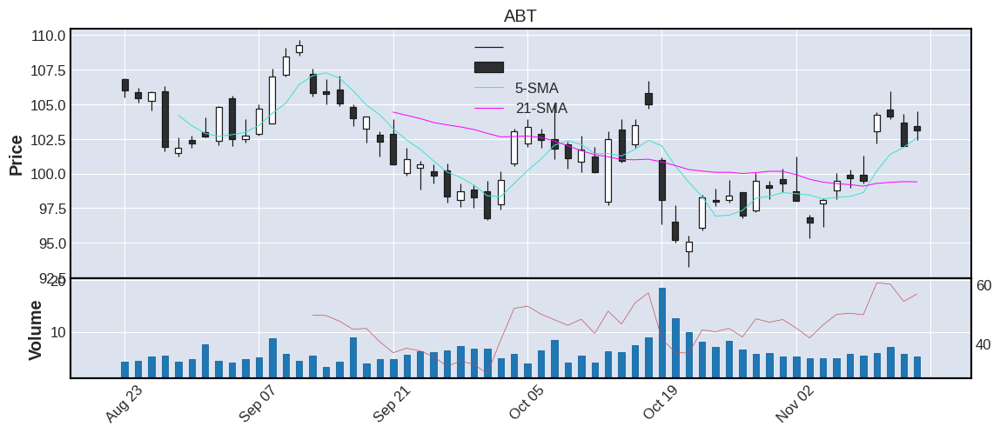



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
24    IQV  224.31  67.7  0.81    0.81  0.88  7.93  3.54  Health_Care  2013.0  United States    large


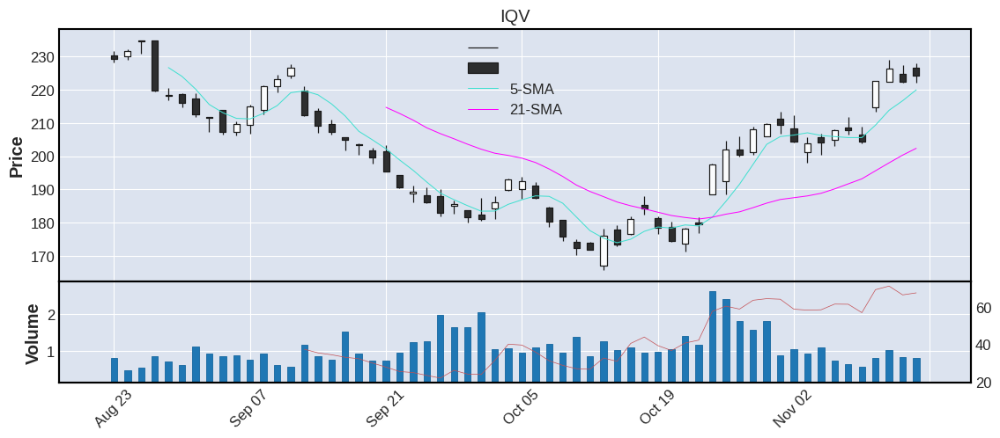



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
25   ABBV  153.04  64.01  5.91    5.99  0.86  3.86  2.52  Health_Care  2012.0  United States     mega


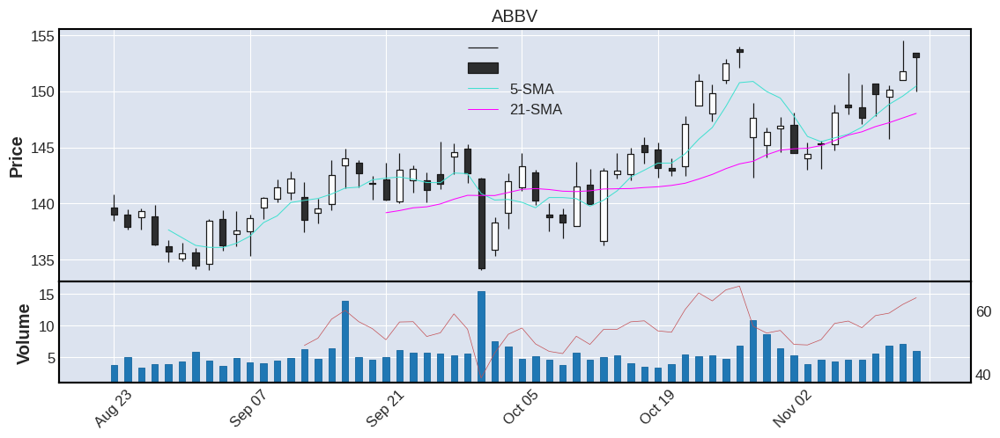



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
26     PM  94.67  62.55  3.17    4.29  0.79  2.03  2.14  Health_Care  0.0  United States    large


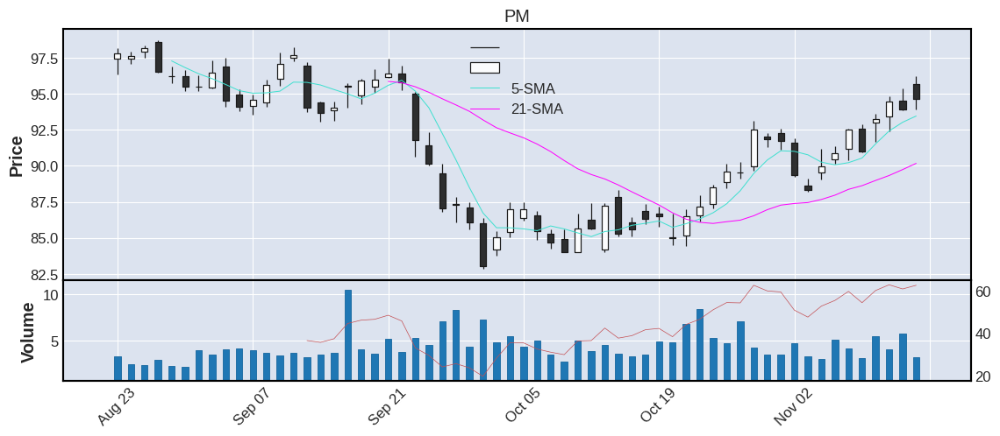



   TICKER    CP    RSI   VOL  AVGVOL %CHG  ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
27    MDT  83.4  48.52  6.76    7.68  0.6  2.1  2.52  Health_Care  0.0  United States    large


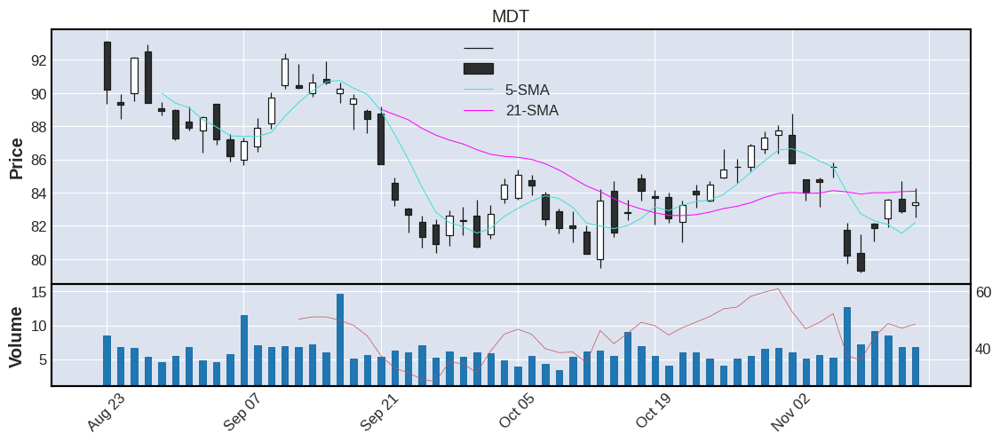



   TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
28    CVS  97.73  53.6  6.53    6.42  0.58  2.59  2.65  Health_Care  0.0  United States    large


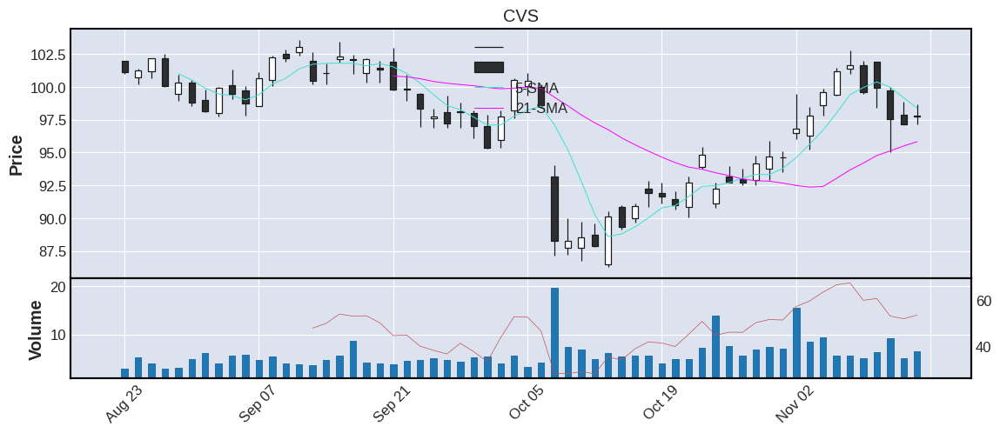



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
29    BSX  42.42  55.32  4.7    7.31  0.43  1.19  2.81  Health_Care  0.0  United States    large


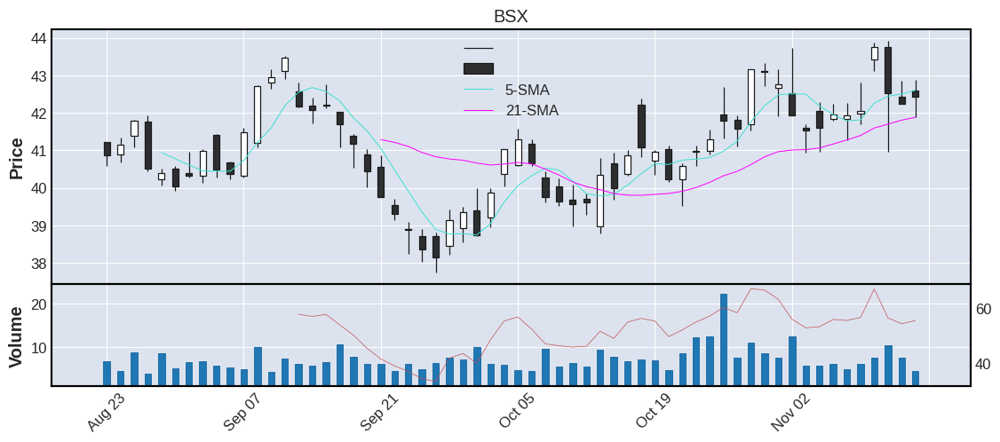



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
30    COO  315.78  68.96  0.32    0.51  0.41  10.05  3.18  Health_Care  0.0  United States    large


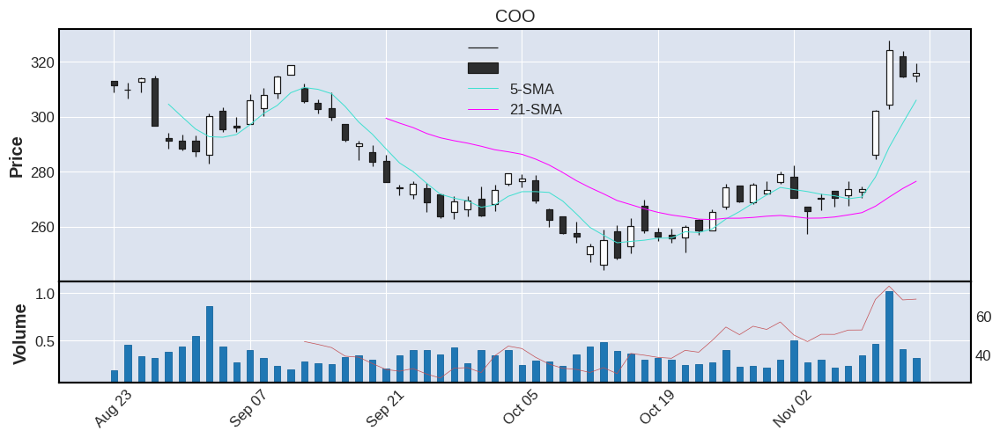



   TICKER     CP    RSI  VOL  AVGVOL %CHG   ATR  %ATR       SECTOR     IPO COUNTRY CATEGORY
31    OGN  24.88  49.05  1.6     2.3  0.4  0.92   3.7  Health_Care  2021.0     N-A   medium


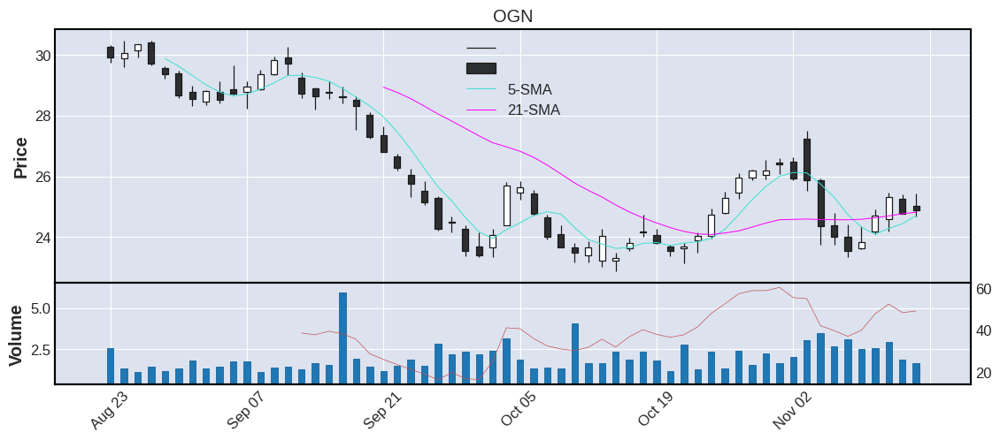



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
32    JNJ  172.39  55.25  9.35    8.21  0.28  3.16  1.83  Health_Care  0.0  United States     mega


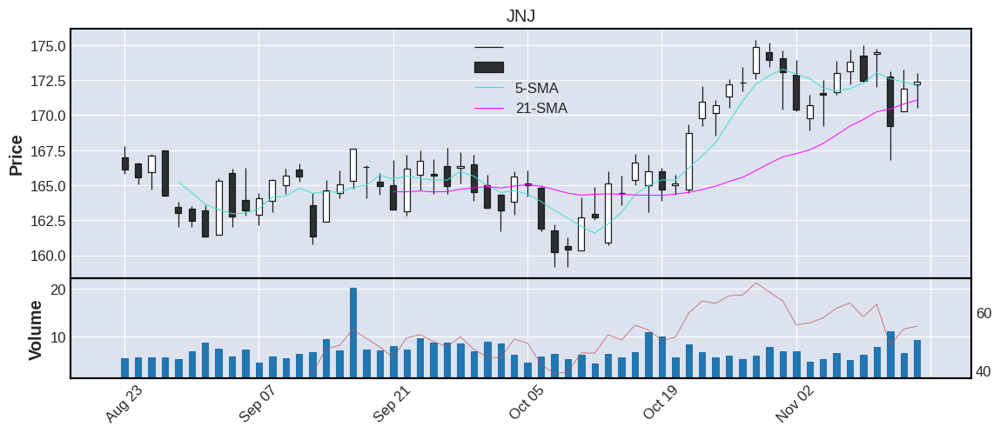



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
33     LH  245.78  66.2  0.59    0.85  0.27  7.88  3.21  Health_Care  0.0  United States    large


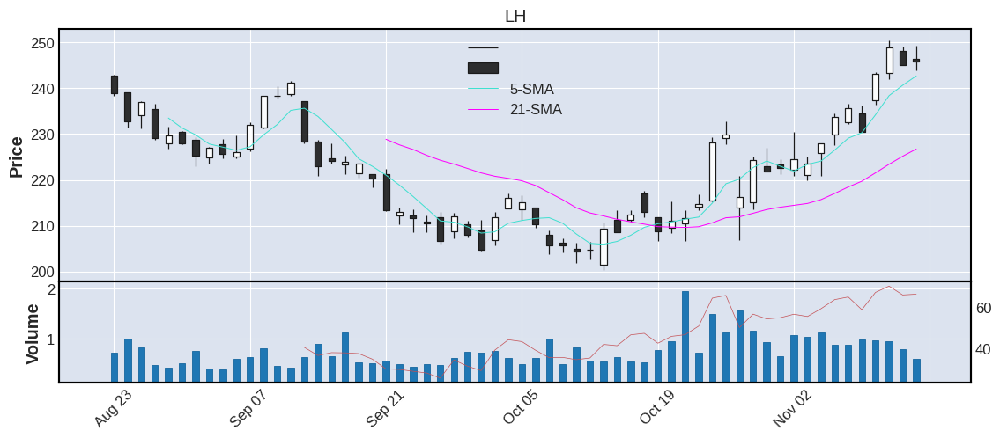



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
34   BIIB  299.78  72.43  1.28    1.49  0.24  8.65  2.89  Health_Care  0.0  United States    large


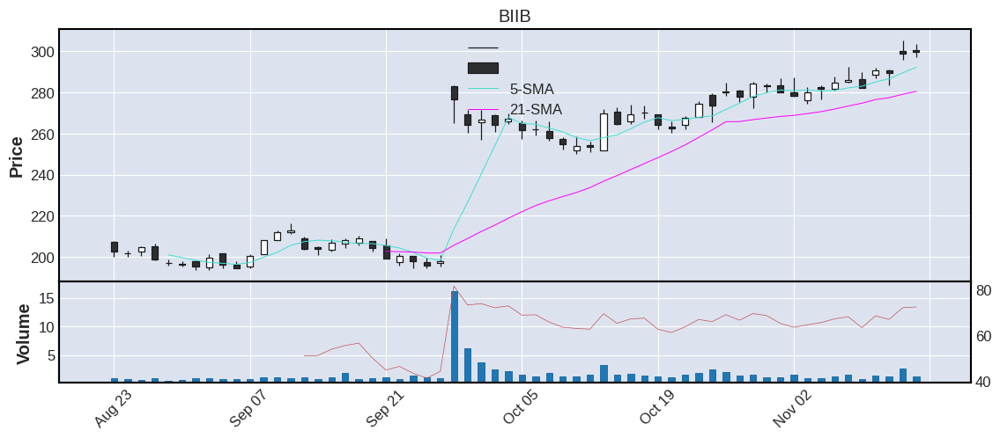



   TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
35   GILD  83.0  78.13  7.12    9.18  0.18  2.39  2.88  Health_Care  1992.0  United States    large


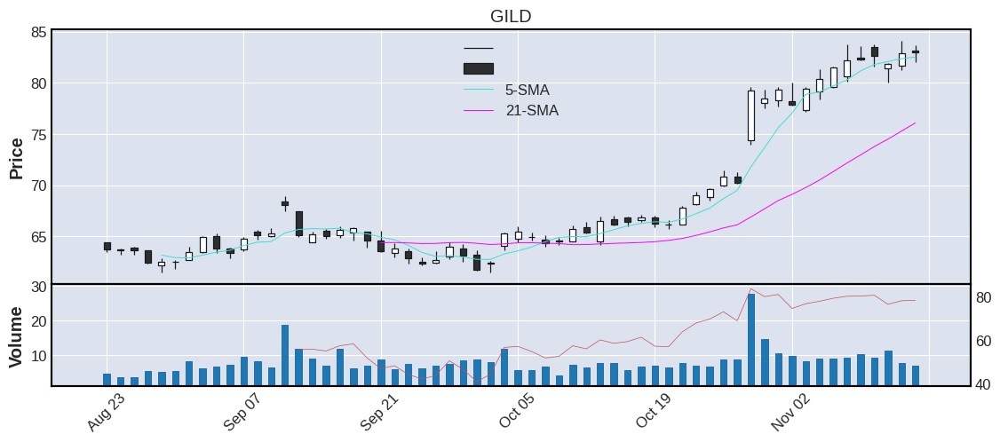



   TICKER     CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
36   ABMD  374.2  78.76  3.64    2.73  0.03  11.27  3.01  Health_Care  0.0  United States    large


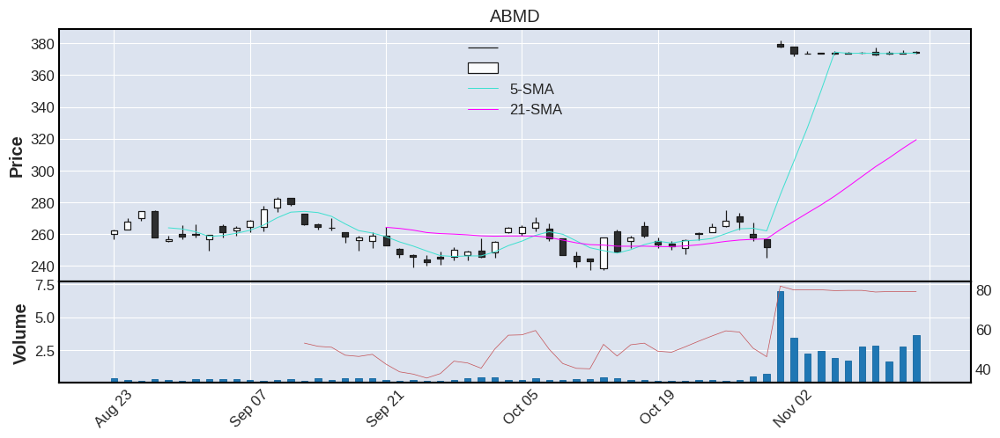



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
37    STE  167.73  47.28  0.53    0.73 -0.03  4.54  2.71  Health_Care  0.0  United States    large


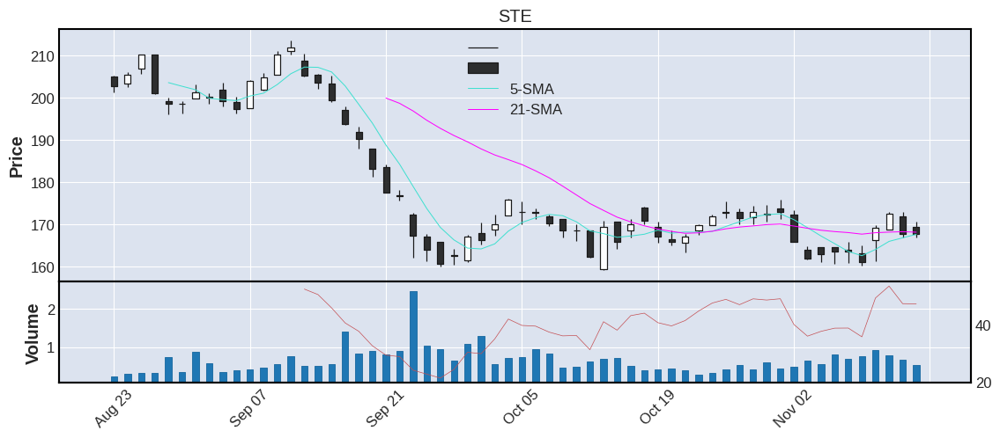



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
38    BMY  76.28  53.81  11.21   12.63 -0.14  1.89  2.48  Health_Care  0.0  United States    large


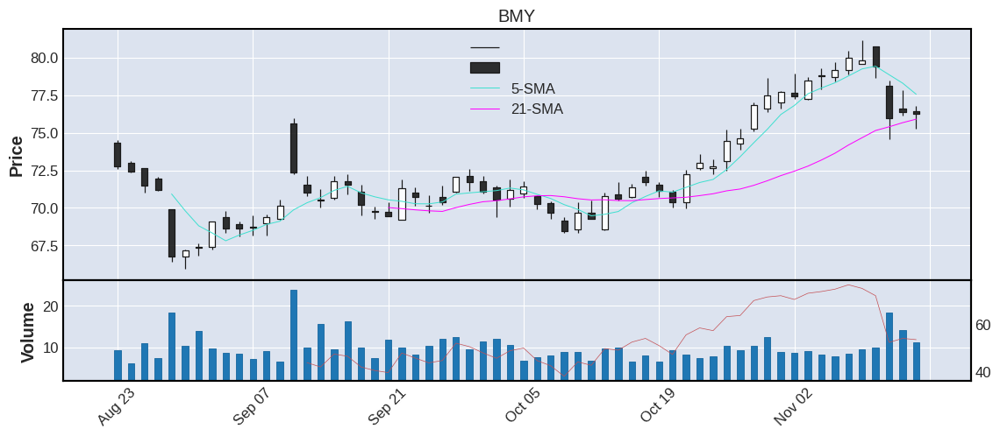



   TICKER      CP   RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
39   VRTX  305.28  51.5  1.22    1.65 -0.25  11.38  3.73  Health_Care  1991.0  United States    large


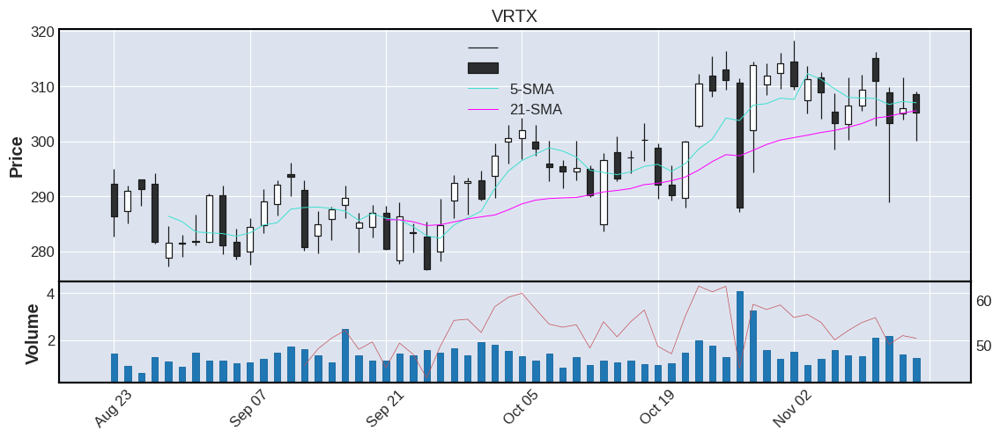



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
40    PKI  142.28  62.43  0.82    1.03 -0.52  4.89  3.44  Health_Care  0.0  United States    large


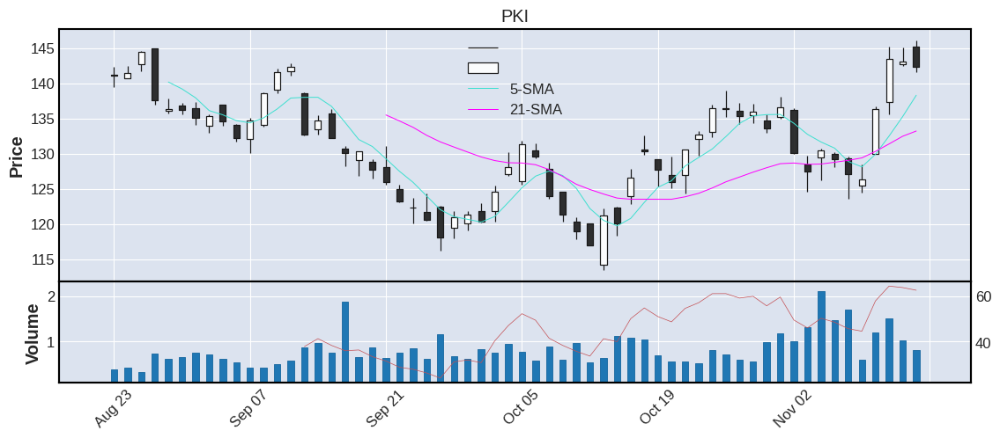



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
41     CI  305.17  45.91  1.89    2.54 -0.55  9.33  3.06  Health_Care  0.0  United States    large


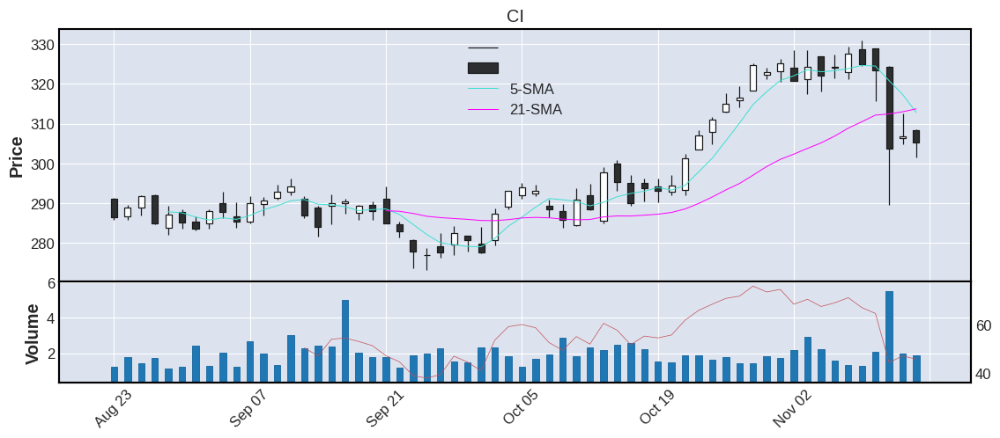



   TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
42   AMGN  283.6  65.89  2.76    3.28 -0.6  7.62  2.69  Health_Care  1983.0  United States    large


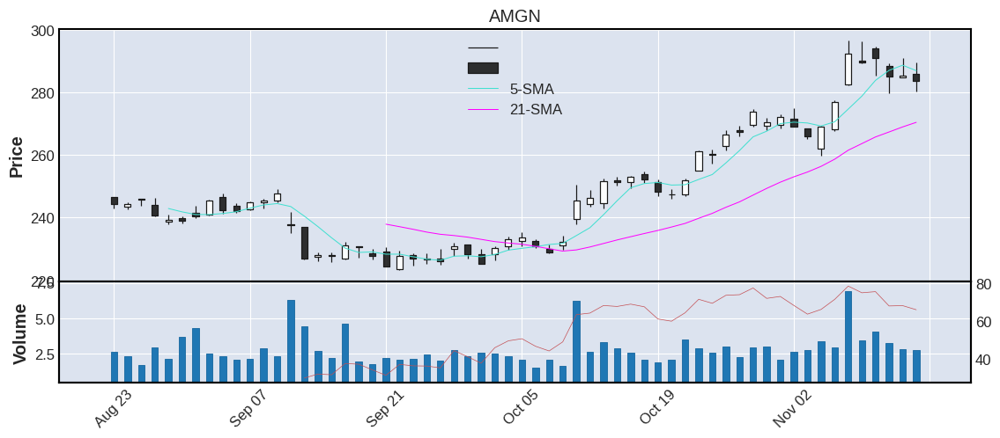



   TICKER     CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
43   INCY  76.62  61.95  0.96    1.41 -0.61  2.1  2.74  Health_Care  0.0  United States    large


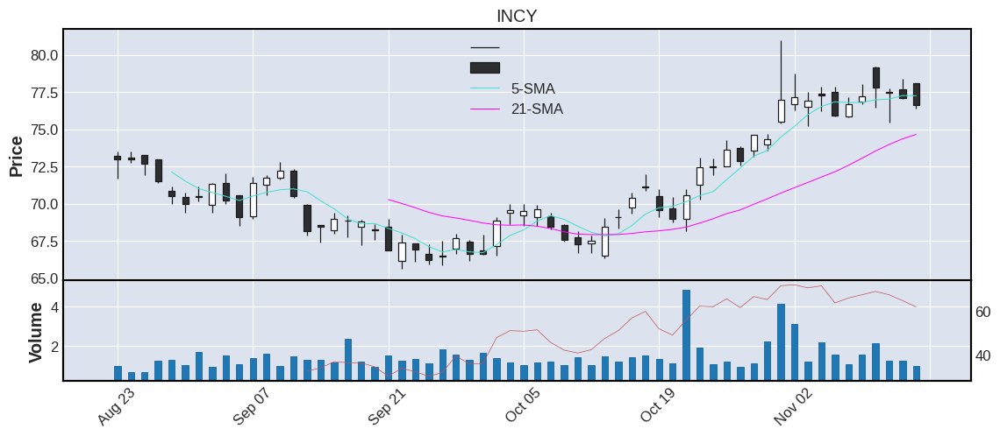



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
44     MO  43.66  42.26  9.25    8.98 -0.68  1.07  2.45  Health_Care  0.0  United States    large


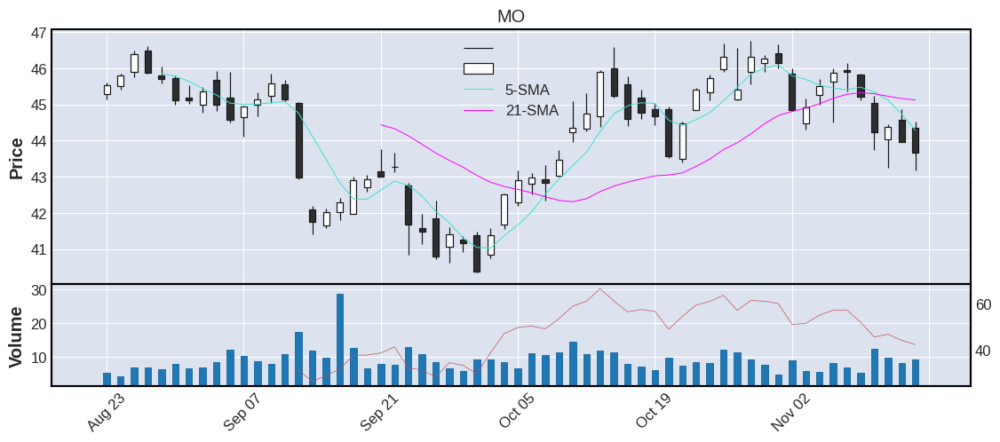



   TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
45    MRK  99.6  58.16  7.96   10.08 -0.75  2.44  2.45  Health_Care  0.0  United States     mega


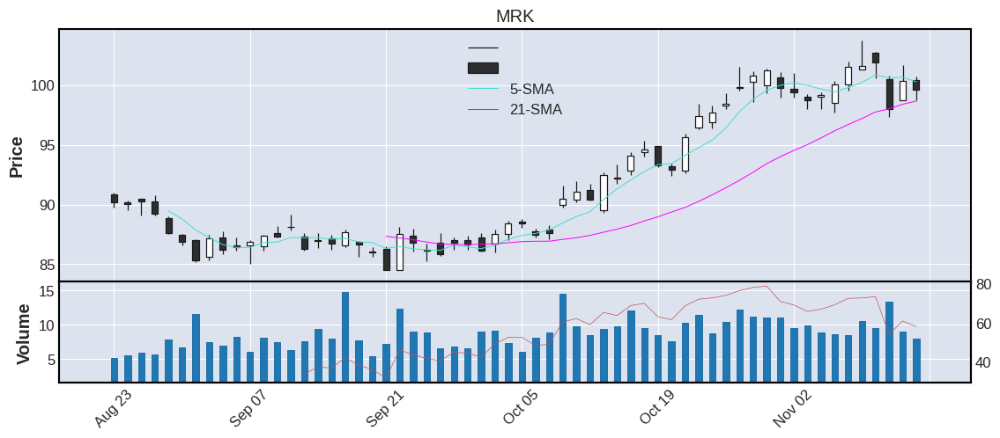



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
46    BDX  222.37  43.84  2.03    2.37 -0.8  5.15  2.32  Health_Care  0.0  United States    large


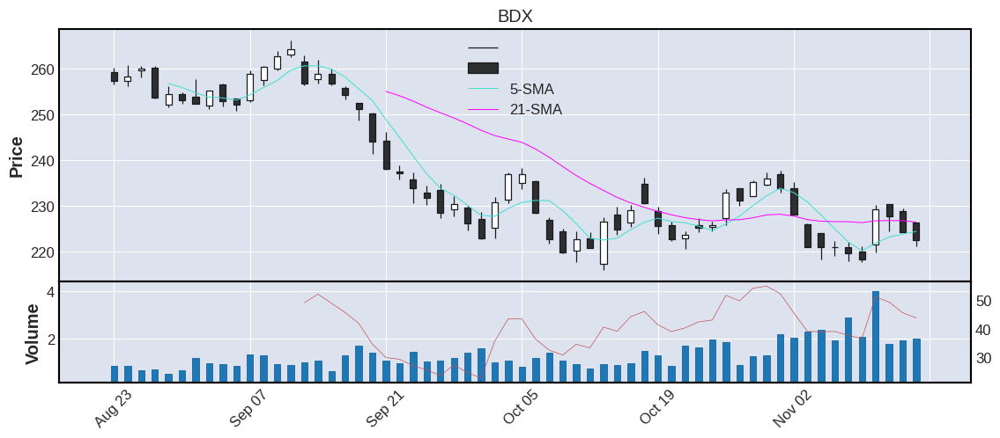



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
47    MOH  312.03  30.59  0.88    0.62 -0.84  12.04  3.86  Health_Care  2003.0  United States    large


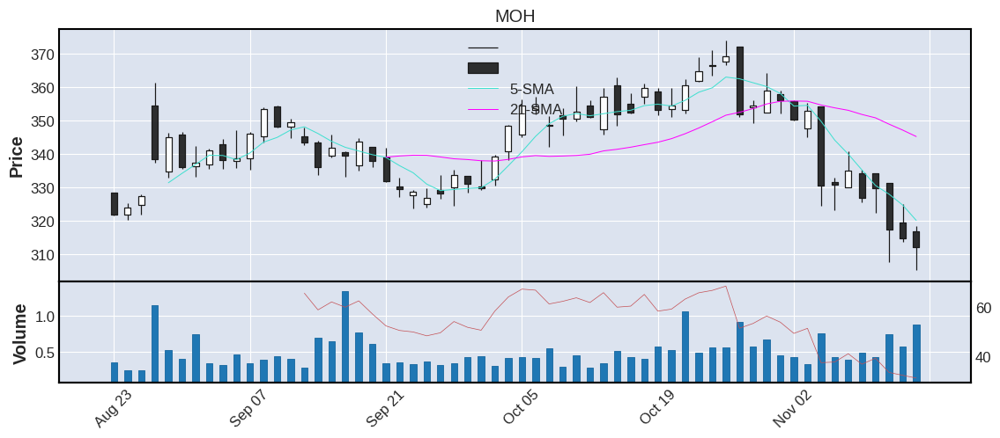



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
48   HOLX  74.61  63.65  1.44    1.55 -1.15  2.17  2.91  Health_Care  1990.0  United States    large


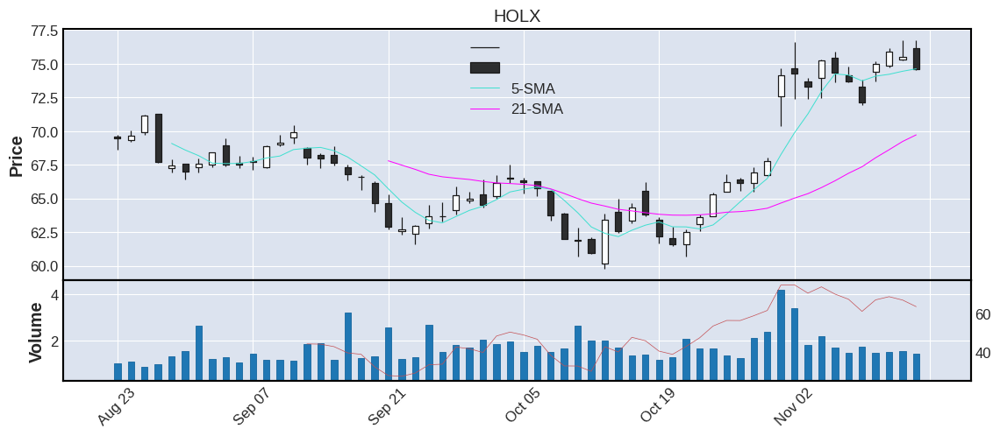



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
49    CAH  74.32  49.38  3.25    3.94 -1.18  2.38   3.2  Health_Care  0.0  United States    large


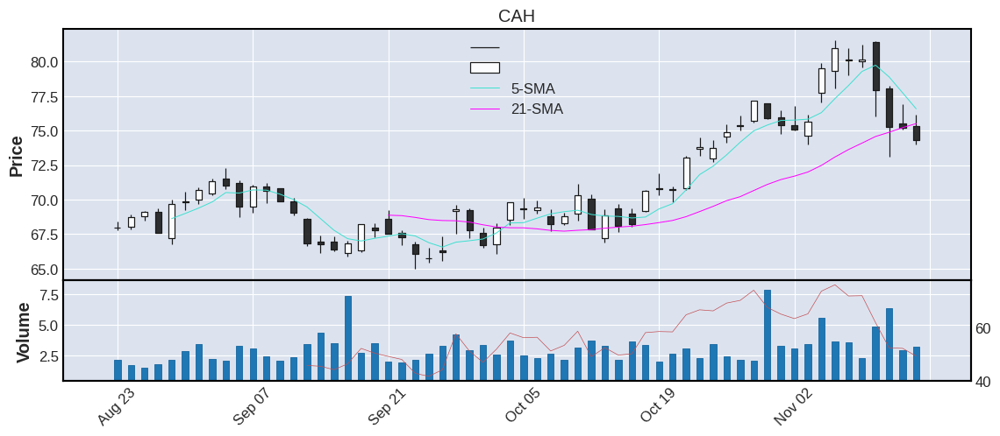



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
50    ABC  152.78  51.18  1.64    2.61 -1.26  4.85  3.17  Health_Care  0.0  United States    large


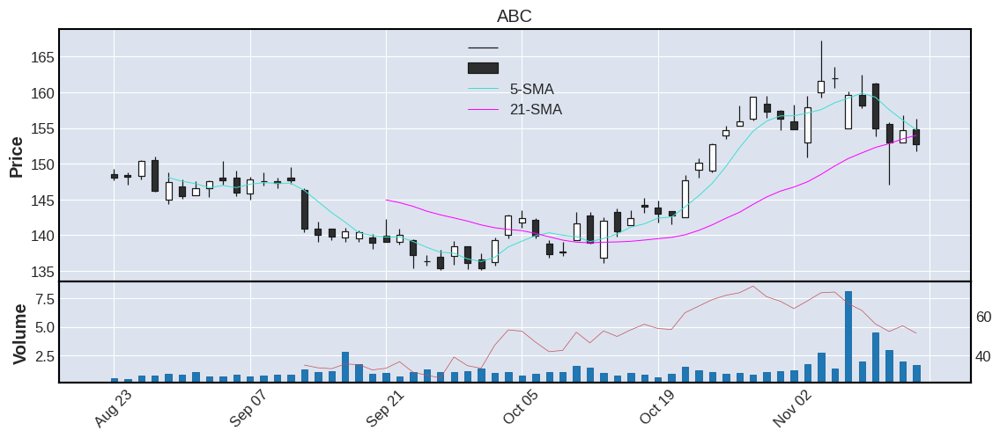



================================================== SECTOR 3: CONSUMER_DISCRETIONARY [ %CHG ] ================================================== 

    TICKER       CP    RSI    VOL  AVGVOL  %CHG     ATR  %ATR                  SECTOR     IPO         COUNTRY CATEGORY
1     WMT   147.44  65.36  25.49   11.30  6.54    3.48  2.36  Consumer_Discretionary     0.0   United States     mega
2     CZR    54.30  74.02   3.99    4.93  5.42    3.01  5.54  Consumer_Discretionary     0.0   United States   medium
3     CCL    11.16  71.26  98.28   73.05  5.28    0.58  5.20  Consumer_Discretionary  1987.0   United States    large
4    PARA    19.44  55.34  30.38   21.49  5.14    1.20  6.17  Consumer_Discretionary     0.0   United States    large
5     SWK    85.34  60.30   2.36    2.50  5.14    3.72  4.36  Consumer_Discretionary     0.0   United States    large
6    ETSY   125.31  67.75   4.53    4.11  4.65    7.40  5.91  Consumer_Discretionary  2015.0   United States    large
7     EFX   207.10  74.43

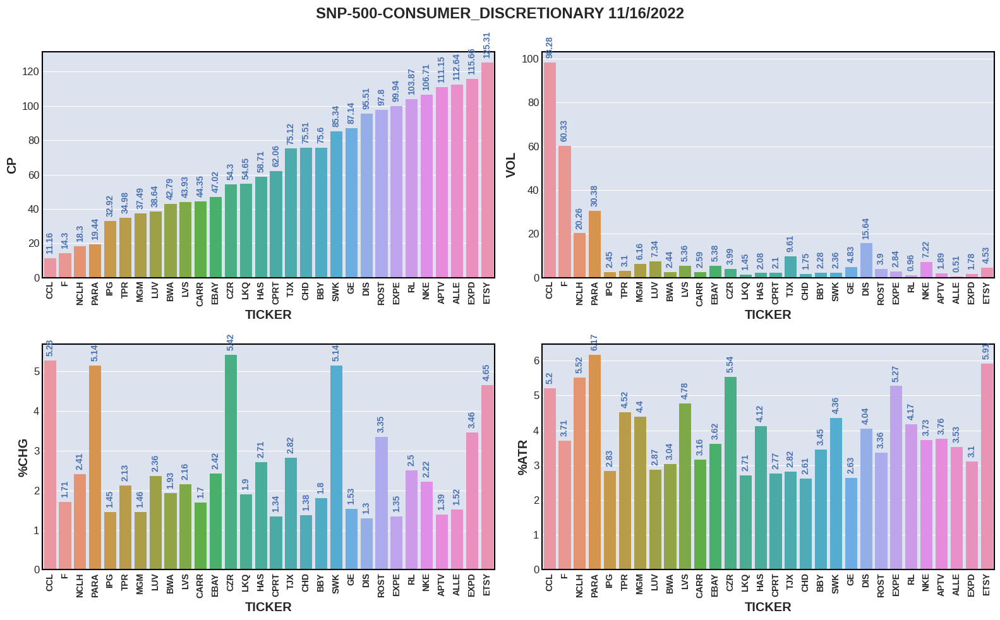

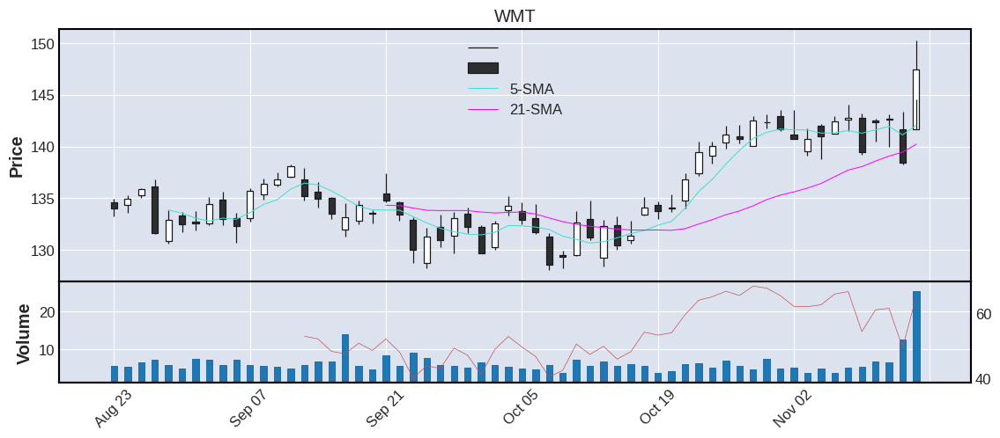



  TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
2    CZR  54.3  74.02  3.99    4.93  5.42  3.01  5.54  Consumer_Discretionary  0.0  United States   medium


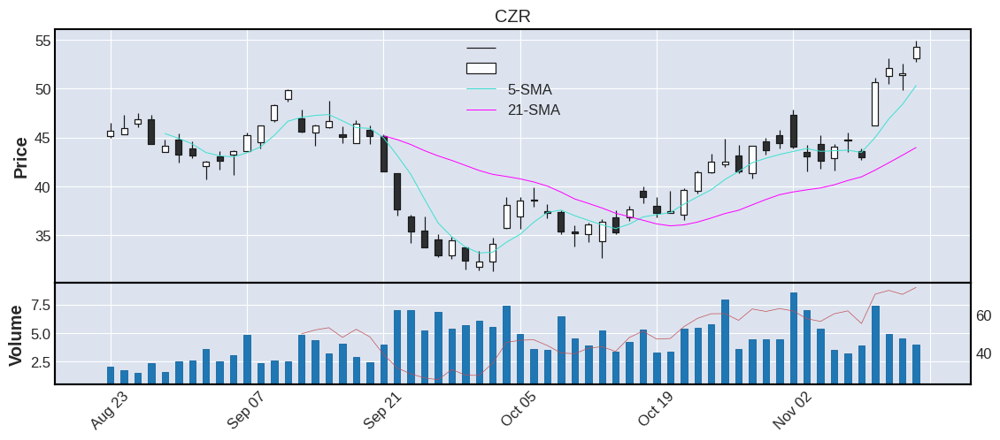



  TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
3    CCL  11.16  71.26  98.28   73.05  5.28  0.58   5.2  Consumer_Discretionary  1987.0  United States    large


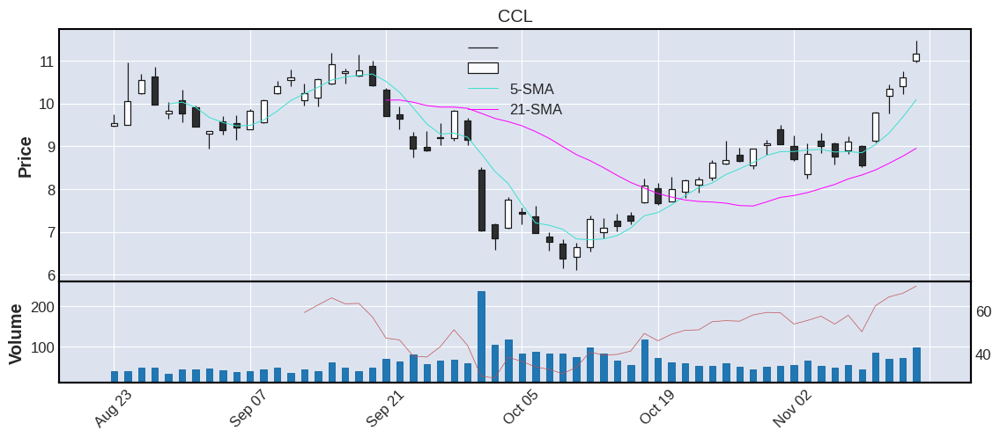



  TICKER     CP    RSI    VOL  AVGVOL  %CHG  ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
4   PARA  19.44  55.34  30.38   21.49  5.14  1.2  6.17  Consumer_Discretionary  0.0  United States    large


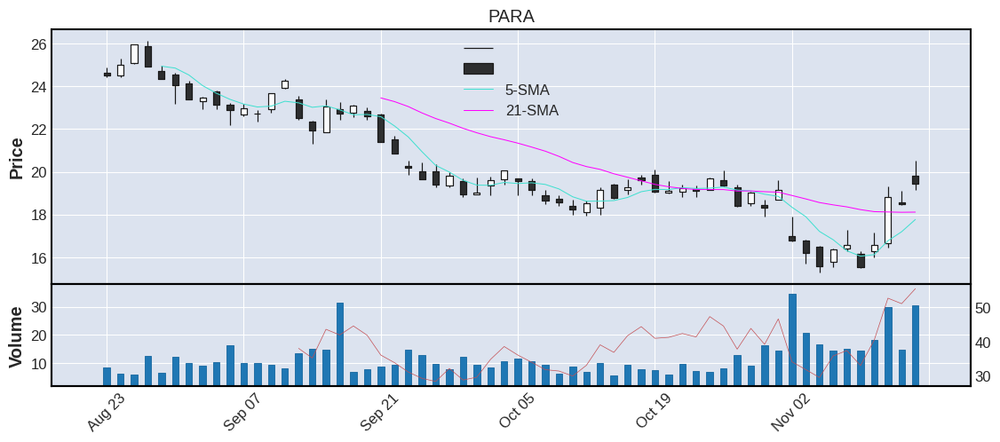



  TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
5    SWK  85.34  60.3  2.36     2.5  5.14  3.72  4.36  Consumer_Discretionary  0.0  United States    large


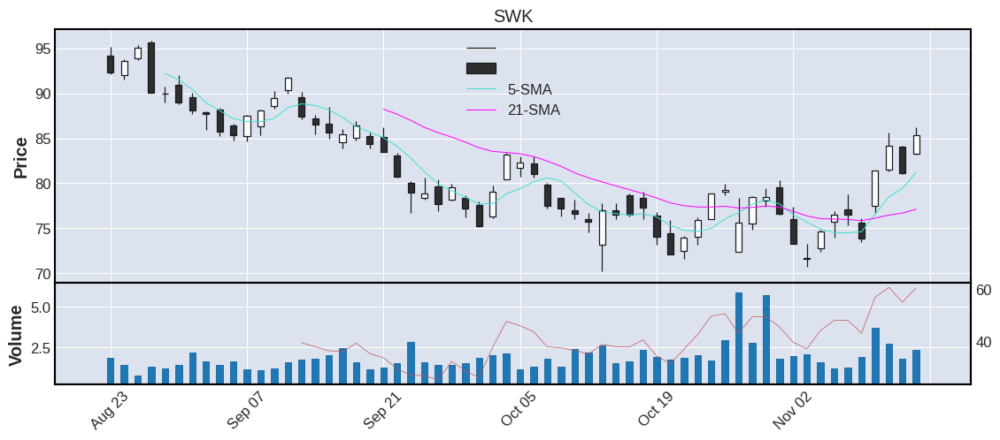



  TICKER      CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
6   ETSY  125.31  67.75  4.53    4.11  4.65  7.4  5.91  Consumer_Discretionary  2015.0  United States    large


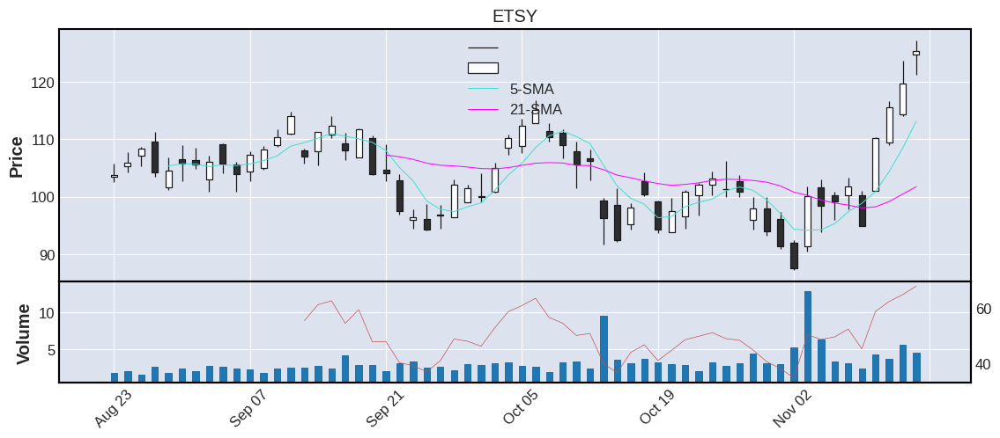



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
7    EFX  207.1  74.43  2.07    1.58  4.64  7.33  3.54  Consumer_Discretionary  0.0  United States    large


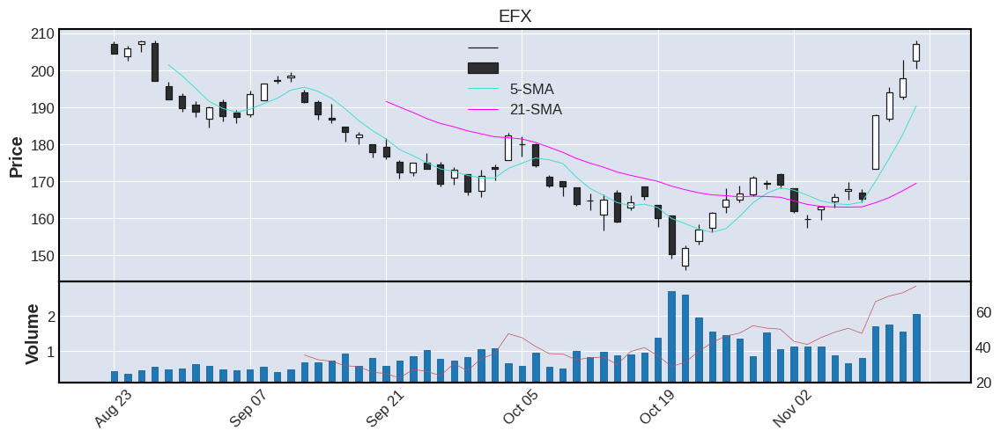



  TICKER      CP   RSI   VOL  AVGVOL  %CHG  ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
8     DG  257.26  58.9  1.98    1.77  4.18  7.0  2.72  Consumer_Discretionary  2009.0  United States    large


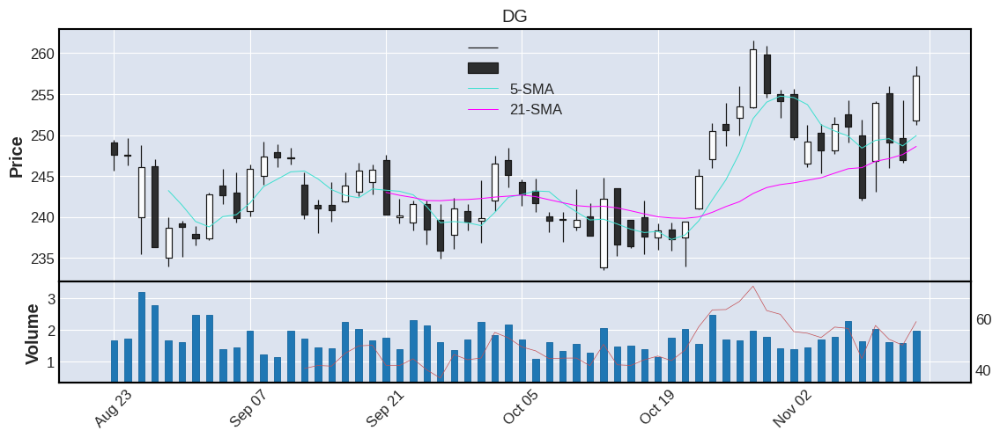



  TICKER     CP    RSI    VOL  AVGVOL  %CHG    ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
9   NFLX  310.2  67.16  14.27   11.75  3.65  14.23  4.59  Consumer_Discretionary  2002.0  United States    large


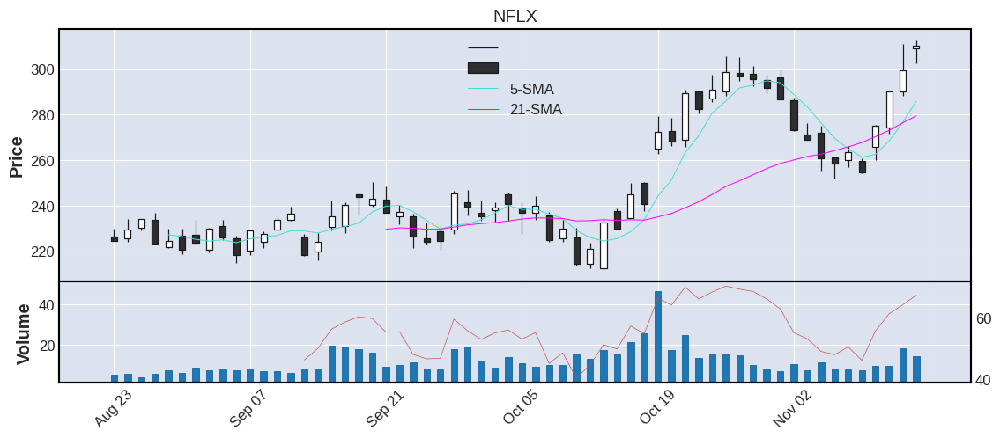



   TICKER       CP    RSI   VOL  AVGVOL  %CHG     ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
10    NVR  4510.99  61.13  0.03    0.02  3.59  158.23  3.51  Consumer_Discretionary  1998.0  United States    large


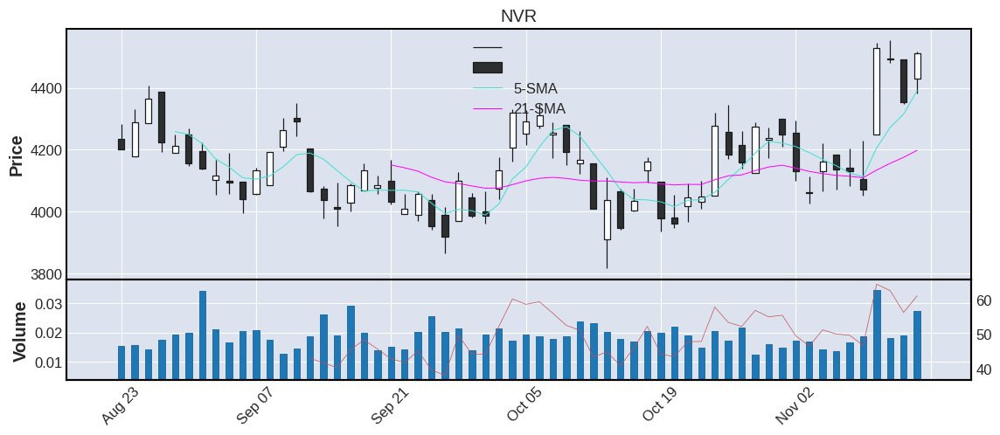



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
11   EXPD  115.66  80.0  1.78    2.04  3.46  3.59   3.1  Consumer_Discretionary  0.0  United States    large


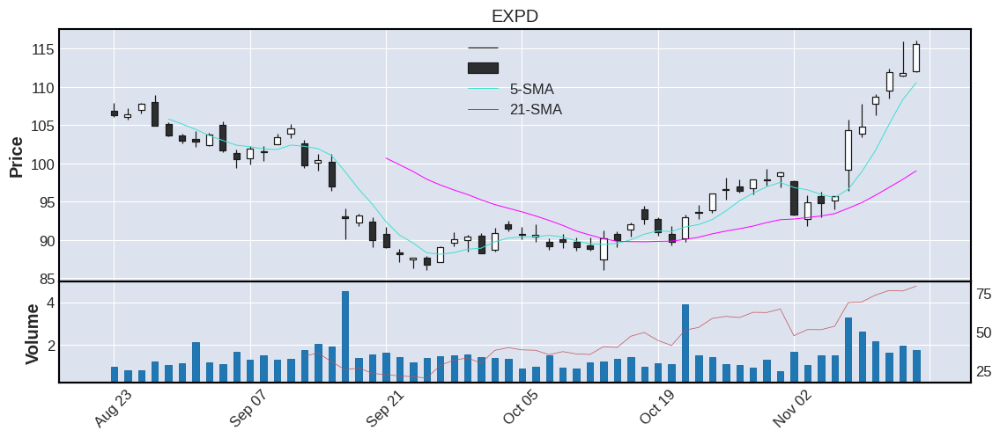



   TICKER    CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
12   ROST  97.8  63.12  3.9    2.96  3.35  3.29  3.36  Consumer_Discretionary  1985.0  United States    large


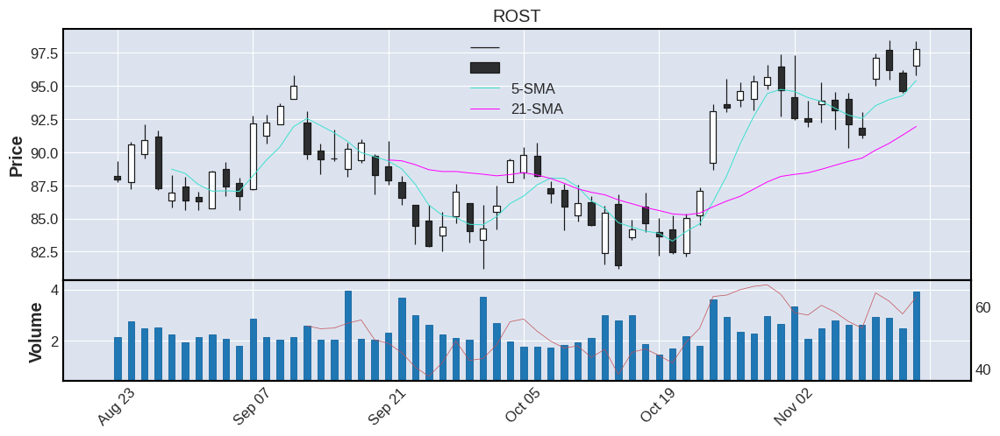



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
13    TGT  178.98  67.59  8.58    5.83  3.3  5.77  3.22  Consumer_Discretionary  0.0  United States    large


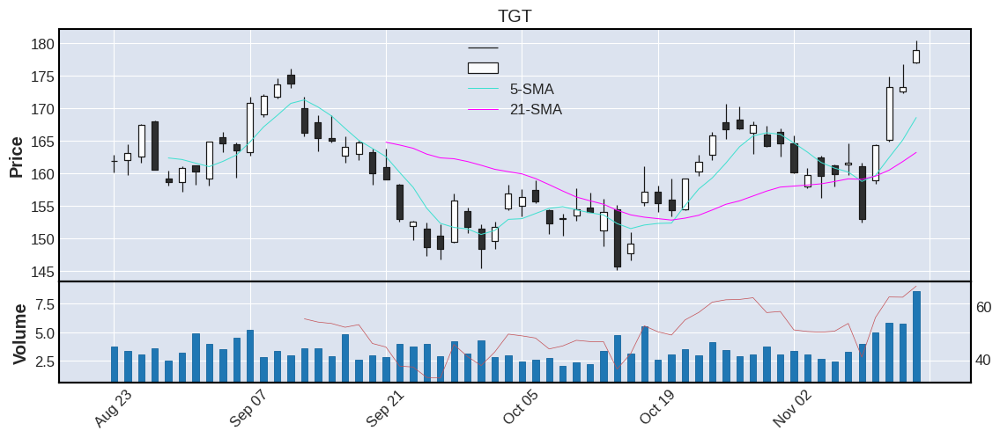



   TICKER      CP    RSI  VOL  AVGVOL  %CHG    ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
14   COST  526.47  65.33  2.5    2.29  3.29  14.09  2.68  Consumer_Discretionary  0.0  United States     mega


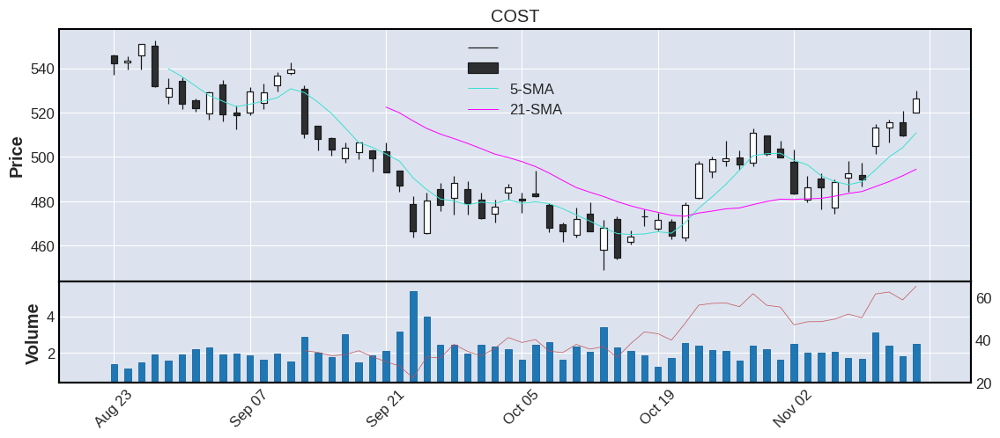



   TICKER      CP   RSI   VOL  AVGVOL  %CHG    ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
15    CRL  250.07  71.2  0.59     0.7  2.91  10.71  4.28  Consumer_Discretionary  2000.0  United States    large


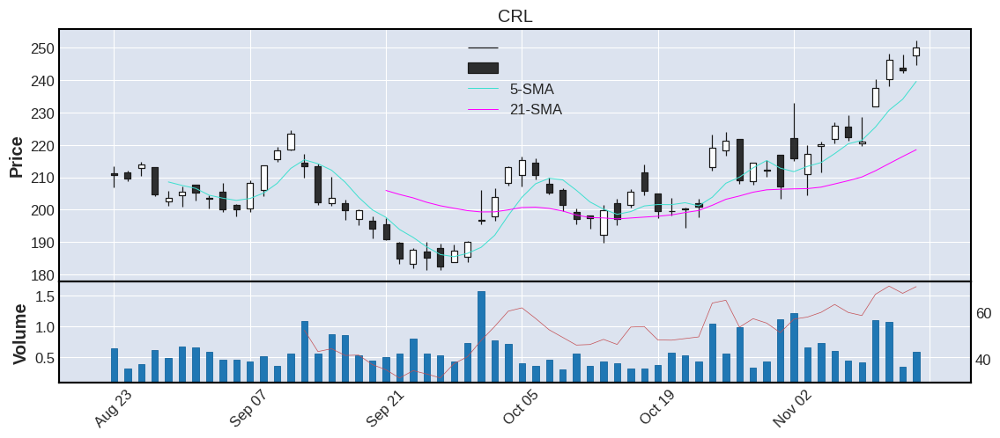



   TICKER      CP    RSI  VOL  AVGVOL  %CHG  ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
16     EL  226.98  58.06  1.8    2.15  2.86  9.7  4.27  Consumer_Discretionary  1995.0  United States    large


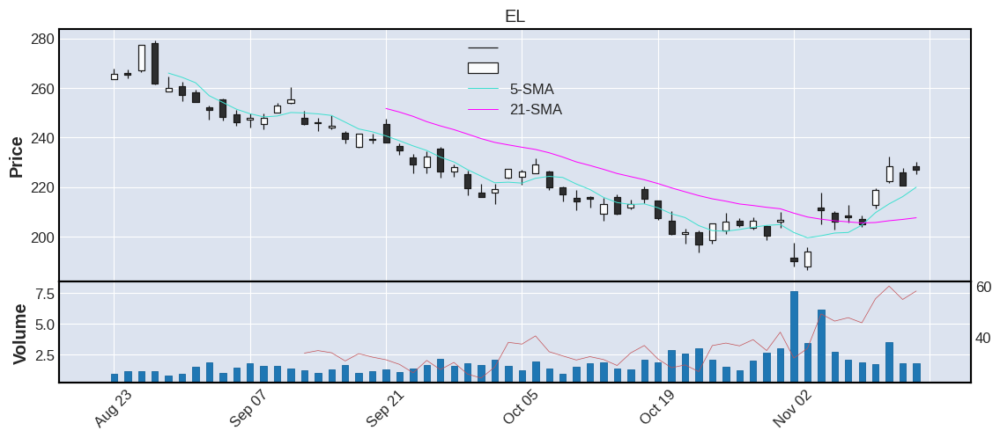



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
17    TJX  75.12  67.47  9.61    6.32  2.82  2.12  2.82  Consumer_Discretionary  0.0  United States    large


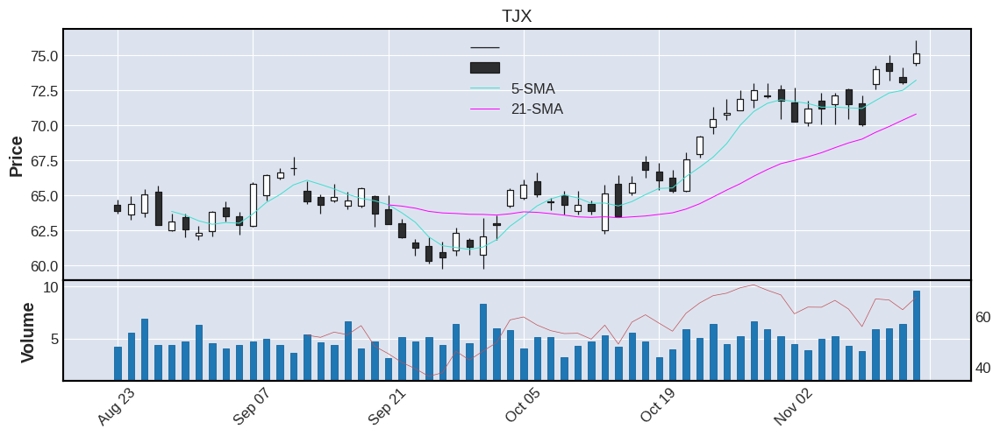



   TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
18    SHW  240.59  64.88  1.8    2.04  2.78  8.22  3.42  Consumer_Discretionary  0.0  United States    large


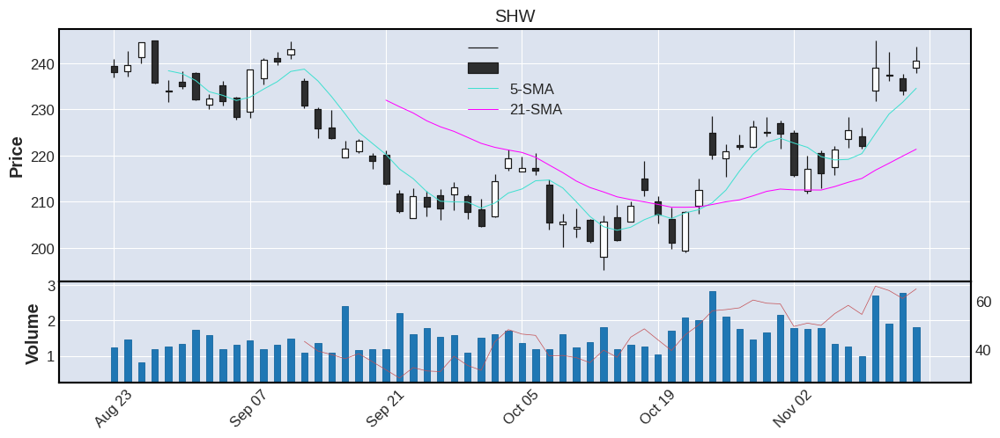



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
19    HAS  58.71  37.96  2.08    2.34  2.71  2.42  4.12  Consumer_Discretionary  0.0  United States   medium


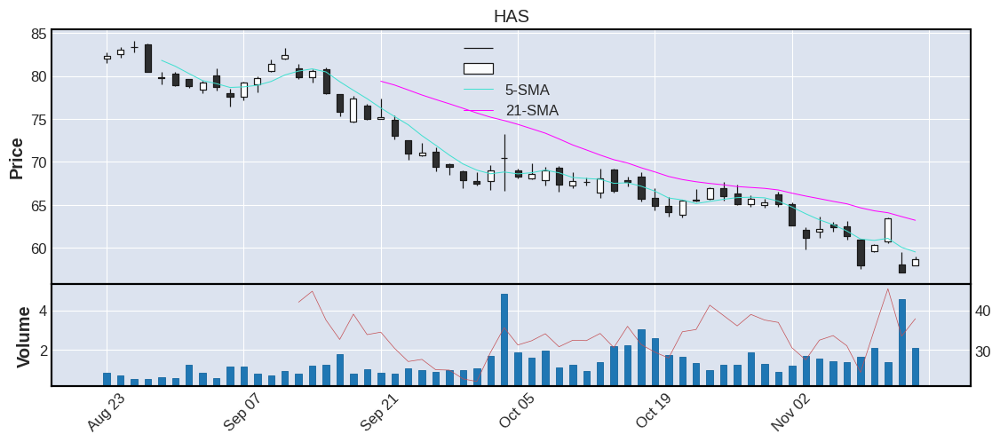



   TICKER      CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
20   DLTR  168.84  69.55  2.29    2.19  2.64  5.0  2.96  Consumer_Discretionary  1995.0  United States    large


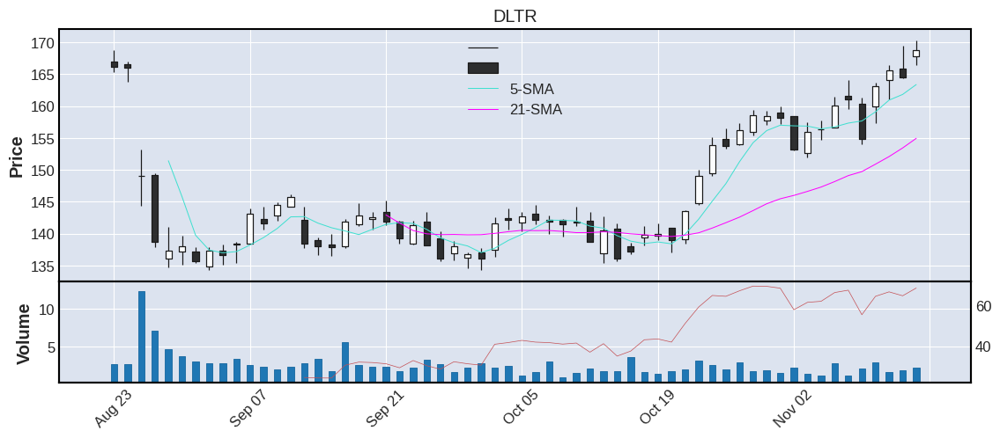



   TICKER      CP   RSI   VOL  AVGVOL %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
21     RL  103.87  63.1  0.96    1.42  2.5  4.33  4.17  Consumer_Discretionary  1997.0  United States   medium


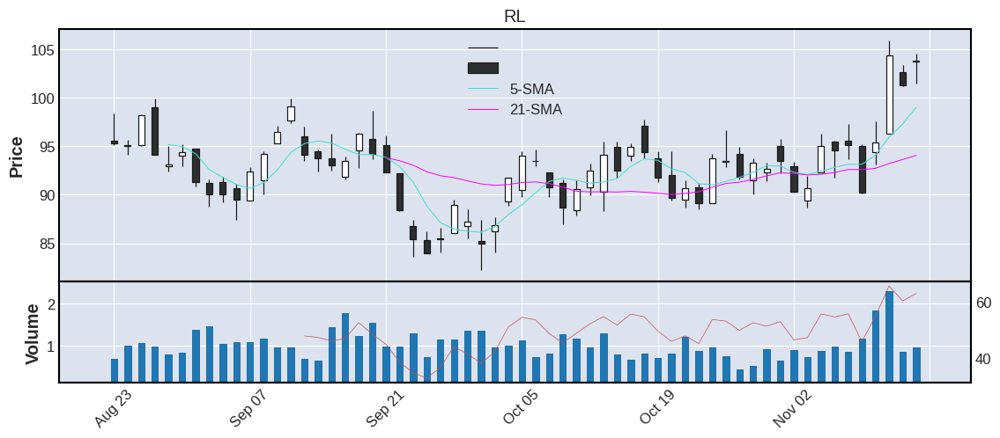



   TICKER     CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
22   EBAY  47.02  72.29  5.38    6.66  2.42  1.7  3.62  Consumer_Discretionary  1998.0  United States    large


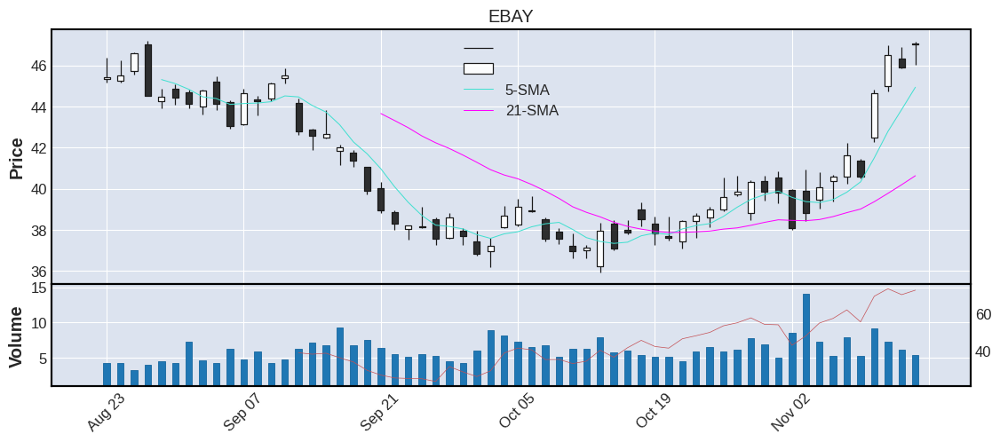



   TICKER    CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
23   NCLH  18.3  66.84  20.26   22.03  2.41  1.01  5.52  Consumer_Discretionary  0.0  United States   medium


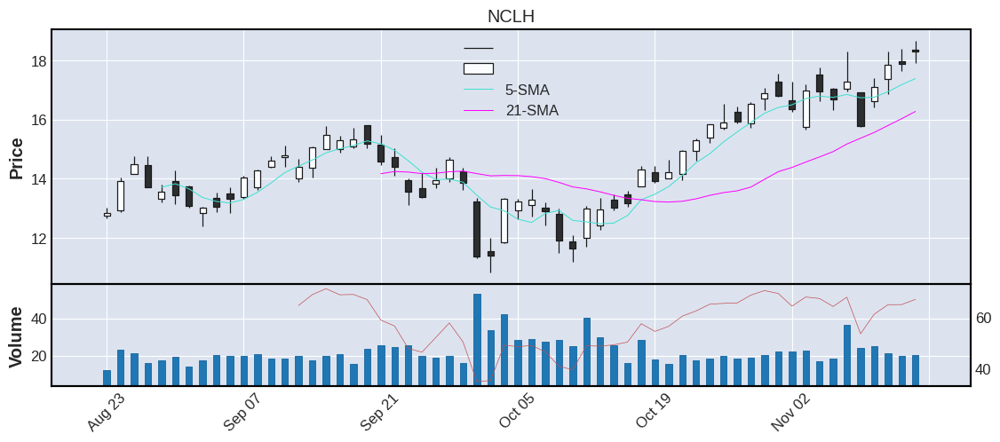



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
24    LUV  38.64  67.69  7.34    6.55  2.36  1.11  2.87  Consumer_Discretionary  0.0  United States    large


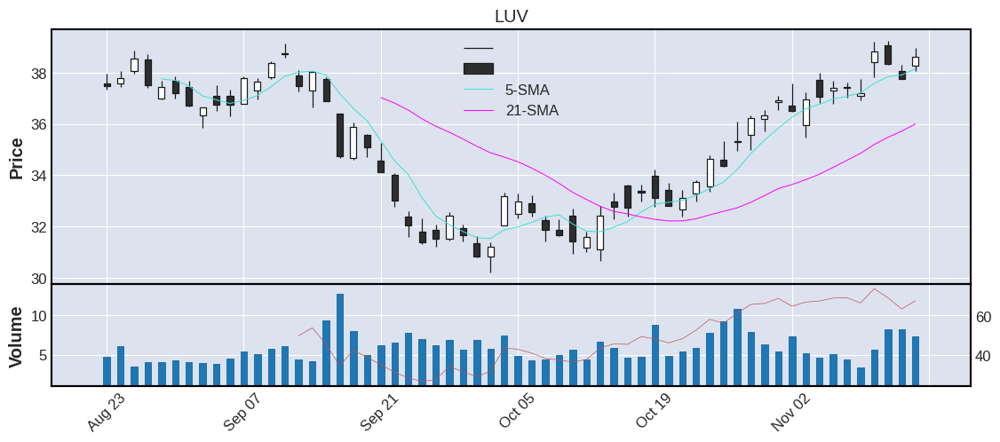



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
25    NKE  106.71  66.58  7.22    8.57  2.22  3.98  3.73  Consumer_Discretionary  0.0  United States    large


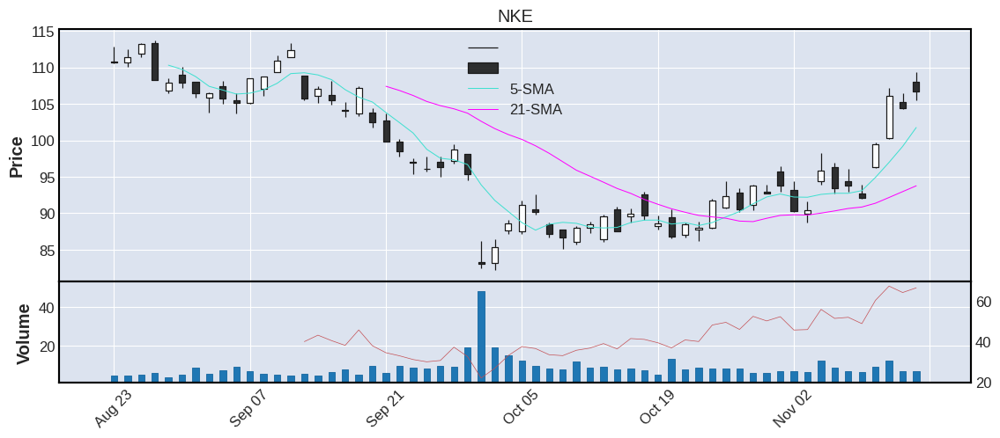



   TICKER     CP   RSI   VOL  AVGVOL  %CHG  ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
26    LVS  43.93  67.1  5.36    6.08  2.16  2.1  4.78  Consumer_Discretionary  2004.0  United States    large


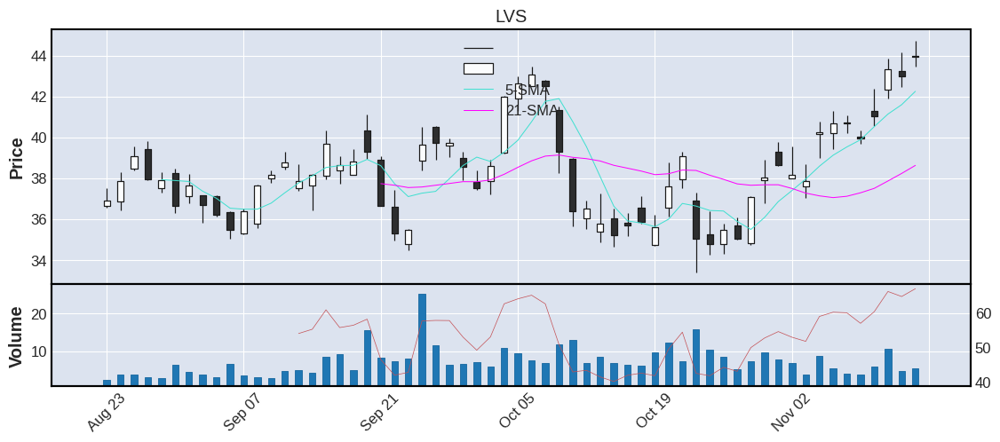



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
27    TPR  34.98  61.38  3.1    4.73  2.13  1.58  4.52  Consumer_Discretionary  0.0  United States   medium


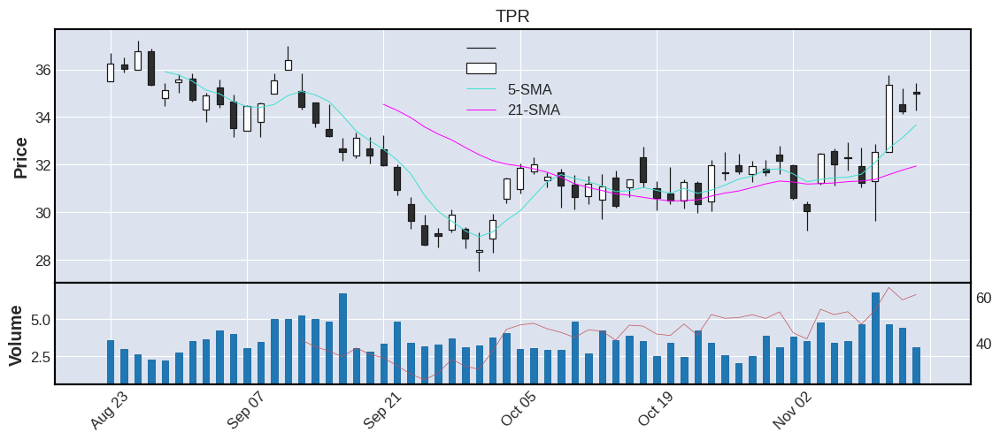



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
28    UPS  181.47  65.61  2.59    3.11  2.07  5.18  2.85  Consumer_Discretionary  1999.0  United States    large


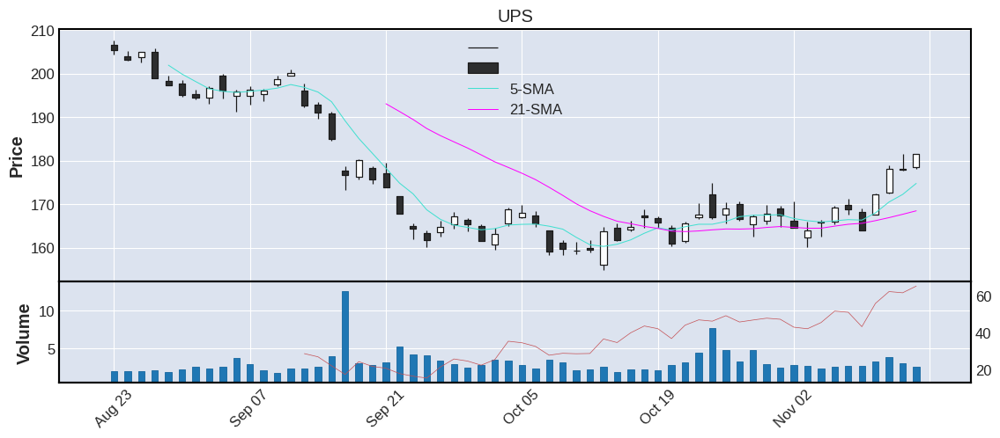



   TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
29    LOW  208.84  62.57  5.1    4.28  2.04  7.16  3.43  Consumer_Discretionary  0.0  United States    large


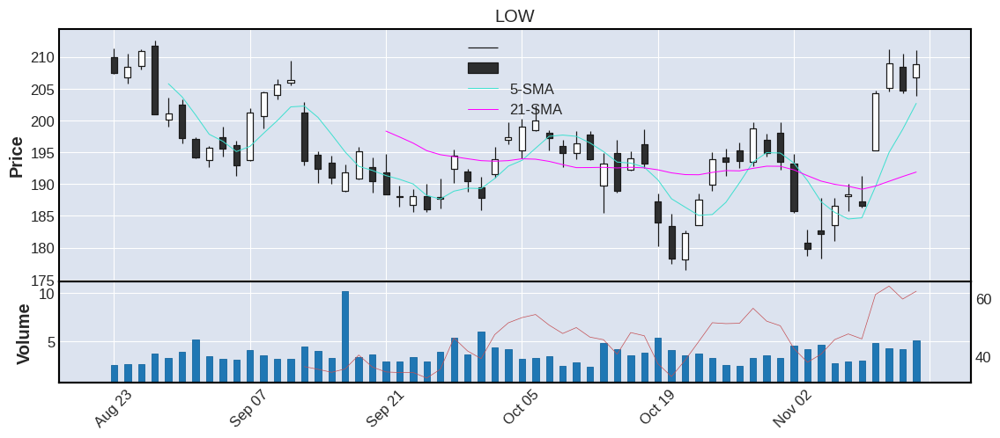



   TICKER     CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
30    BWA  42.79  76.01  2.44    2.31  1.93  1.3  3.04  Consumer_Discretionary  0.0  United States   medium


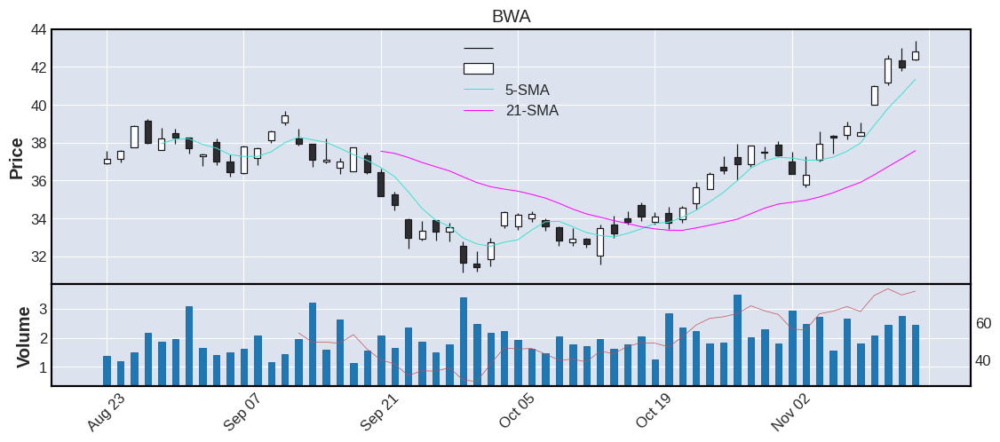



   TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
31    LKQ  54.65  60.09  1.45    1.56  1.9  1.48  2.71  Consumer_Discretionary  2003.0  United States    large


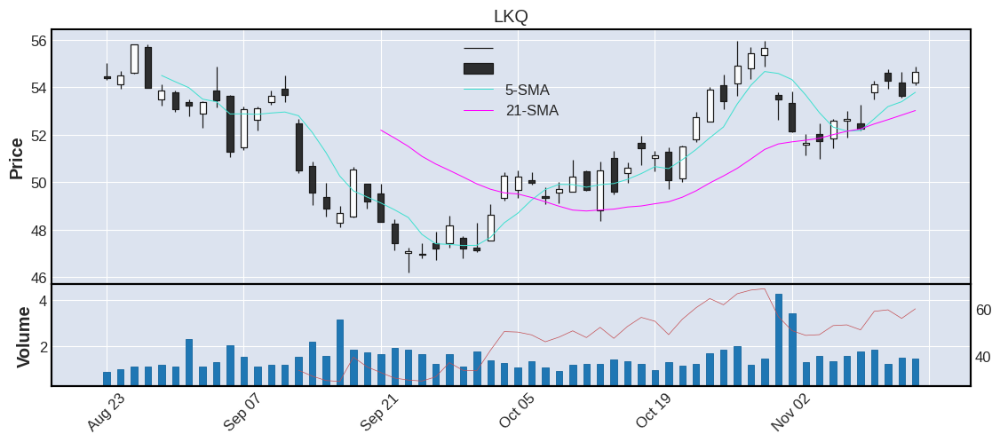



   TICKER      CP    RSI    VOL  AVGVOL  %CHG    ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
32   TSLA  194.42  38.25  90.97  111.44  1.82  12.96  6.67  Consumer_Discretionary  2010.0  United States     mega


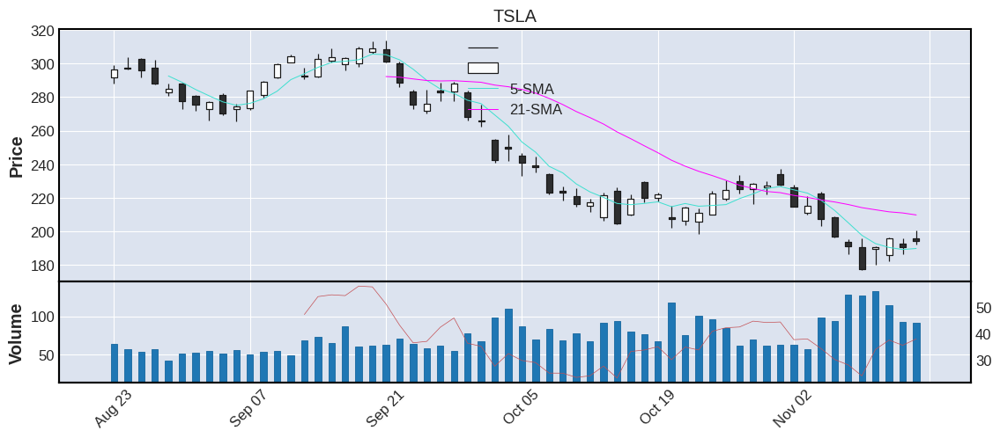



   TICKER    CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
33    BBY  75.6  68.25  2.28    2.39  1.8  2.61  3.45  Consumer_Discretionary  0.0  United States    large


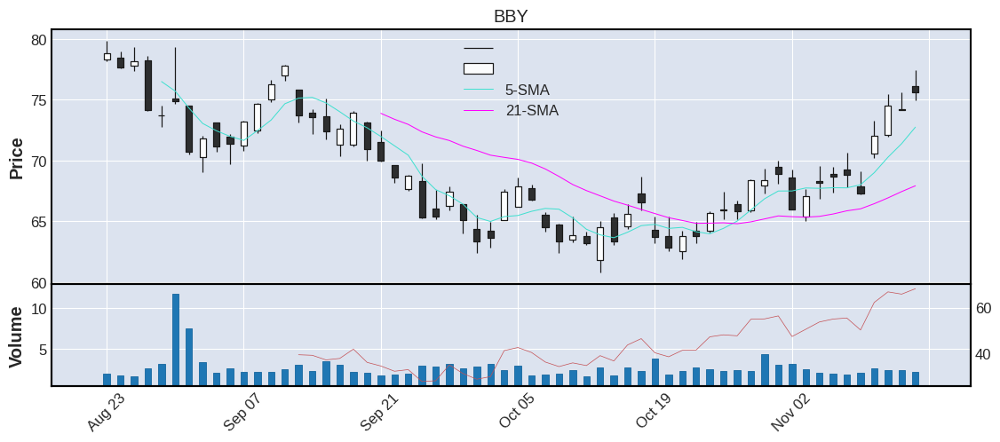



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
34   VRSK  177.0  53.16  1.81    1.23  1.74  5.15  2.91  Consumer_Discretionary  2009.0  United States    large


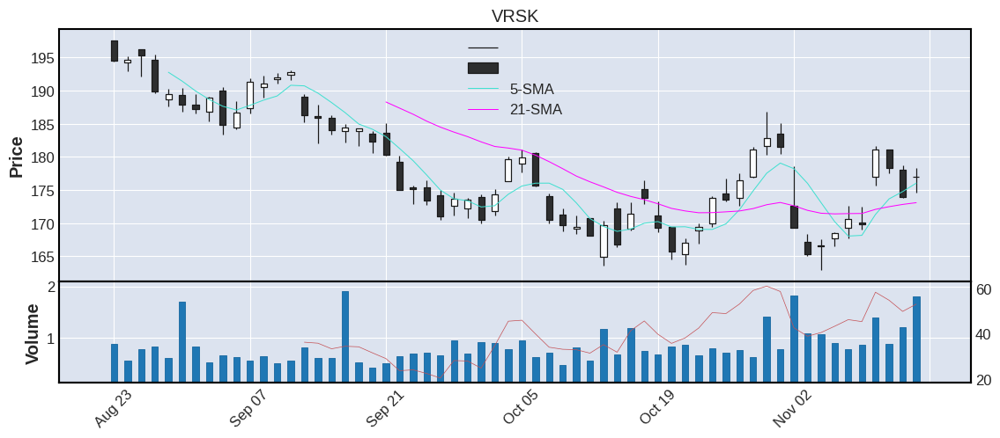



   TICKER    CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
35      F  14.3  63.04  60.33    65.6  1.71  0.53  3.71  Consumer_Discretionary  0.0  United States    large


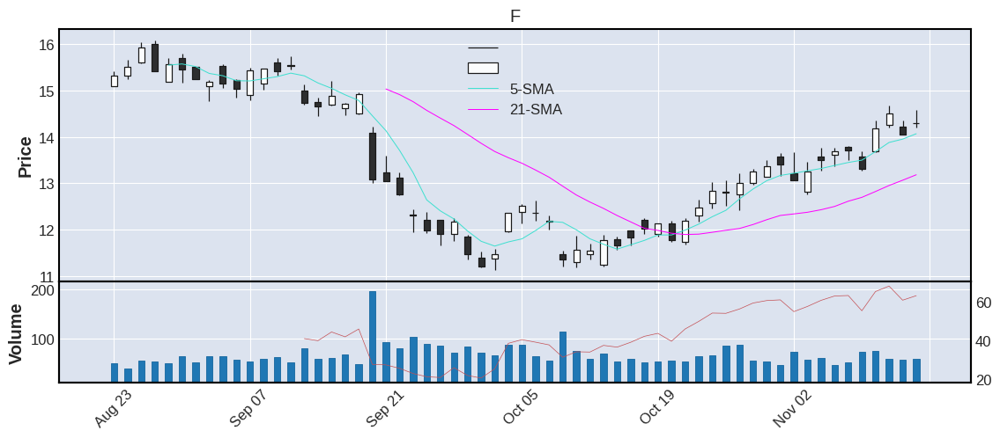



   TICKER     CP    RSI   VOL  AVGVOL %CHG  ATR  %ATR                  SECTOR     IPO COUNTRY CATEGORY
36   CARR  44.35  69.61  2.59    3.95  1.7  1.4  3.16  Consumer_Discretionary  2020.0     N-A    large


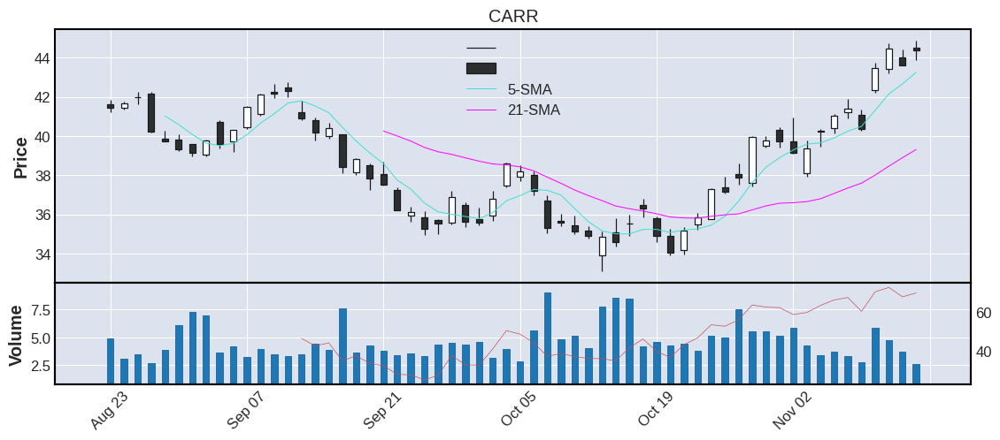



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
37     HD  311.93  62.84  9.24    6.29  1.63  9.73  3.12  Consumer_Discretionary  0.0  United States     mega


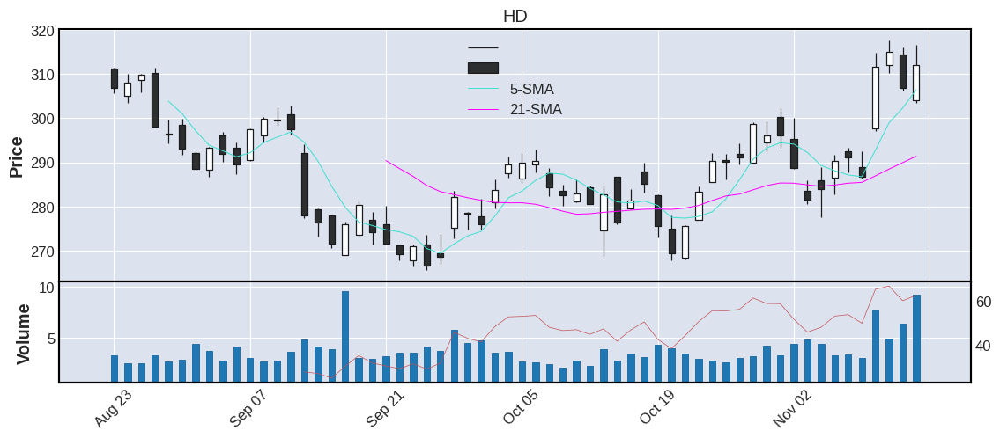



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
38    CLX  144.93  57.58  0.77    1.14  1.6  4.63  3.19  Consumer_Discretionary  0.0  United States    large


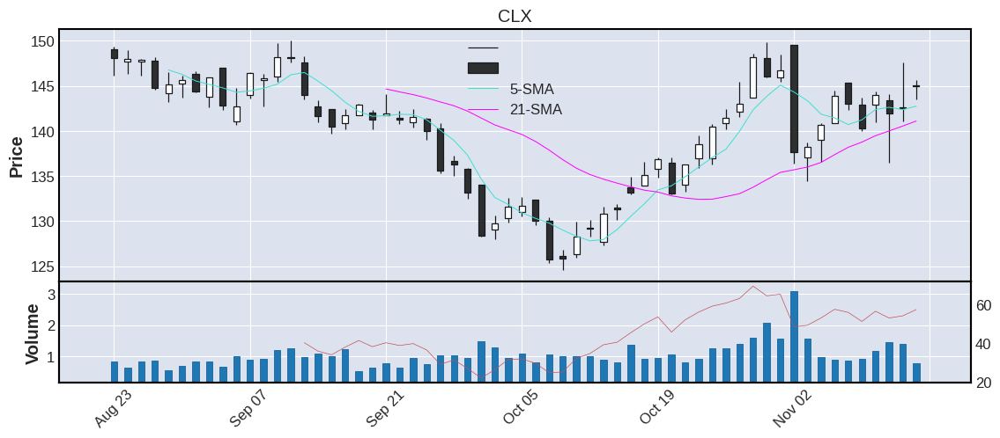



   TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
39     GE  87.14  78.9  4.83    6.22  1.53  2.29  2.63  Consumer_Discretionary  0.0  United States    large


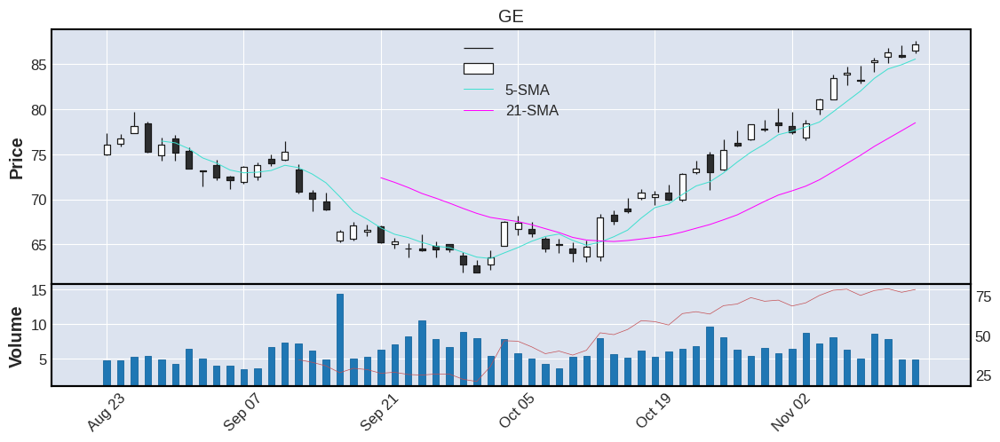



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
40   ALLE  112.64  65.5  0.51    0.78  1.52  3.98  3.53  Consumer_Discretionary  2013.0  United States   medium


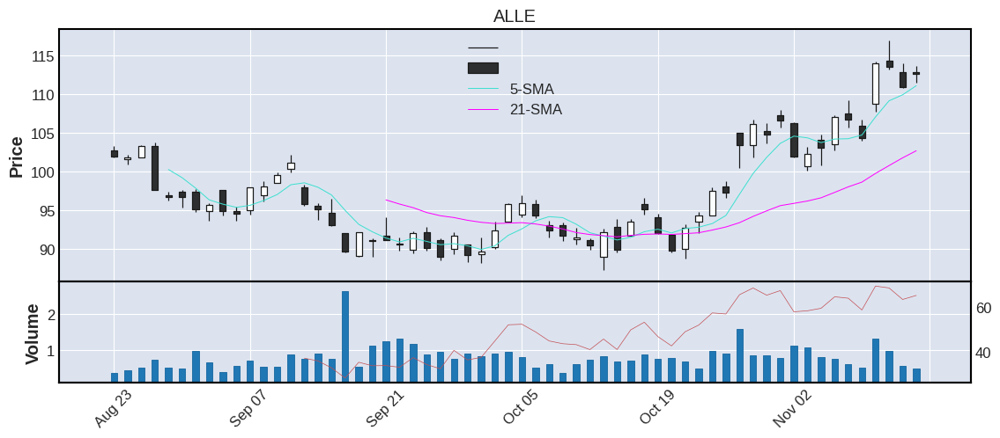



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
41      V  209.99  62.92  6.12    7.38  1.51  6.21  2.96  Consumer_Discretionary  0.0  United States     mega


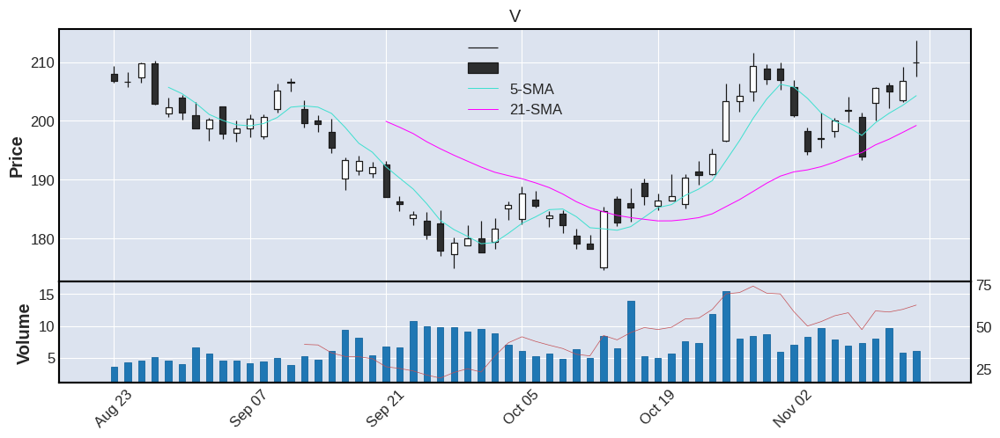



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
42    MGM  37.49  63.94  6.16    5.67  1.46  1.65   4.4  Consumer_Discretionary  0.0  United States    large


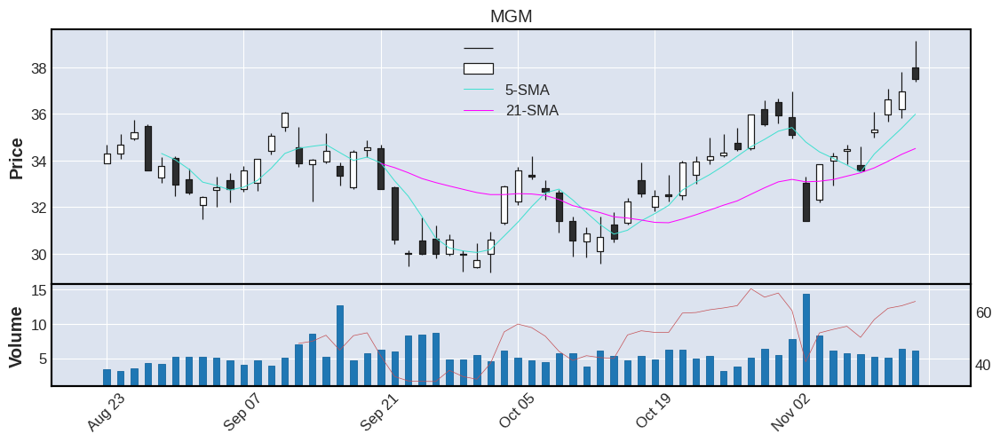



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
43    IPG  32.92  71.98  2.45    3.54  1.45  0.93  2.83  Consumer_Discretionary  0.0  United States    large


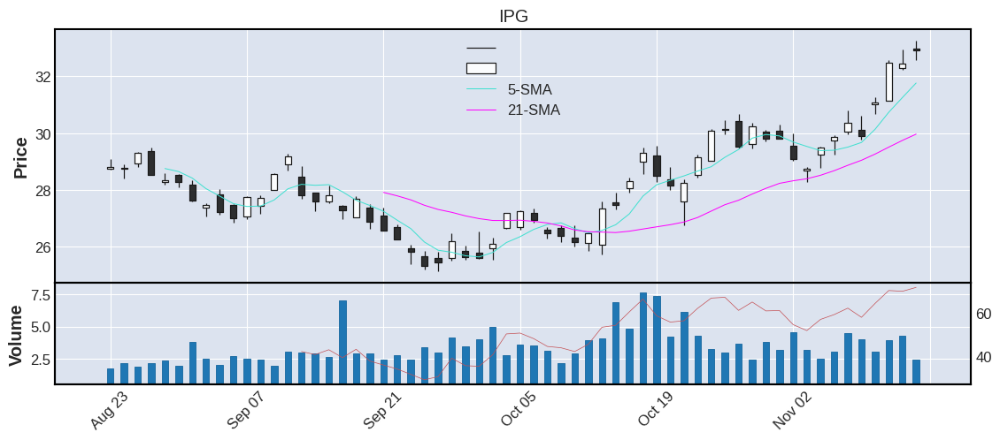



   TICKER      CP    RSI  VOL  AVGVOL %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
44    MAR  161.77  60.62  2.0    2.26  1.4  5.39  3.33  Consumer_Discretionary  0.0  United States    large


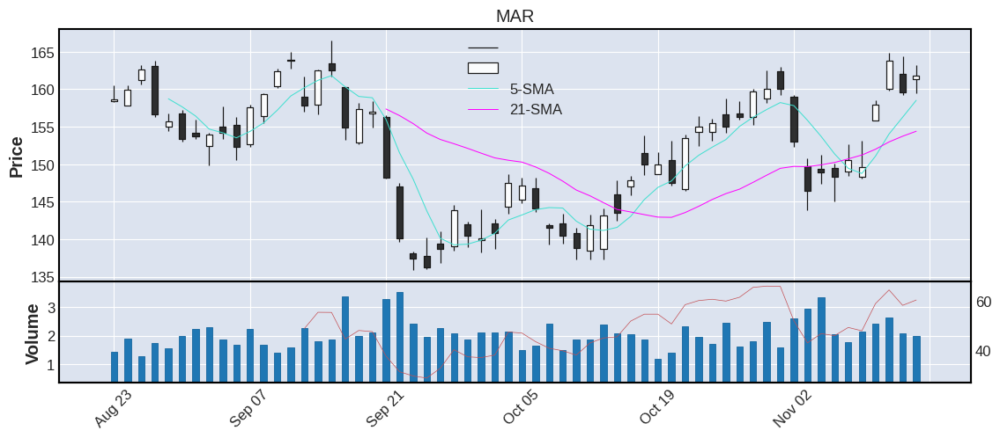



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO         COUNTRY CATEGORY
45   APTV  111.15  70.41  1.89    2.26  1.39  4.18  3.76  Consumer_Discretionary  2011.0  United Kingdom    large


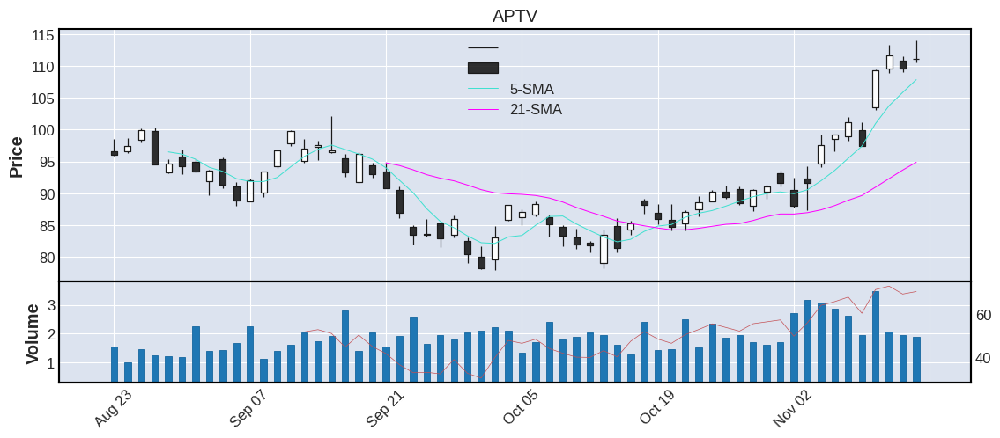



   TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
46    CHD  75.51  56.2  1.75    1.63  1.38  1.97  2.61  Consumer_Discretionary  0.0  United States    large


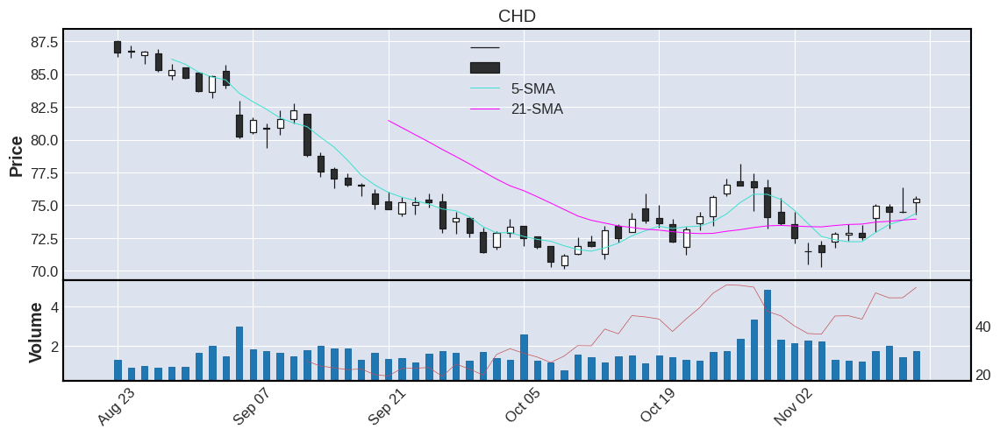



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
47   EXPE  99.94  55.68  2.84    2.74  1.35  5.27  5.27  Consumer_Discretionary  0.0  United States    large


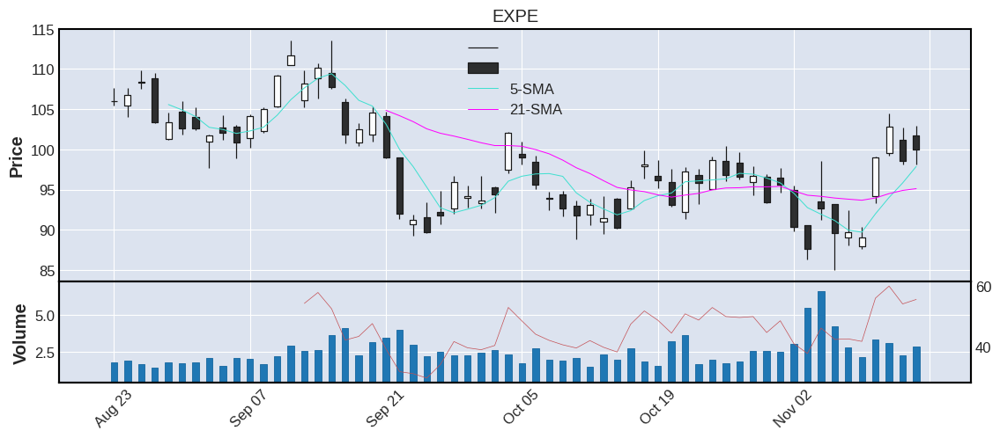



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
48   CPRT  62.06  67.06  2.1     2.3  1.34  1.72  2.77  Consumer_Discretionary  1994.0  United States    large


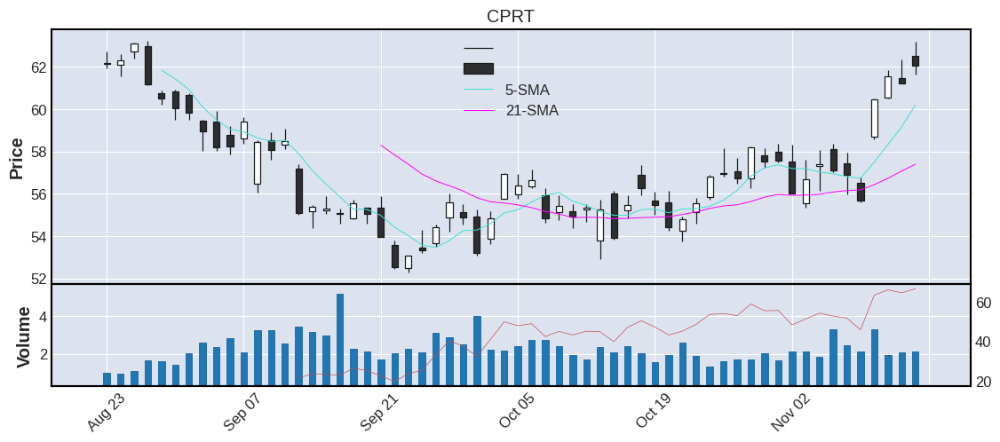



   TICKER     CP   RSI    VOL  AVGVOL %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
49    DIS  95.51  44.6  15.64   31.51  1.3  3.86  4.04  Consumer_Discretionary  0.0  United States    large


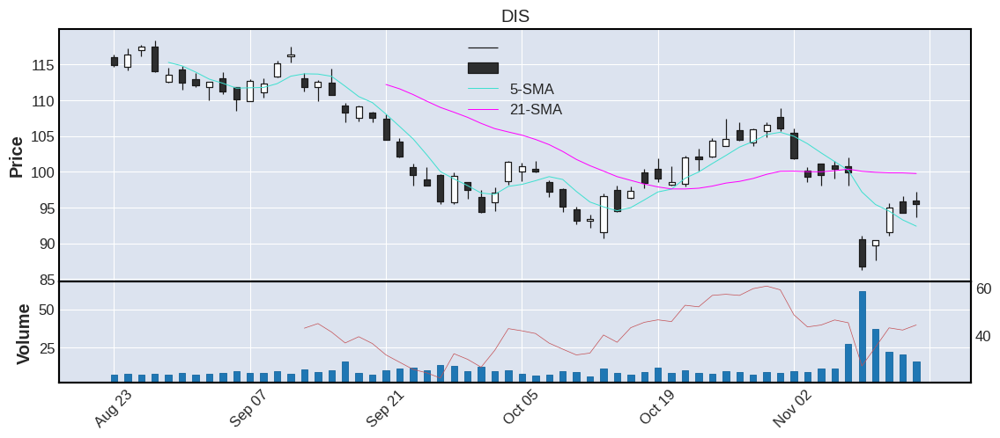



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
50    ADP  253.32  62.57  1.52    1.82  1.3  6.85   2.7  Consumer_Discretionary  0.0  United States    large


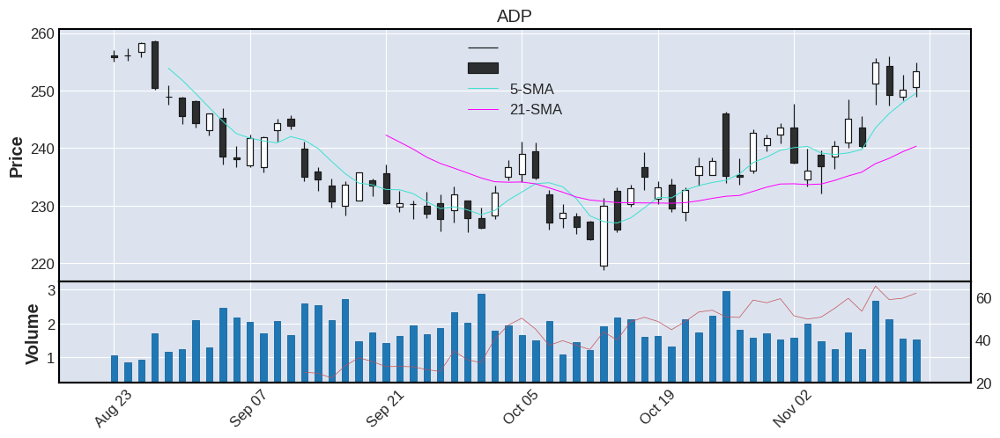



================================================== SECTOR 4: FINANCE [ %CHG ] ================================================== 

    TICKER      CP    RSI    VOL  AVGVOL  %CHG    ATR  %ATR   SECTOR     IPO         COUNTRY CATEGORY
1    SIVB  239.93  43.90   1.63    1.40  9.18  17.22  7.18  Finance     0.0   United States    large
2    SBNY  147.94  48.89   1.94    1.85  6.61   8.88  6.00  Finance  2004.0   United States   medium
3     FRC  130.56  57.80   1.88    2.48  5.45   4.83  3.70  Finance     0.0   United States    large
4    CBOE  122.63  50.84   1.08    1.39  3.38   3.81  3.11  Finance  2010.0             N-A    large
5     LNC   34.16  32.59   2.14    2.68   2.8   2.53  7.41  Finance     0.0   United States   medium
6     MTB  169.92  49.13   1.54    1.49  2.45   4.17  2.45  Finance     0.0   United States    large
7    SCHW   78.30  57.63   6.63    9.71  2.39   2.43  3.10  Finance     0.0   United States    large
8     ALL  132.03  56.14   2.00    1.48  2.32   4.62  3.50

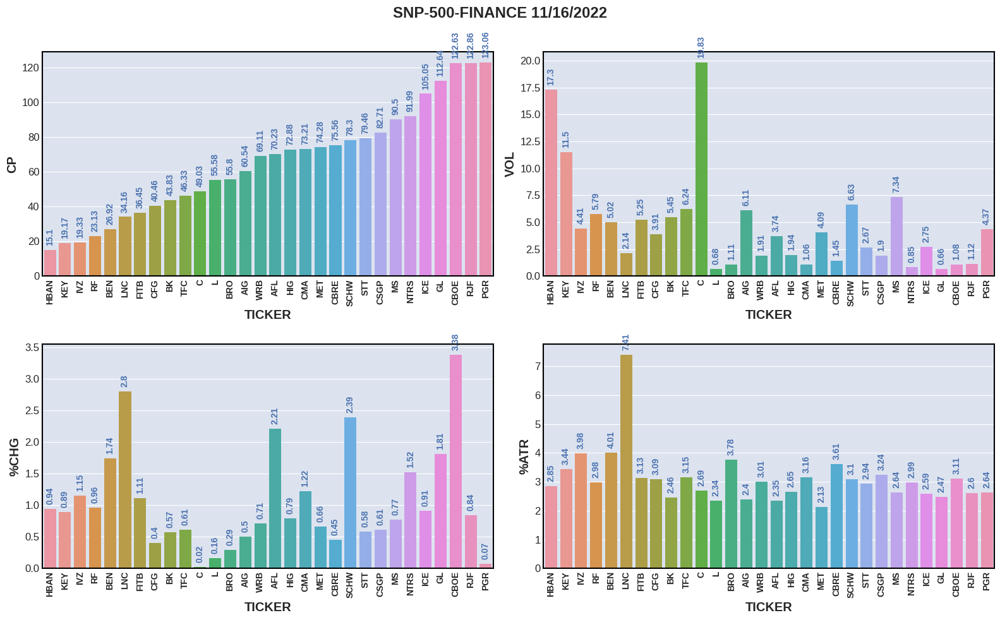

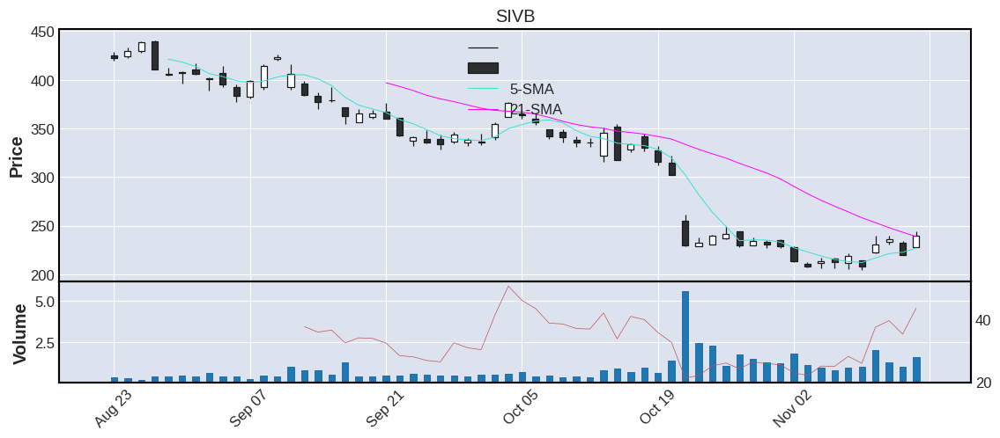



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
2   SBNY  147.94  48.89  1.94    1.85  6.61  8.88   6.0  Finance  2004.0  United States   medium


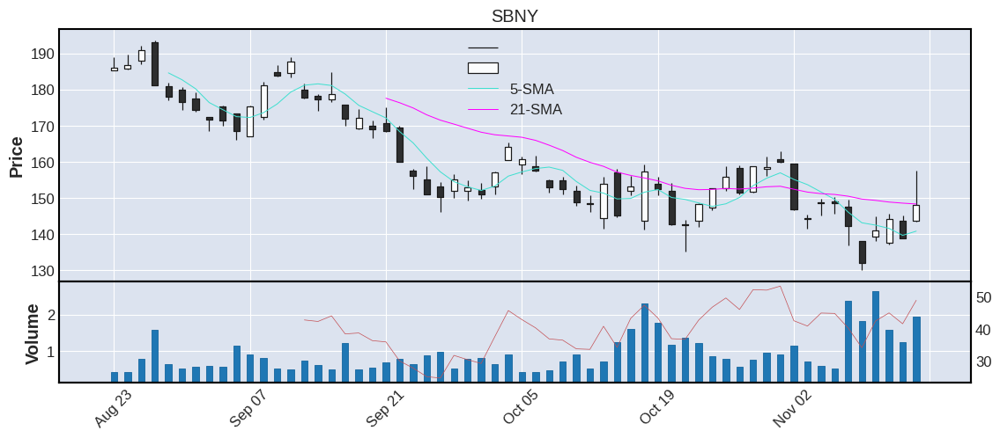



  TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
3    FRC  130.56  57.8  1.88    2.48  5.45  4.83   3.7  Finance  0.0  United States    large


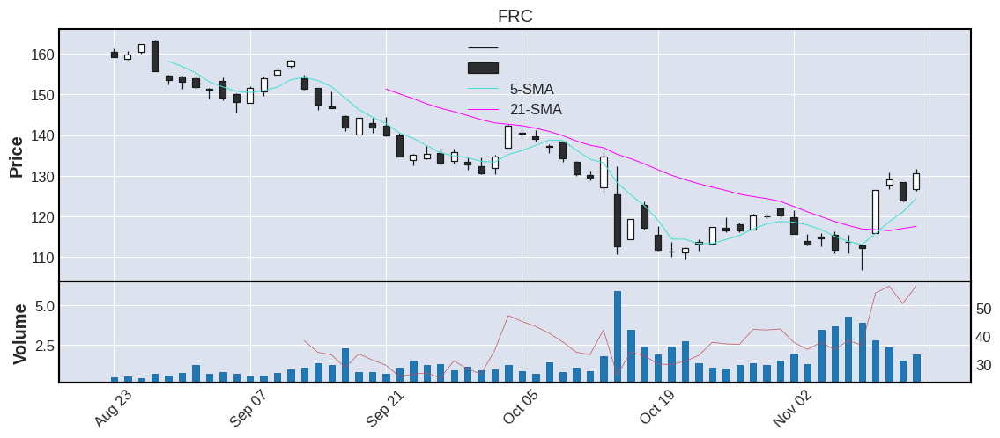



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO COUNTRY CATEGORY
4   CBOE  122.63  50.84  1.08    1.39  3.38  3.81  3.11  Finance  2010.0     N-A    large


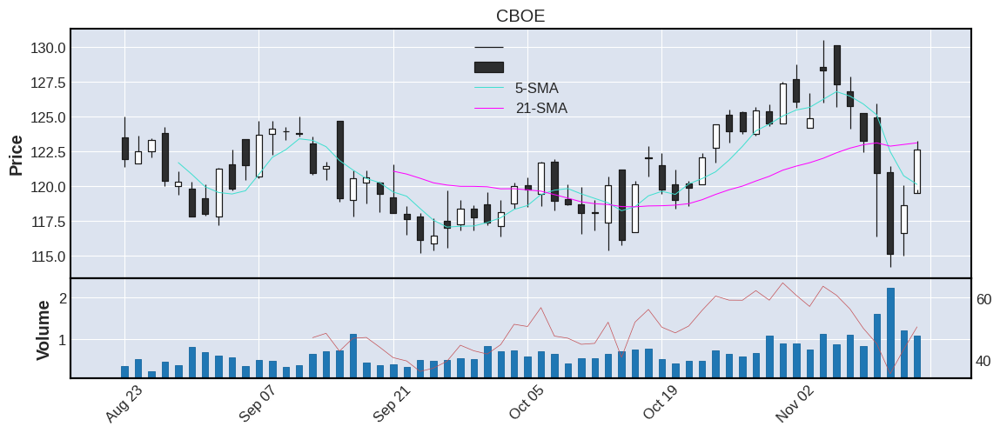



  TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
5    LNC  34.16  32.59  2.14    2.68  2.8  2.53  7.41  Finance  0.0  United States   medium


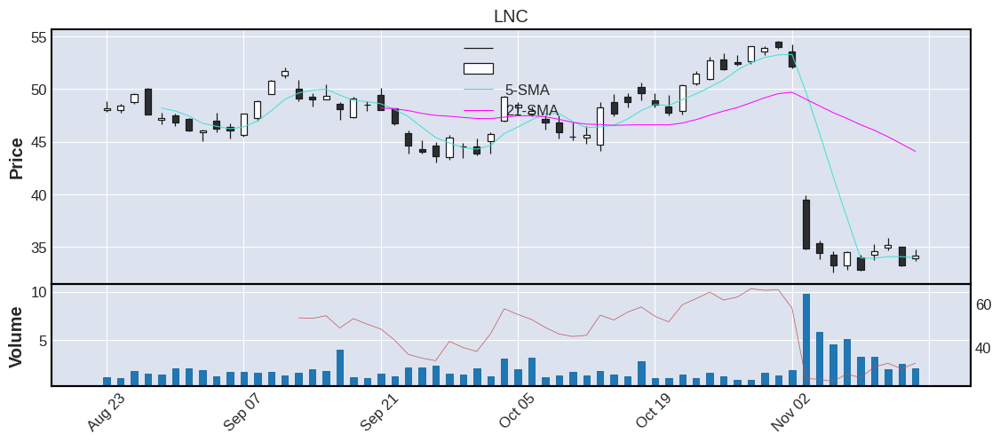



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
6    MTB  169.92  49.13  1.54    1.49  2.45  4.17  2.45  Finance  0.0  United States    large


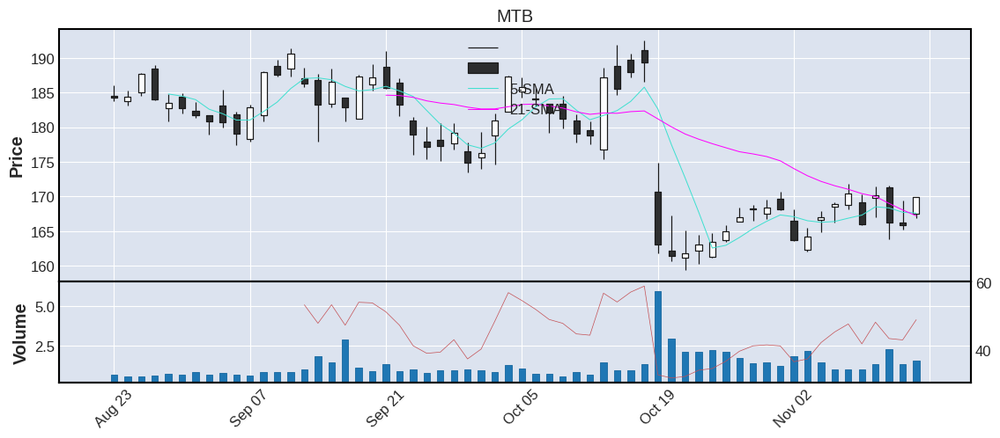



  TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
7   SCHW  78.3  57.63  6.63    9.71  2.39  2.43   3.1  Finance  0.0  United States    large


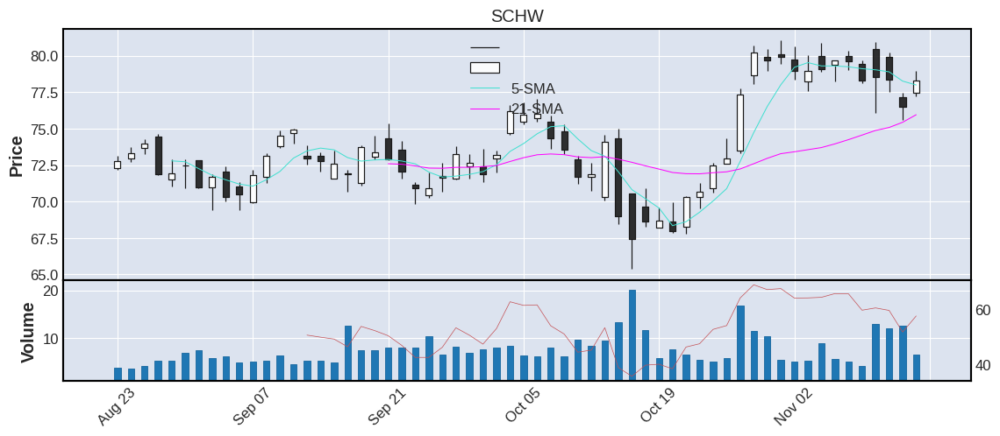



  TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
8    ALL  132.03  56.14  2.0    1.48  2.32  4.62   3.5  Finance  0.0  United States    large


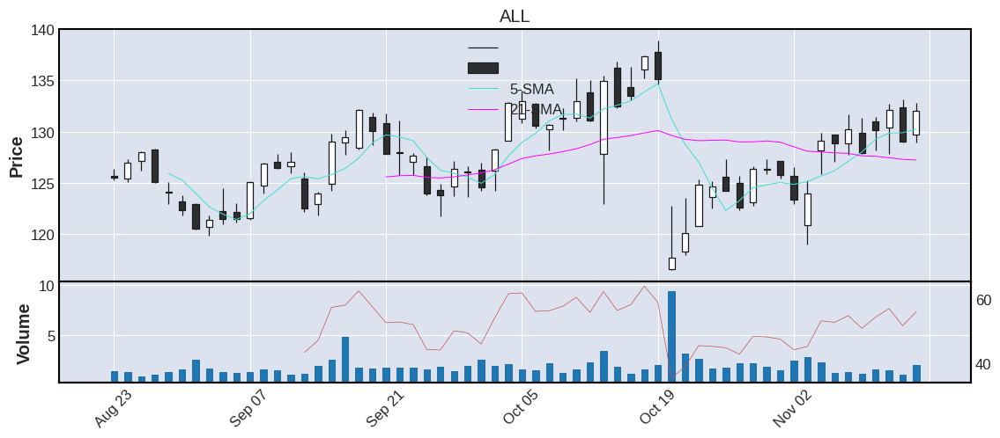



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
9    AFL  70.23  71.89  3.74    3.59  2.21  1.65  2.35  Finance  0.0  United States    large


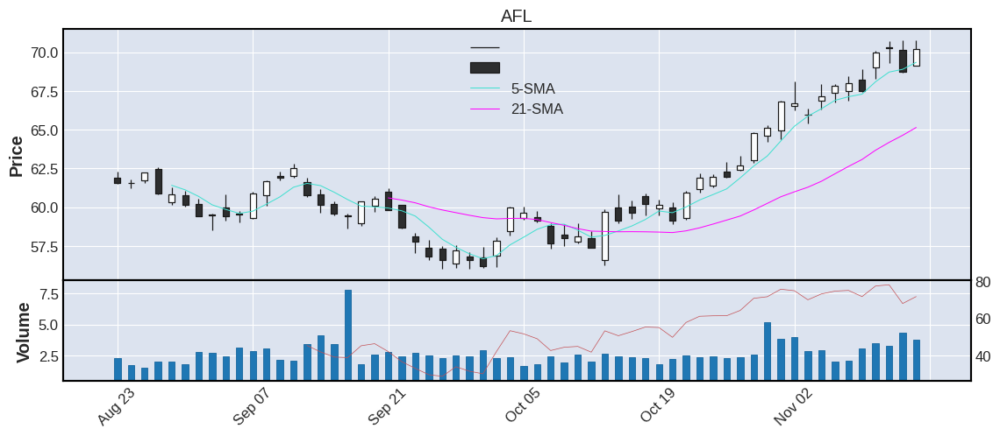



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
10   MSCI  503.02  65.22  0.39    0.48  2.19  17.82  3.54  Finance  0.0  United States    large


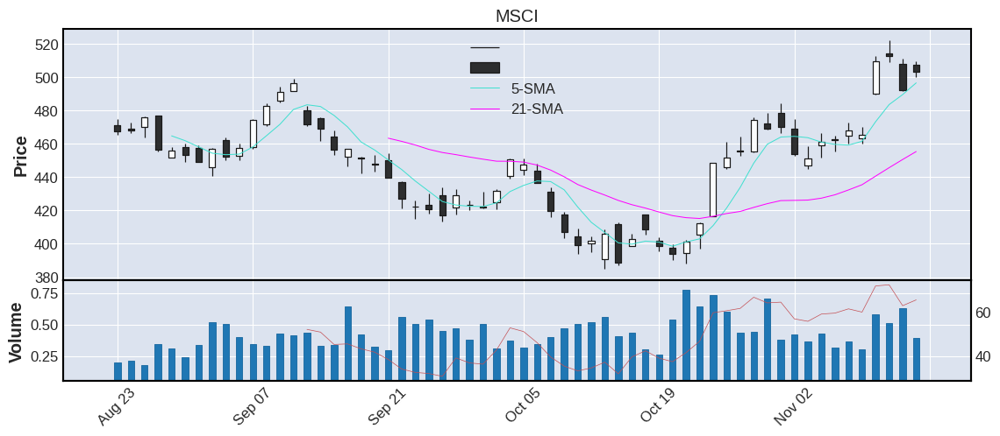



   TICKER      CP   RSI   VOL  AVGVOL  %CHG    ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
11   SPGI  354.66  66.5  1.41    1.82  2.01  11.13  3.14  Finance  0.0  United States    large


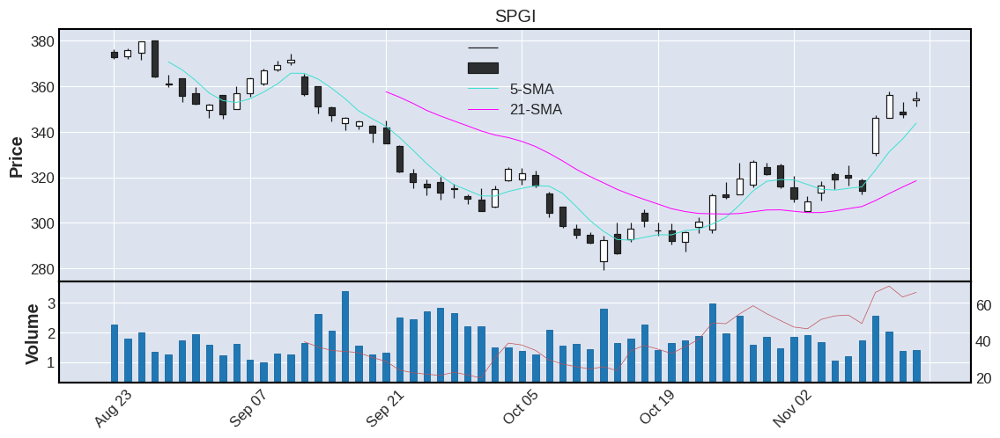



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR   SECTOR  IPO  COUNTRY CATEGORY
12     RE  316.21  58.87  0.28    0.31  1.98  10.53  3.33  Finance  0.0  Bermuda    large


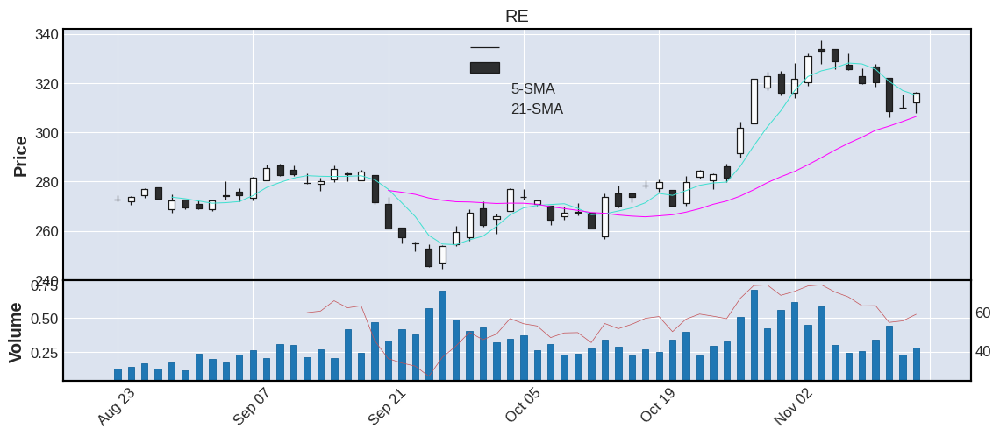



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
13    FDS  432.92  57.29  0.22    0.24  1.96  11.1  2.56  Finance  2000.0  United States    large


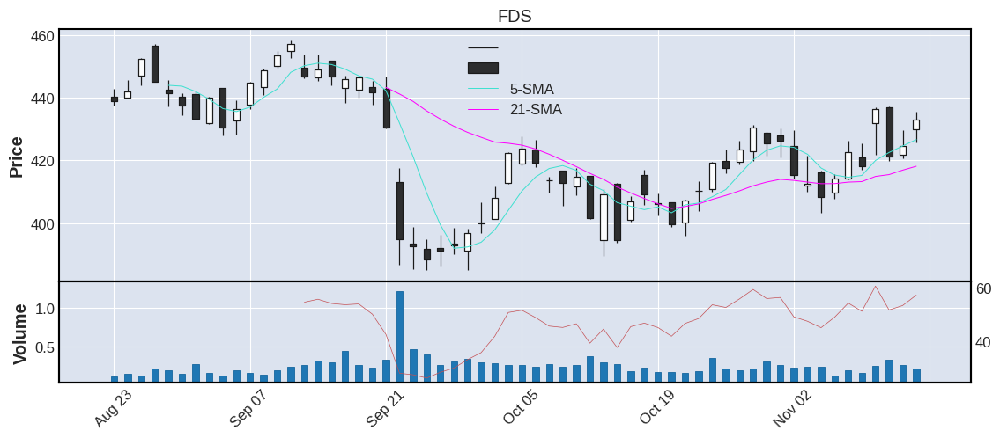



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
14     GL  112.64  54.11  0.66    0.61  1.81  2.78  2.47  Finance  0.0  United States    large


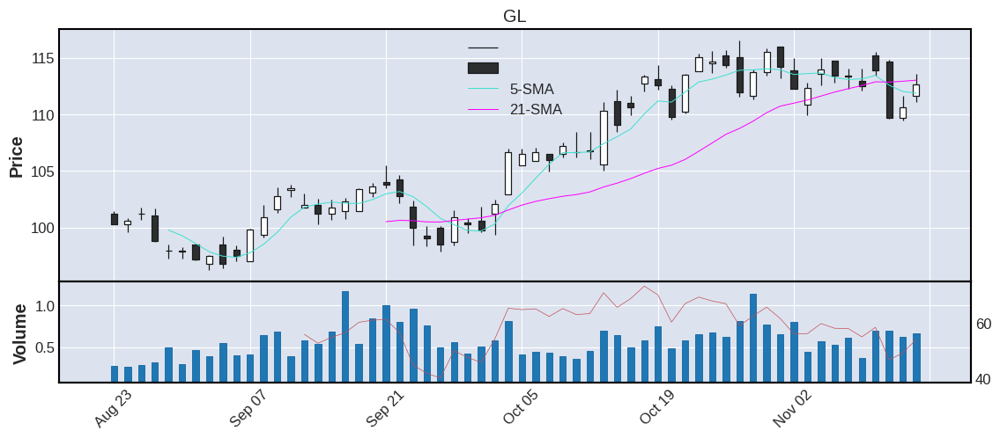



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
15    MCO  298.74  65.13  0.86    1.18  1.75  10.94  3.66  Finance  0.0  United States    large


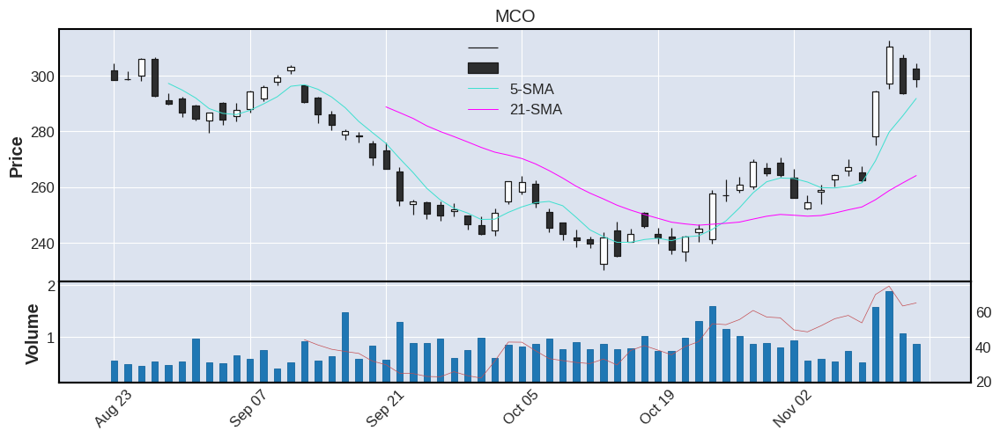



   TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
16    BEN  26.92  66.6  5.02    5.06  1.74  1.08  4.01  Finance  0.0  United States    large


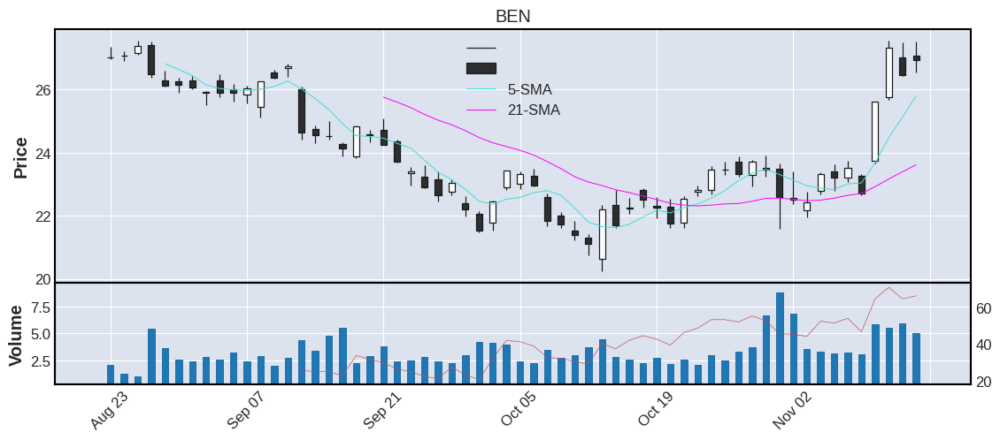



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
17   NTRS  91.99  59.66  0.85    0.91  1.52  2.75  2.99  Finance  0.0  United States    large


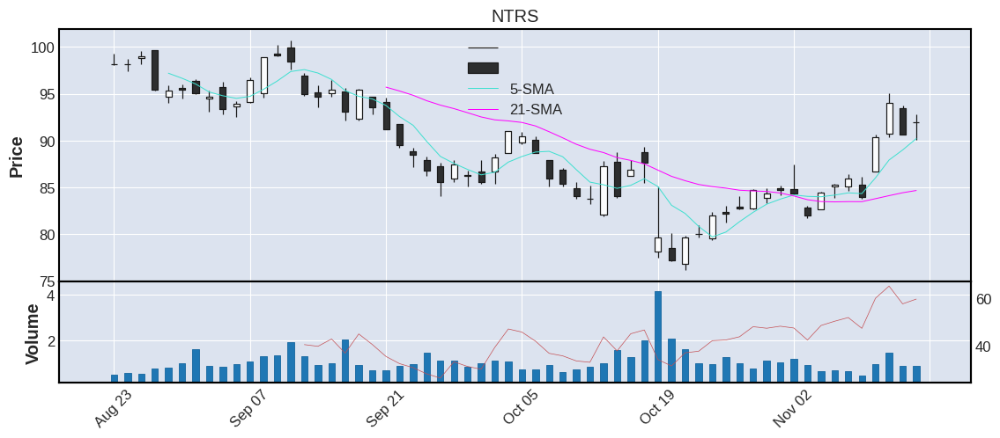



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
18    CMA  73.21  54.25  1.06    1.57  1.22  2.31  3.16  Finance  0.0  United States   medium


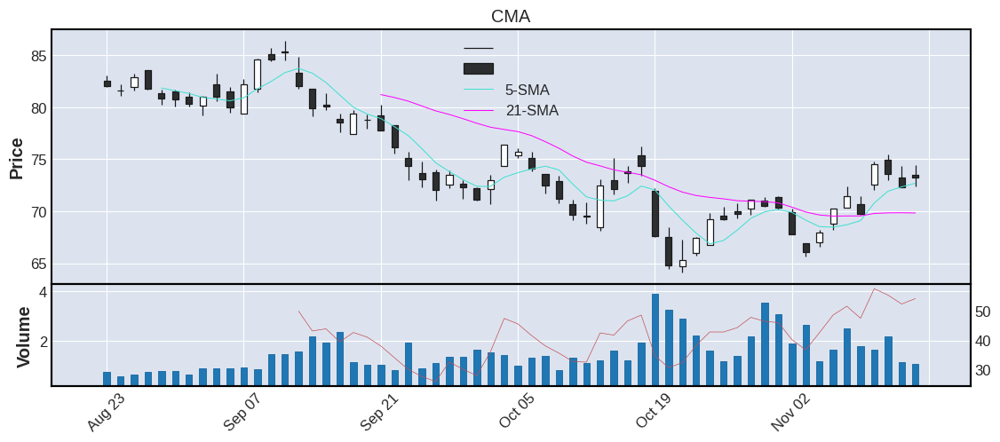



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
19     IT  338.44  68.61  0.39    0.43  1.21  10.46  3.09  Finance  1993.0  United States    large


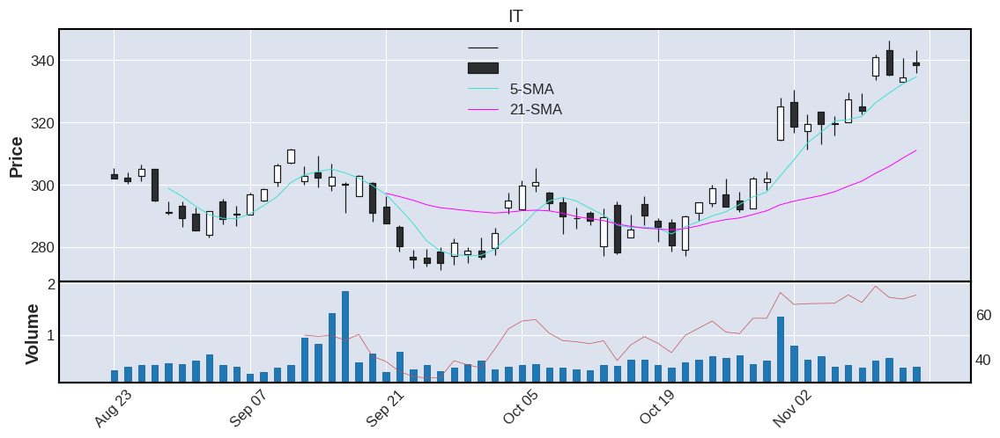



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
20    IVZ  19.33  71.41  4.41    8.08  1.15  0.77  3.98  Finance  0.0  United States   medium


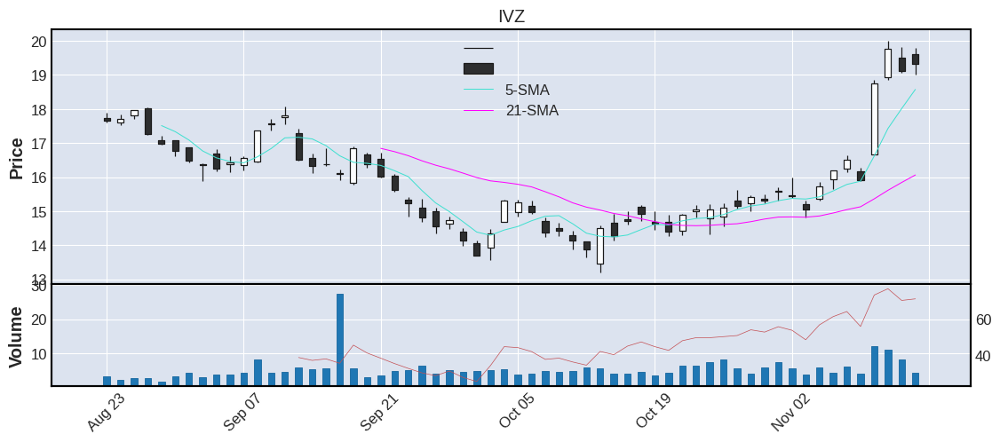



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
21   FITB  36.45  57.89  5.25    5.86  1.11  1.14  3.13  Finance  0.0  United States    large


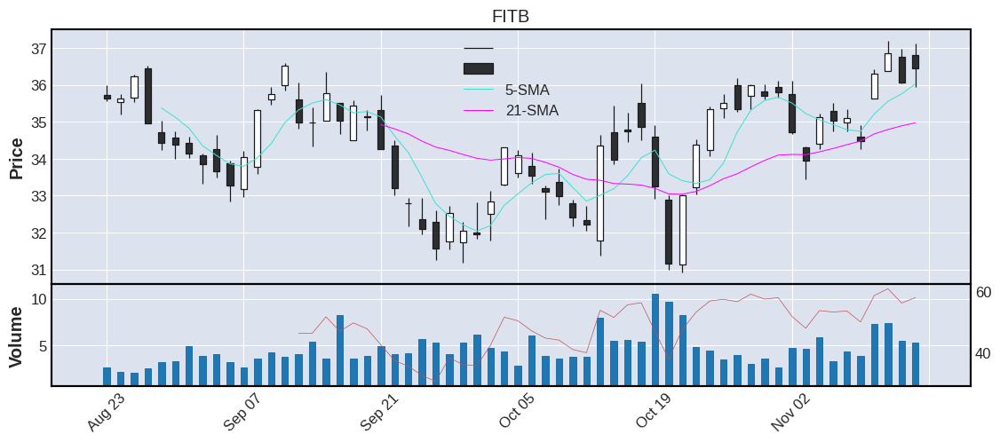



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
22    AJG  187.78  55.25  0.94    0.97  1.08  4.87  2.59  Finance  0.0  United States    large


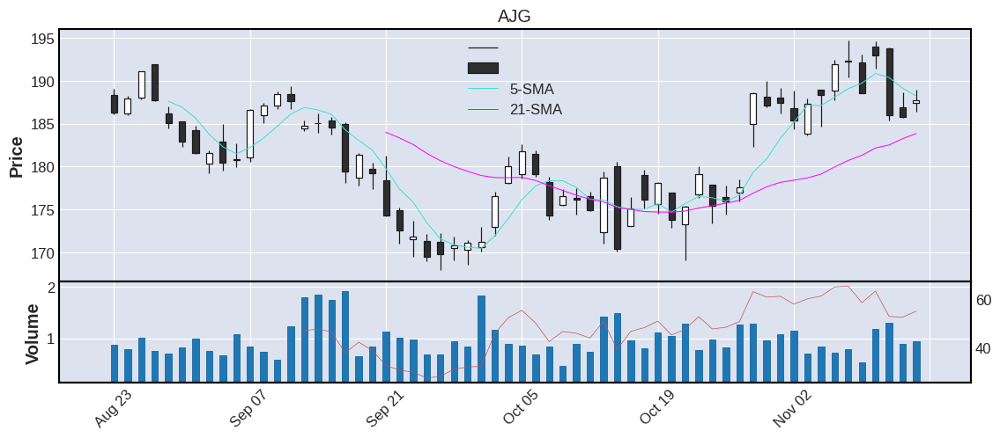



   TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
23     RF  23.13  61.3  5.79    6.44  0.96  0.69  2.98  Finance  0.0  United States    large


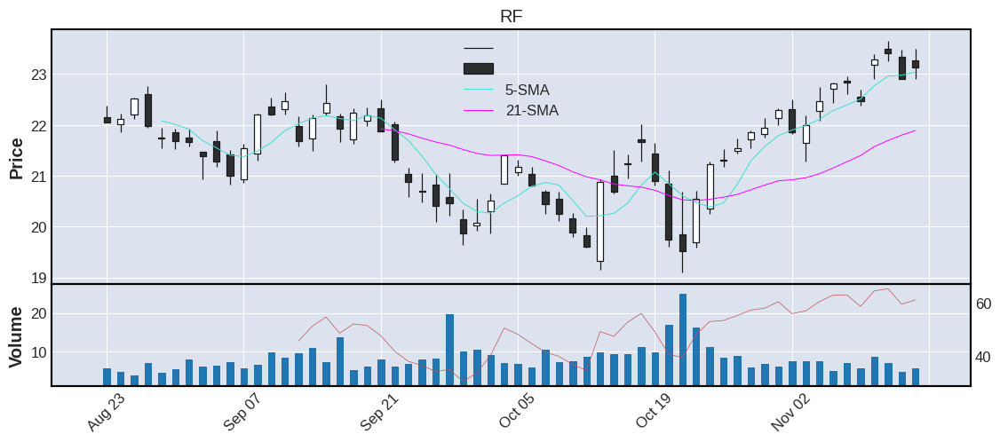



   TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
24   HBAN  15.1  57.25  17.3    21.0  0.94  0.43  2.85  Finance  0.0  United States    large


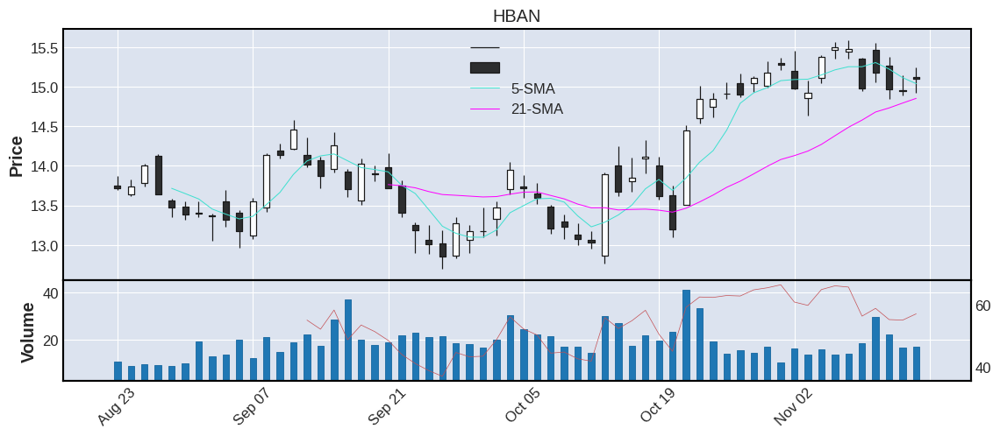



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
25    ICE  105.05  68.6  2.75    2.51  0.91  2.72  2.59  Finance  2005.0  United States    large


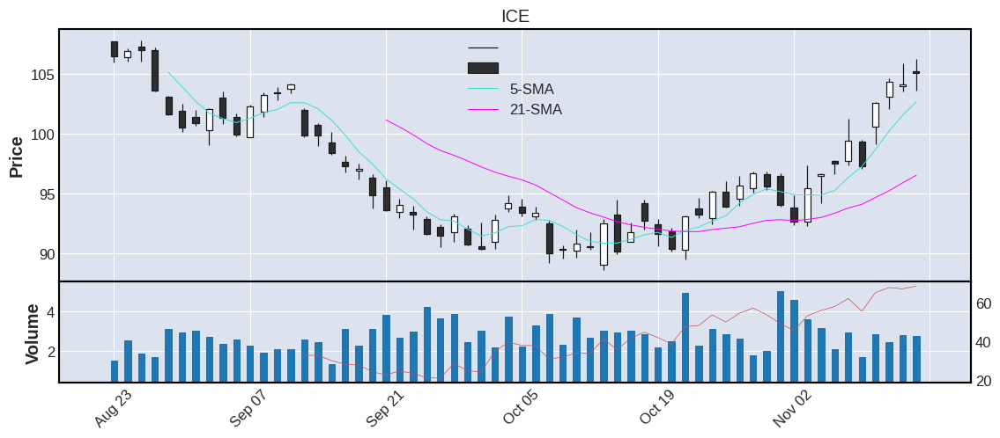



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
26    AMP  323.42  64.16  0.68    0.81  0.9  10.0  3.09  Finance  0.0  United States    large


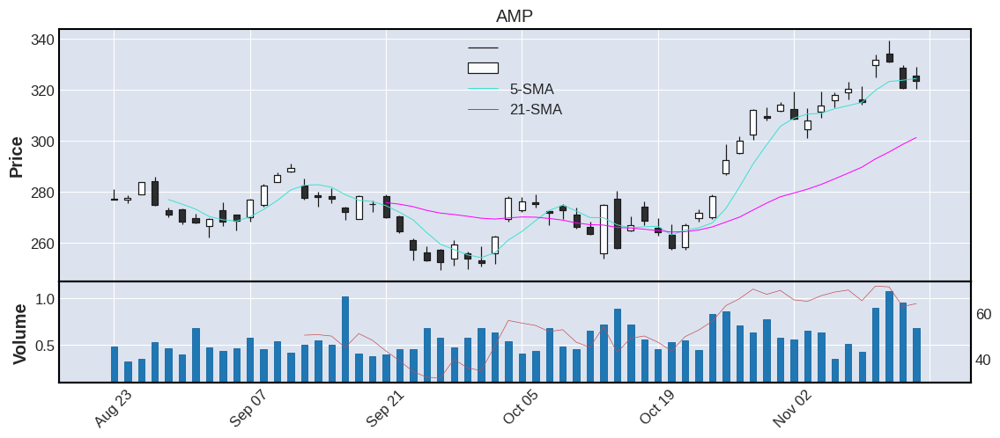



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
27    KEY  19.17  61.51  11.5   12.26  0.89  0.66  3.44  Finance  0.0  United States    large


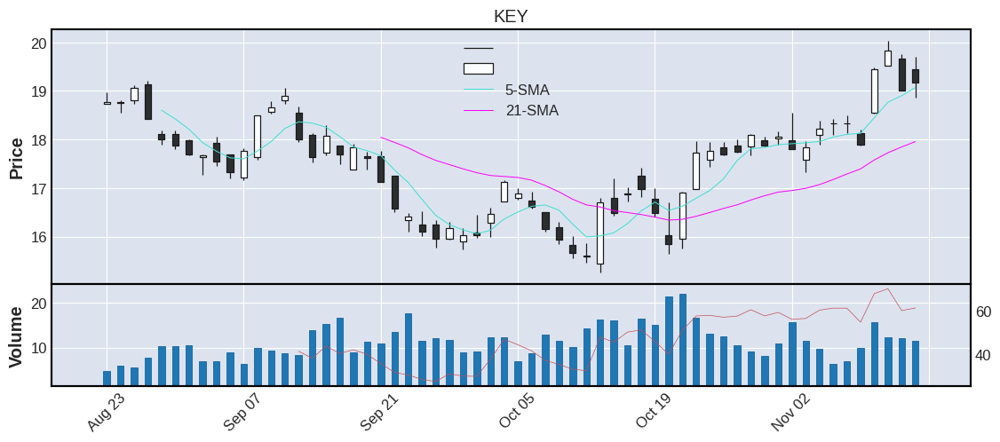



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
28    RJF  122.86  67.26  1.12    1.43  0.84  3.19   2.6  Finance  0.0  United States    large


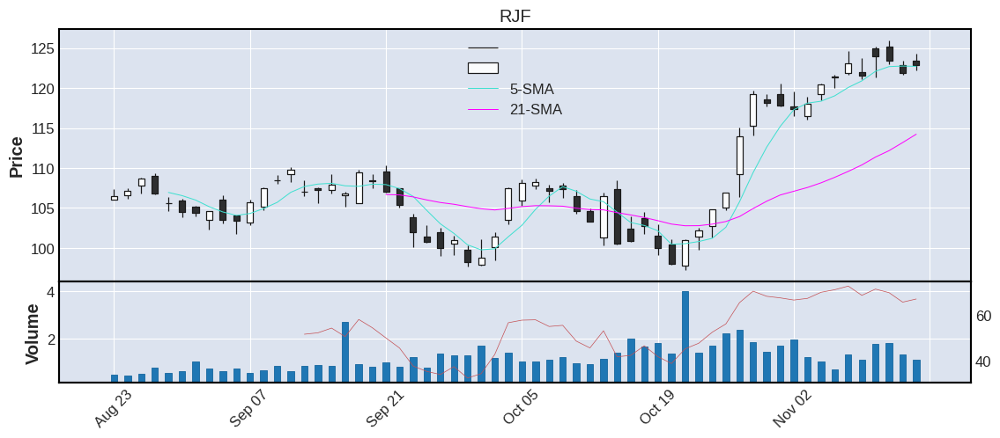



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
29    HIG  72.88  58.66  1.94    1.97  0.79  1.93  2.65  Finance  0.0  United States    large


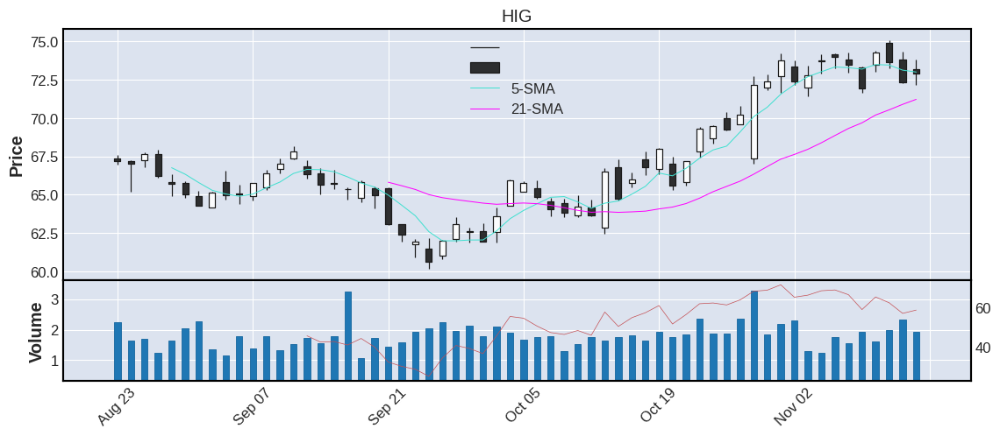



   TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
30     MS  90.5  66.89  7.34    7.31  0.77  2.39  2.64  Finance  0.0  United States    large


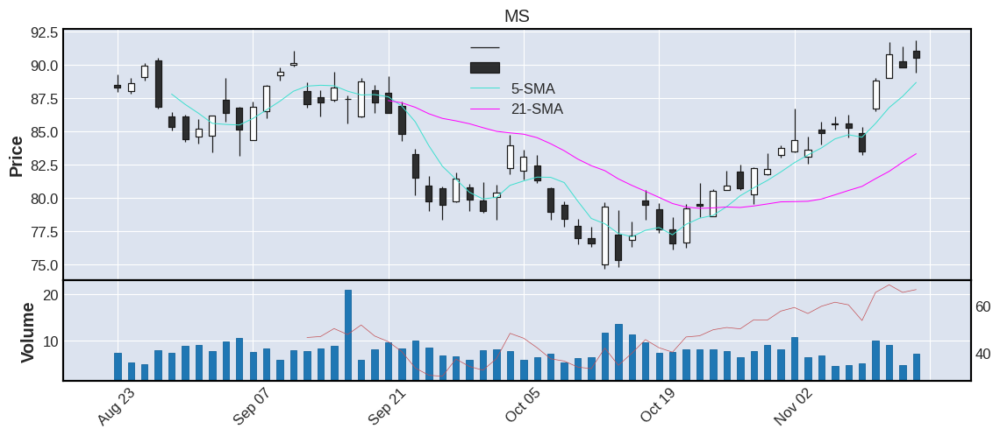



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO      COUNTRY CATEGORY
31     CB  206.63  54.51  1.44    1.92  0.75  5.44  2.63  Finance  0.0  Switzerland    large


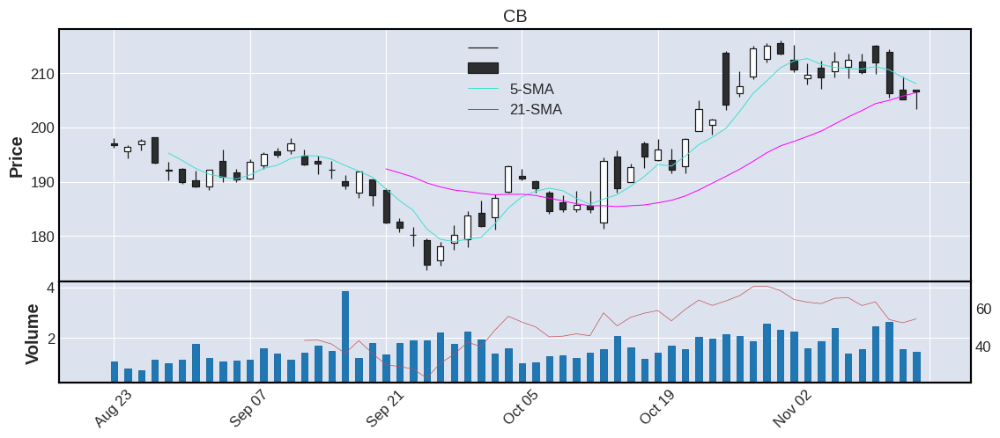



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
32    WRB  69.11  42.34  1.91    1.82  0.71  2.08  3.01  Finance  0.0  United States    large


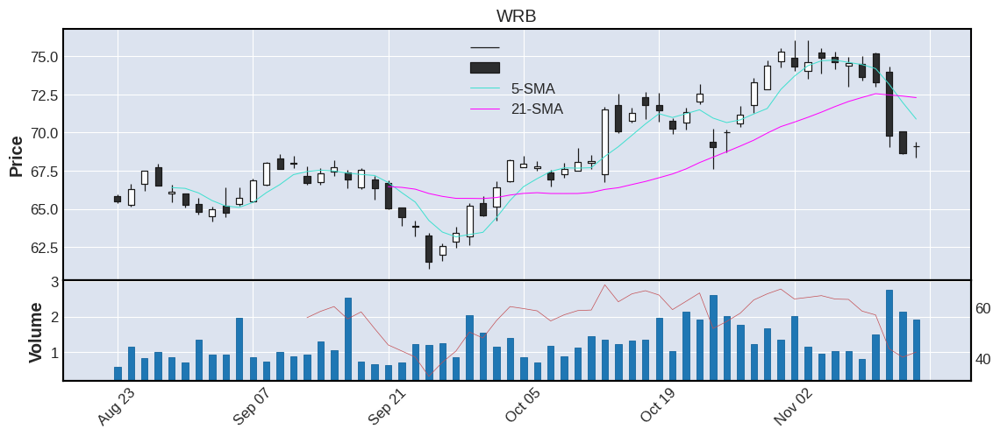



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
33   TROW  126.35  64.32  2.08    3.44  0.68  5.47  4.33  Finance  1986.0  United States    large


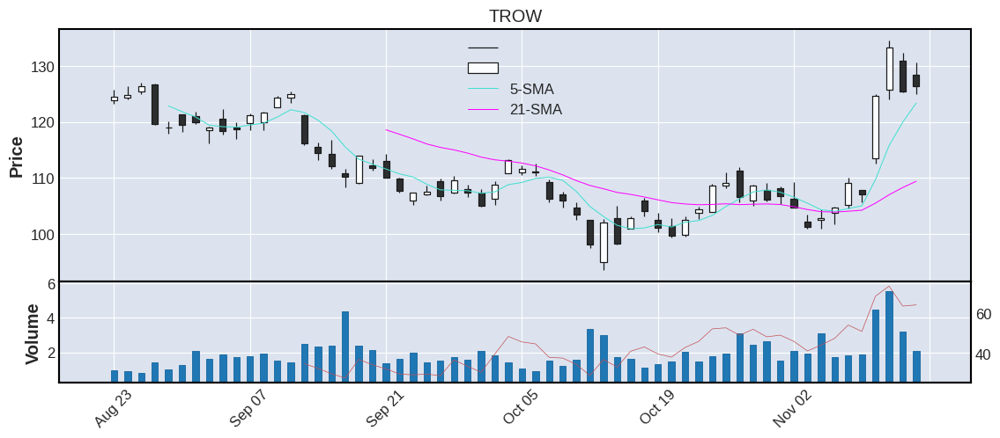



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
34    MET  74.28  66.05  4.09    4.51  0.66  1.58  2.13  Finance  2000.0  United States    large


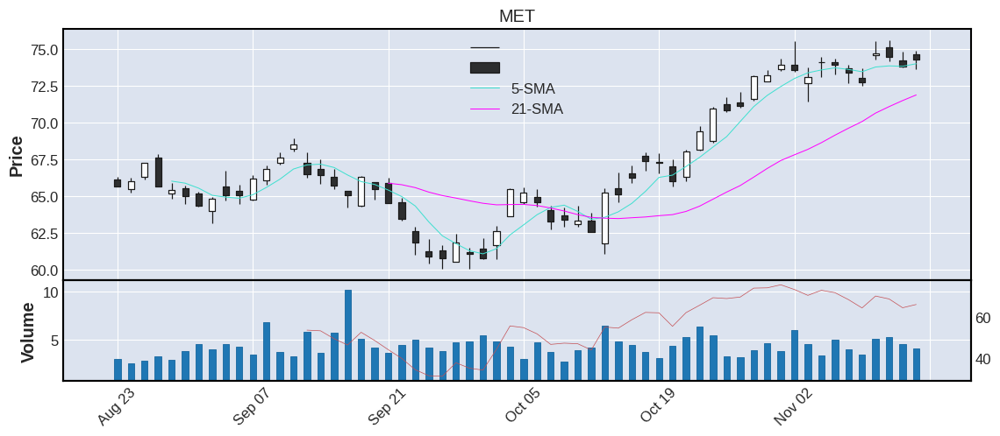



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
35    TFC  46.33  56.48  6.24    7.53  0.61  1.46  3.15  Finance  0.0  United States    large


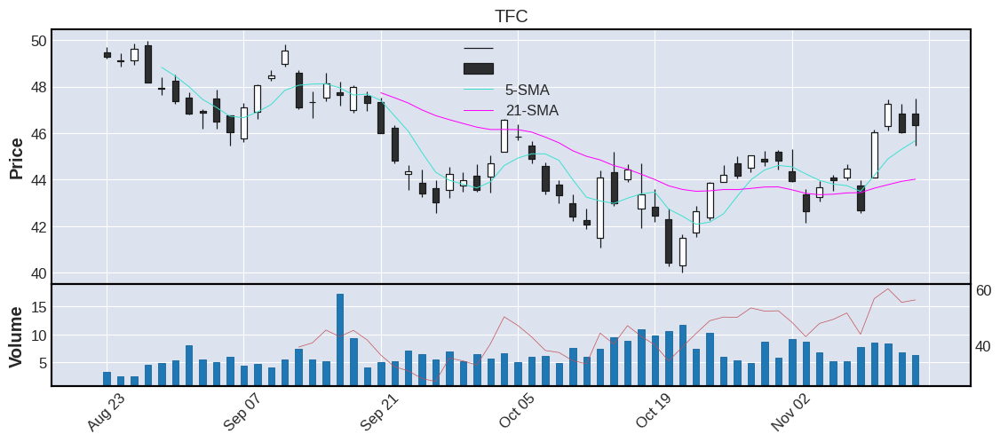



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
36   CSGP  82.71  63.08  1.9    2.32  0.61  2.68  3.24  Finance  1998.0  United States    large


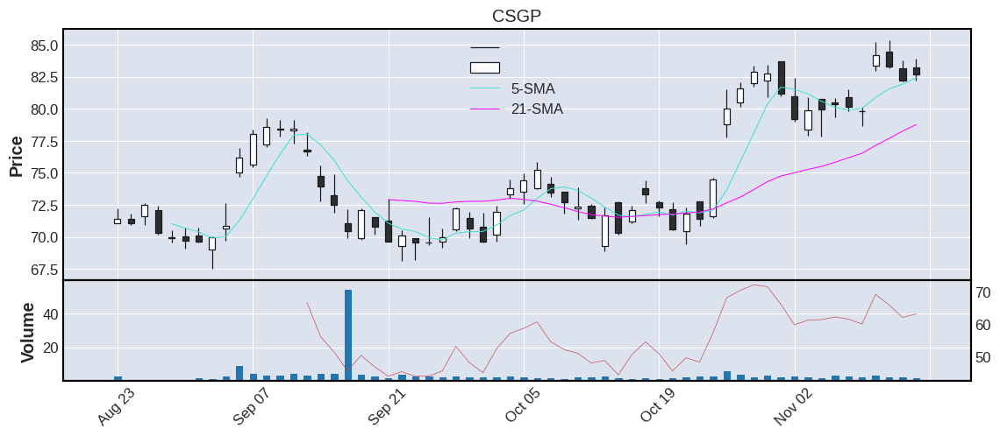



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
37    STT  79.46  68.31  2.67    2.53  0.58  2.34  2.94  Finance  0.0  United States    large


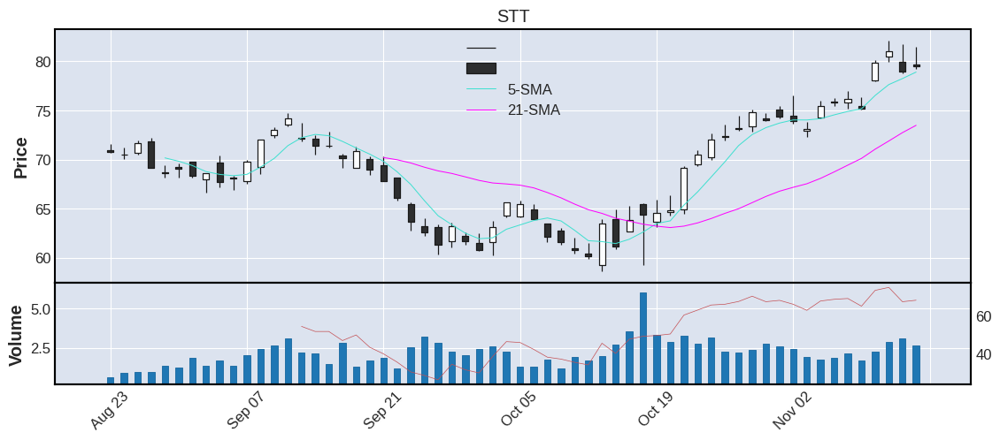



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
38     BK  43.83  60.36  5.45     5.4  0.57  1.08  2.46  Finance  0.0  United States    large


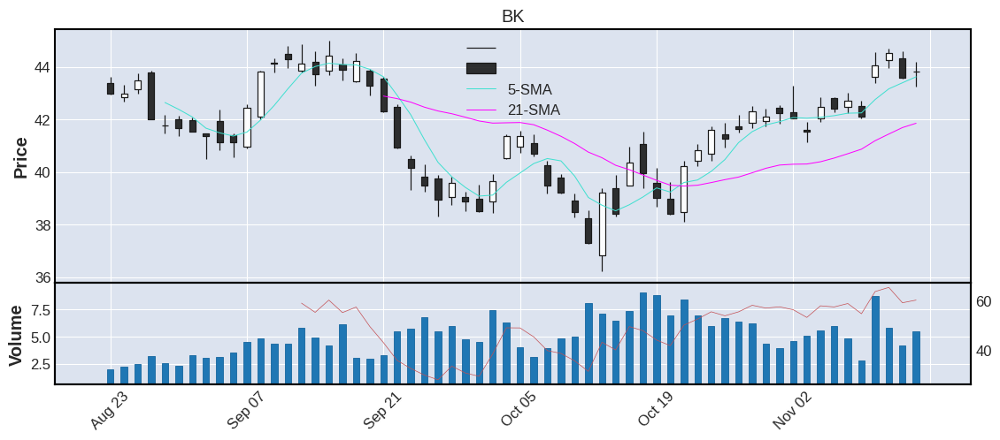



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
39    PNC  164.14  56.98  2.21    2.59  0.52  4.66  2.84  Finance  0.0  United States    large


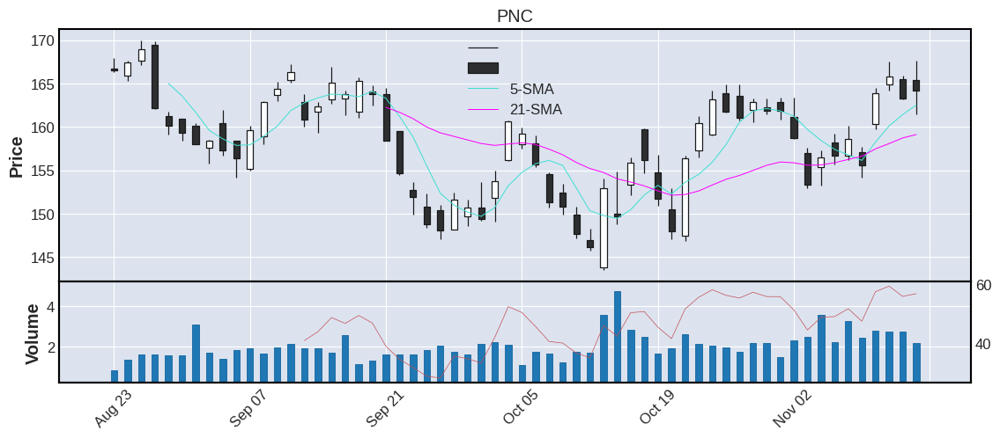



   TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
40    AIG  60.54  74.18  6.11    5.19  0.5  1.45   2.4  Finance  0.0  United States    large


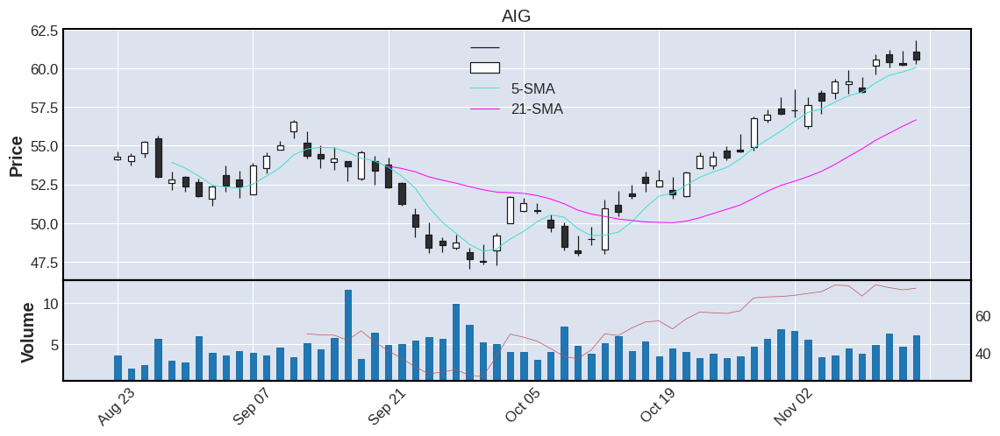



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
41   CBRE  75.56  57.13  1.45    1.91  0.45  2.73  3.61  Finance  0.0  United States    large


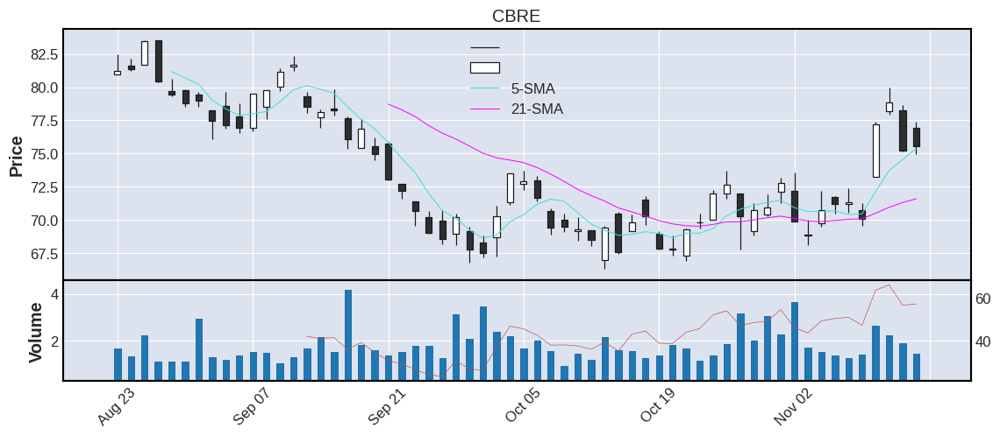



   TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
42    CFG  40.46  57.88  3.91    3.92  0.4  1.25  3.09  Finance  2014.0  United States    large


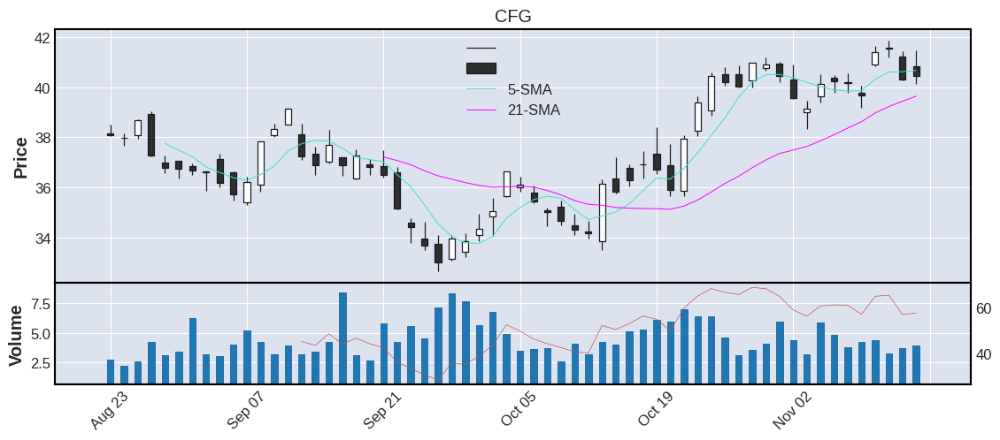



   TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
43    BRO  55.8  42.01  1.11    1.15  0.29  2.11  3.78  Finance  0.0  United States    large


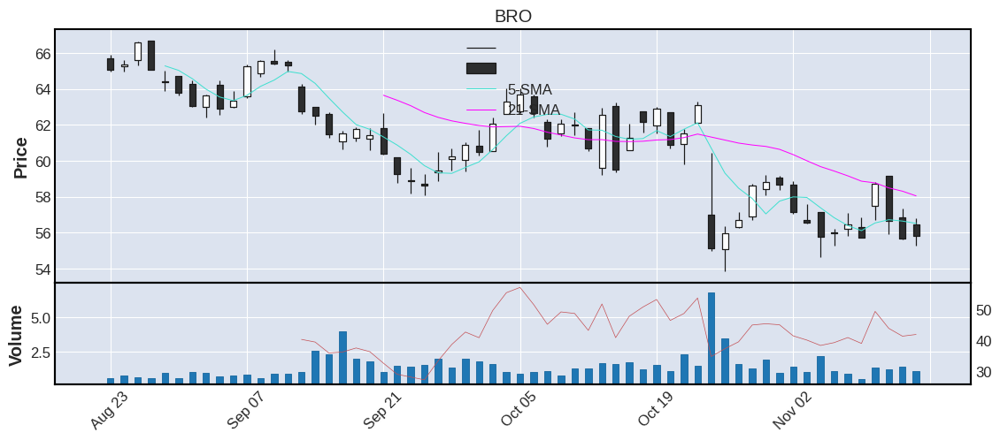



   TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO         COUNTRY CATEGORY
44    WTW  233.0  68.5  0.56    0.61  0.26  5.44  2.33  Finance  2001.0  United Kingdom    large


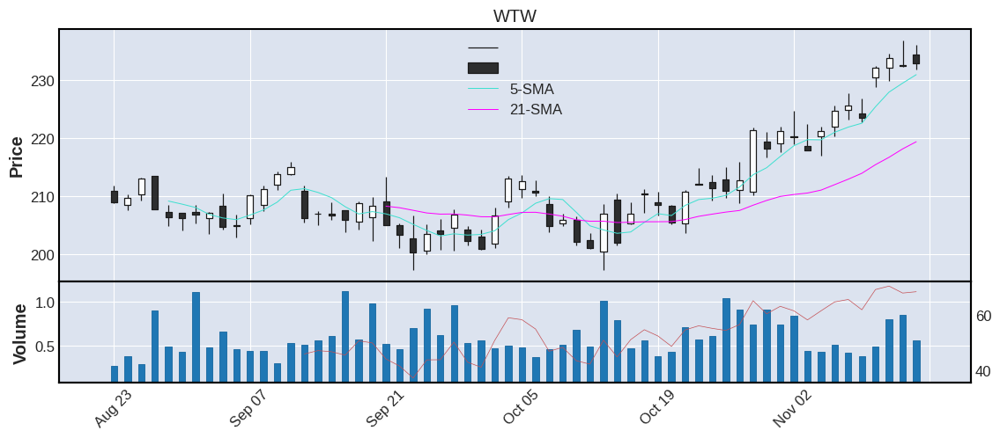



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
45    AON  291.89  56.65  0.61    0.72  0.2  8.13  2.79  Finance  0.0  United States    large


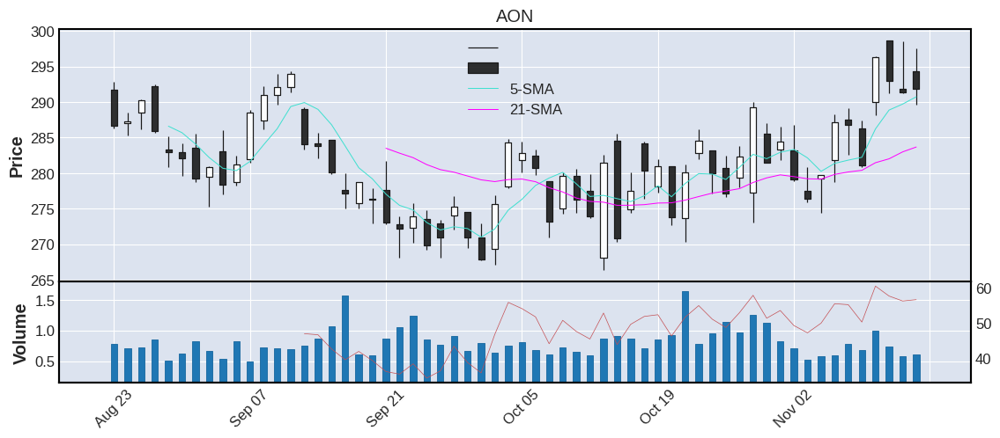



   TICKER     CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
46      L  55.58  52.36  0.68    0.65  0.16  1.3  2.34  Finance  0.0  United States    large


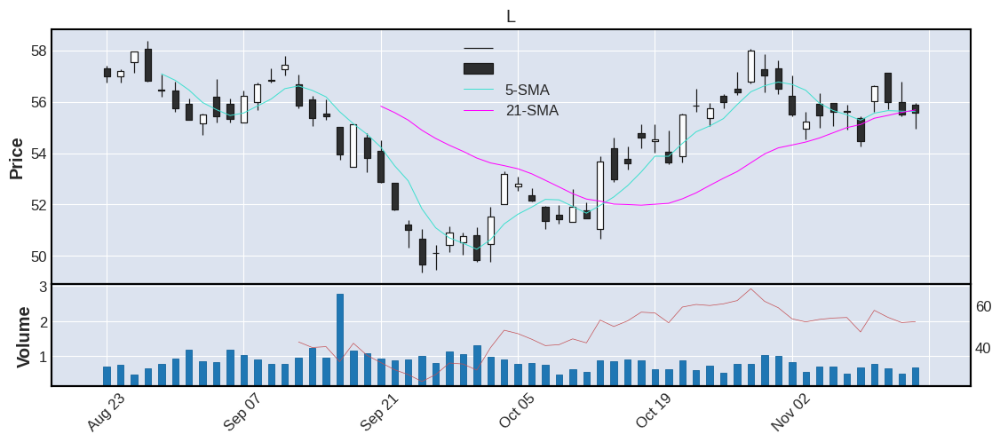



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
47     GS  382.88  78.8  3.19    3.21  0.14  8.23  2.15  Finance  1999.0  United States    large


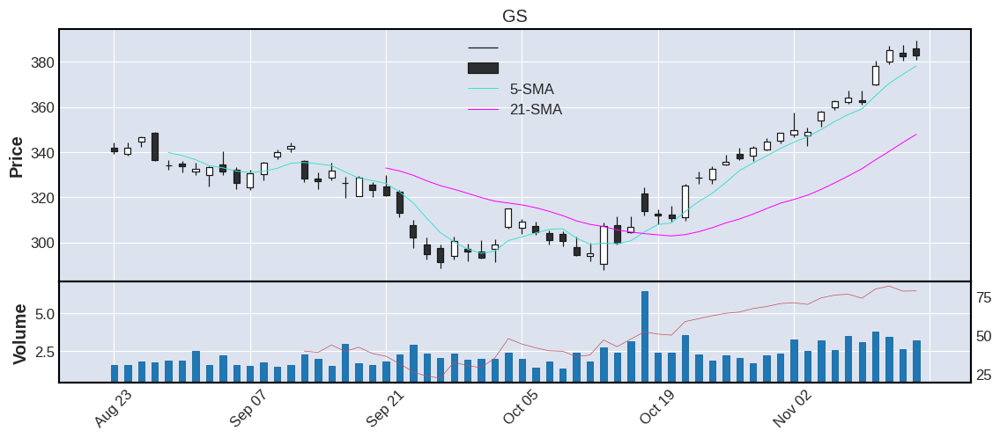



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
48    PGR  123.06  45.7  4.37    3.25  0.07  3.25  2.64  Finance  0.0  United States    large


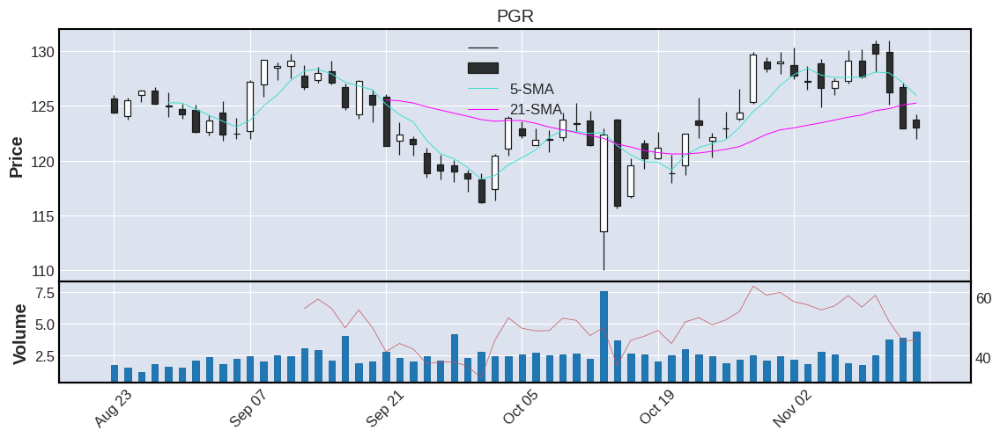



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
49      C  49.03  63.55  19.83   21.34  0.02  1.32  2.69  Finance  0.0  United States    large


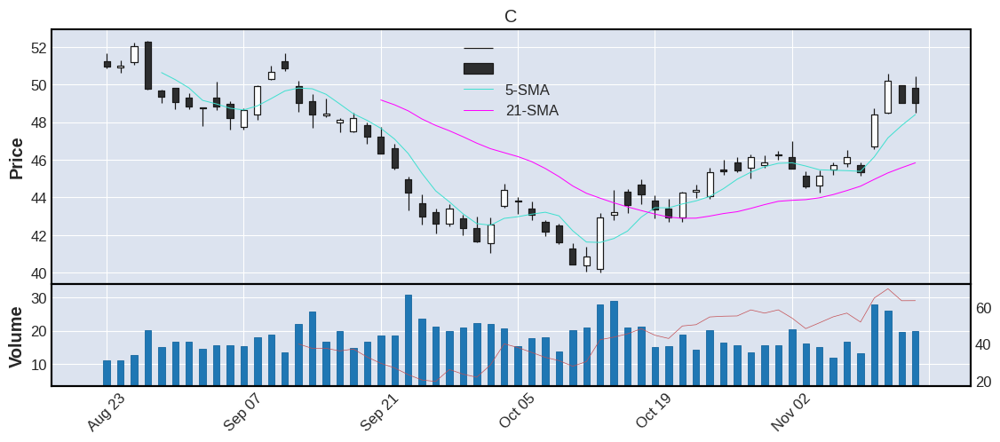



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
50    CME  173.79  48.49  1.96    2.18 -0.06  3.99   2.3  Finance  2002.0  United States    large


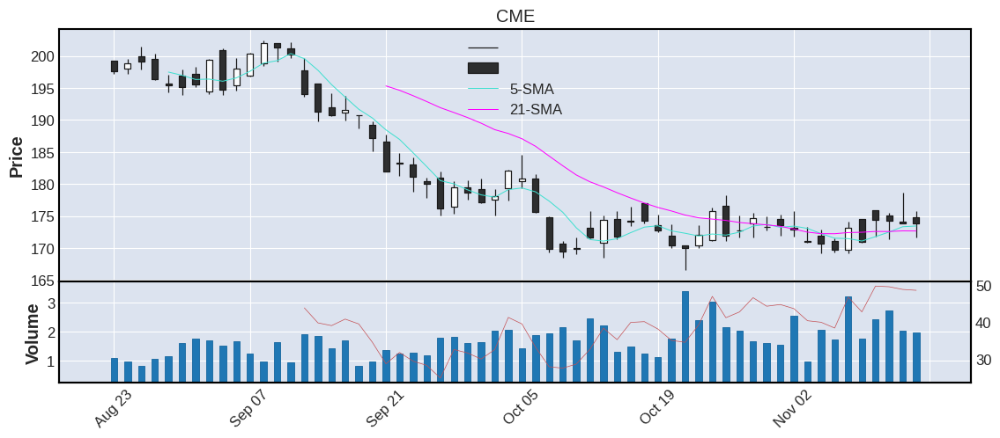



================================================== SECTOR 5: N-A [ %CHG ] ================================================== 

    TICKER       CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR SECTOR     IPO        COUNTRY CATEGORY
1     RCL    60.68  68.31  6.57    5.63  4.49   3.11  5.13    N-A  1993.0  United States    large
2     DHI    84.17  64.56  2.77    4.46  3.29   3.53  4.19    N-A     0.0  United States    large
3    ULTA   436.27  63.12  0.66    0.70  3.23  13.17  3.02    N-A  2007.0  United States    large
4    FBHS    67.32  66.35  1.30    1.54  2.87   2.76  4.10    N-A     0.0  United States   medium
5     PHM    43.62  62.09  2.12    3.02  2.61   1.83  4.20    N-A     0.0  United States   medium
6    OTIS    78.71  74.31  2.35    2.78  1.21   2.15  2.73    N-A  2020.0            N-A    large
7     VMC   175.90  61.54  0.74    0.78  0.42   5.68  3.23    N-A     0.0  United States    large
8   BRK-B   309.98  67.32  3.67    4.67  0.35   6.75  2.18    N-A     0.0  United Stat

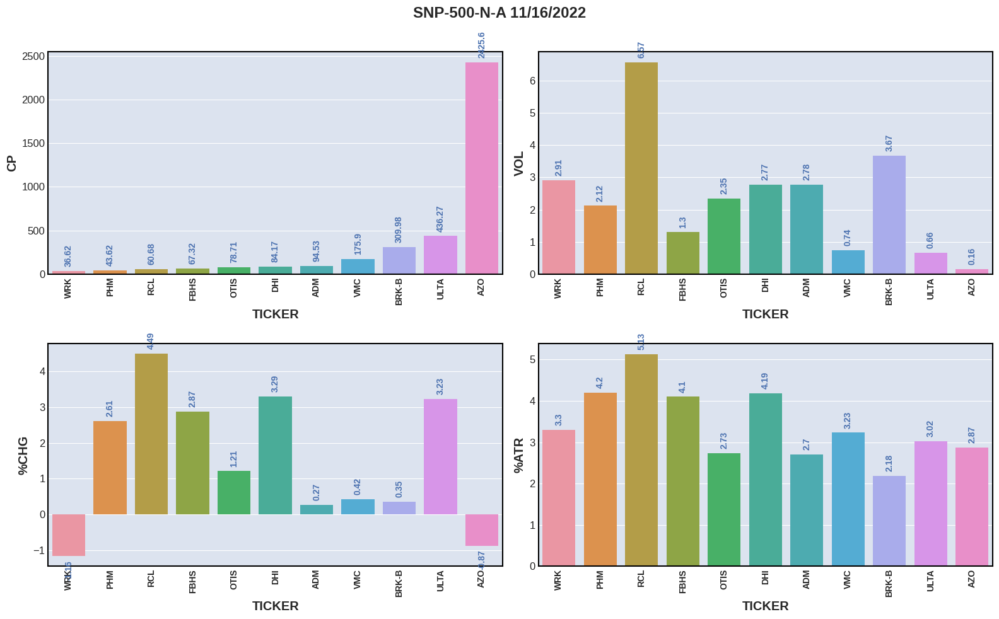

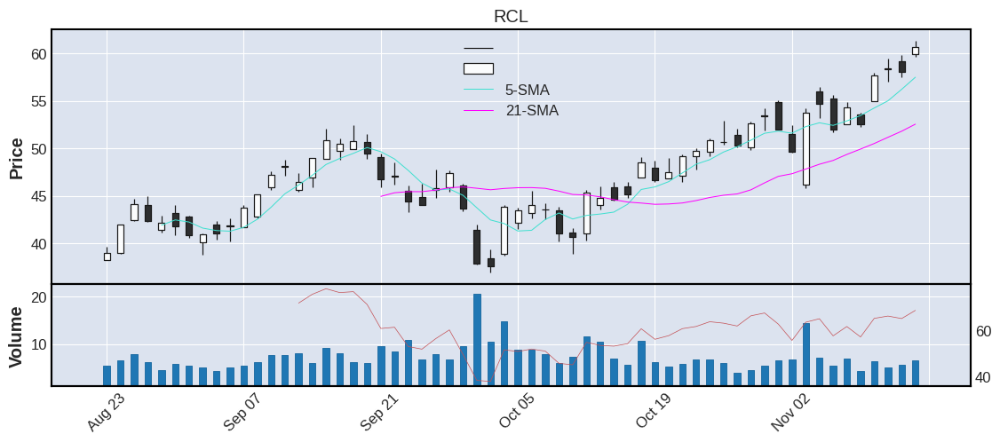



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR SECTOR  IPO        COUNTRY CATEGORY
2    DHI  84.17  64.56  2.77    4.46  3.29  3.53  4.19    N-A  0.0  United States    large


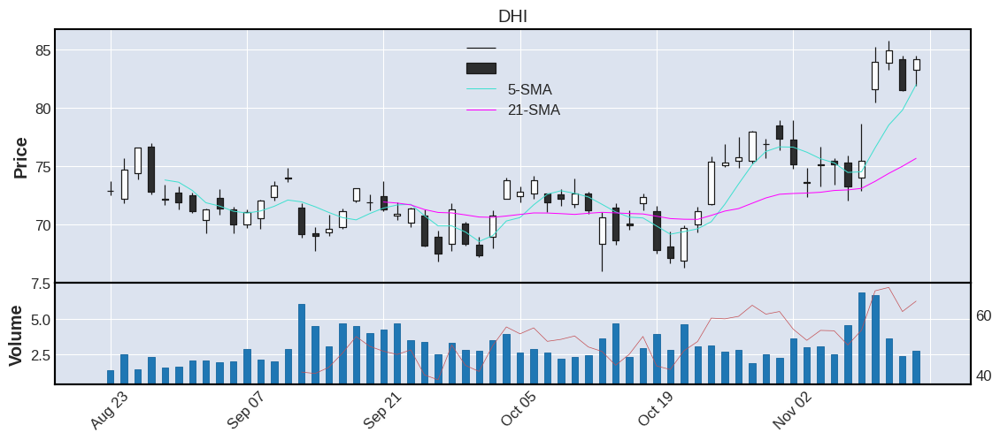



  TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR SECTOR     IPO        COUNTRY CATEGORY
3   ULTA  436.27  63.12  0.66     0.7  3.23  13.17  3.02    N-A  2007.0  United States    large


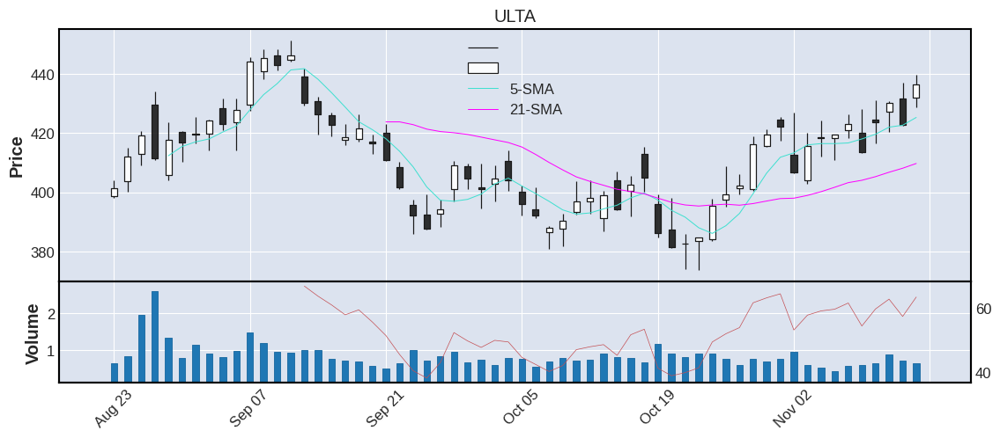



  TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR SECTOR  IPO        COUNTRY CATEGORY
4   FBHS  67.32  66.35  1.3    1.54  2.87  2.76   4.1    N-A  0.0  United States   medium


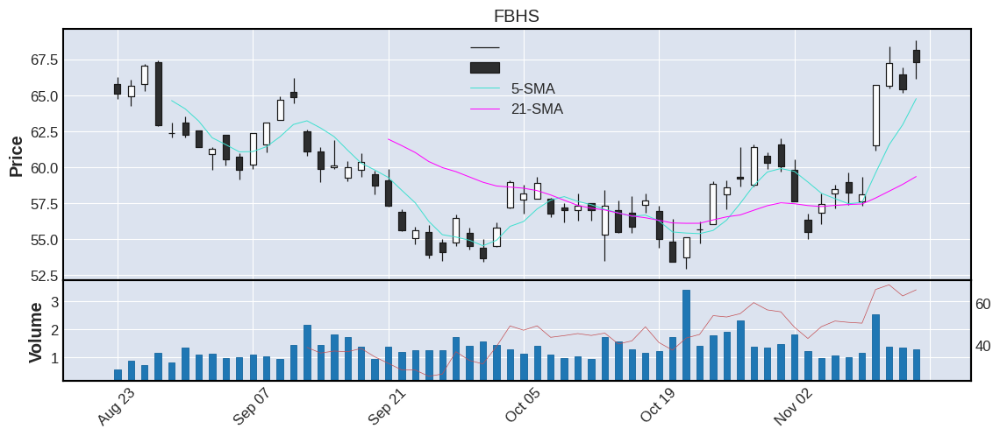



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR SECTOR  IPO        COUNTRY CATEGORY
5    PHM  43.62  62.09  2.12    3.02  2.61  1.83   4.2    N-A  0.0  United States   medium


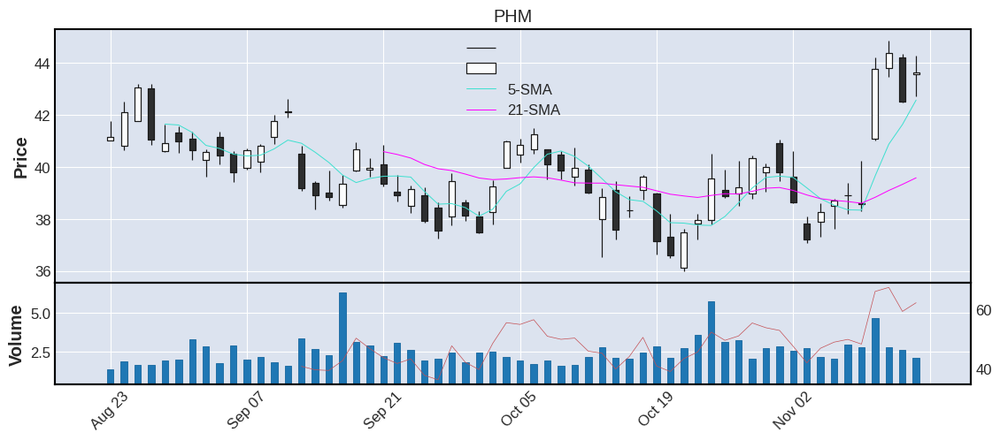



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR SECTOR     IPO COUNTRY CATEGORY
6   OTIS  78.71  74.31  2.35    2.78  1.21  2.15  2.73    N-A  2020.0     N-A    large


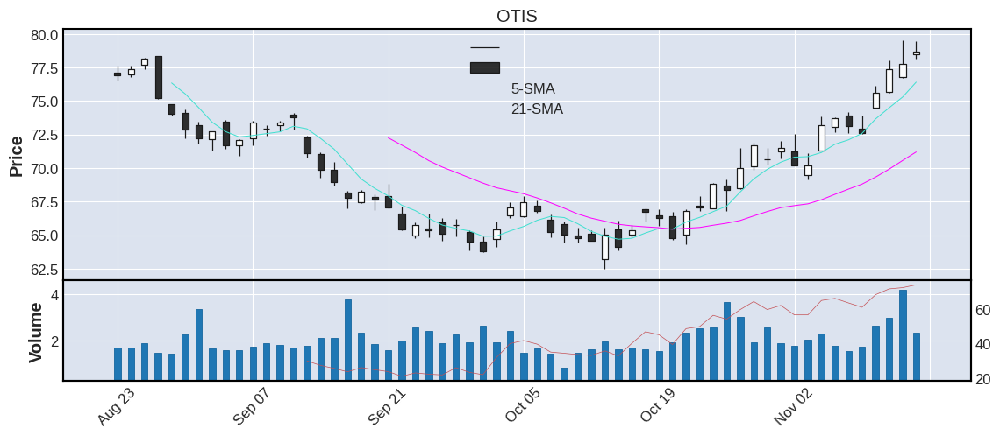



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR SECTOR  IPO        COUNTRY CATEGORY
7    VMC  175.9  61.54  0.74    0.78  0.42  5.68  3.23    N-A  0.0  United States    large


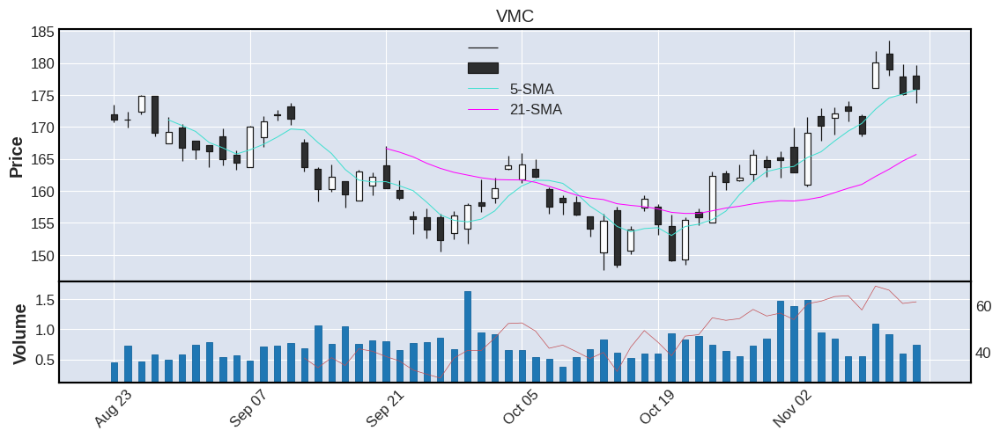



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR SECTOR  IPO        COUNTRY CATEGORY
8  BRK-B  309.98  67.32  3.67    4.67  0.35  6.75  2.18    N-A  0.0  United States     mega


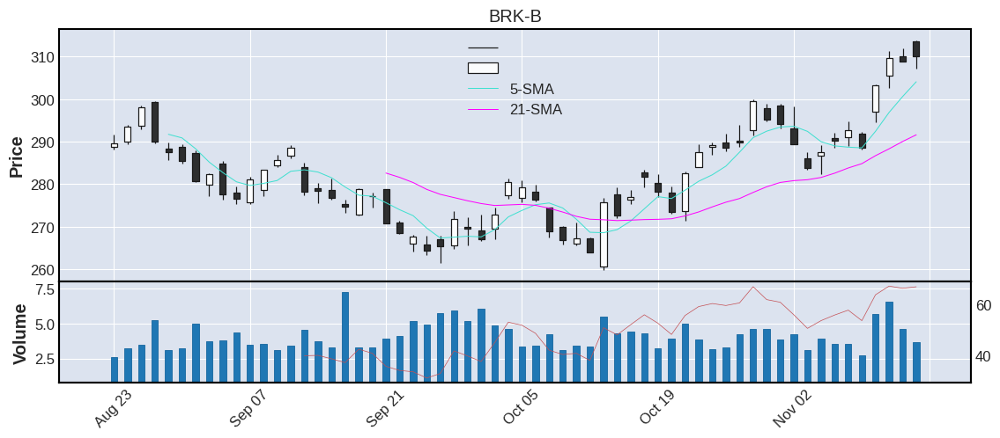



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR SECTOR  IPO        COUNTRY CATEGORY
9    ADM  94.53  57.19  2.78    2.64  0.27  2.55   2.7    N-A  0.0  United States    large


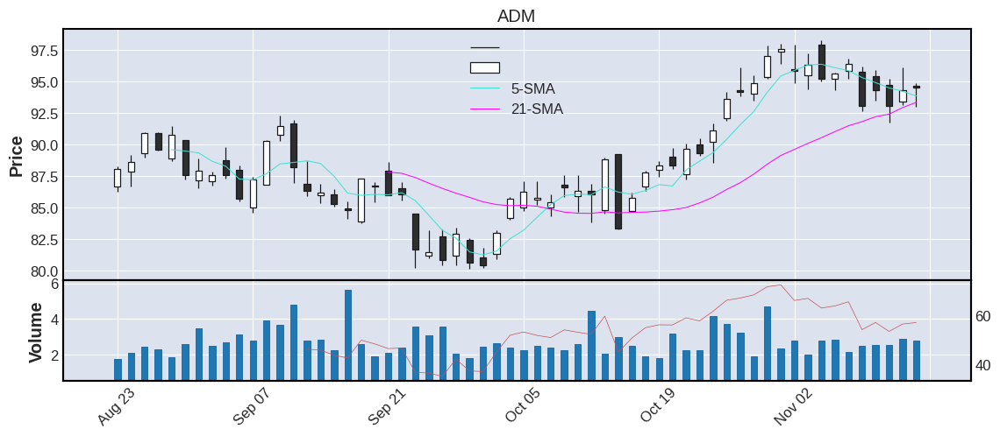



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR SECTOR  IPO        COUNTRY CATEGORY
10    AZO  2425.6  53.36  0.16    0.16 -0.87  69.68  2.87    N-A  0.0  United States    large


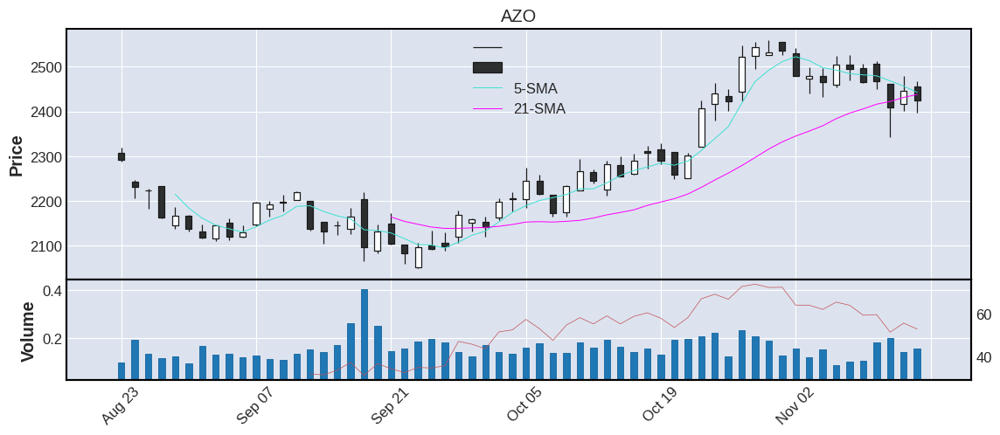



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR SECTOR     IPO COUNTRY CATEGORY
11    WRK  36.62  61.17  2.91    3.05 -1.16  1.21   3.3    N-A  2015.0     N-A   medium


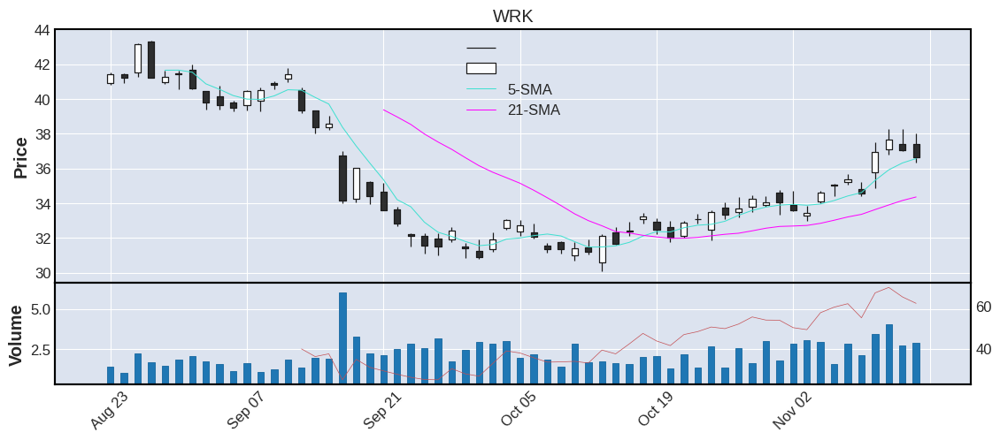



================================================== SECTOR 6: ENERGY [ %CHG ] ================================================== 

    TICKER      CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR     IPO        COUNTRY CATEGORY
1     APA   49.04  61.68   5.81    6.26  3.88  2.22  4.53  Energy     0.0  United States    large
2     EQT   43.76  55.40   4.49    5.94  3.28  2.42  5.53  Energy     0.0  United States    large
3     DVN   73.62  54.62   8.49    8.43  2.97  3.33  4.52  Energy  1985.0  United States    large
4     VLO  140.71  68.96   4.06    4.03  2.86  4.74  3.37  Energy     0.0  United States    large
5     PXD  262.39  58.01   1.99    2.18  2.72  8.77  3.34  Energy     0.0  United States    large
6     HES  149.44  64.86   1.87    2.11   2.7  5.36  3.59  Energy     0.0  United States    large
7     HAL   38.91  65.43   8.48    8.66  2.26  1.57  4.03  Energy     0.0  United States    large
8    FANG  167.03  68.93   3.30    2.56  2.12  5.19  3.11  Energy  2012.0  United S

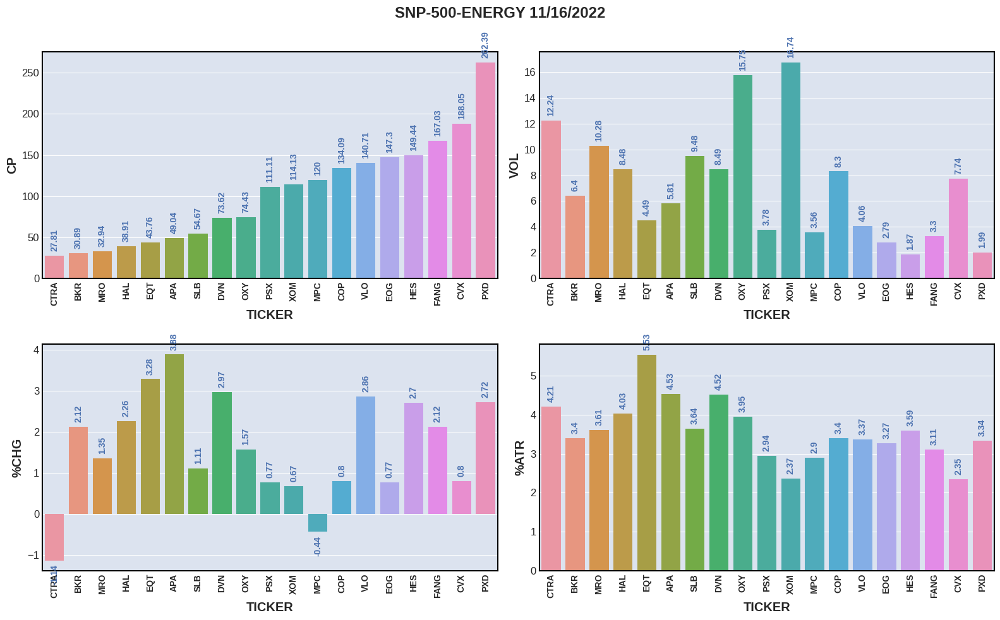

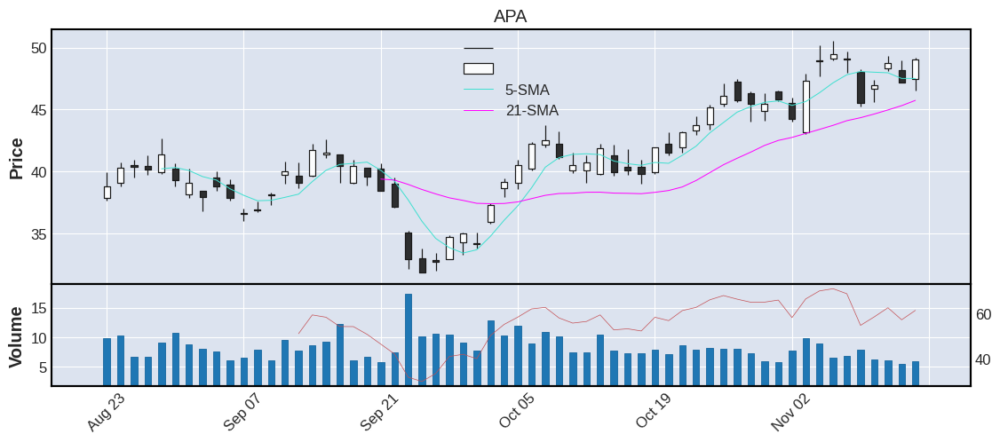



  TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
2    EQT  43.76  55.4  4.49    5.94  3.28  2.42  5.53  Energy  0.0  United States    large


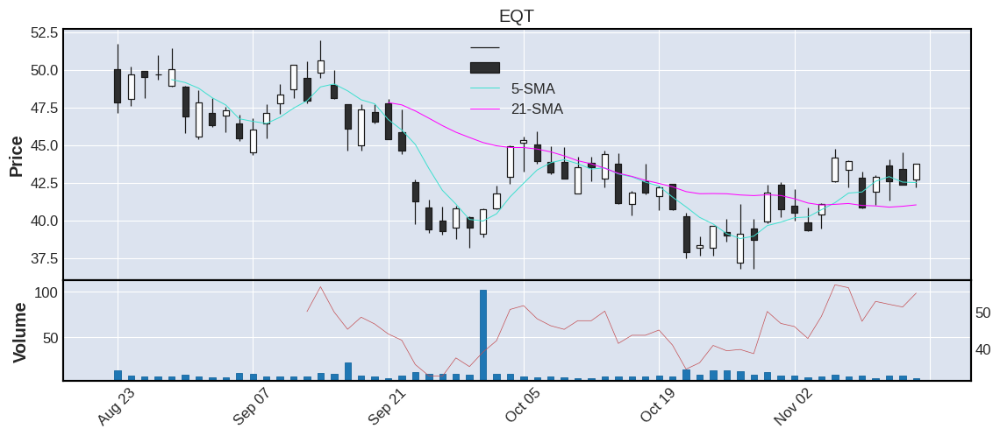



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR     IPO        COUNTRY CATEGORY
3    DVN  73.62  54.62  8.49    8.43  2.97  3.33  4.52  Energy  1985.0  United States    large


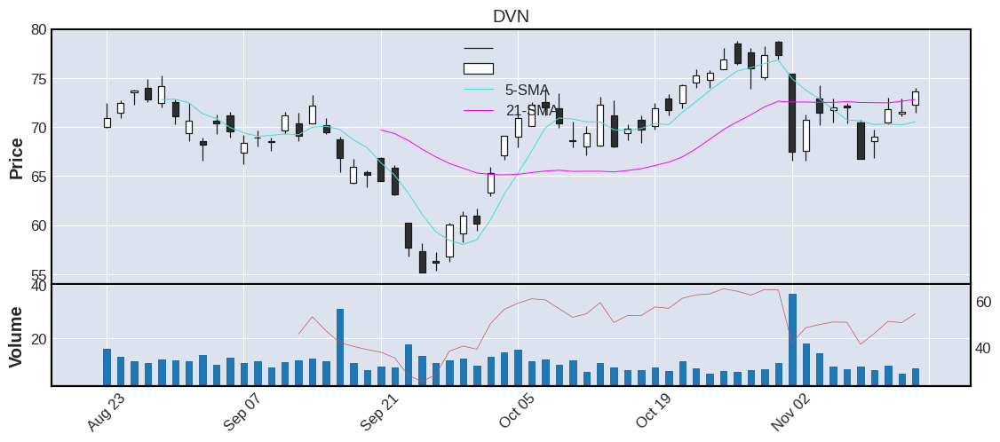



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
4    VLO  140.71  68.96  4.06    4.03  2.86  4.74  3.37  Energy  0.0  United States    large


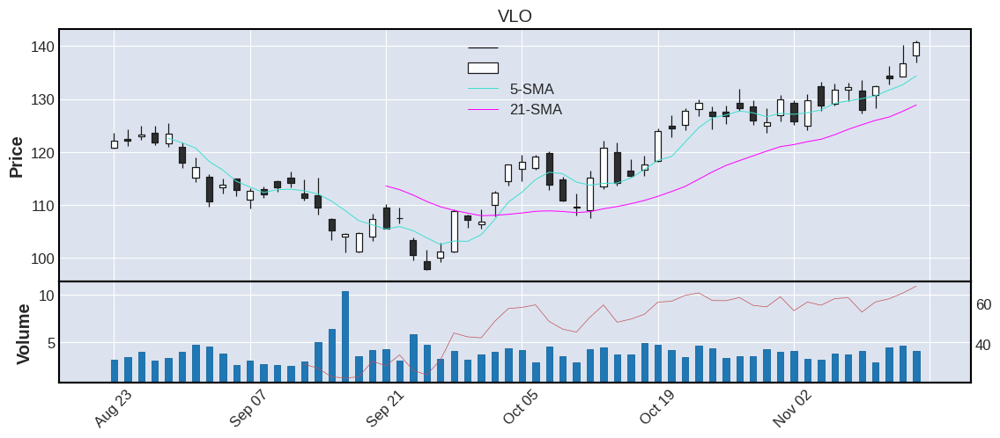



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
5    PXD  262.39  58.01  1.99    2.18  2.72  8.77  3.34  Energy  0.0  United States    large


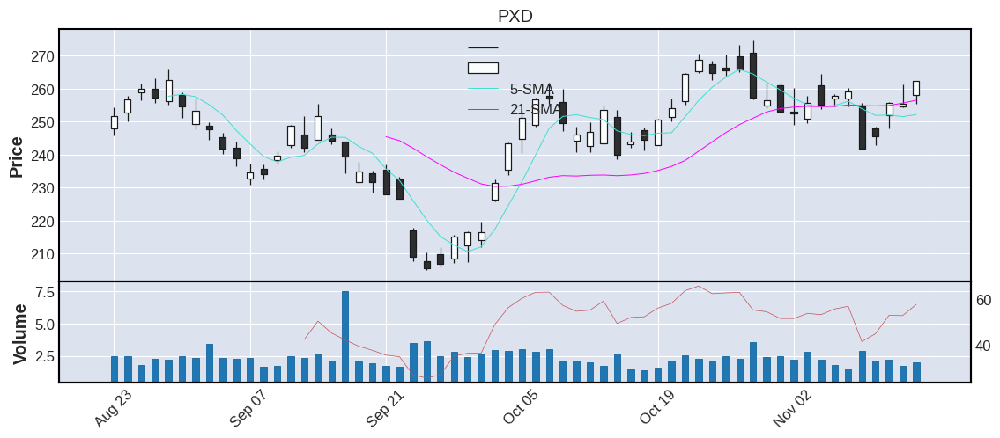



  TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
6    HES  149.44  64.86  1.87    2.11  2.7  5.36  3.59  Energy  0.0  United States    large


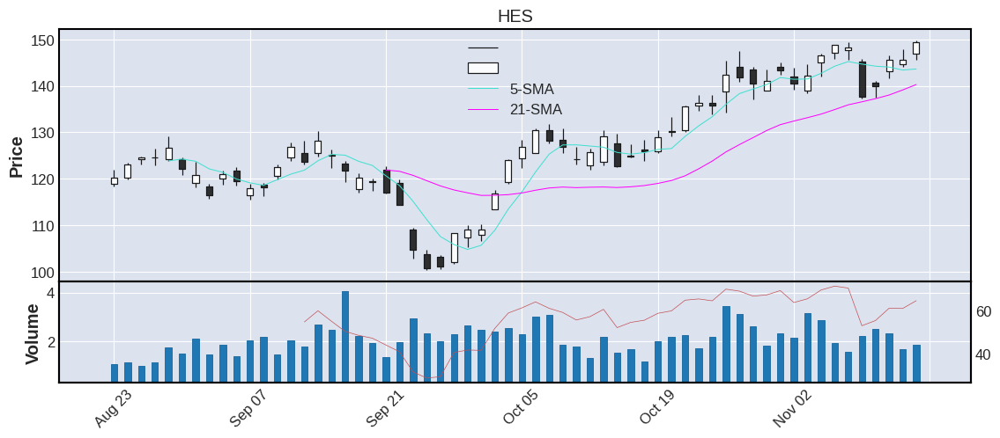



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
7    HAL  38.91  65.43  8.48    8.66  2.26  1.57  4.03  Energy  0.0  United States    large


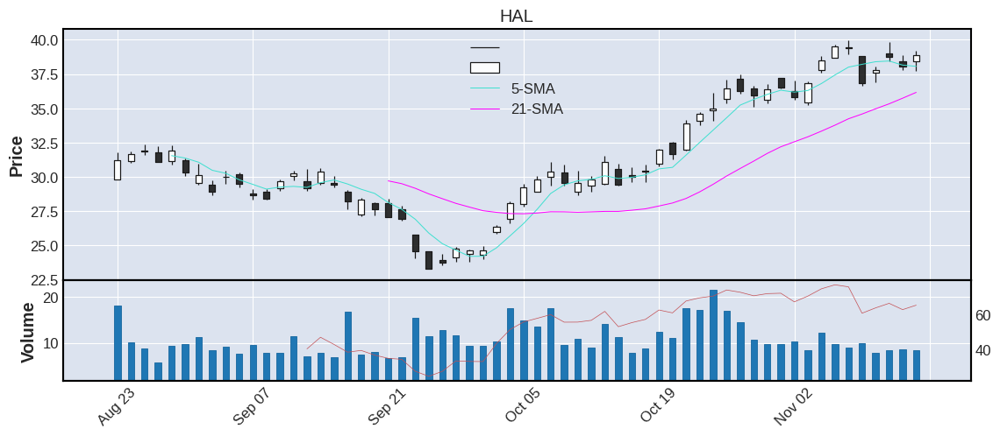



  TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR     IPO        COUNTRY CATEGORY
8   FANG  167.03  68.93  3.3    2.56  2.12  5.19  3.11  Energy  2012.0  United States    large


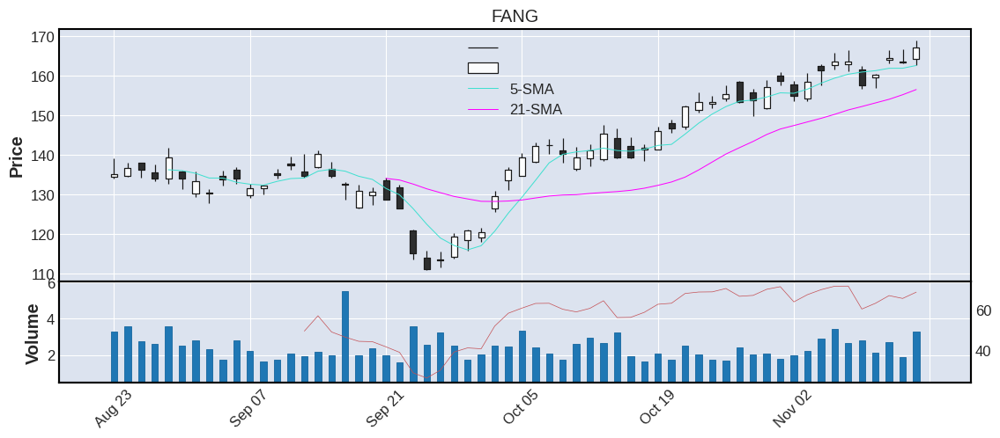



  TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
9    BKR  30.89  66.97  6.4    6.33  2.12  1.05   3.4  Energy  0.0  United States    large


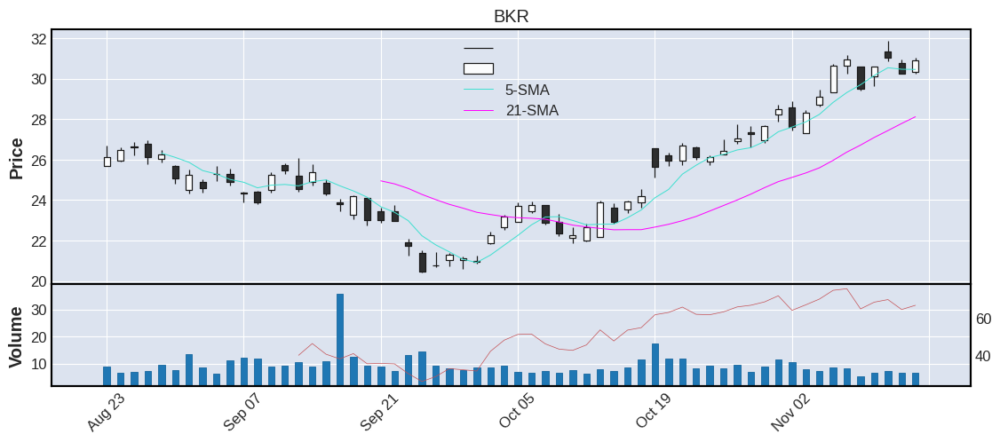



   TICKER     CP   RSI    VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
10    OXY  74.43  57.4  15.75   19.08  1.57  2.94  3.95  Energy  0.0  United States    large


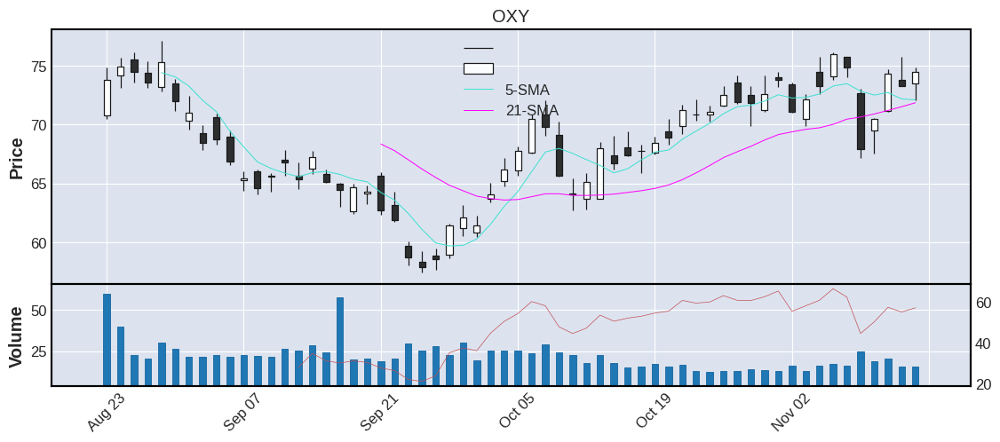



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
11    MRO  32.94  64.01  10.28   12.85  1.35  1.19  3.61  Energy  0.0  United States    large


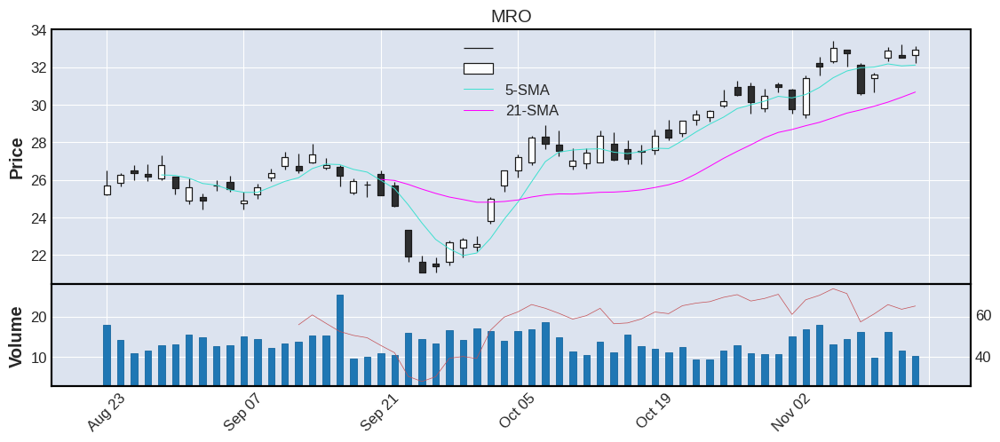



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO COUNTRY CATEGORY
12    SLB  54.67  68.47  9.48   13.64  1.11  1.99  3.64  Energy  0.0  France    large


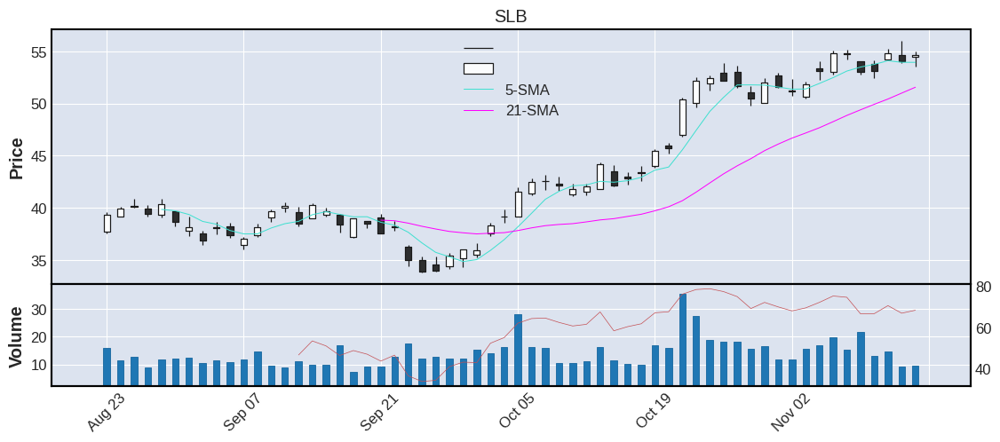



   TICKER      CP    RSI  VOL  AVGVOL %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
13    COP  134.09  62.19  8.3    7.55  0.8  4.56   3.4  Energy  0.0  United States    large


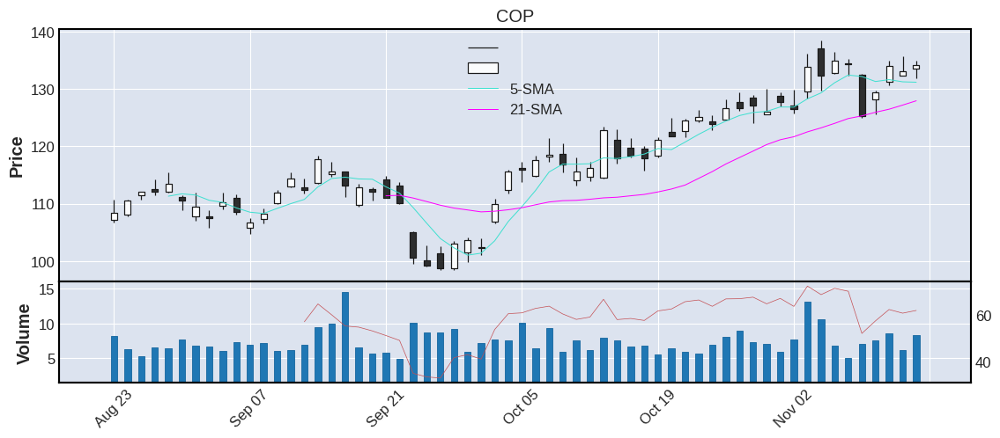



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
14    CVX  188.05  68.34  7.74    8.18  0.8  4.42  2.35  Energy  0.0  United States     mega


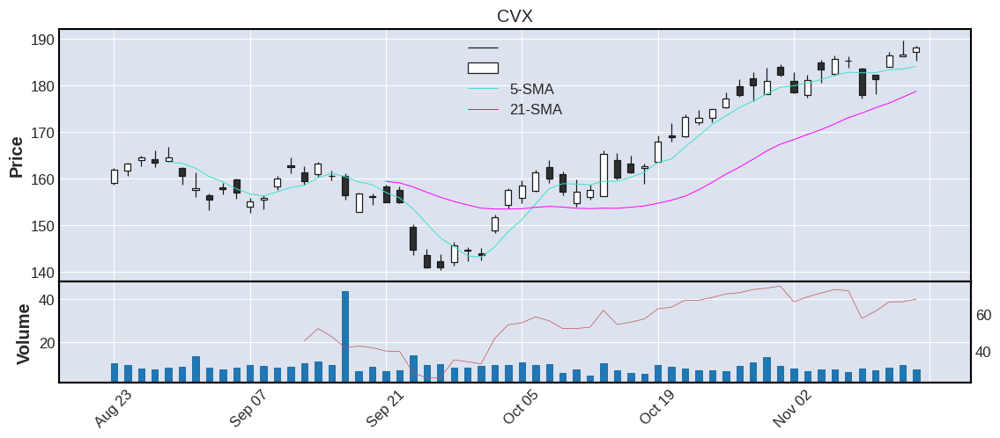



   TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
15    EOG  147.3  65.8  2.79    3.37  0.77  4.82  3.27  Energy  0.0  United States    large


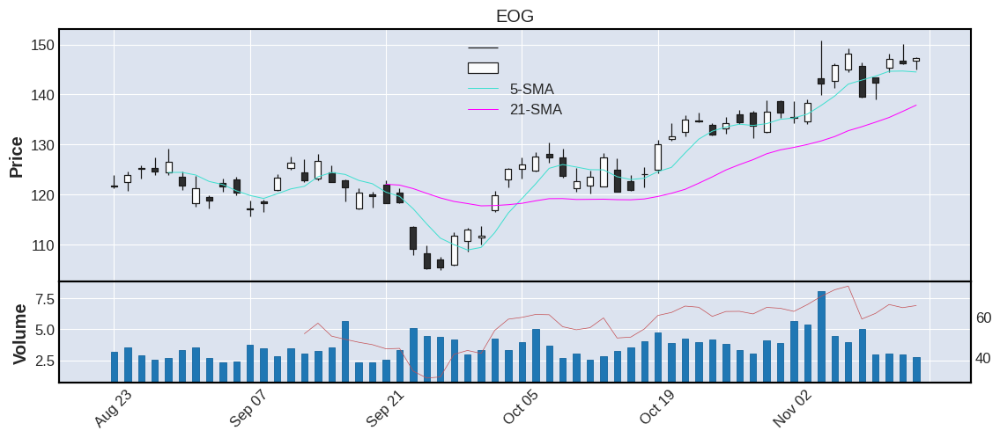



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
16    PSX  111.11  71.59  3.78     4.3  0.77  3.27  2.94  Energy  0.0  United States    large


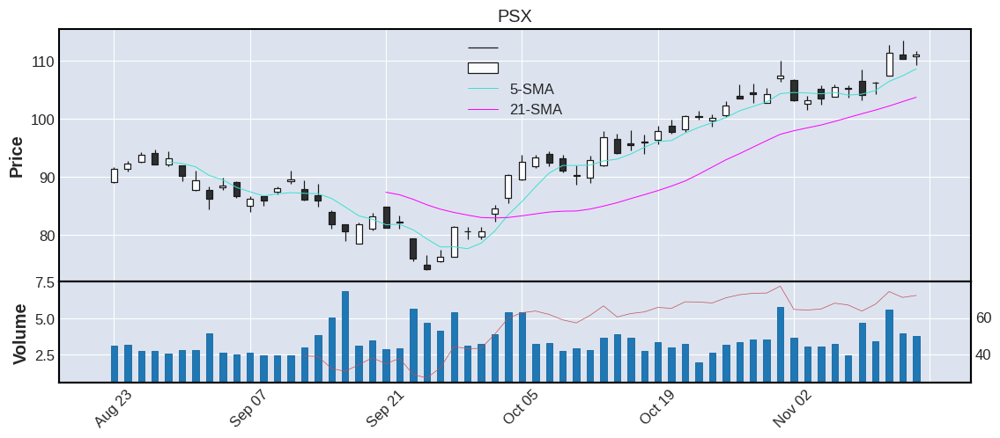



   TICKER      CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
17    XOM  114.13  65.17  16.74   19.56  0.67  2.71  2.37  Energy  0.0  United States     mega


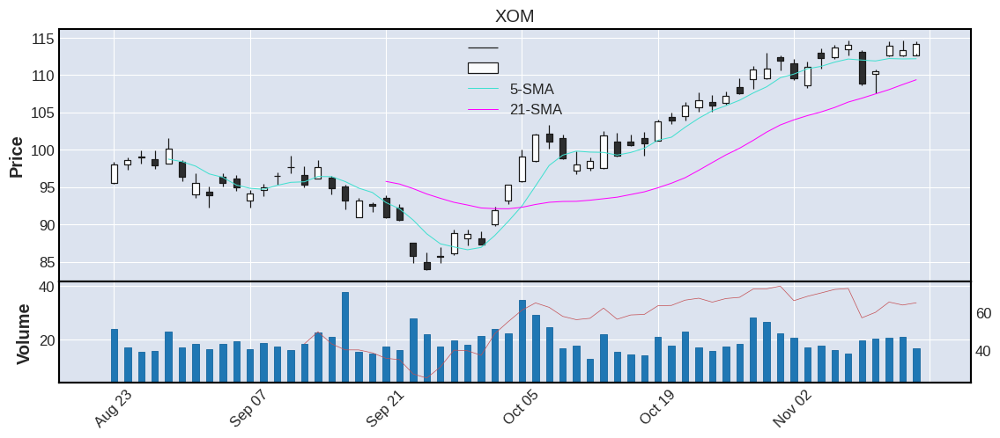



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
18    MPC  120.0  63.35  3.56    3.11 -0.44  3.48   2.9  Energy  0.0  United States    large


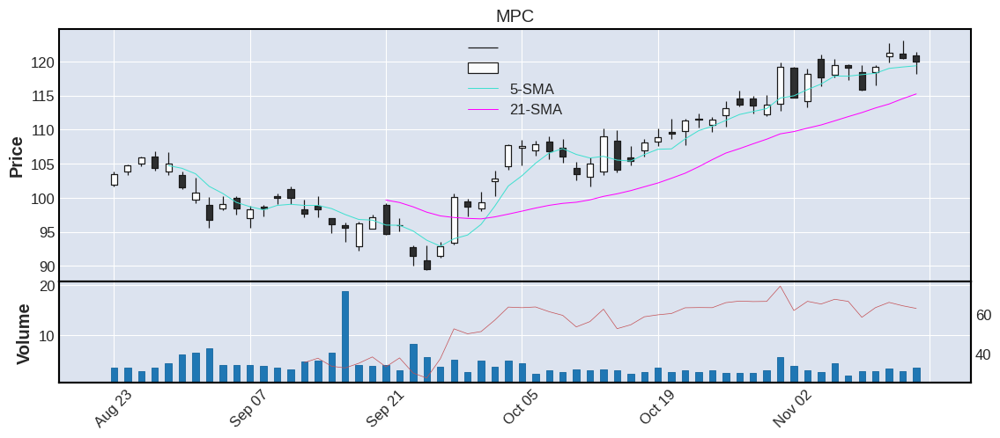



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
19   CTRA  27.81  42.79  12.24   14.58 -1.14  1.17  4.21  Energy  0.0  United States    large


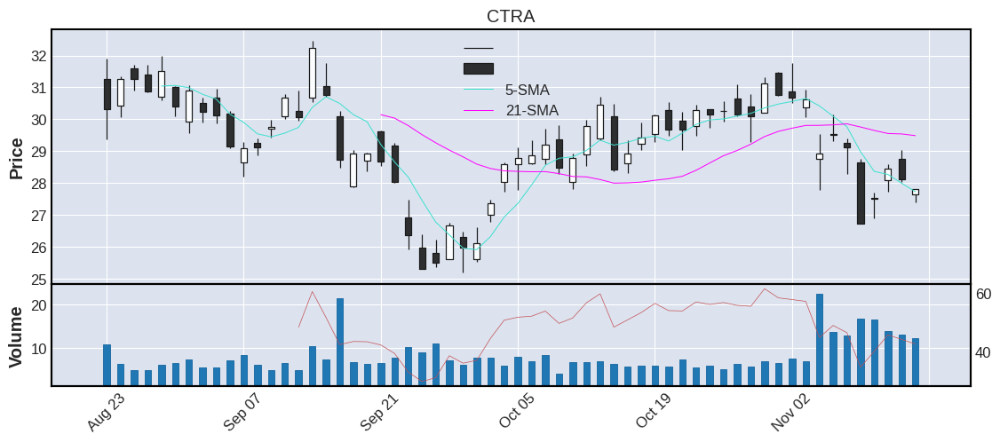



================================================== SECTOR 7: CONSUMER_STAPLES [ %CHG ] ================================================== 

    TICKER      CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR     IPO        COUNTRY CATEGORY
1      LW   81.29  43.49   3.06    2.13  1.47  2.17  2.67  Consumer_Staples  2016.0            N-A    large
2    MNST   98.14  60.57   3.01    2.55  1.26  2.47  2.52  Consumer_Staples     0.0  United States    large
3     CAG   34.38  43.64   3.38    3.94  1.24  0.82  2.39  Consumer_Staples     0.0  United States    large
4     MKC   83.65  65.79   1.27    1.33  1.09  2.13  2.55  Consumer_Staples     0.0  United States    large
5    MDLZ   64.65  65.96   5.79    6.45  0.86  1.29  2.00  Consumer_Staples     0.0  United States    large
6      KR   46.87  53.69   4.74    6.17  0.67  1.30  2.77  Consumer_Staples     0.0  United States    large
7     GIS   77.44  44.80   3.28    4.76  0.61  1.77  2.29  Consumer_Staples     0.0  United States   

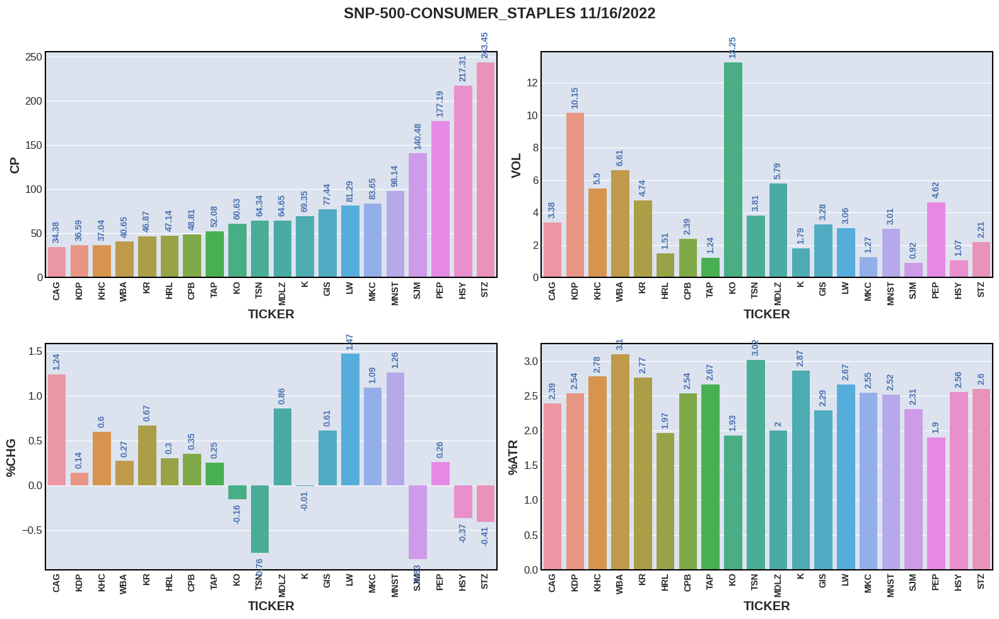

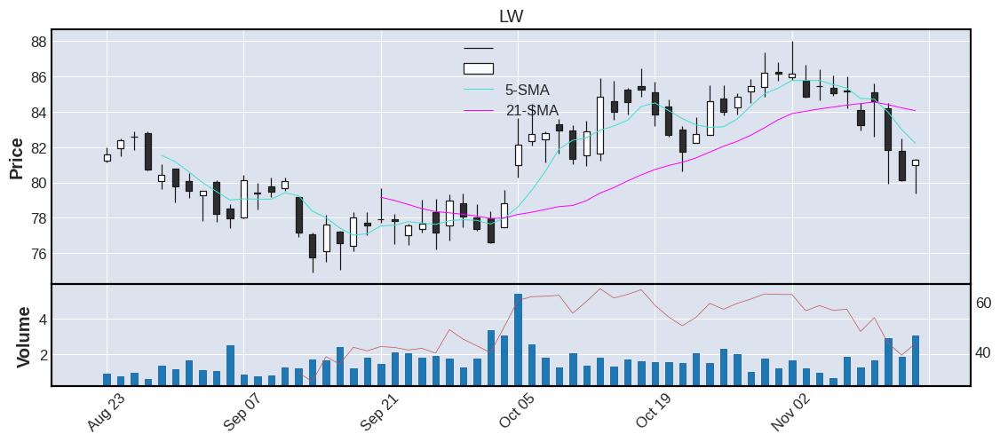



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
2   MNST  98.14  60.57  3.01    2.55  1.26  2.47  2.52  Consumer_Staples  0.0  United States    large


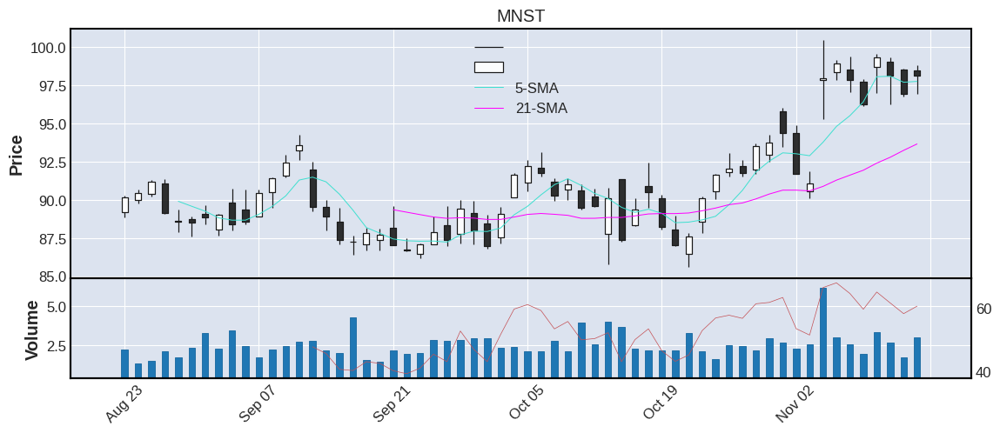



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
3    CAG  34.38  43.64  3.38    3.94  1.24  0.82  2.39  Consumer_Staples  0.0  United States    large


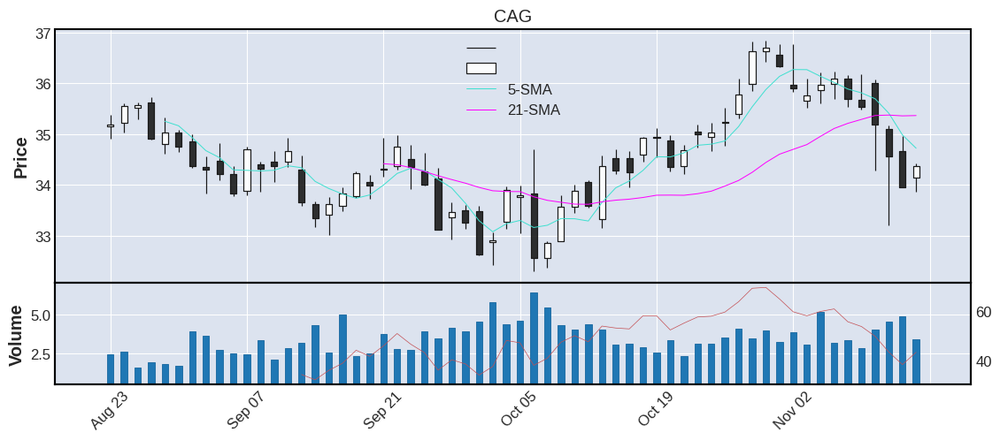



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
4    MKC  83.65  65.79  1.27    1.33  1.09  2.13  2.55  Consumer_Staples  0.0  United States    large


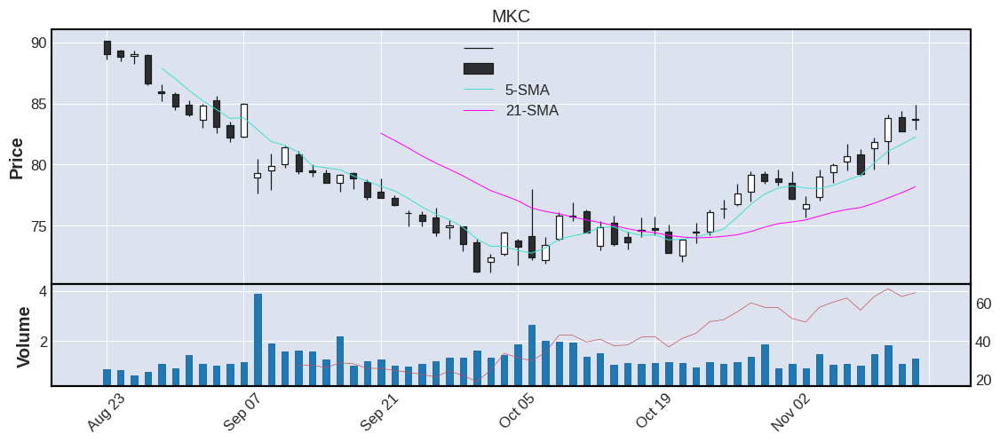



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
5   MDLZ  64.65  65.96  5.79    6.45  0.86  1.29   2.0  Consumer_Staples  0.0  United States    large


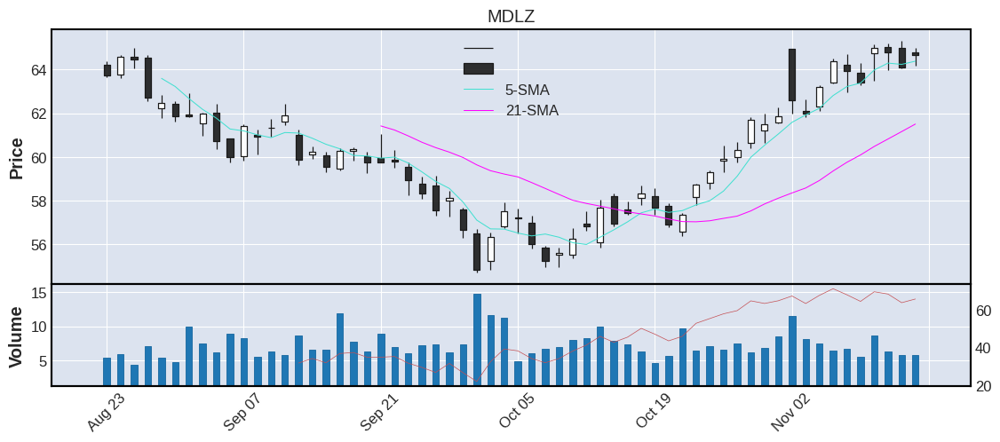



  TICKER     CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
6     KR  46.87  53.69  4.74    6.17  0.67  1.3  2.77  Consumer_Staples  0.0  United States    large


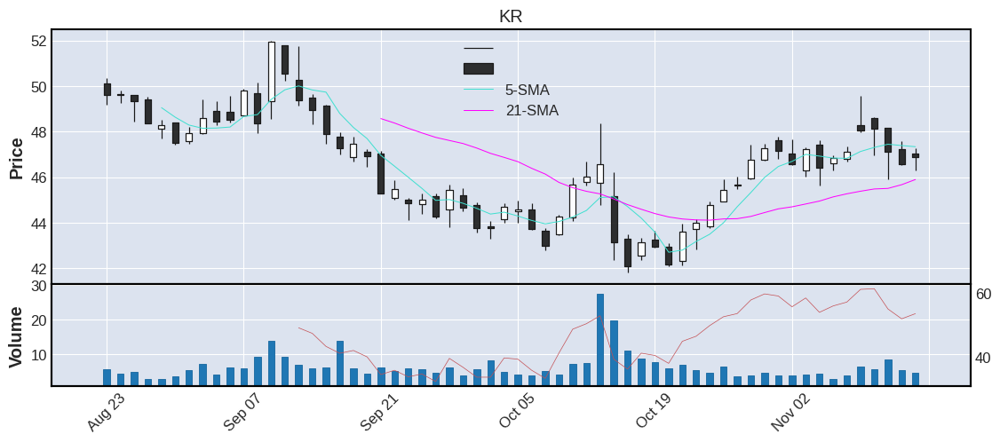



  TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
7    GIS  77.44  44.8  3.28    4.76  0.61  1.77  2.29  Consumer_Staples  0.0  United States    large


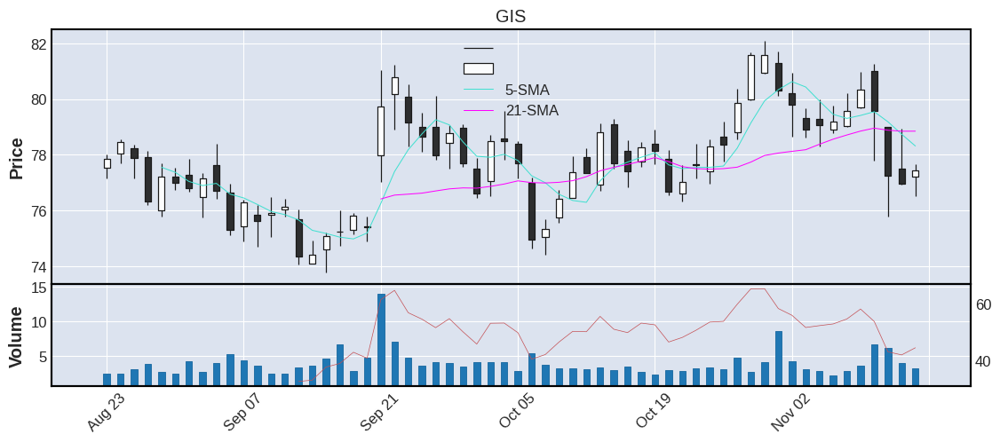



  TICKER     CP    RSI  VOL  AVGVOL %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
8    KHC  37.04  50.94  5.5    7.15  0.6  1.03  2.78  Consumer_Staples  0.0  United States    large


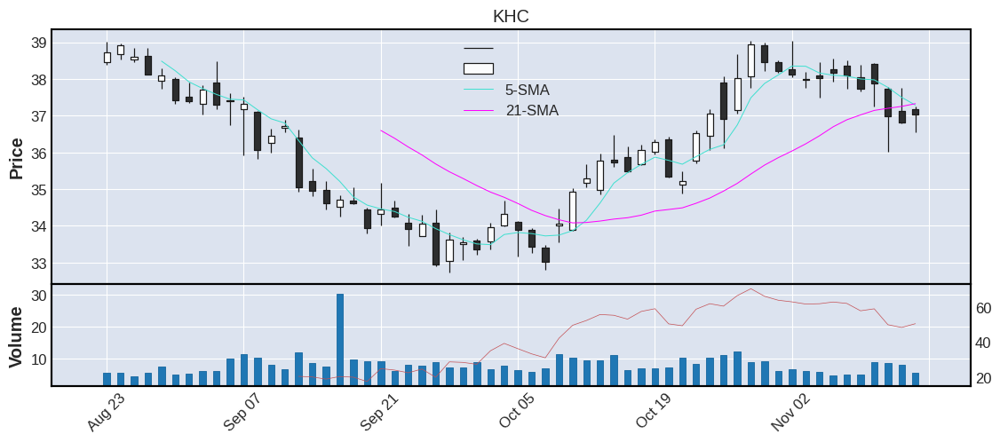



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
9    CPB  48.81  39.59  2.39    2.79  0.35  1.24  2.54  Consumer_Staples  0.0  United States    large


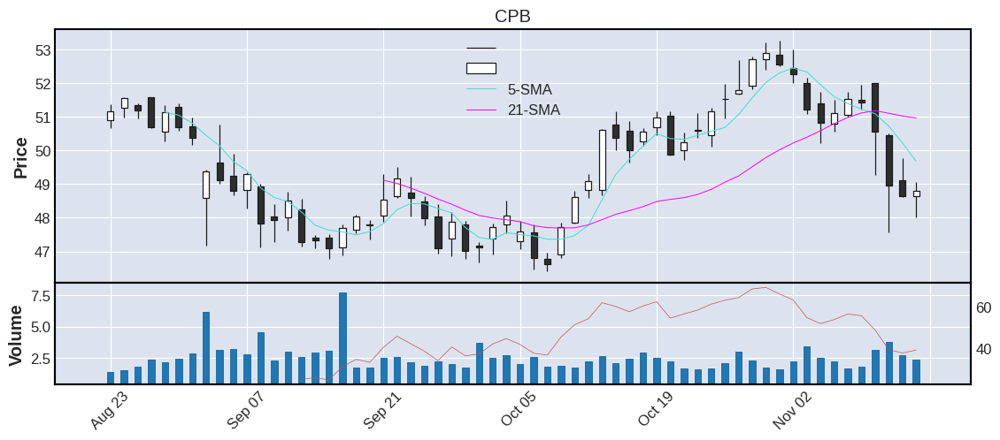



   TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
10    HRL  47.14  55.52  1.51     1.5  0.3  0.93  1.97  Consumer_Staples  0.0  United States    large


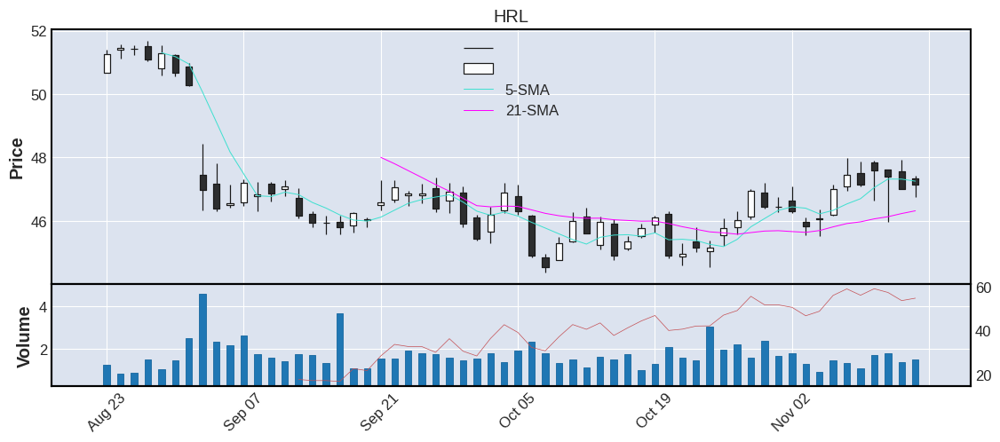



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
11    WBA  40.65  69.21  6.61    8.73  0.27  1.26   3.1  Consumer_Staples  0.0  United States    large


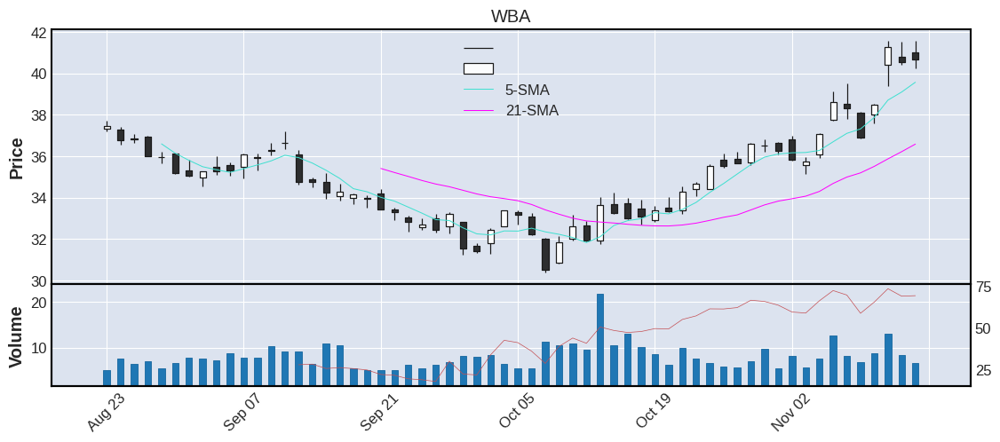



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
12    PEP  177.19  51.74  4.62    5.82  0.26  3.37   1.9  Consumer_Staples  0.0  United States     mega


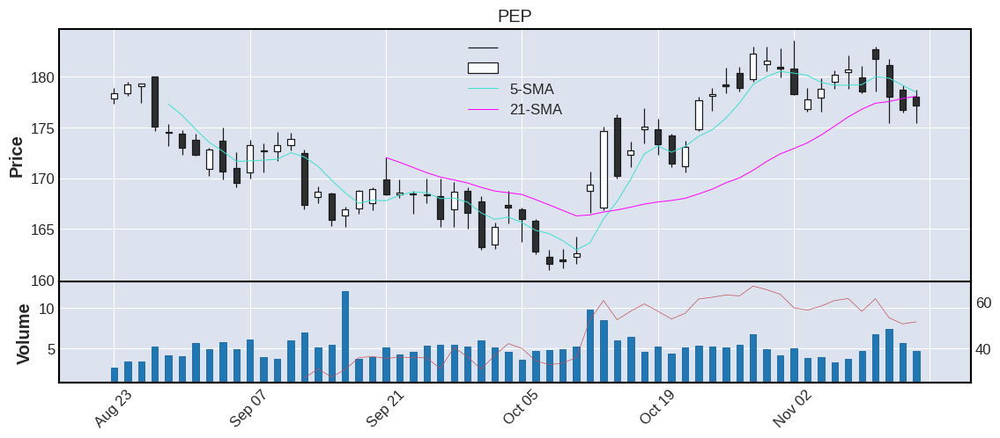



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO COUNTRY CATEGORY
13    TAP  52.08  59.75  1.24    1.13  0.25  1.39  2.67  Consumer_Staples  0.0  Canada    large


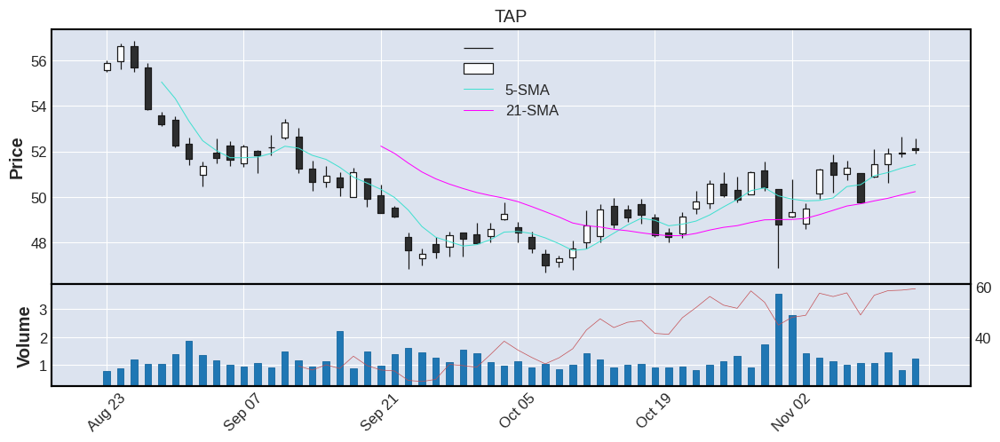



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
14    KDP  36.59  43.32  10.15    8.78  0.14  0.93  2.54  Consumer_Staples  0.0  United States    large


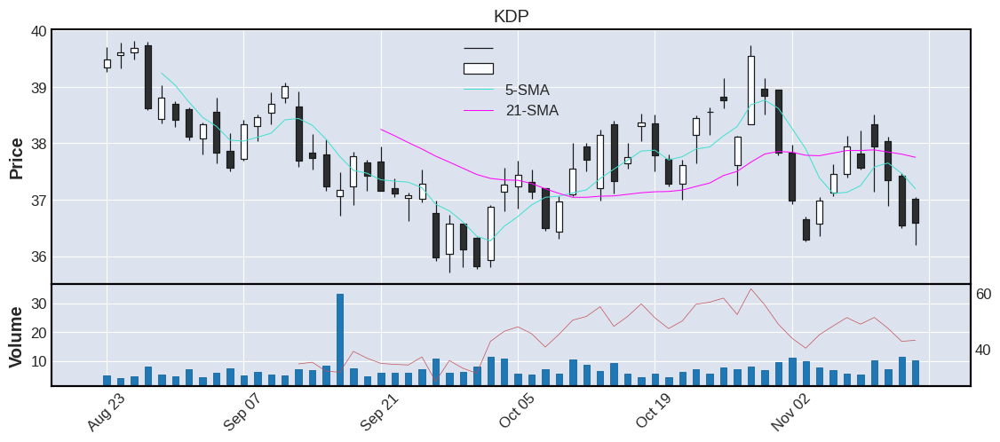



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
15      K  69.35  39.21  1.79    2.93 -0.01  1.99  2.87  Consumer_Staples  0.0  United States    large


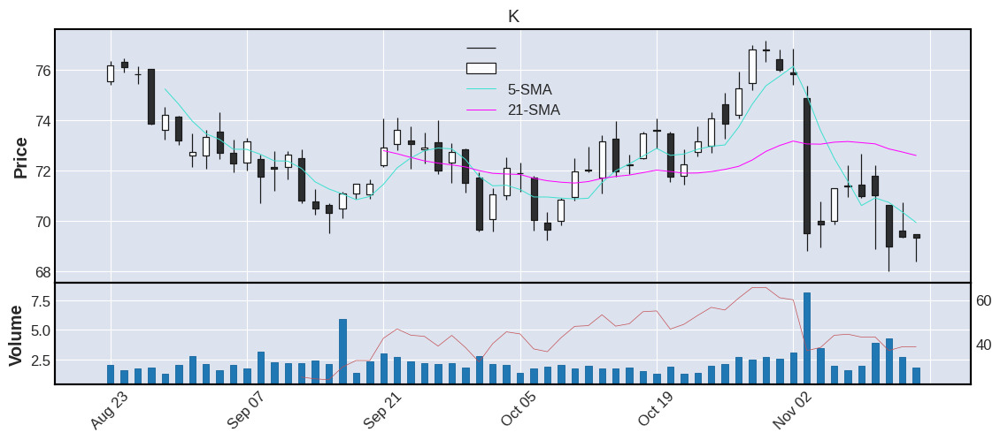



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
16     KO  60.63  59.63  13.25    15.1 -0.16  1.17  1.93  Consumer_Staples  0.0  United States     mega


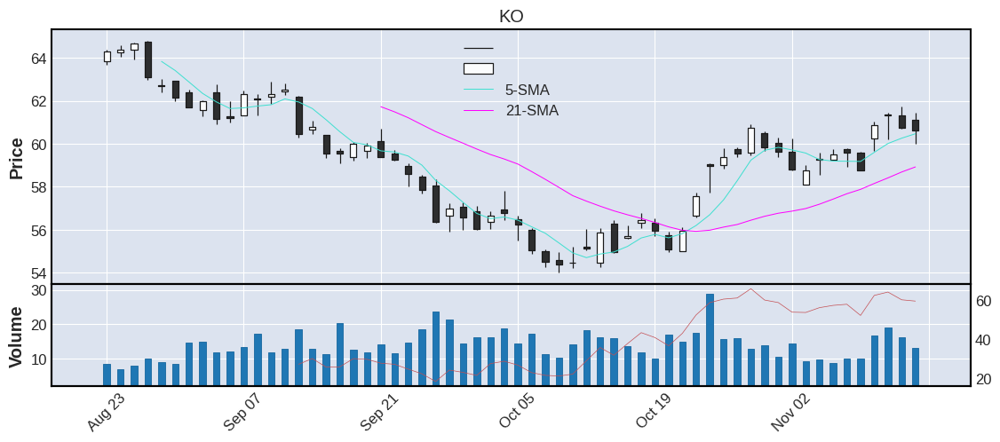



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
17    HSY  217.31  33.63  1.07    1.55 -0.37  5.57  2.56  Consumer_Staples  0.0  United States    large


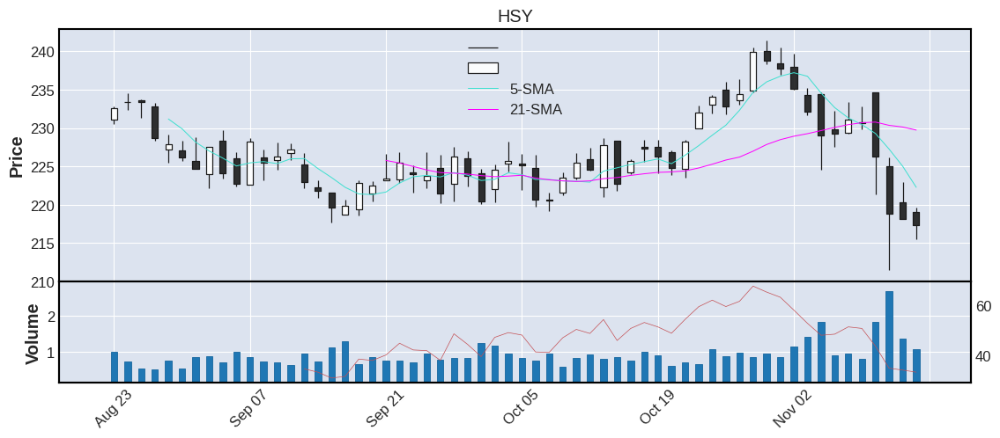



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
18    STZ  243.45  55.34  2.21    1.42 -0.41  6.33   2.6  Consumer_Staples  0.0  United States    large


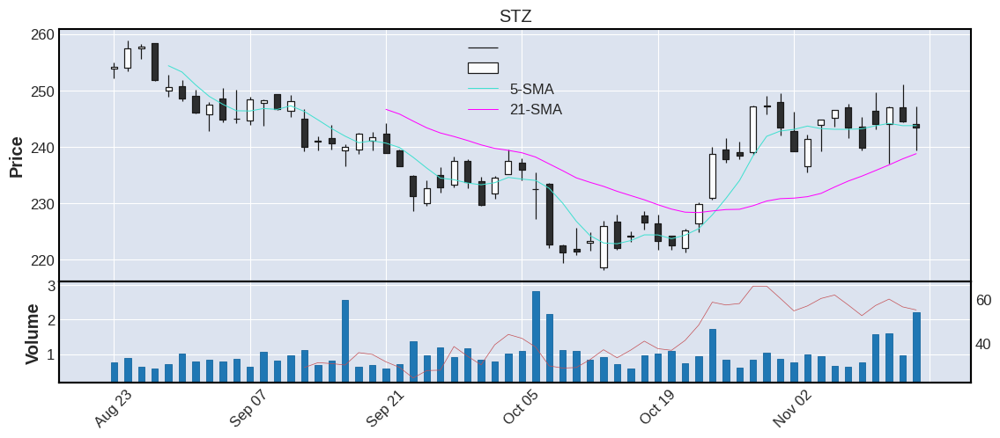



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
19    TSN  64.34  40.62  3.81    4.68 -0.76  1.94  3.02  Consumer_Staples  0.0  United States    large


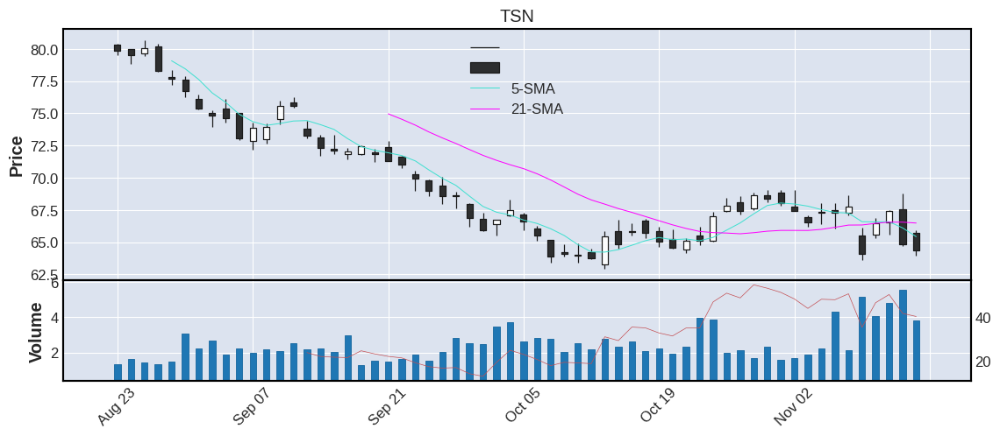



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
20    SJM  140.48  37.31  0.92    0.97 -0.83  3.25  2.31  Consumer_Staples  0.0  United States    large


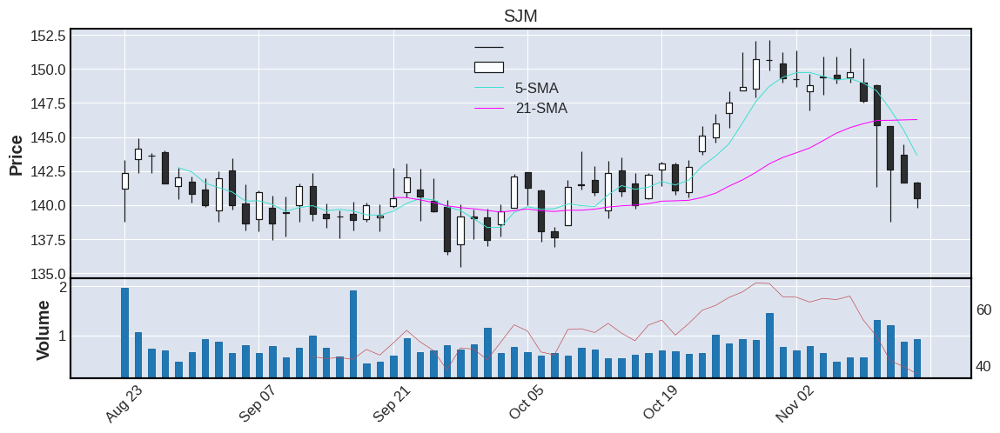



================================================== SECTOR 8: INDUSTRIALS [ %CHG ] ================================================== 

    TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
1    QRVO   98.75  66.79  1.28    1.30   4.6   3.89  3.94  Industrials     0.0  United States   medium
2     RTX   95.79  59.91  7.50    5.52  3.06   2.50  2.61  Industrials     0.0  United States    large
3     XYL  112.13  68.60  0.94    0.87  2.89   3.17  2.83  Industrials  2011.0  United States    large
4     TER   96.59  69.24  1.56    1.73   2.6   3.70  3.83  Industrials     0.0  United States    large
5     MAS   50.94  60.27  1.90    2.44  2.45   1.97  3.87  Industrials     0.0  United States   medium
6     NWL   13.97  48.12  3.46    4.15  2.42   0.62  4.44  Industrials     0.0  United States   medium
7     TMO  546.09  61.64  1.52    1.68  2.12  17.01  3.11  Industrials     0.0  United States    large
8      TT  176.88  68.99  1.11    1.42

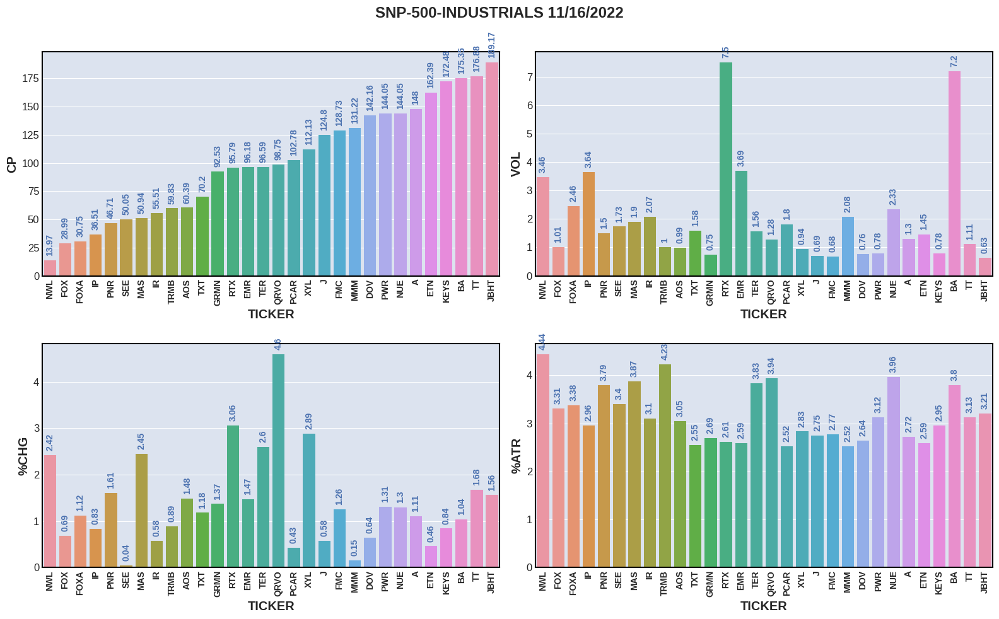

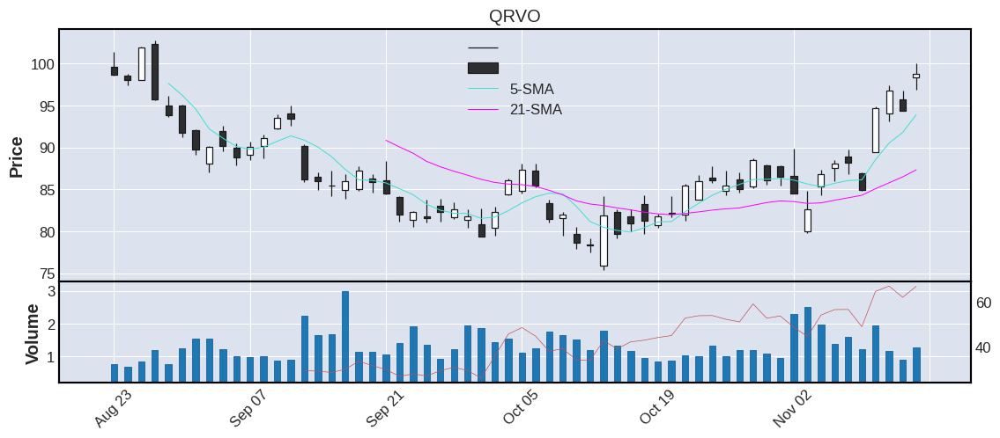



  TICKER     CP    RSI  VOL  AVGVOL  %CHG  ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
2    RTX  95.79  59.91  7.5    5.52  3.06  2.5  2.61  Industrials  0.0  United States    large


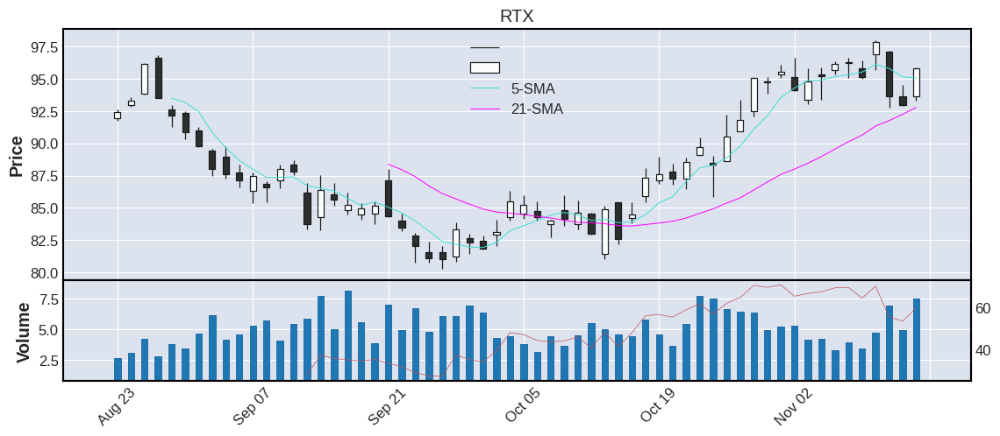



  TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
3    XYL  112.13  68.6  0.94    0.87  2.89  3.17  2.83  Industrials  2011.0  United States    large


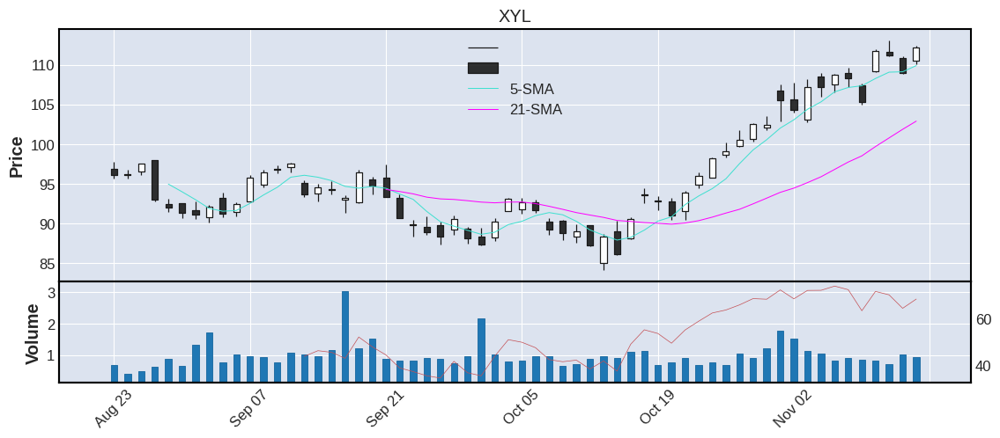



  TICKER     CP    RSI   VOL  AVGVOL %CHG  ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
4    TER  96.59  69.24  1.56    1.73  2.6  3.7  3.83  Industrials  0.0  United States    large


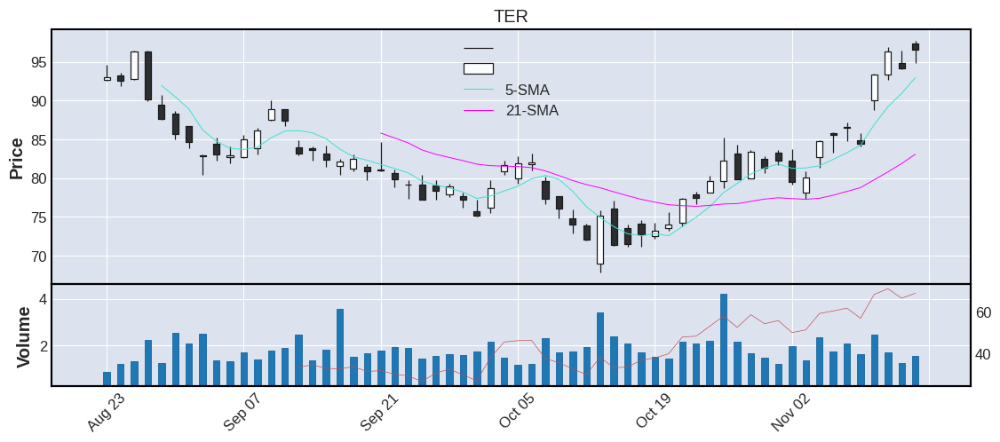



  TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
5    MAS  50.94  60.27  1.9    2.44  2.45  1.97  3.87  Industrials  0.0  United States   medium


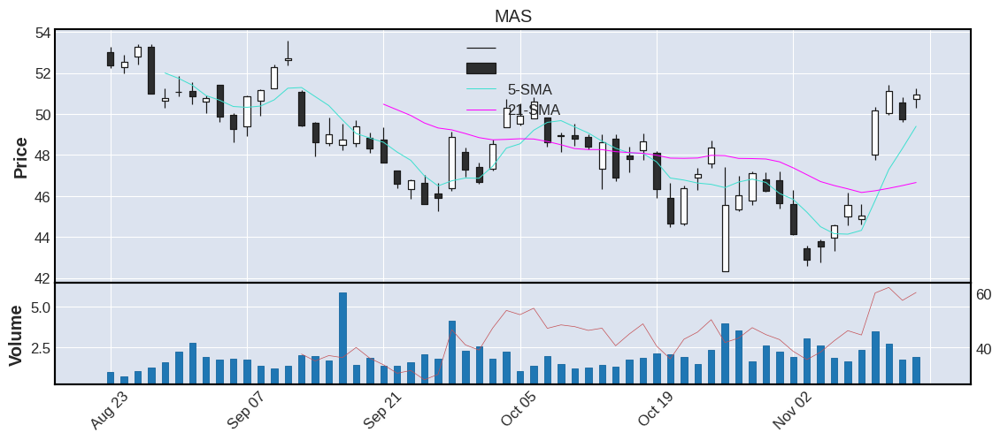



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
6    NWL  13.97  48.12  3.46    4.15  2.42  0.62  4.44  Industrials  0.0  United States   medium


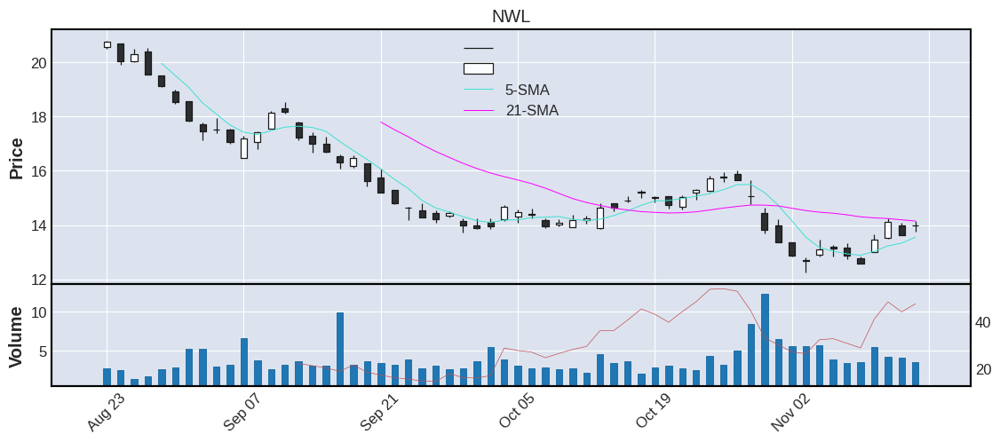



  TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
7    TMO  546.09  61.64  1.52    1.68  2.12  17.01  3.11  Industrials  0.0  United States    large


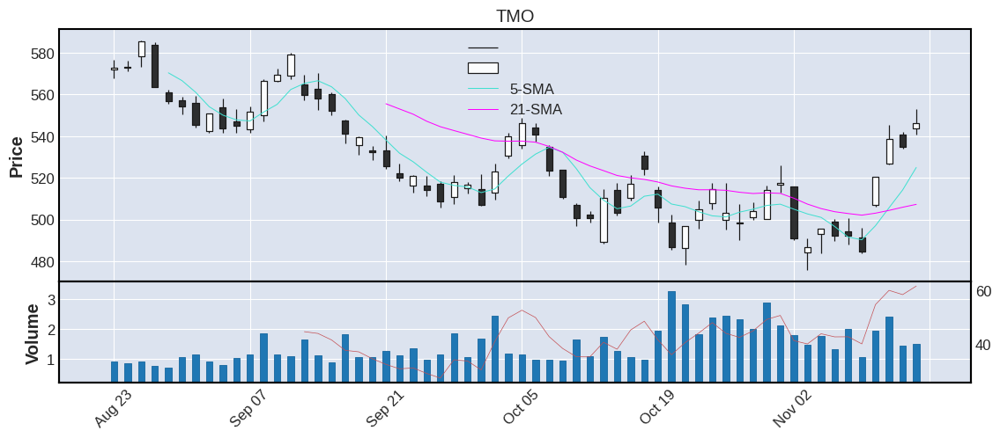



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO  COUNTRY CATEGORY
8     TT  176.88  68.99  1.11    1.42  1.68  5.53  3.13  Industrials  0.0  Ireland    large


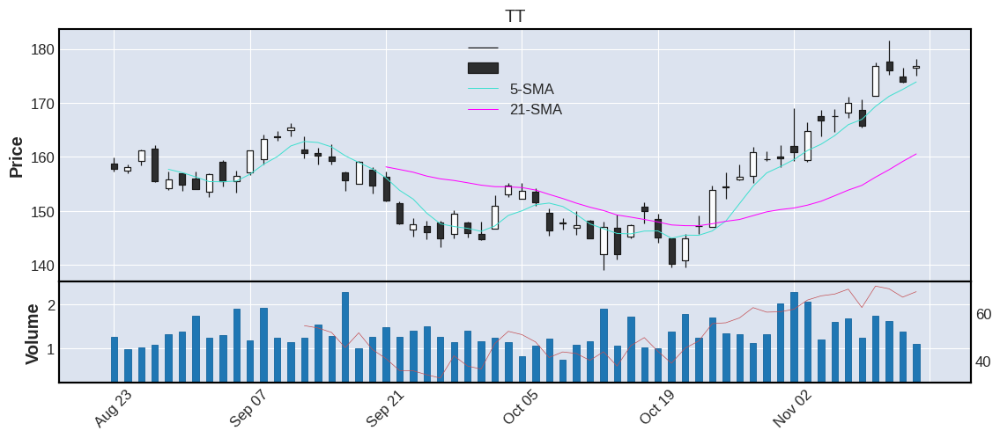



  TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO      COUNTRY CATEGORY
9    PNR  46.71  64.45  1.5    1.73  1.61  1.77  3.79  Industrials  0.0  Switzerland   medium


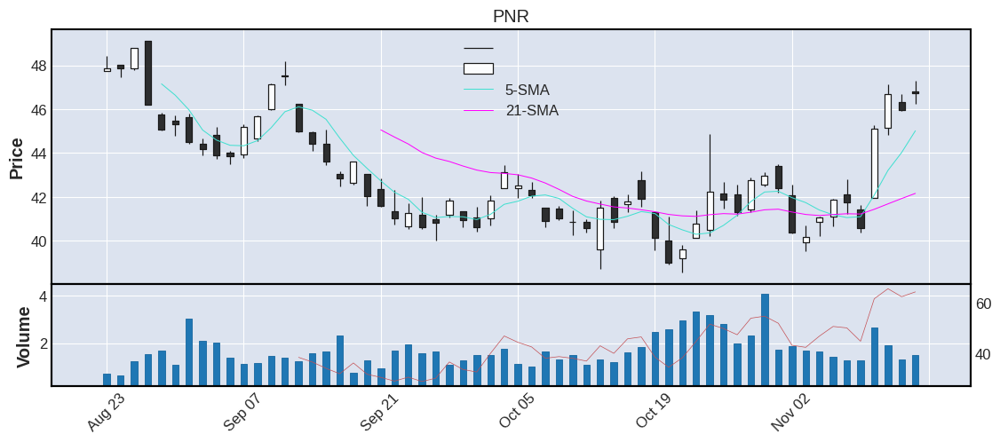



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
10   TSCO  216.2  58.86  1.15    1.27  1.61  8.11  3.75  Industrials  1994.0  United States    large


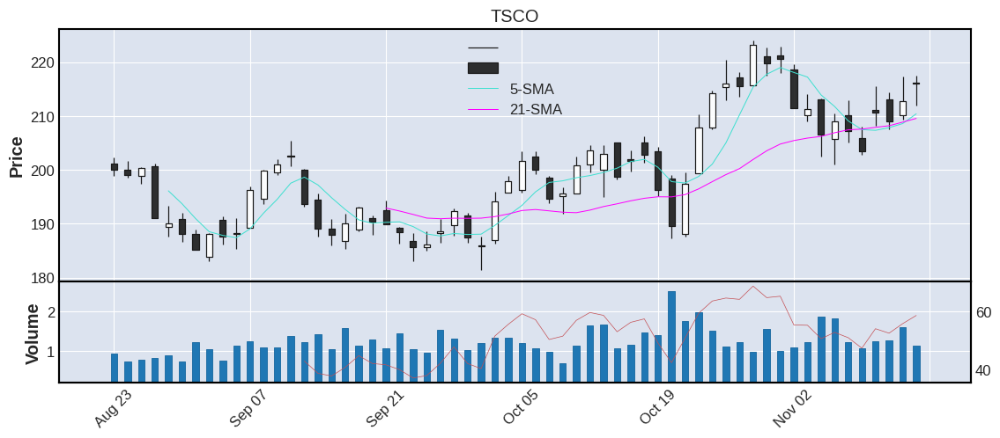



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
11    LHX  221.24  39.75  2.25    2.11  1.58  8.05  3.64  Industrials  0.0  United States    large


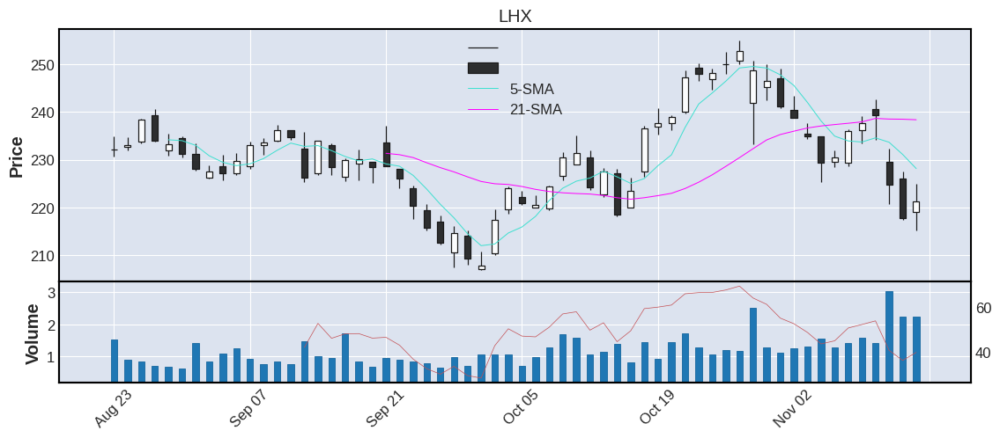



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
12   POOL  346.25  61.98  0.46    0.65  1.57  14.81  4.28  Industrials  1995.0  United States    large


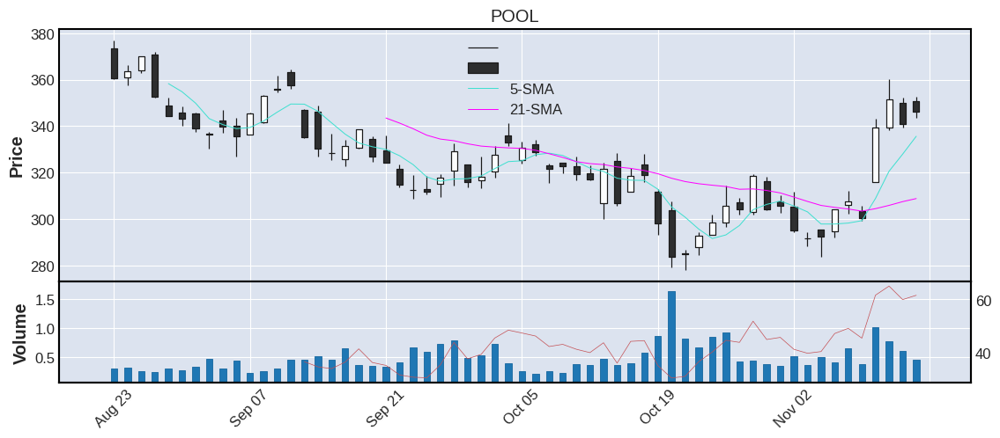



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
13   JBHT  189.17  67.6  0.63    0.77  1.56  6.07  3.21  Industrials  0.0  United States    large


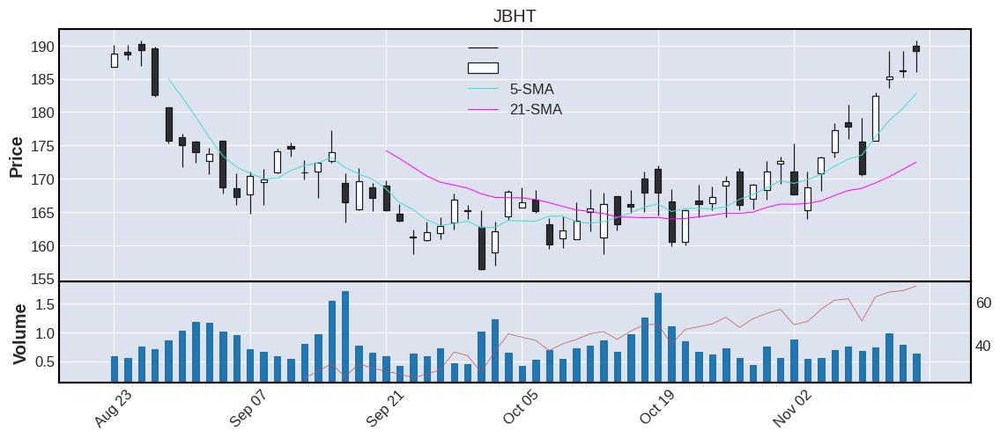



   TICKER      CP    RSI  VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
14    TDY  413.27  65.33  0.3    0.29  1.54  10.78  2.61  Industrials  0.0  United States    large


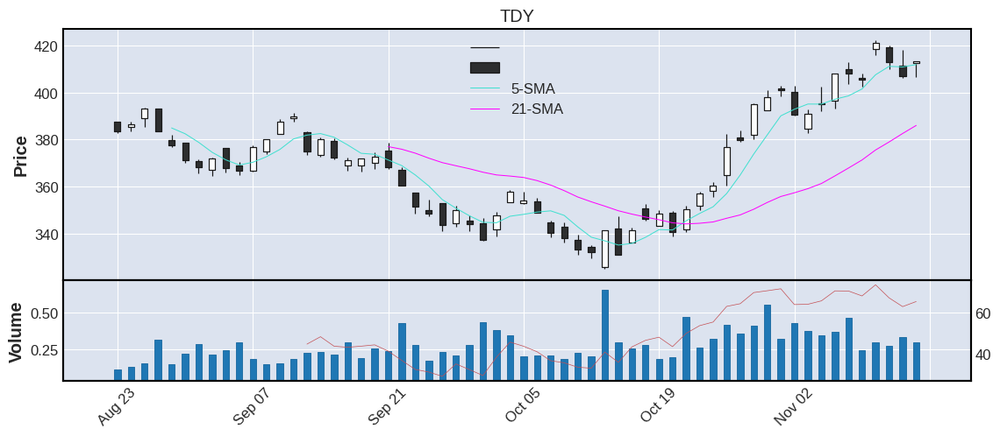



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
15    IEX  231.62  64.32  0.51    0.39  1.54  5.66  2.44  Industrials  1989.0  United States    large


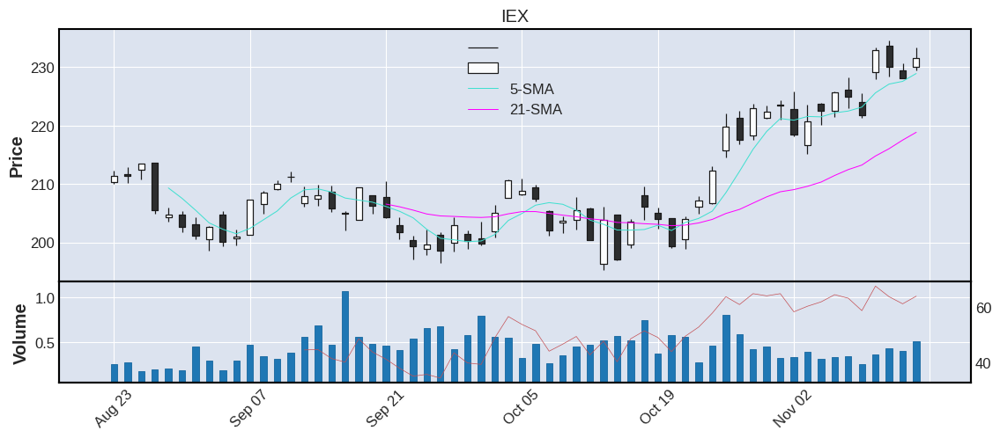



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
16    AOS  60.39  70.01  0.99     1.2  1.48  1.84  3.05  Industrials  0.0  United States   medium


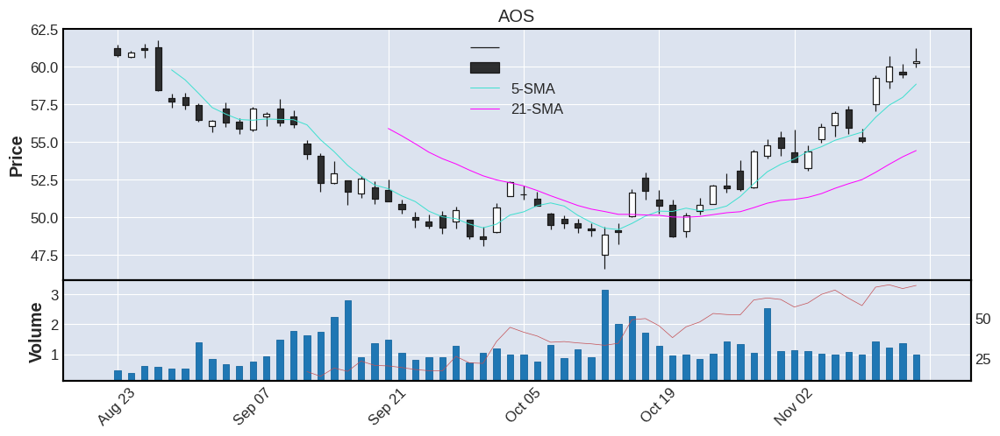



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
17    EMR  96.18  74.46  3.69    3.75  1.47  2.49  2.59  Industrials  0.0  United States    large


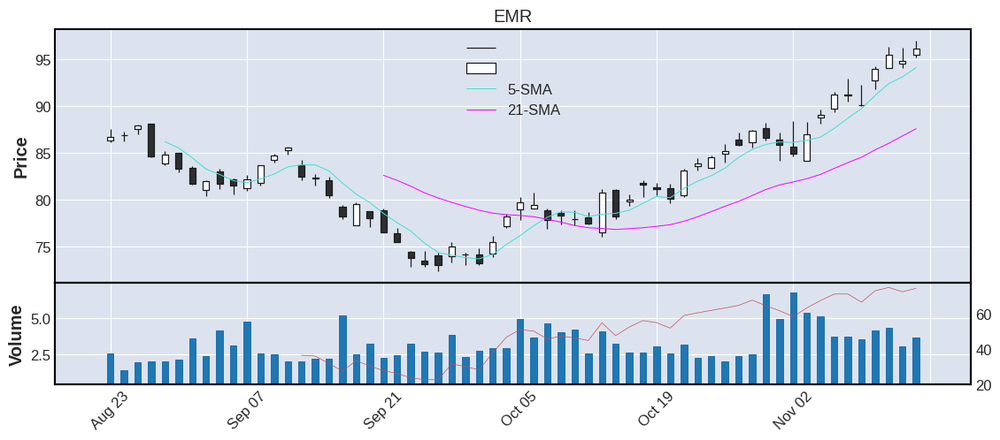



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
18     GD  246.14  54.48  1.22    1.16  1.37  5.28  2.15  Industrials  0.0  United States    large


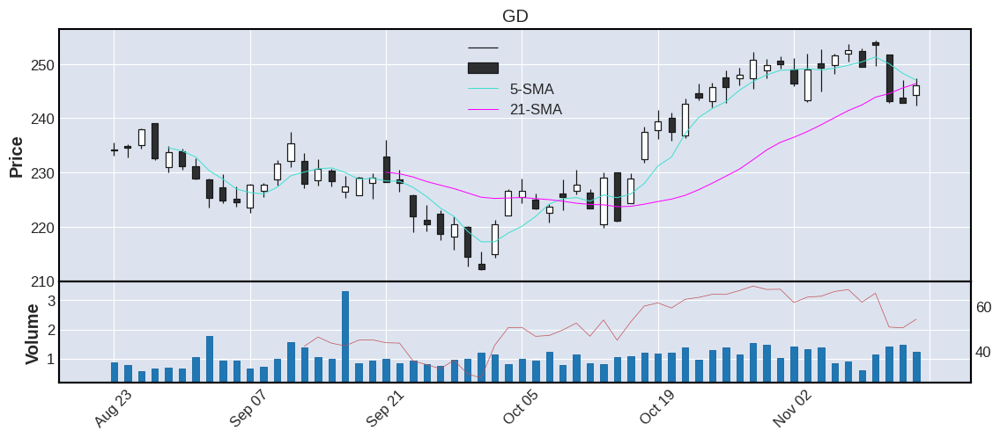



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO      COUNTRY CATEGORY
19   GRMN  92.53  63.69  0.75     0.8  1.37  2.49  2.69  Industrials  2000.0  Switzerland    large


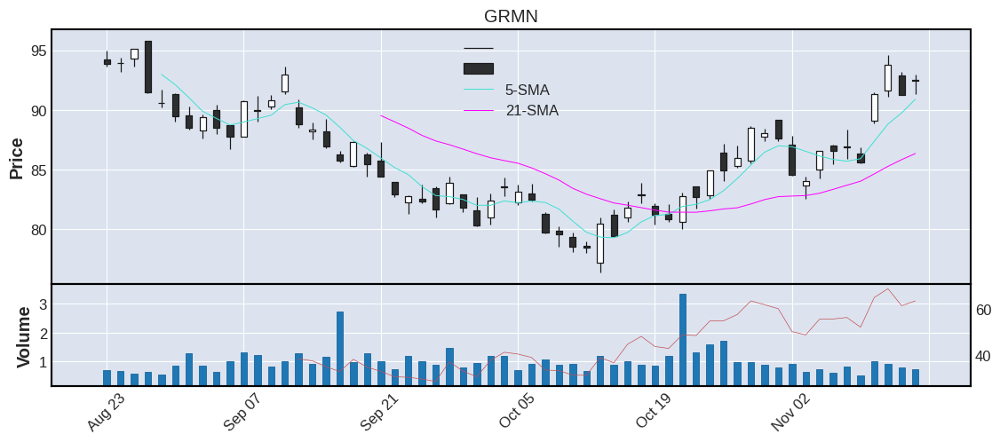



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
20     PH  311.06  68.22  1.16     1.0  1.34  9.09  2.92  Industrials  0.0  United States    large


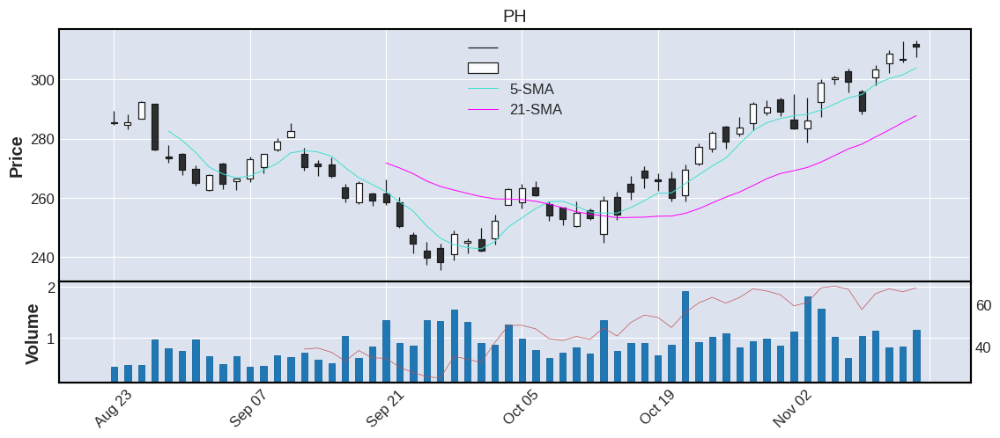



   TICKER      CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
21    PWR  144.05  55.28  0.78    0.98  1.31  4.5  3.12  Industrials  0.0  United States    large


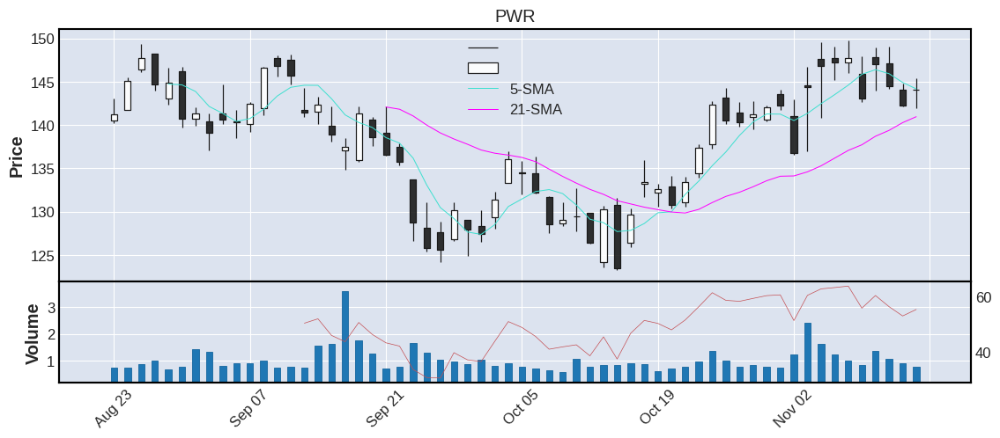



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
22    NUE  144.05  66.77  2.33    2.26  1.3  5.71  3.96  Industrials  0.0  United States    large


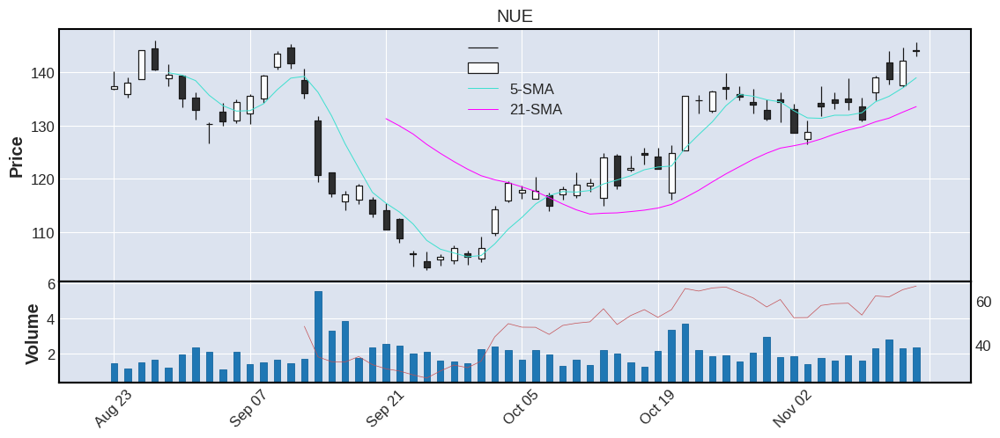



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
23    FMC  128.73  71.88  0.68    0.73  1.26  3.56  2.77  Industrials  0.0  United States    large


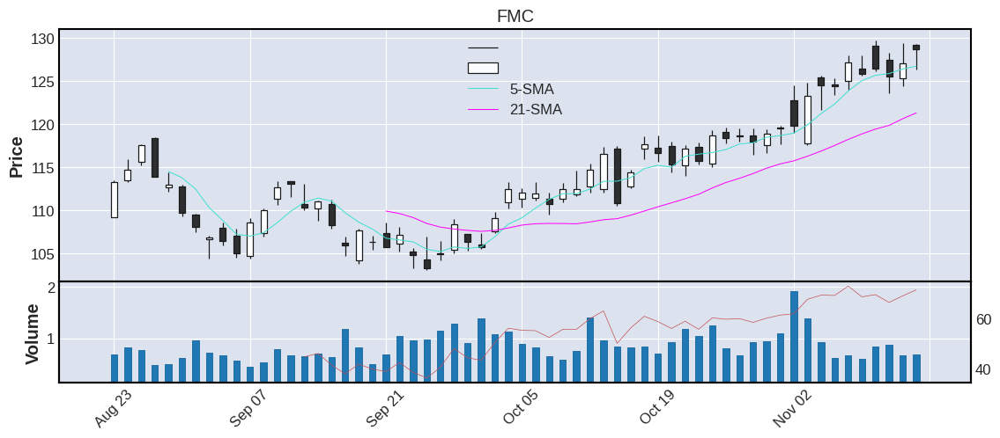



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
24   ODFL  318.09  70.28  0.87    1.07  1.22  12.68  3.99  Industrials  1991.0  United States    large


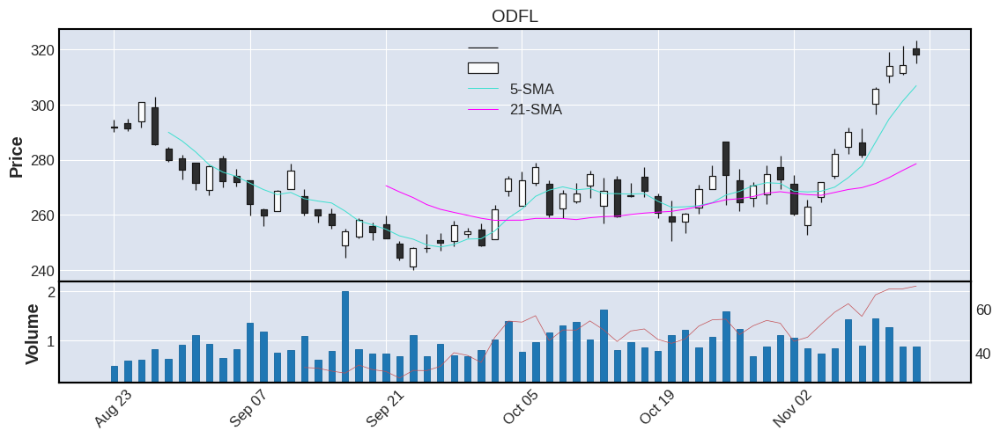



   TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
25    TXT  70.2  62.81  1.58    1.31  1.18  1.79  2.55  Industrials  0.0  United States    large


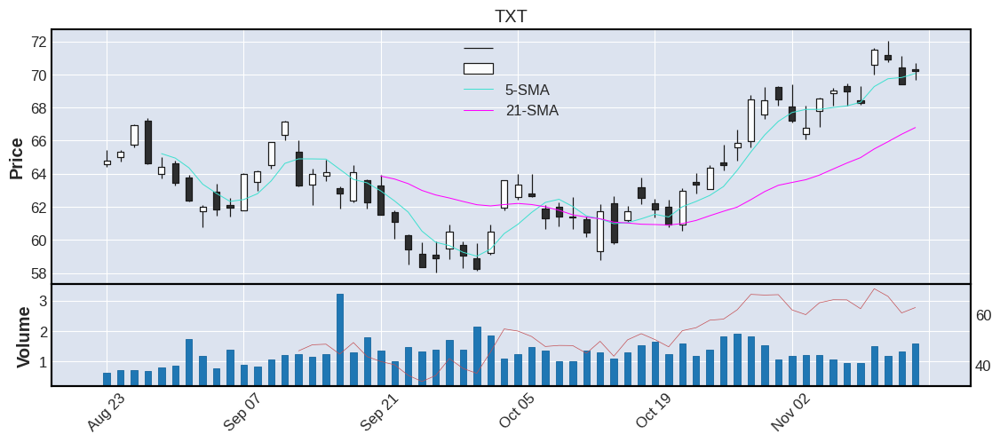



   TICKER      CP   RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
26    HON  215.43  73.1  2.3     3.4  1.14  4.77  2.21  Industrials  0.0  United States    large


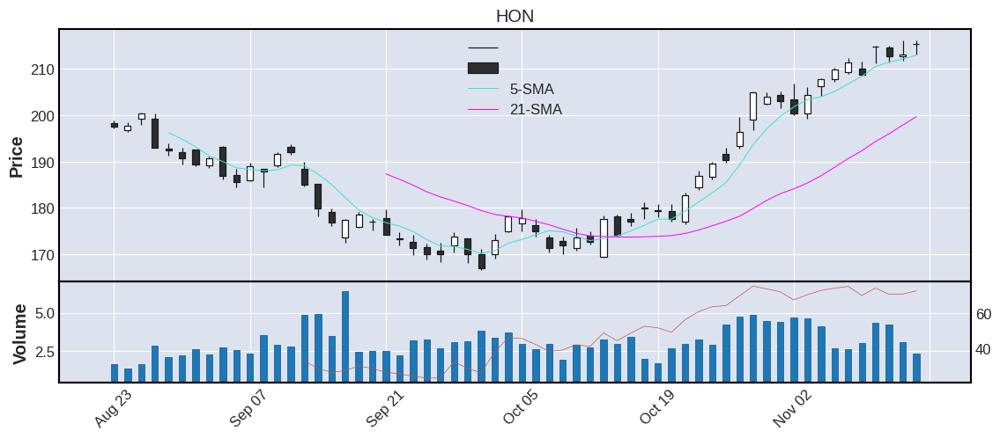



   TICKER      CP   RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
27    LMT  467.25  53.9  3.27    2.32  1.13  12.45  2.66  Industrials  0.0  United States    large


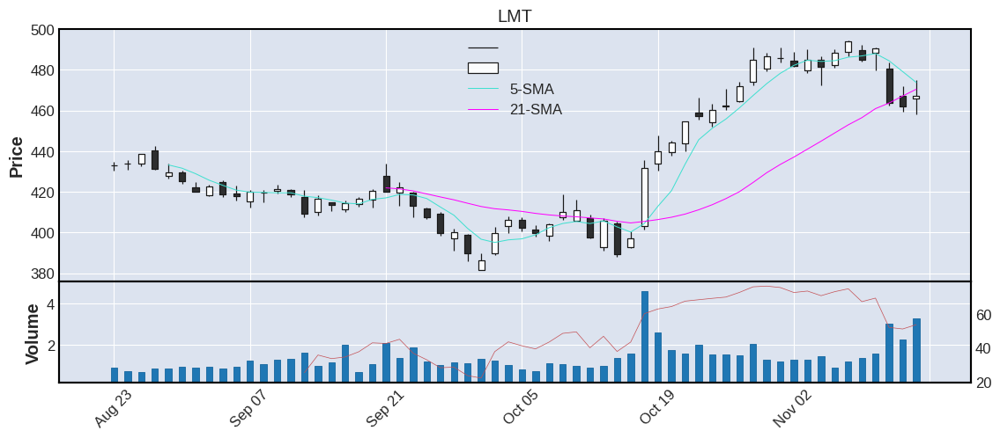



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
28   FOXA  30.75  54.32  2.46    3.14  1.12  1.04  3.38  Industrials  0.0  United States    large


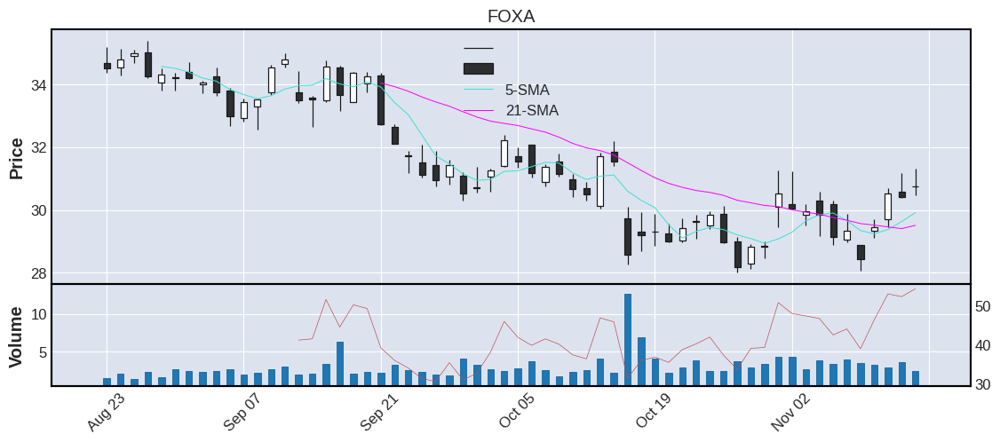



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
29      A  148.0  66.77  1.3    1.26  1.11  4.02  2.72  Industrials  1999.0  United States    large


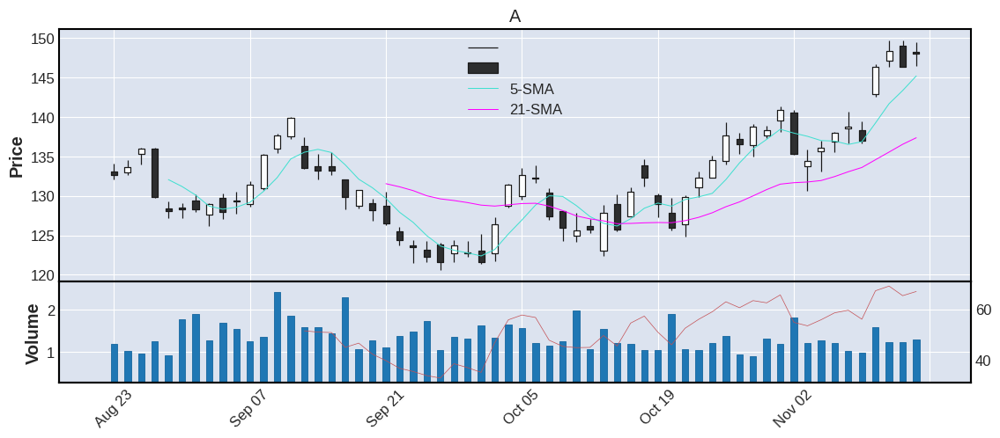



   TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
30     BA  175.35  72.23  7.2    8.59  1.04  6.67   3.8  Industrials  0.0  United States    large


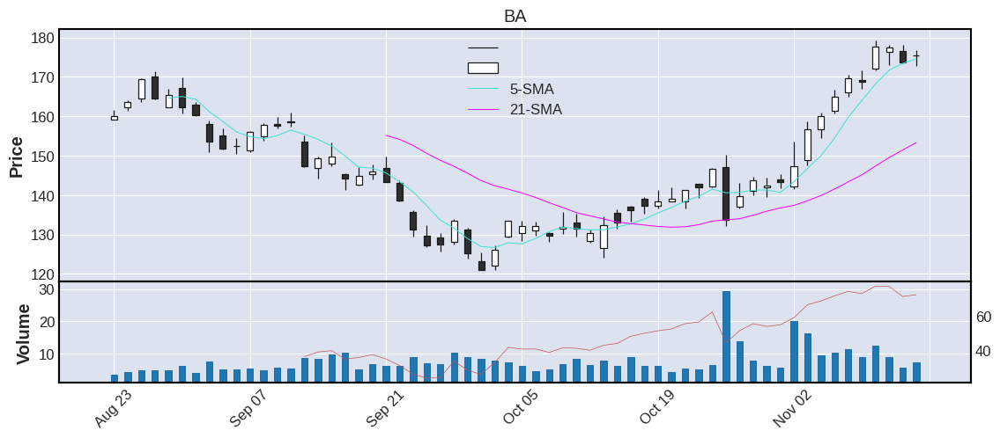



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
31    ITW  227.86  72.6  1.02    1.11  0.95  5.79  2.54  Industrials  0.0  United States    large


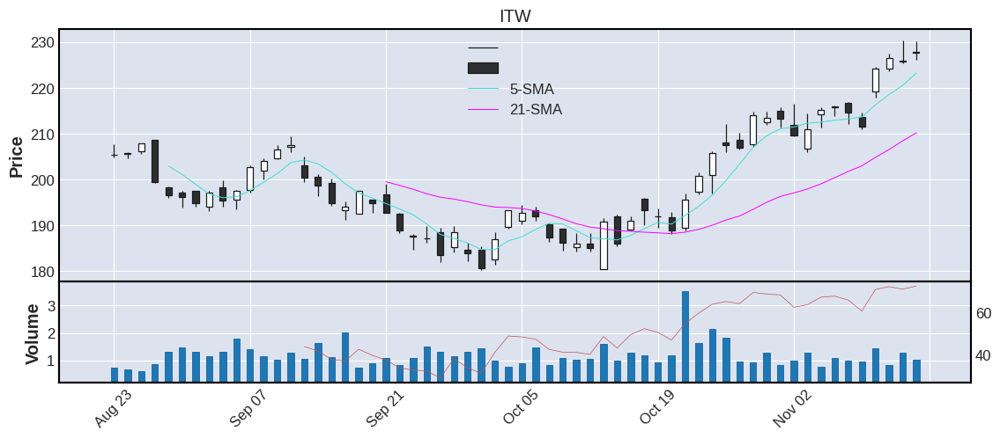



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
32    HII  223.21  34.98  0.84    0.59  0.95  7.91  3.54  Industrials  0.0  United States   medium


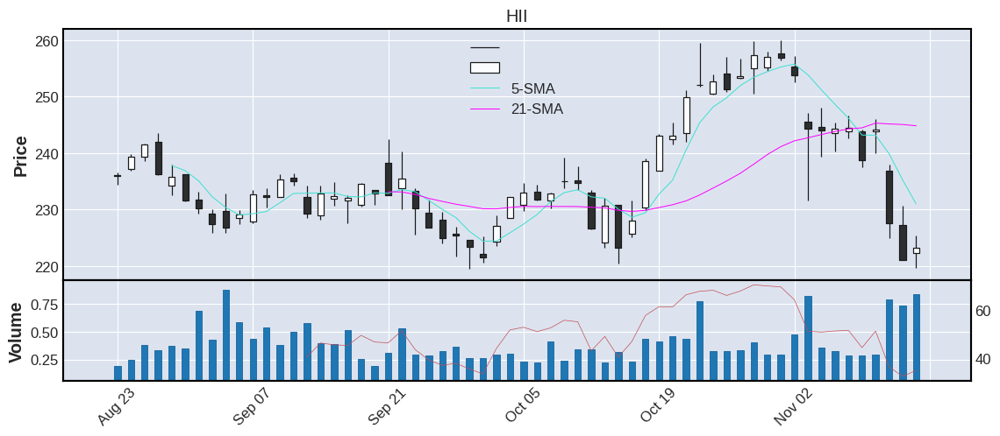



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
33   TRMB  59.83  55.28  1.0    1.23  0.89  2.53  4.23  Industrials  1990.0  United States    large


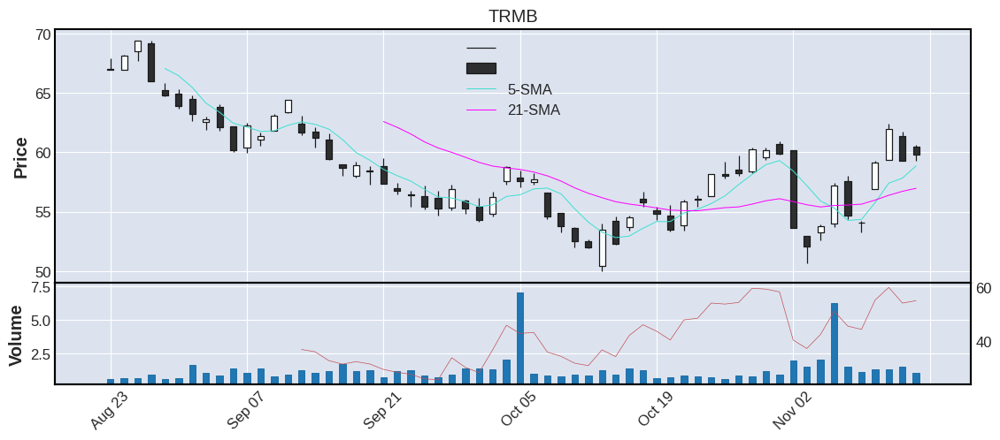



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
34   KEYS  172.48  57.64  0.78    0.94  0.84  5.08  2.95  Industrials  2014.0  United States    large


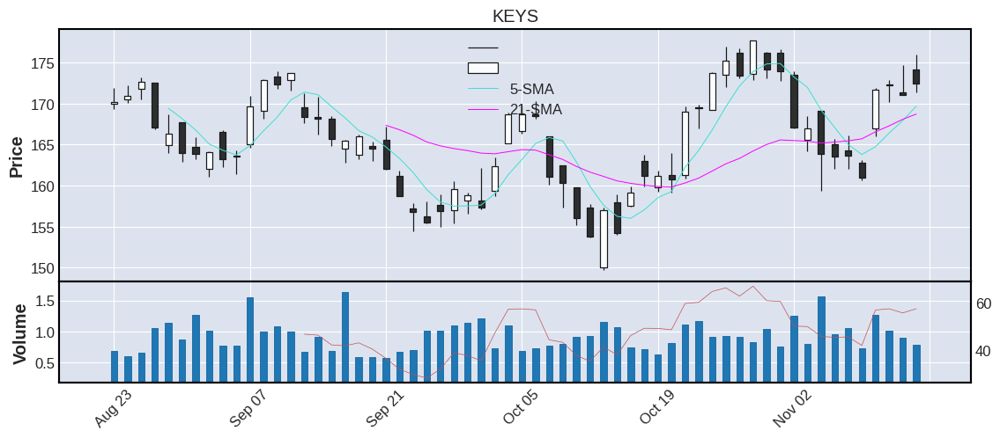



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
35     IP  36.51  64.76  3.64    4.03  0.83  1.08  2.96  Industrials  0.0  United States    large


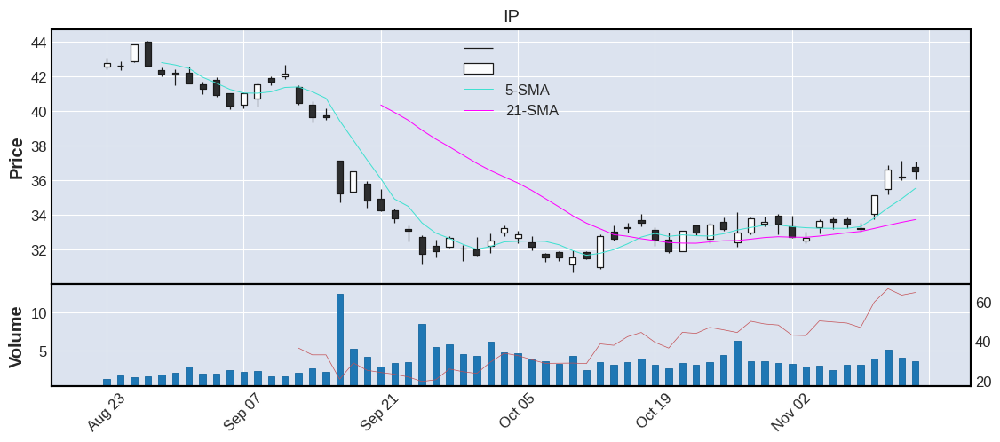



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
36    ROK  269.54  64.65  0.75    0.83  0.8  9.39  3.48  Industrials  0.0  United States    large


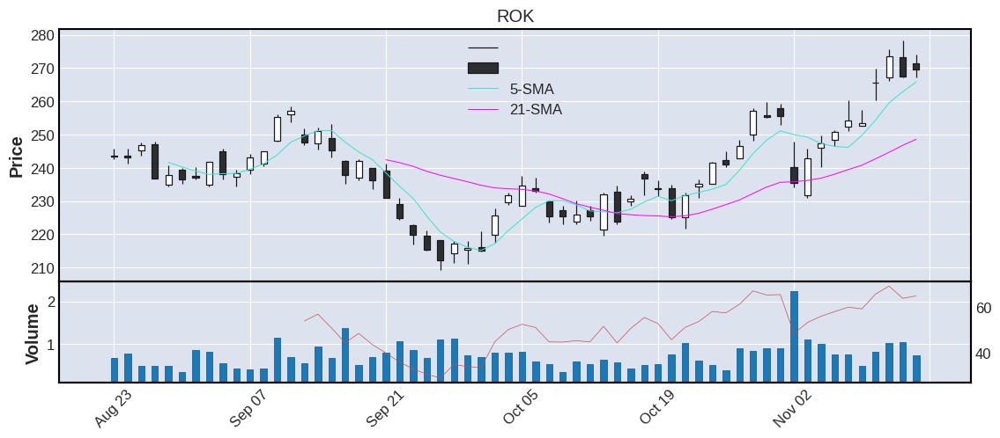



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
37    ROP  435.95  69.83  0.47    0.56  0.78  10.84  2.49  Industrials  1992.0  United States    large


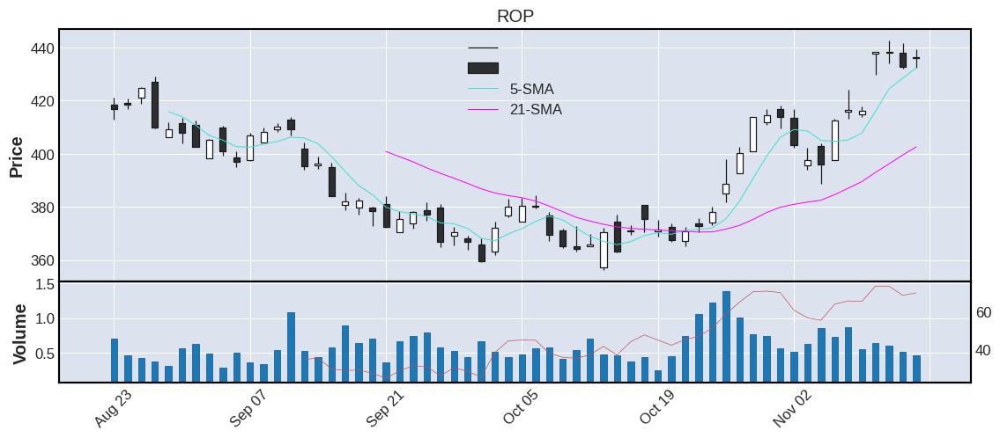



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
38    FOX  28.99  55.62  1.01    1.36  0.69  0.96  3.31  Industrials  0.0  United States    large


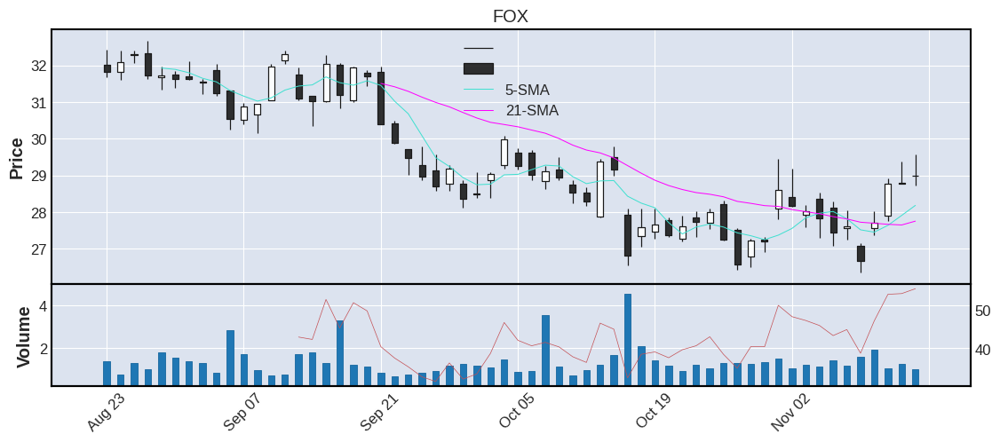



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
39    CMI  250.71  67.62  1.13    1.21  0.66  7.15  2.85  Industrials  0.0  United States    large


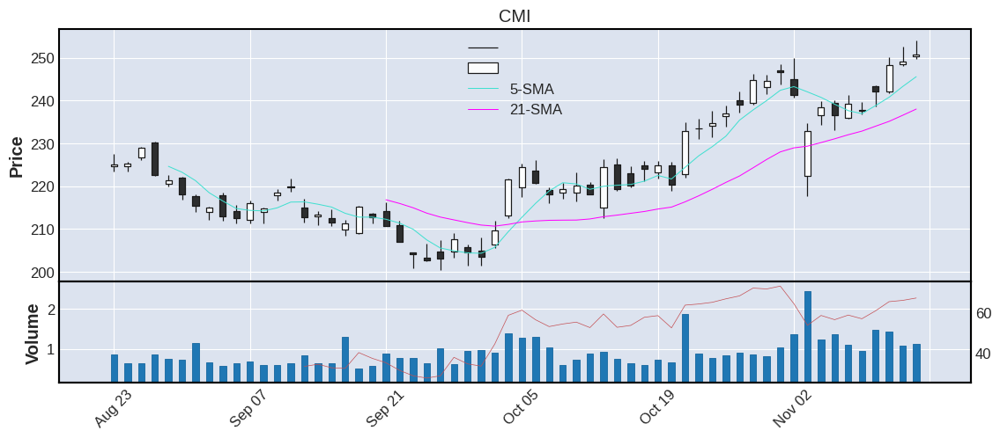



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
40    DOV  142.16  70.24  0.76    1.01  0.64  3.75  2.64  Industrials  0.0  United States    large


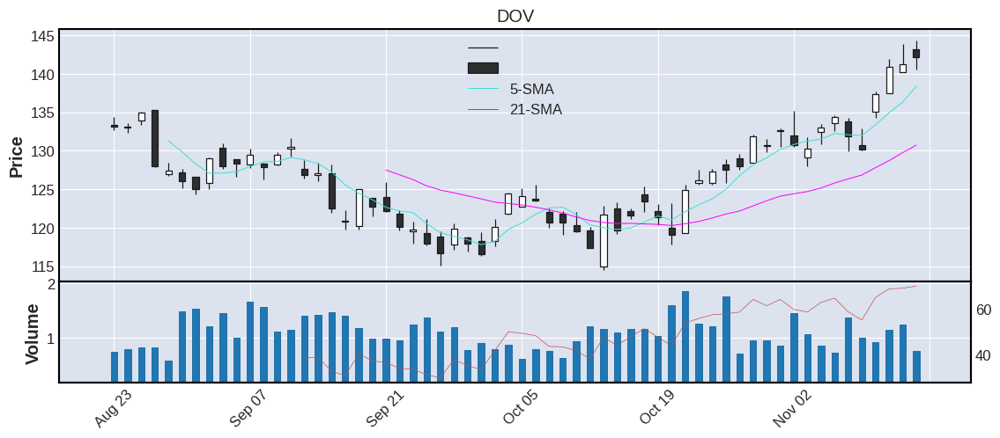



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
41     IR  55.51  70.27  2.07    3.67  0.58  1.72   3.1  Industrials  2017.0  United States    large


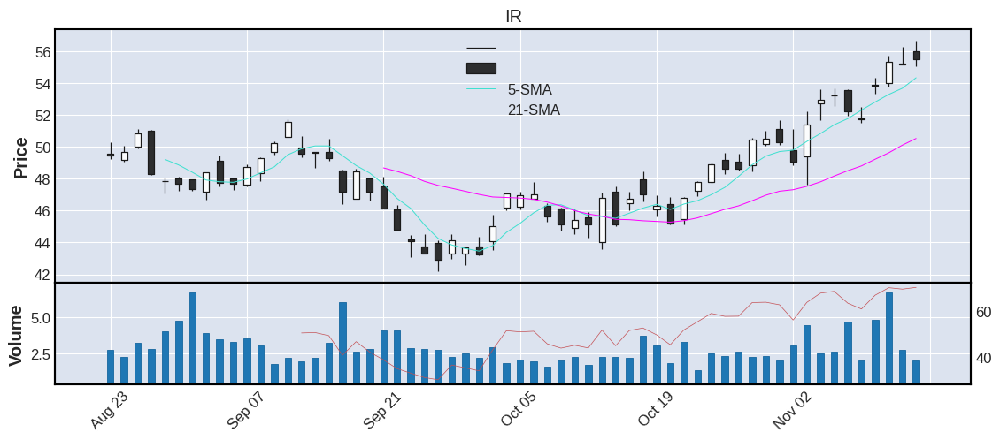



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO COUNTRY CATEGORY
42      J  124.8  63.39  0.69    0.54  0.58  3.43  2.75  Industrials  2022.0     N-A    large


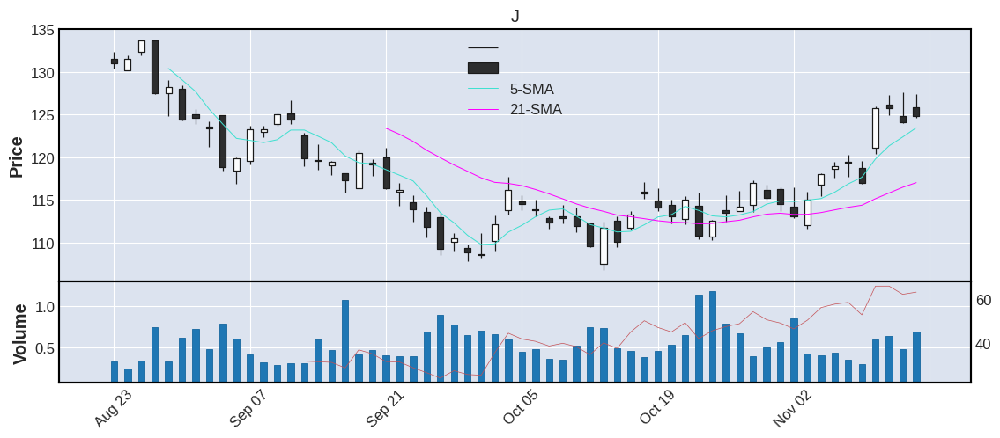



   TICKER      CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR       SECTOR  IPO  COUNTRY CATEGORY
43    ETN  162.39  71.98  1.45    1.92  0.46  4.2  2.59  Industrials  0.0  Ireland    large


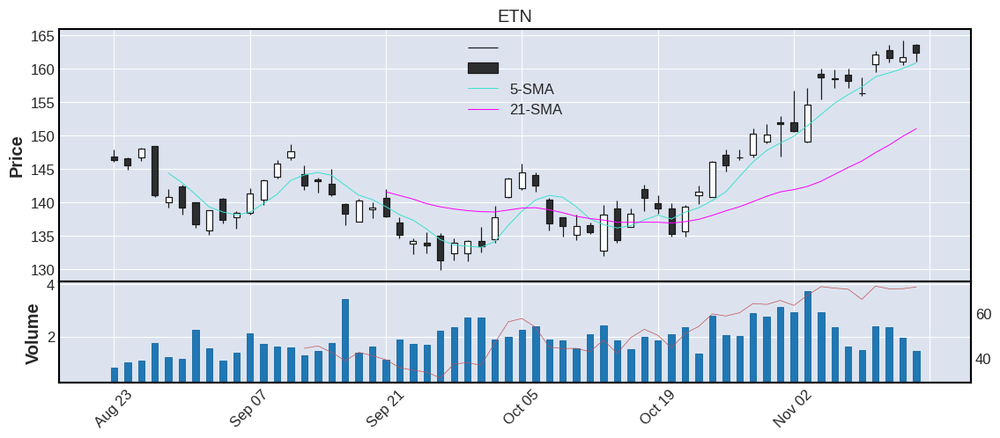



   TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
44   PCAR  102.78  73.53  1.8    2.39  0.43  2.59  2.52  Industrials  0.0  United States    large


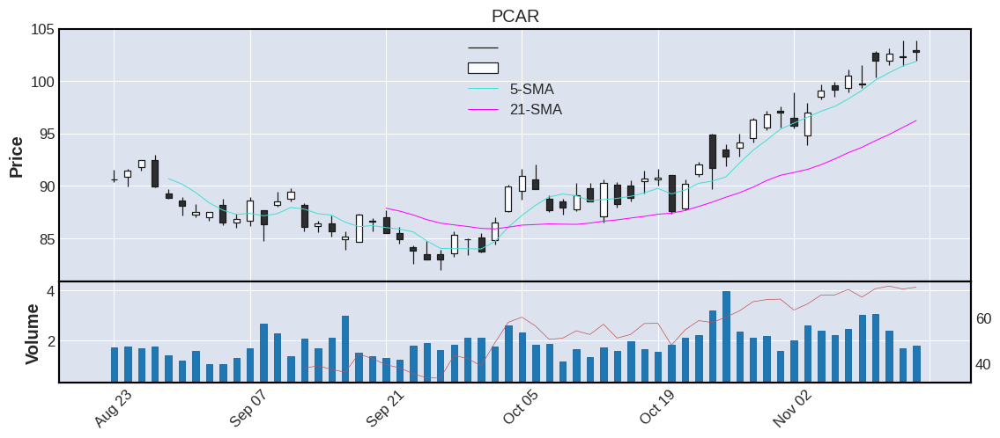



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
45    MLM  354.15  59.94  0.32    0.38  0.33  11.81  3.33  Industrials  1994.0  United States    large


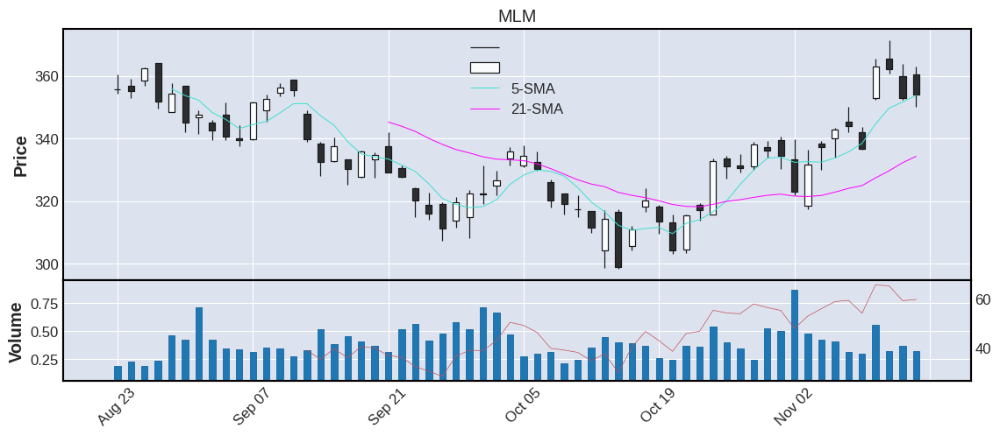



   TICKER      CP    RSI  VOL  AVGVOL %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
46    TDG  618.01  62.61  0.4    0.41  0.3  19.32  3.13  Industrials  2006.0  United States    large


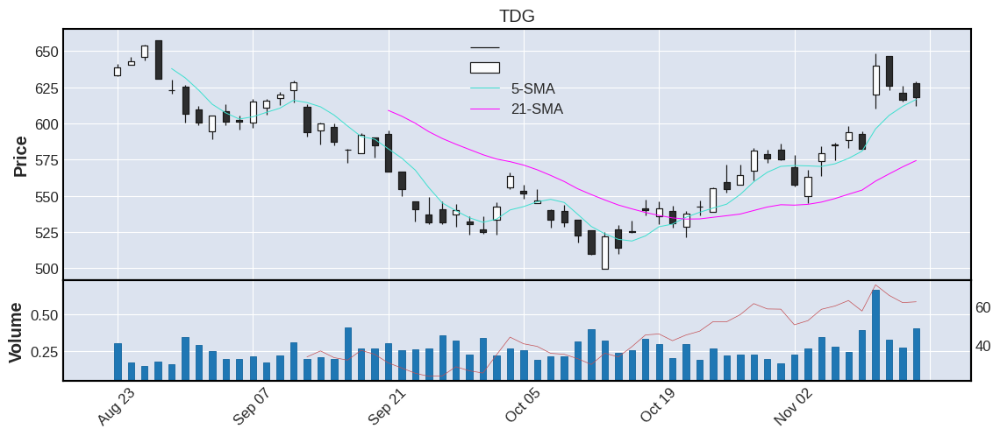



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
47    MMM  131.22  66.84  2.08    2.61  0.15  3.31  2.52  Industrials  0.0  United States    large


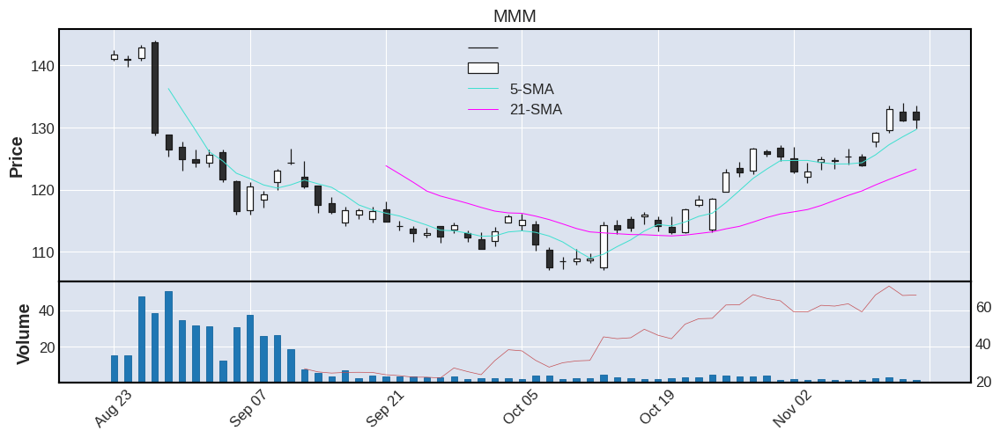



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO COUNTRY CATEGORY
48    LIN  332.56  75.94  1.87    1.95  0.14  8.62  2.59  Industrials  2018.0     N-A    large


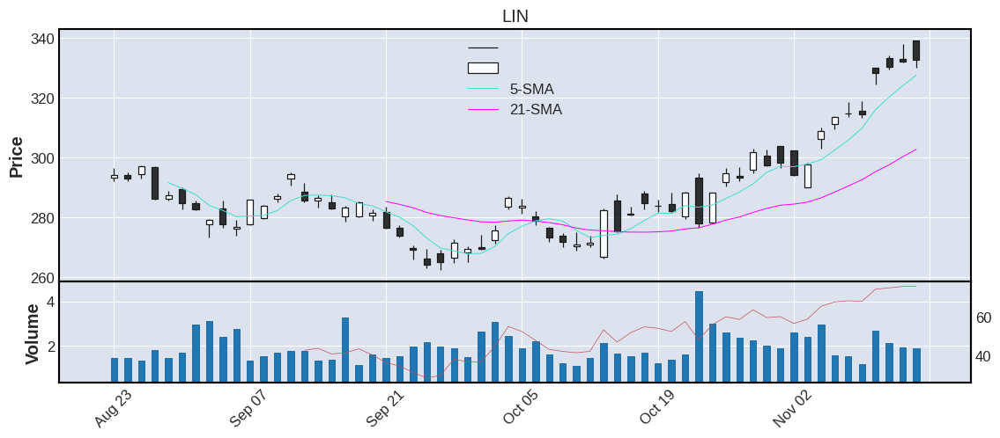



   TICKER     CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
49    SEE  50.05  61.13  1.73    1.94  0.04  1.7   3.4  Industrials  0.0  United States   medium


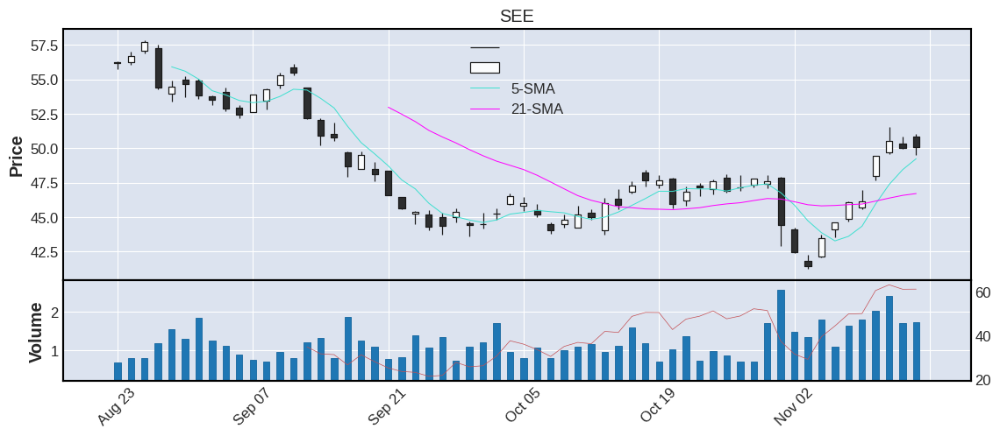



   TICKER      CP    RSI  VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
50     DE  406.97  66.27  1.7    1.96  0.01  10.66  2.62  Industrials  0.0  United States    large


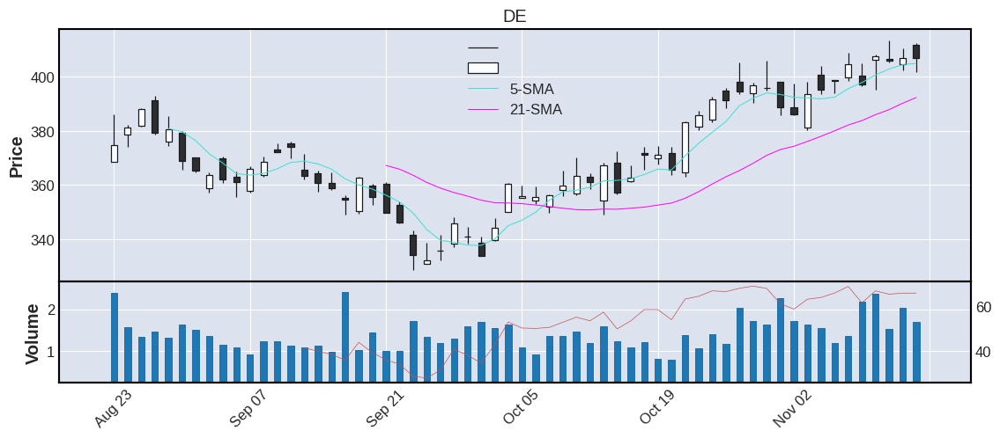



================================================== SECTOR 9: UTILITIES [ %CHG ] ================================================== 

    TICKER      CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR     IPO        COUNTRY CATEGORY
1    EVRG   59.71  47.67   3.64    2.79  3.97  1.83  3.06  Utilities  2018.0            N-A    large
2     PNW   73.88  67.20   1.23    1.07  3.84  1.86  2.52  Utilities     0.0  United States   medium
3    TRGP   74.19  62.93   1.11    1.42  3.17  2.58  3.48  Utilities  2010.0  United States    large
4      FE   38.15  52.02   5.94    3.62  2.55  1.05  2.75  Utilities     0.0  United States    large
5      SO   65.89  50.02   5.91    4.85  2.09  1.51  2.29  Utilities     0.0  United States    large
6     DUK   97.13  58.90   4.63    3.81  1.76  2.22  2.29  Utilities     0.0  United States    large
7       D   58.88  31.20   5.58    9.37  1.59  2.11  3.58  Utilities     0.0  United States    large
8     NEE   82.91  61.04   5.59    6.70  1.53  2.45  2.9

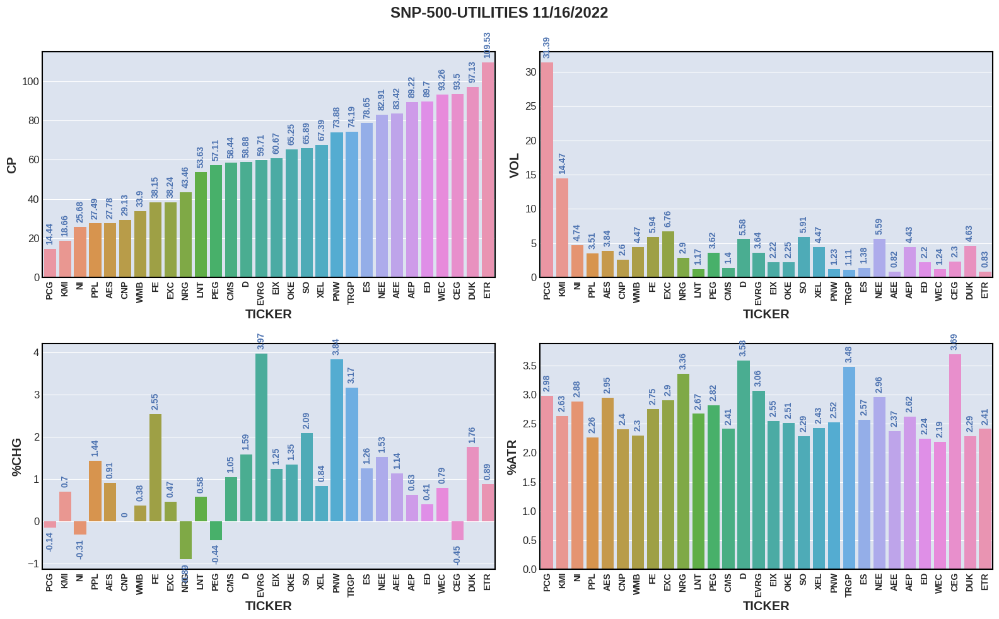

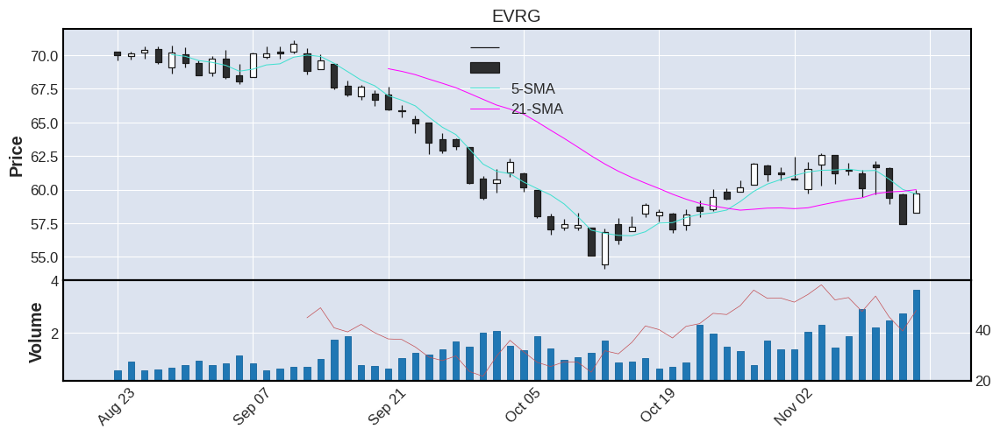



  TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
2    PNW  73.88  67.2  1.23    1.07  3.84  1.86  2.52  Utilities  0.0  United States   medium


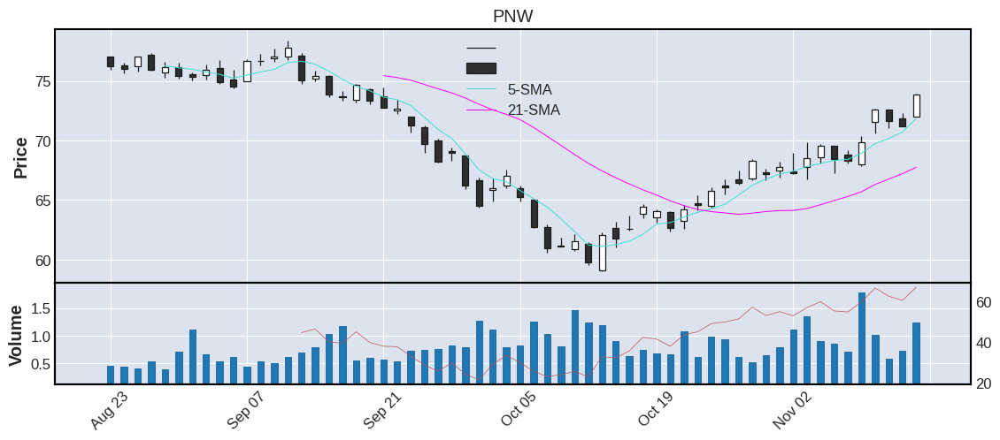



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR     IPO        COUNTRY CATEGORY
3   TRGP  74.19  62.93  1.11    1.42  3.17  2.58  3.48  Utilities  2010.0  United States    large


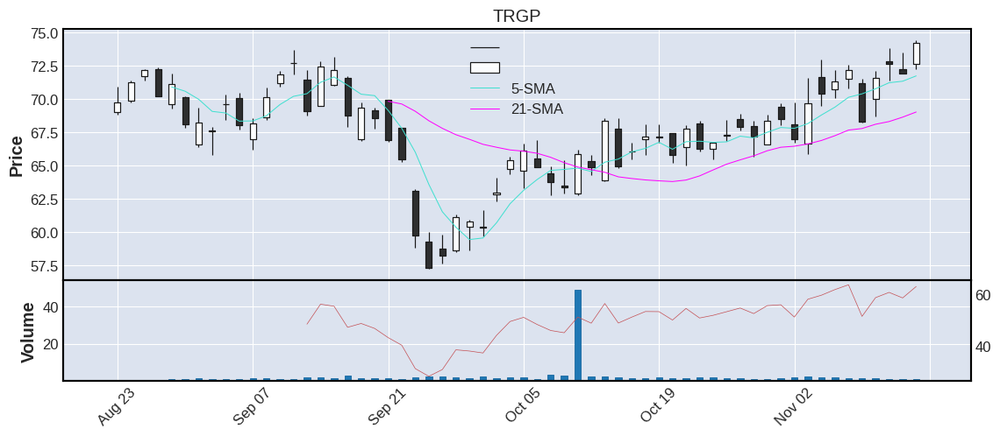



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
4     FE  38.15  52.02  5.94    3.62  2.55  1.05  2.75  Utilities  0.0  United States    large


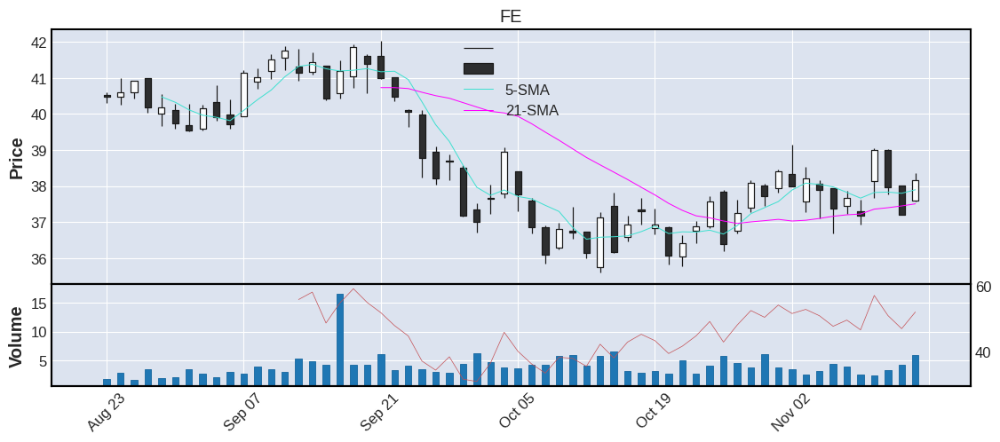



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
5     SO  65.89  50.02  5.91    4.85  2.09  1.51  2.29  Utilities  0.0  United States    large


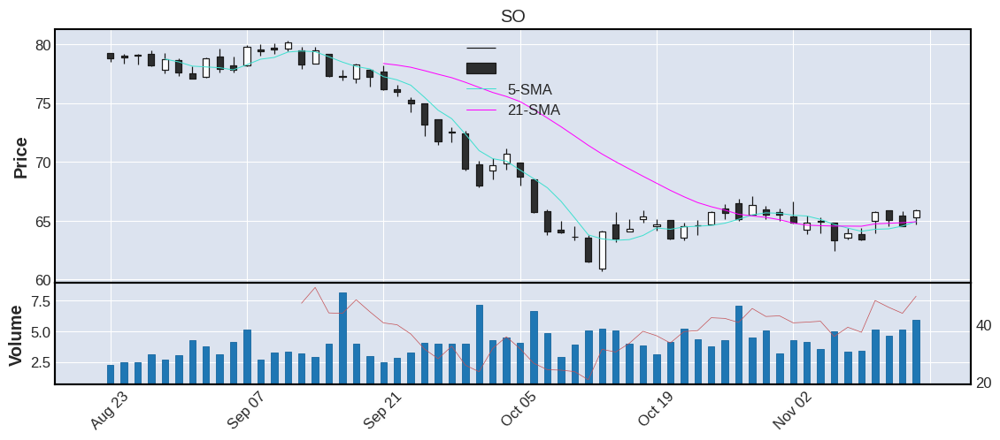



  TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
6    DUK  97.13  58.9  4.63    3.81  1.76  2.22  2.29  Utilities  0.0  United States    large


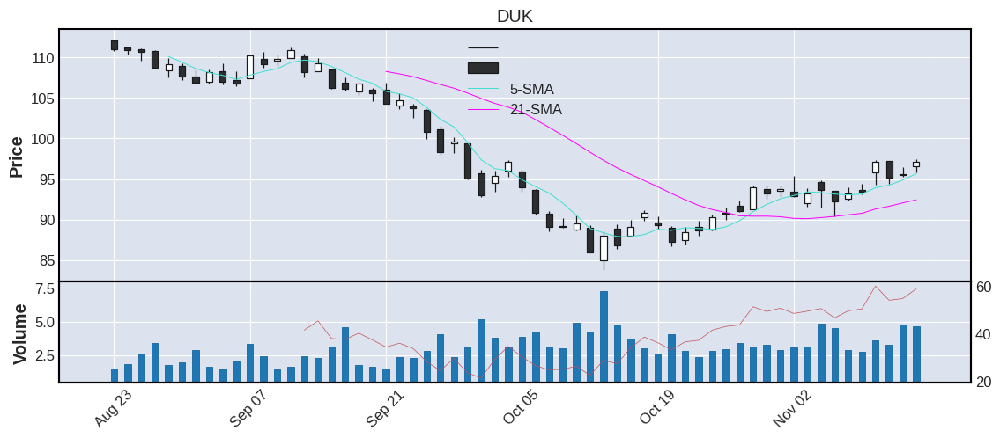



  TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
7      D  58.88  31.2  5.58    9.37  1.59  2.11  3.58  Utilities  0.0  United States    large


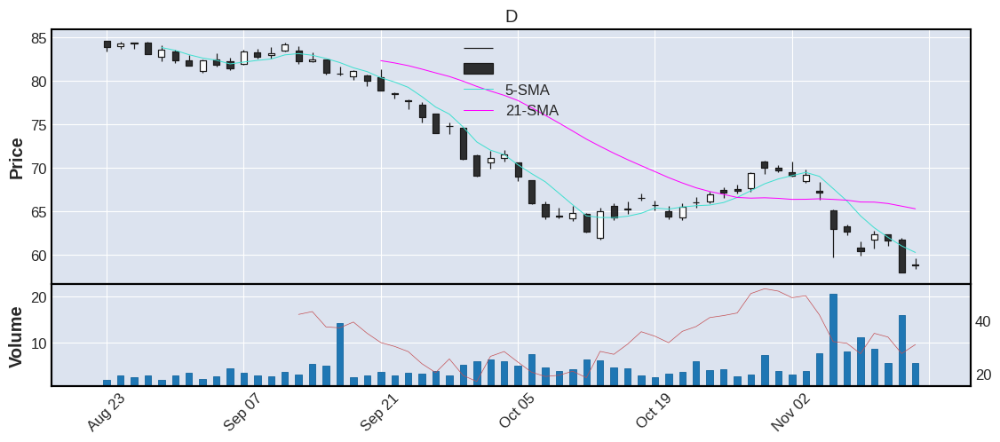



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
8    NEE  82.91  61.04  5.59     6.7  1.53  2.45  2.96  Utilities  0.0  United States    large


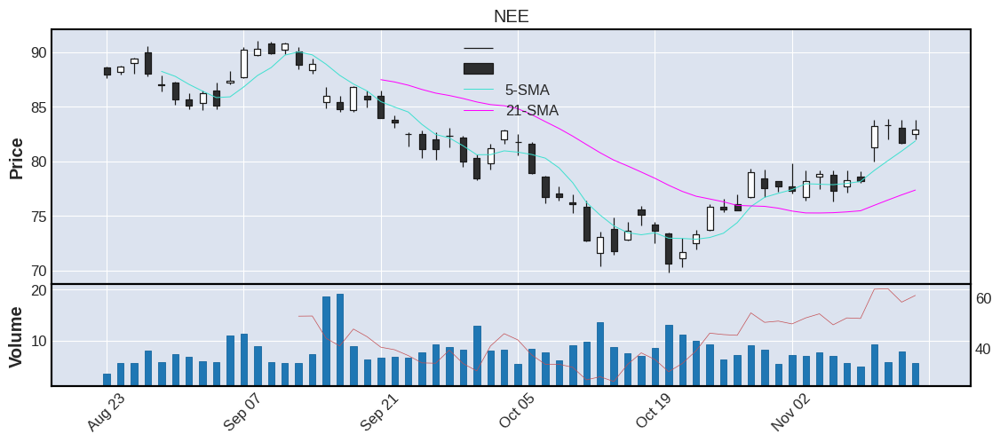



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
9    PPL  27.49  58.01  3.51    3.72  1.44  0.62  2.26  Utilities  0.0  United States    large


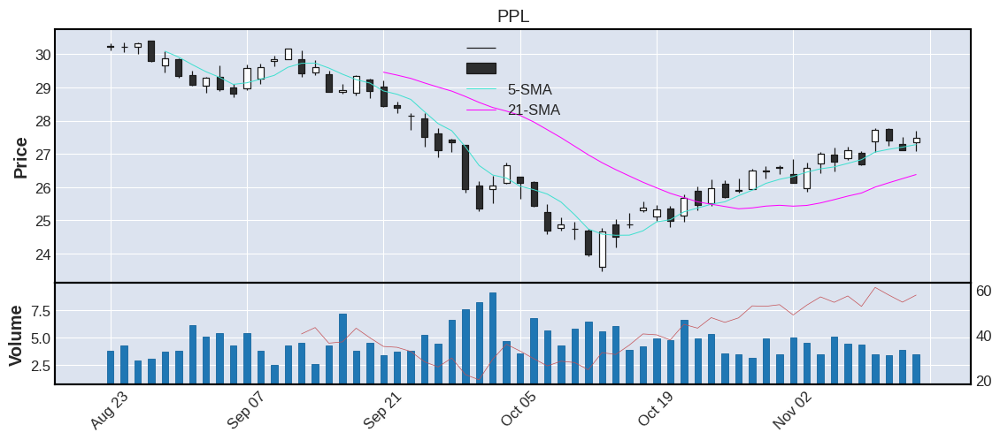



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
10    OKE  65.25  69.26  2.25    2.59  1.35  1.64  2.51  Utilities  0.0  United States    large


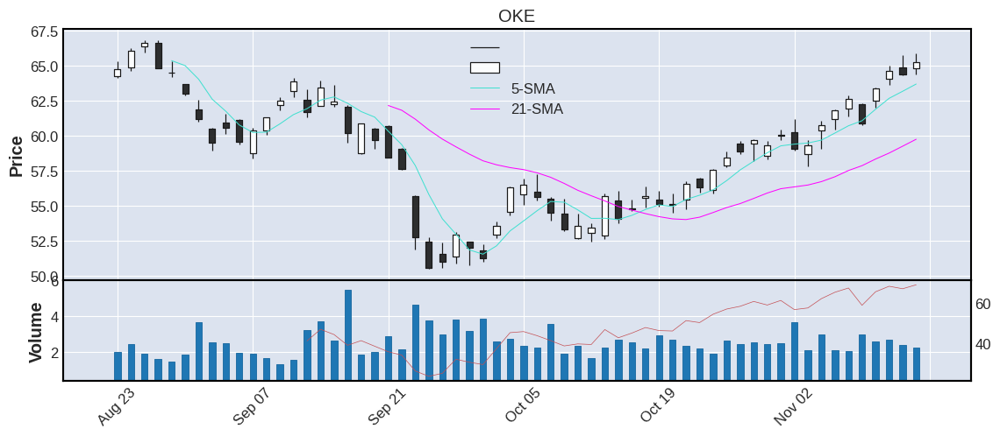



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
11     ES  78.65  54.47  1.38    1.53  1.26  2.02  2.57  Utilities  0.0  United States    large


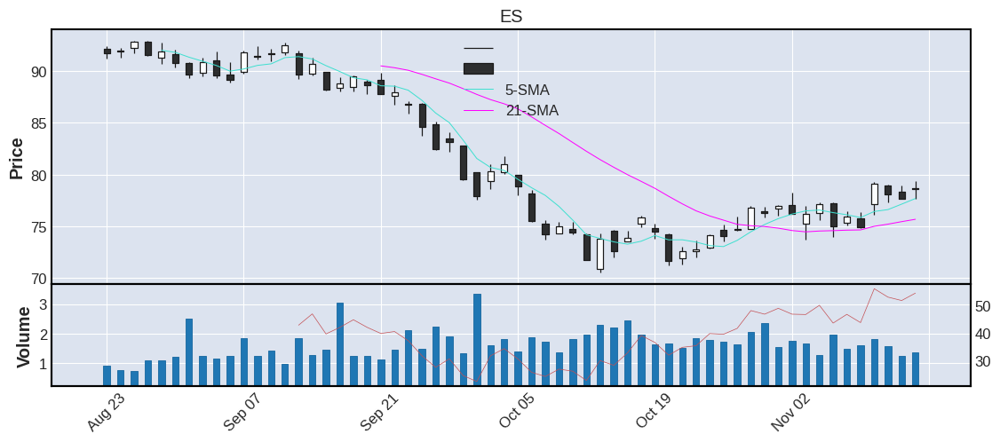



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
12    DTE  114.48  53.77  1.26    1.54  1.26  2.74  2.39  Utilities  0.0  United States    large


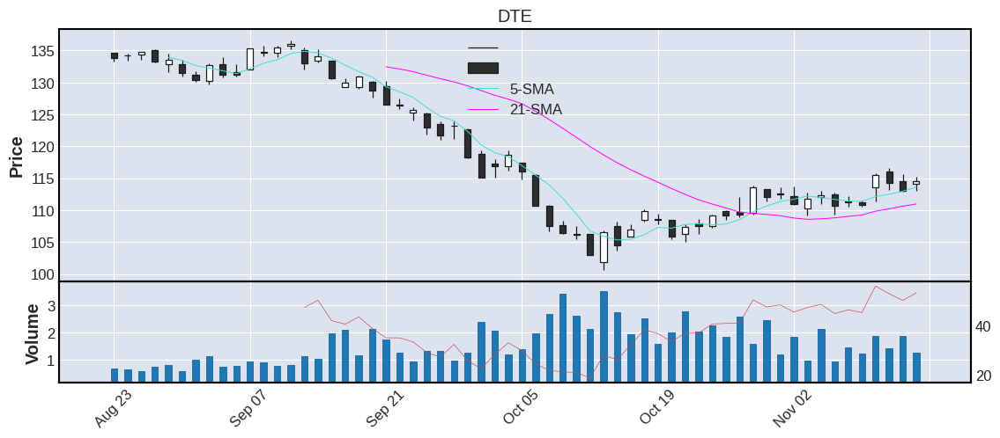



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
13    EIX  60.67  55.86  2.22    1.71  1.25  1.55  2.55  Utilities  0.0  United States    large


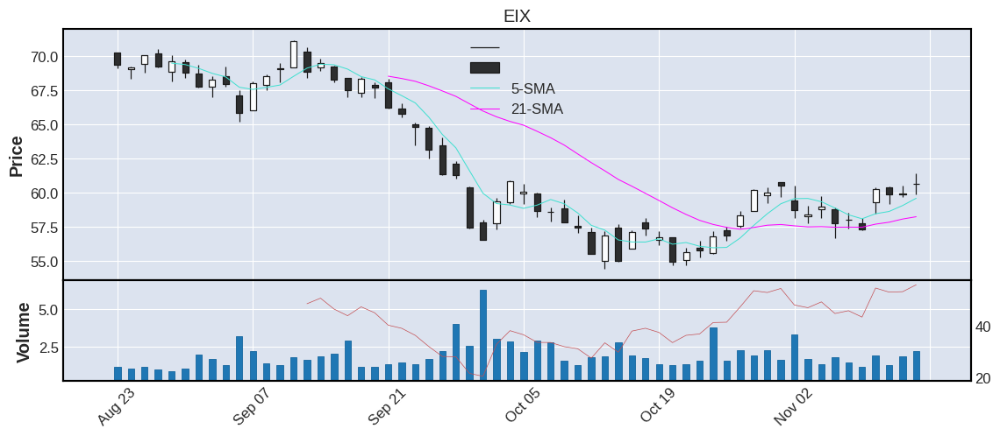



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
14    AEE  83.42  54.59  0.82    1.52  1.14  1.98  2.37  Utilities  0.0  United States    large


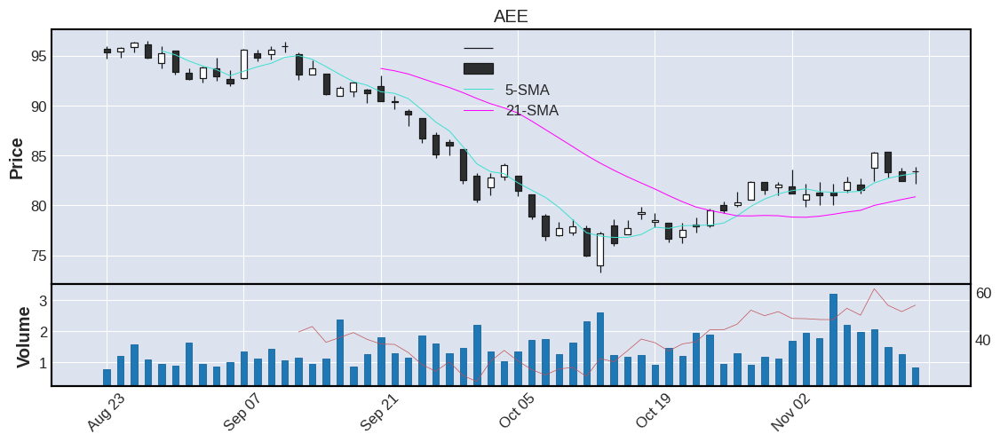



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
15    CMS  58.44  53.19  1.4    1.65  1.05  1.41  2.41  Utilities  0.0  United States    large


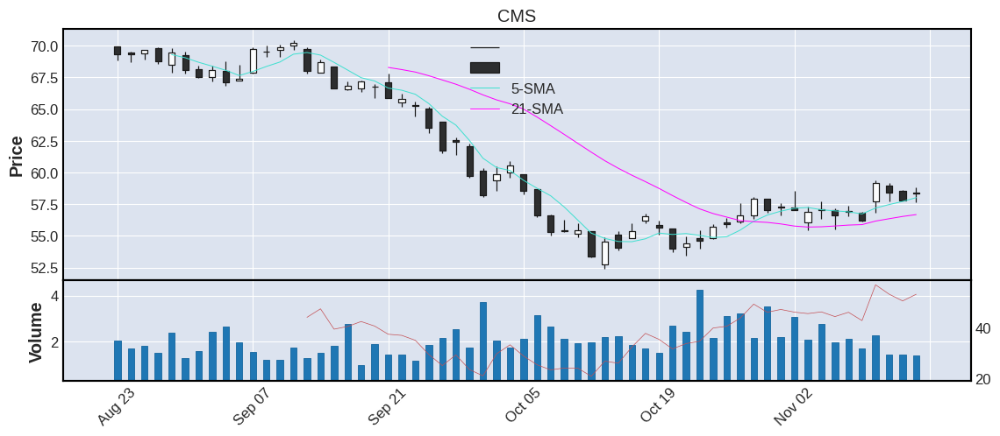



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
16    ATO  111.58  61.83  0.86    1.04  0.95  2.71  2.43  Utilities  0.0  United States    large


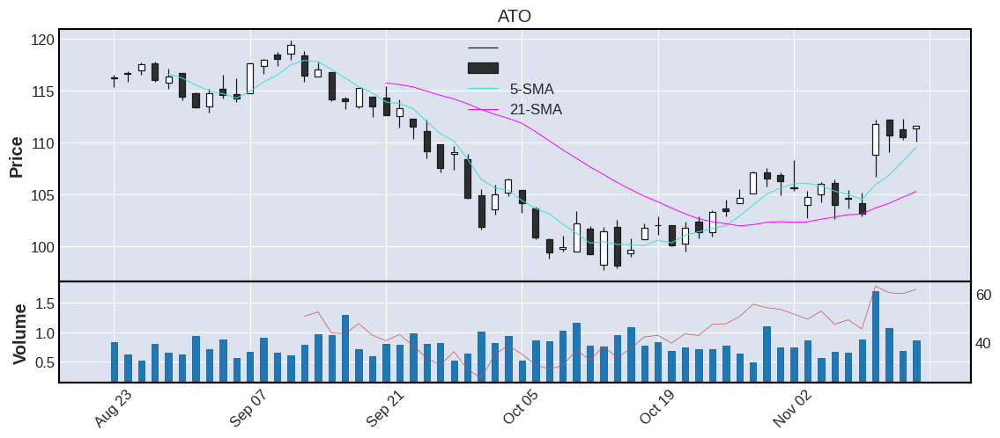



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
17    AES  27.78  63.36  3.84    4.45  0.91  0.82  2.95  Utilities  0.0  United States    large


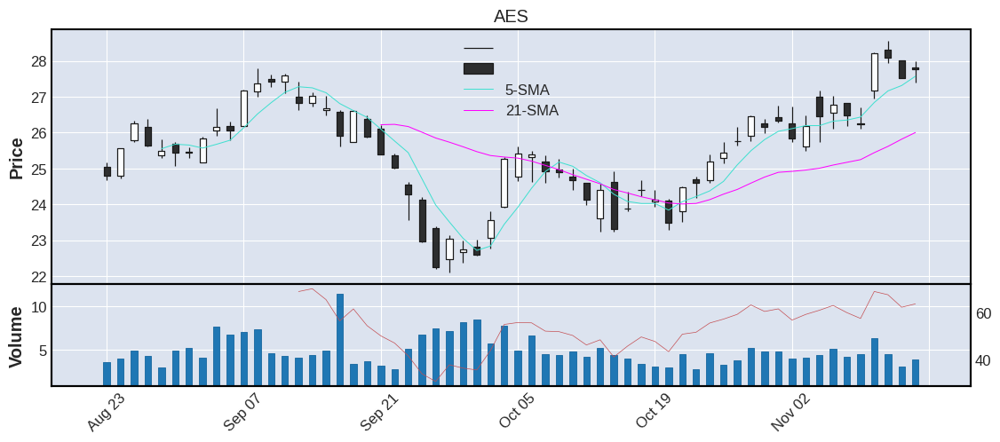



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
18    ETR  109.53  55.2  0.83    1.05  0.89  2.64  2.41  Utilities  0.0  United States    large


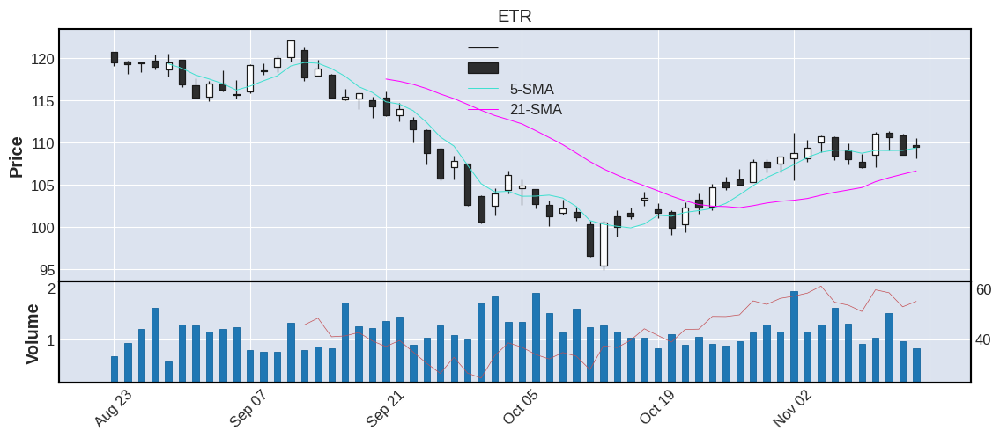



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR     IPO        COUNTRY CATEGORY
19    AWK  146.02  59.83  0.71    0.91  0.88  4.02  2.75  Utilities  2008.0  United States    large


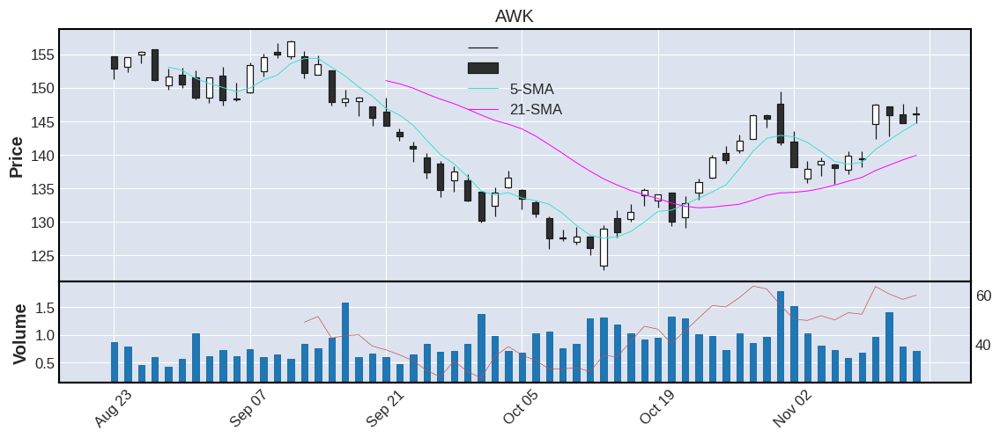



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
20    XEL  67.39  57.23  4.47    4.38  0.84  1.64  2.43  Utilities  0.0  United States    large


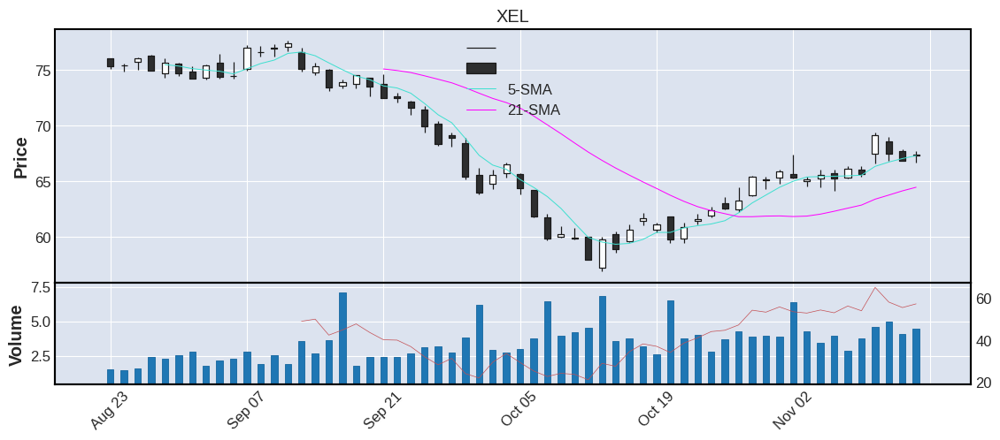



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
21    WEC  93.26  56.24  1.24    1.58  0.79  2.04  2.19  Utilities  0.0  United States    large


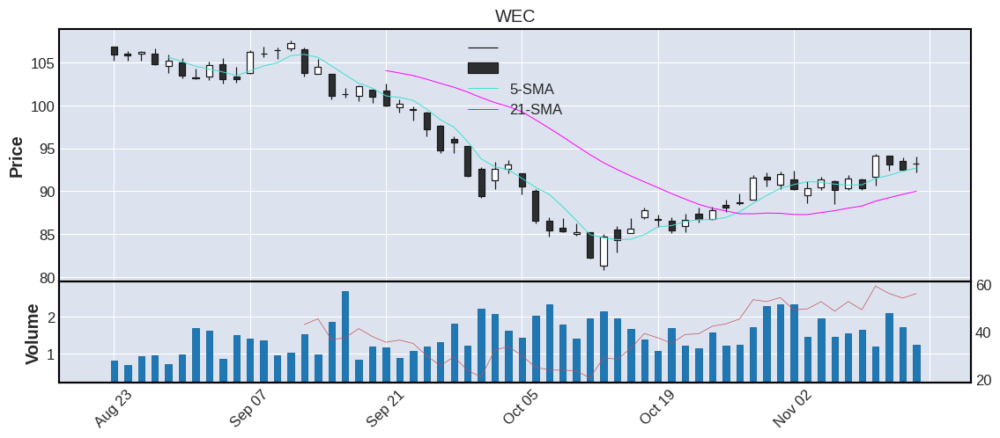



   TICKER     CP    RSI    VOL  AVGVOL %CHG   ATR  %ATR     SECTOR     IPO        COUNTRY CATEGORY
22    KMI  18.66  59.08  14.47   16.29  0.7  0.49  2.63  Utilities  2011.0  United States    large


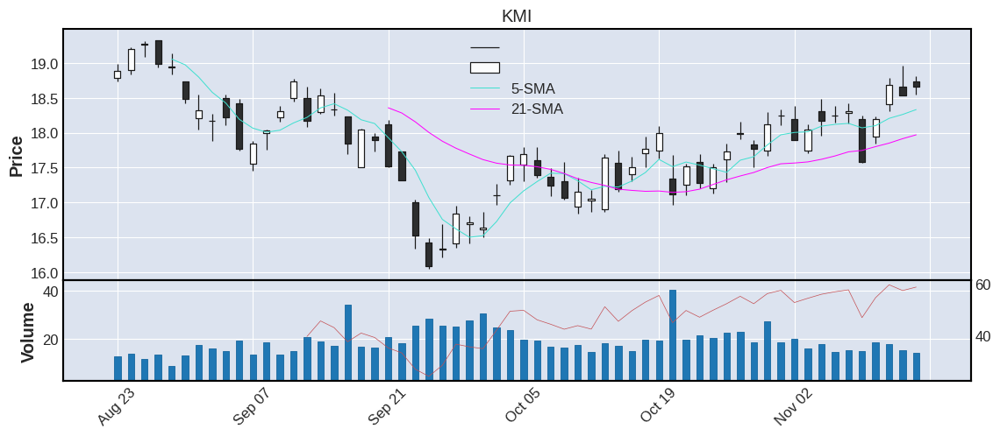



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
23    AEP  89.22  50.66  4.43     3.7  0.63  2.34  2.62  Utilities  0.0  United States    large


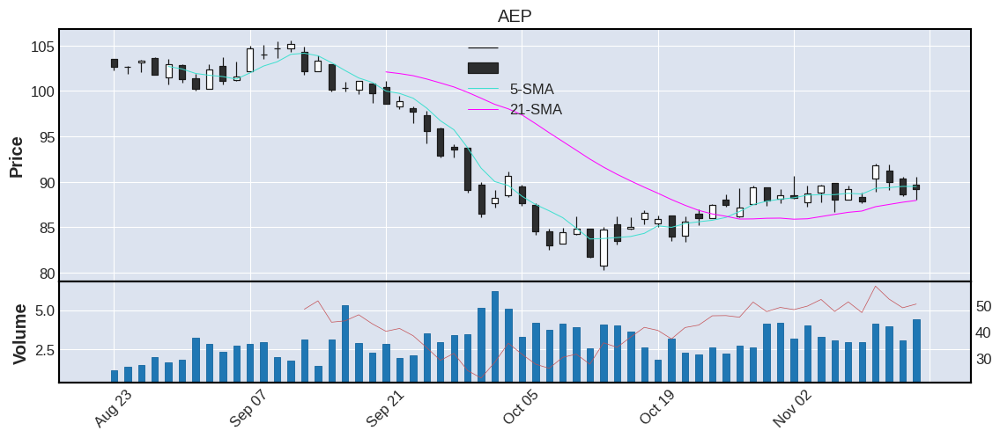



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
24    LNT  53.63  53.03  1.17    1.88  0.58  1.43  2.67  Utilities  0.0  United States    large


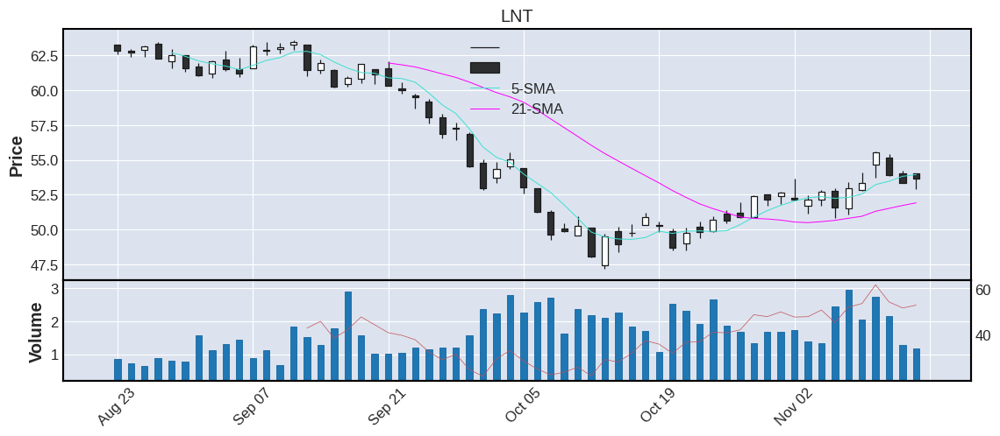



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
25    EXC  38.24  49.93  6.76    8.28  0.47  1.11   2.9  Utilities  0.0  United States    large


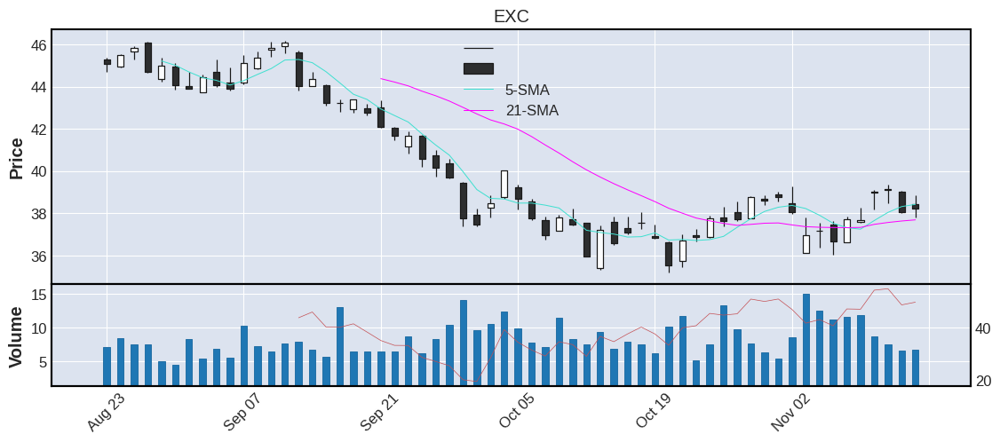



   TICKER    CP   RSI  VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
26     ED  89.7  55.2  2.2    1.99  0.41  2.01  2.24  Utilities  0.0  United States    large


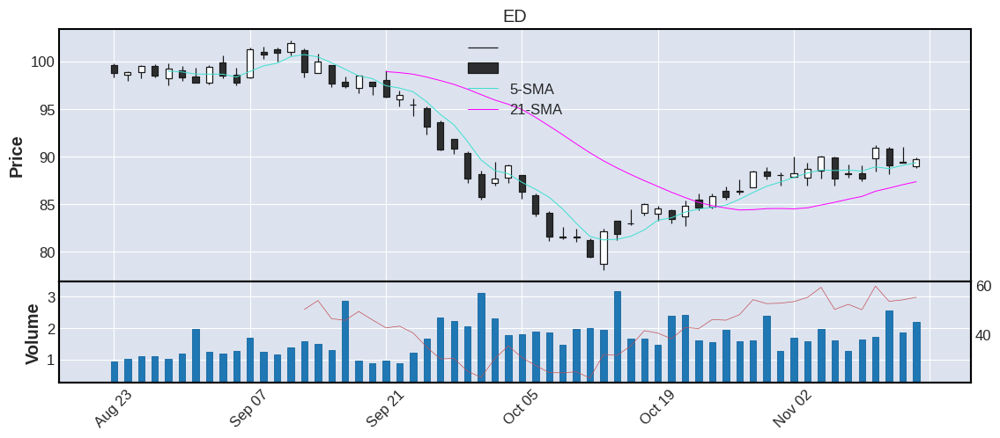



   TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
27    WMB  33.9  61.07  4.47    6.08  0.38  0.78   2.3  Utilities  0.0  United States    large


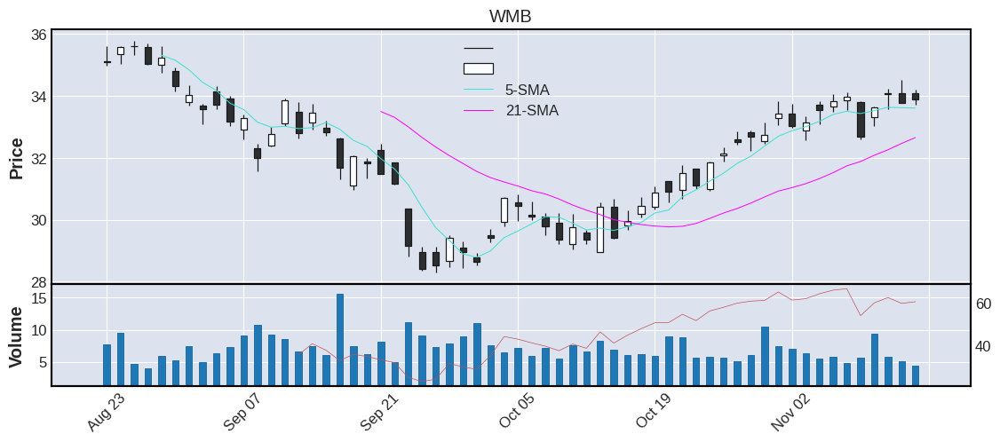



   TICKER     CP    RSI  VOL  AVGVOL %CHG  ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
28    CNP  29.13  57.35  2.6    4.18  0.0  0.7   2.4  Utilities  0.0  United States    large


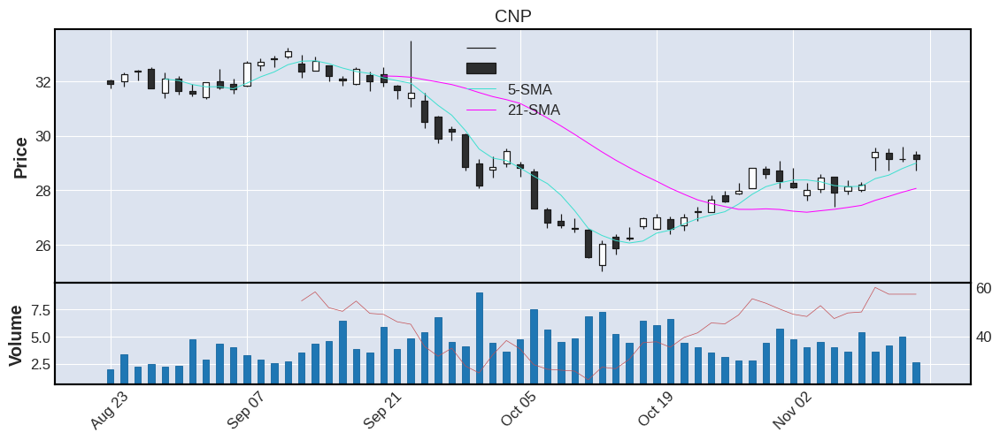



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
29    SRE  155.43  56.04  1.05     1.2 -0.12  3.71  2.39  Utilities  0.0  United States    large


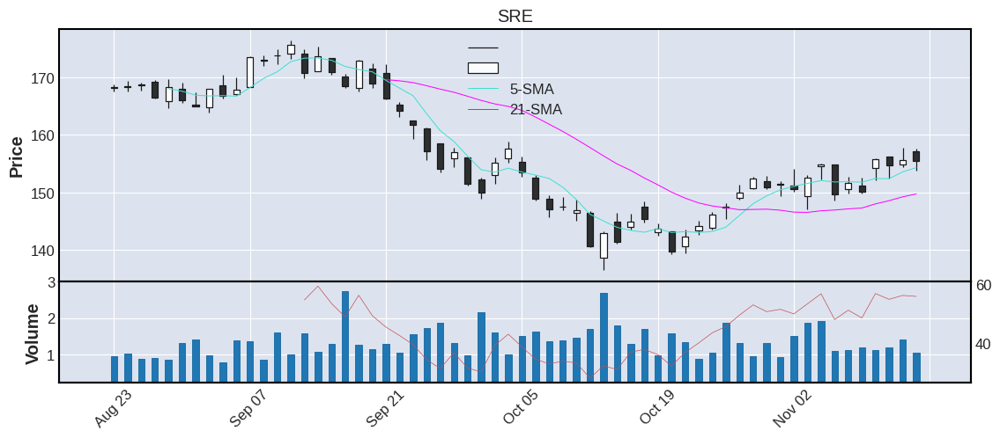



   TICKER     CP   RSI    VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
30    PCG  14.44  48.3  31.39   20.23 -0.14  0.43  2.98  Utilities  0.0  United States    large


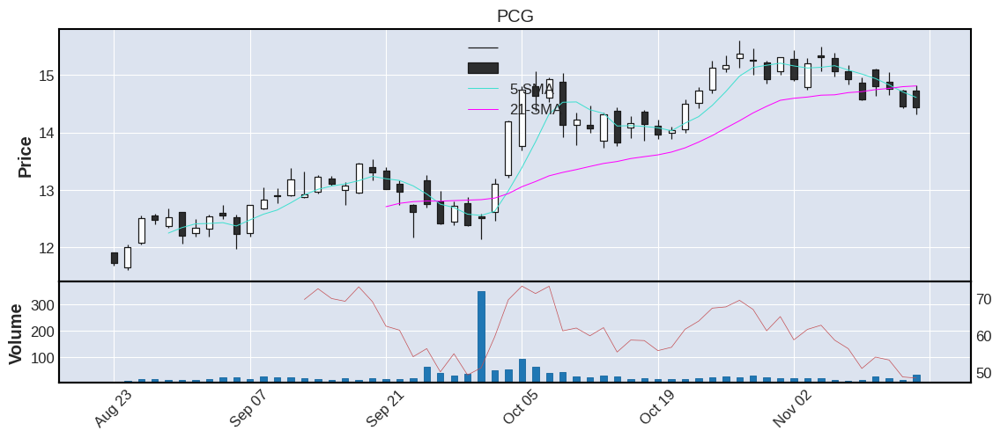



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
31     NI  25.68  50.15  4.74    5.44 -0.31  0.74  2.88  Utilities  0.0  United States    large


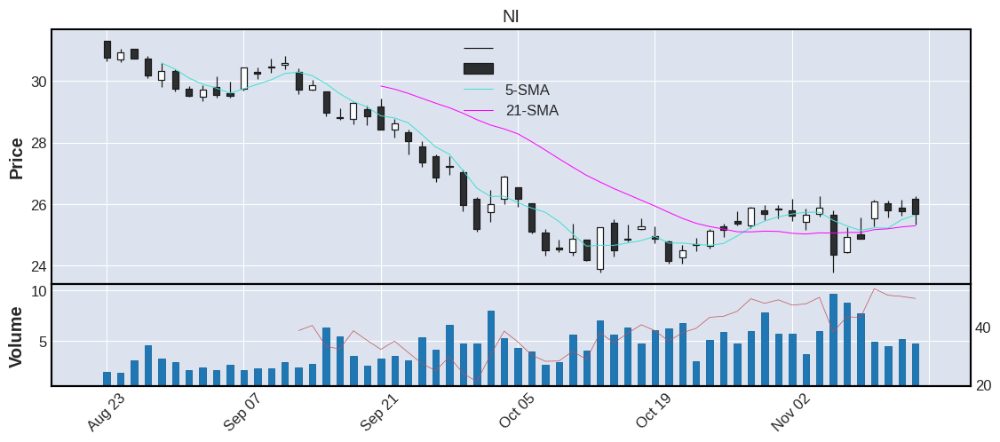



   TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
32     WM  157.09  45.33  2.0    1.86 -0.32  4.04  2.57  Utilities  0.0  United States    large


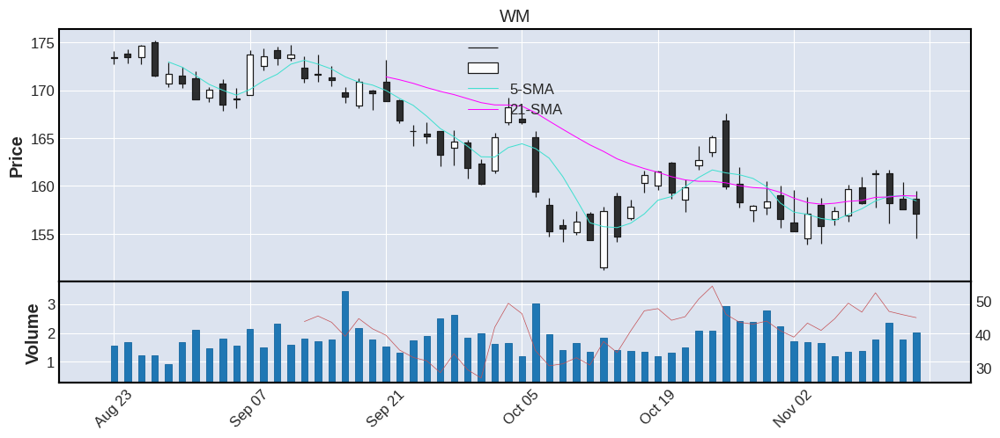



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
33    PEG  57.11  48.51  3.62    5.12 -0.44  1.61  2.82  Utilities  0.0  United States    large


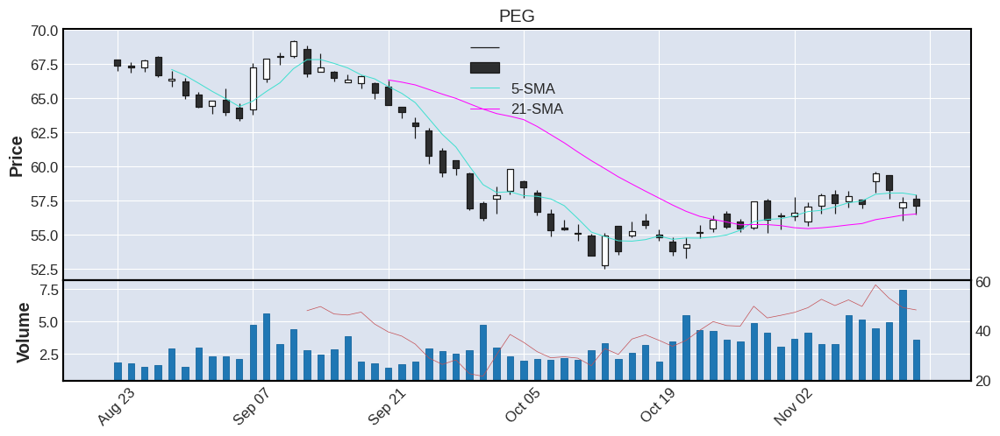



   TICKER    CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
34    CEG  93.5  56.63  2.3    2.91 -0.45  3.45  3.69  Utilities  0.0  United States    large


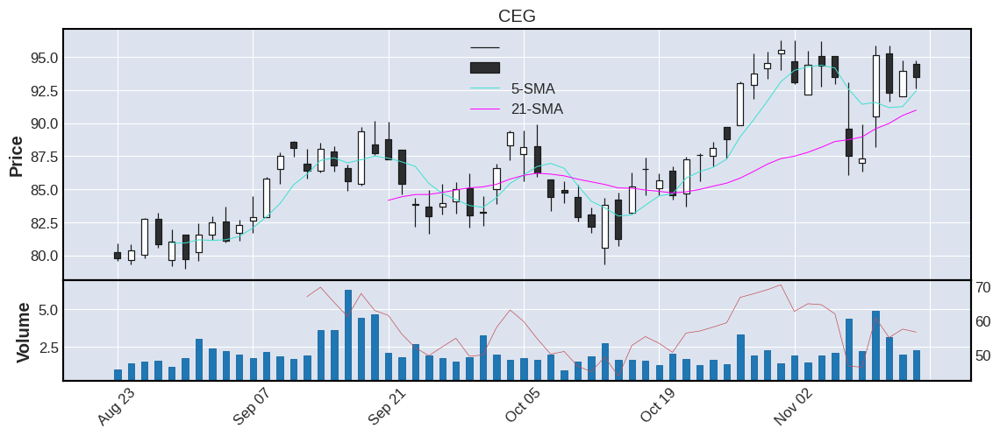



   TICKER     CP   RSI  VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
35    NRG  43.46  50.8  2.9    3.22 -0.89  1.46  3.36  Utilities  0.0  United States    large


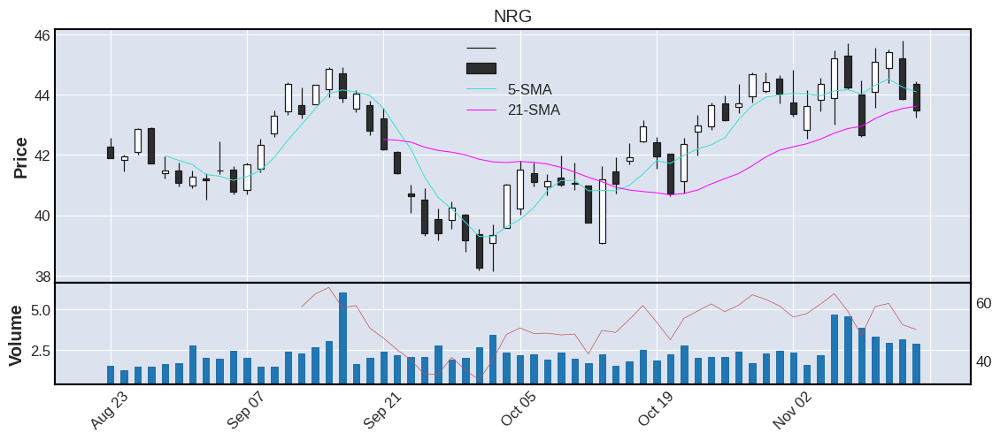



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR     IPO        COUNTRY CATEGORY
36    RSG  128.82  40.35  1.73    1.55 -0.89  3.37  2.62  Utilities  1998.0  United States    large


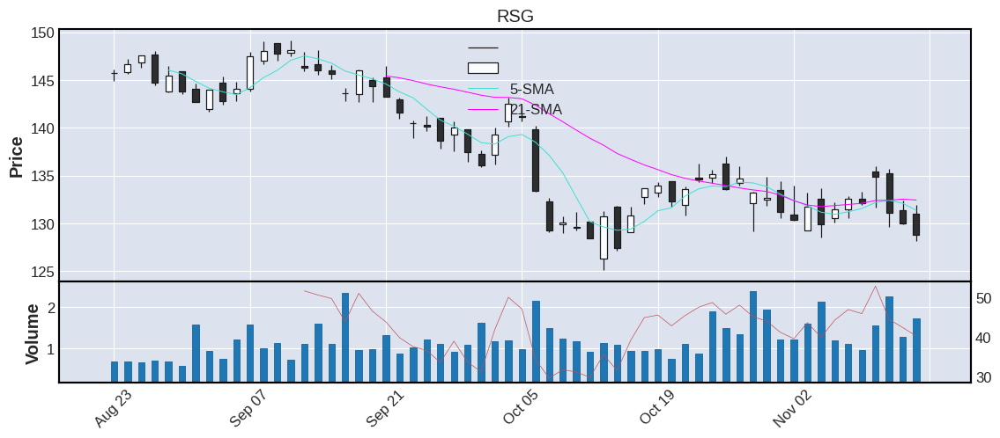



================================================== SECTOR 10: REAL_ESTATE [ %CHG ] ================================================== 

    TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
1     DLR  111.87  64.47  2.04    2.21  4.14   3.84  3.43  Real_Estate  2004.0  United States    large
2    EQIX  657.23  67.15  0.46    0.55  2.86  22.22  3.38  Real_Estate  2000.0  United States    large
3     HST   18.56  58.42  6.25    6.89   2.6   0.67  3.61  Real_Estate     0.0  United States    large
4     CPT  114.63  49.99  0.95    0.77  2.47   3.43  2.99  Real_Estate  1993.0  United States    large
5     IRM   52.58  61.35  1.07    1.33   2.4   1.65  3.14  Real_Estate     0.0  United States    large
6     LEN   87.75  64.53  1.42    2.66  2.34   3.49  3.98  Real_Estate     0.0  United States    large
7     SPG  120.16  69.41  1.69    1.99  2.24   3.45  2.87  Real_Estate     0.0  United States    large
8     FRT  107.74  65.66  0.70    0.6

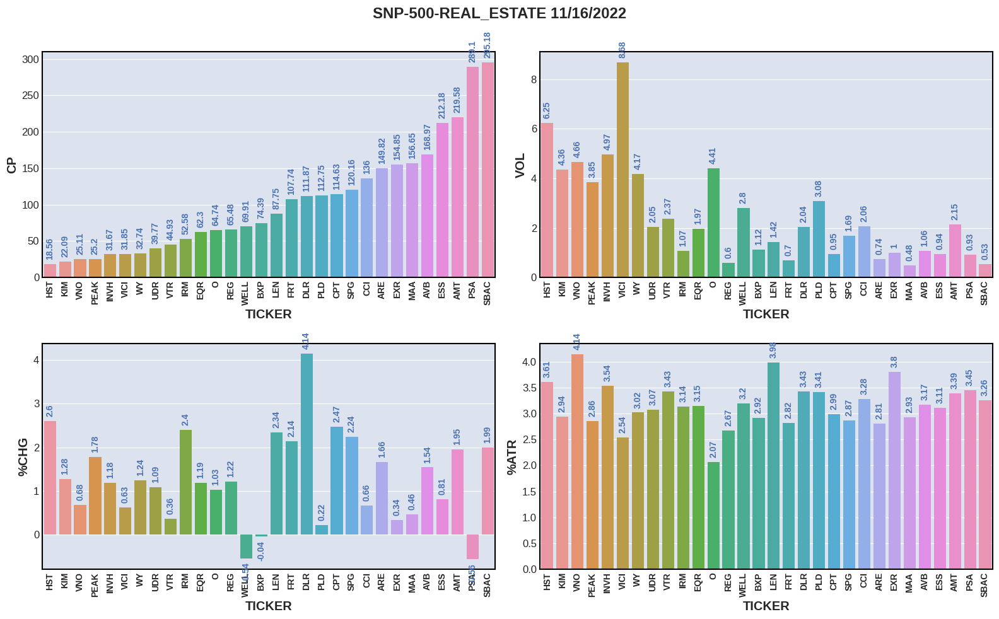

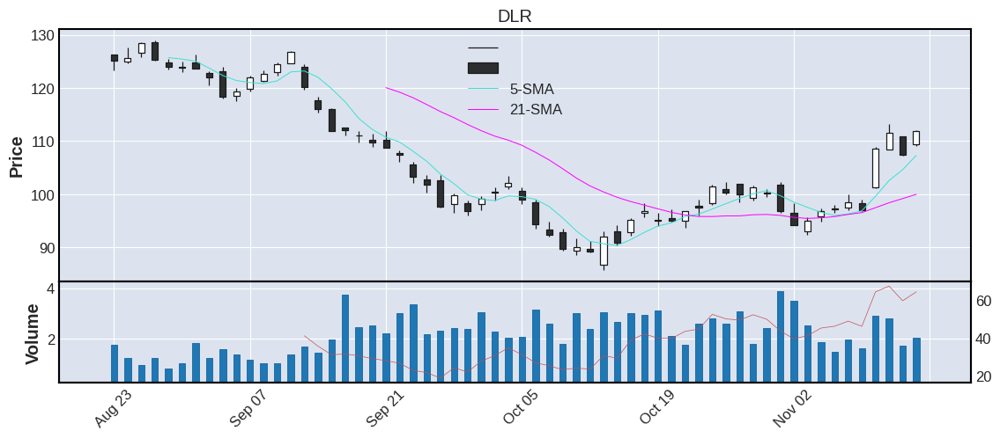



  TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
2   EQIX  657.23  67.15  0.46    0.55  2.86  22.22  3.38  Real_Estate  2000.0  United States    large


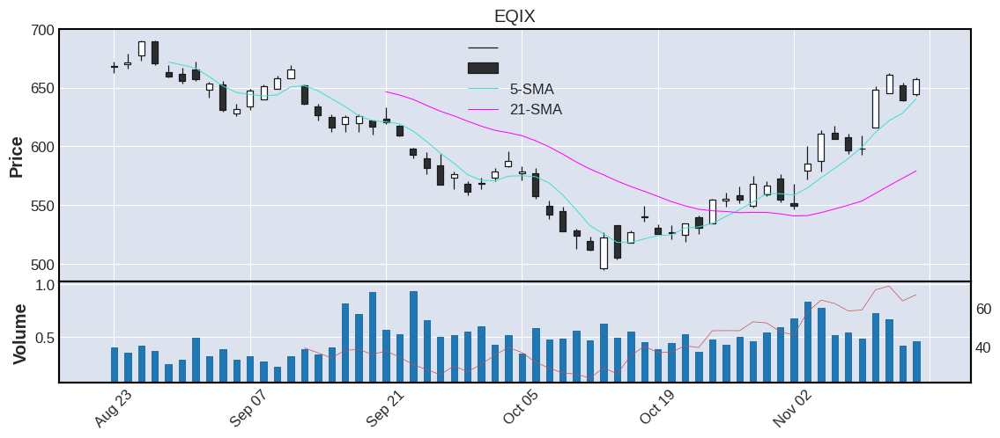



  TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
3    HST  18.56  58.42  6.25    6.89  2.6  0.67  3.61  Real_Estate  0.0  United States    large


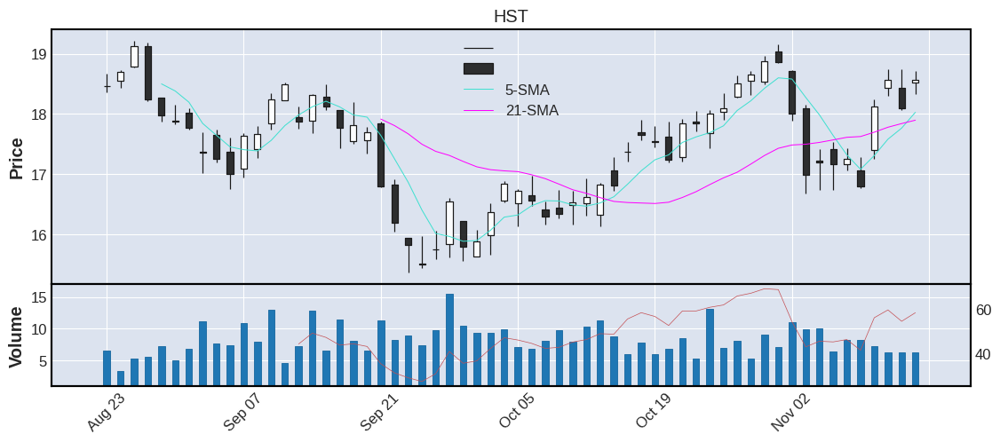



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
4    CPT  114.63  49.99  0.95    0.77  2.47  3.43  2.99  Real_Estate  1993.0  United States    large


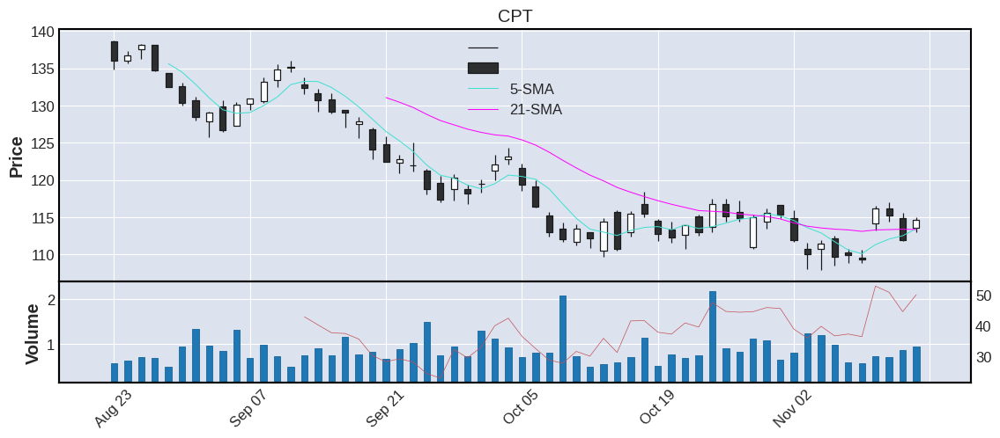



  TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
5    IRM  52.58  61.35  1.07    1.33  2.4  1.65  3.14  Real_Estate  0.0  United States    large


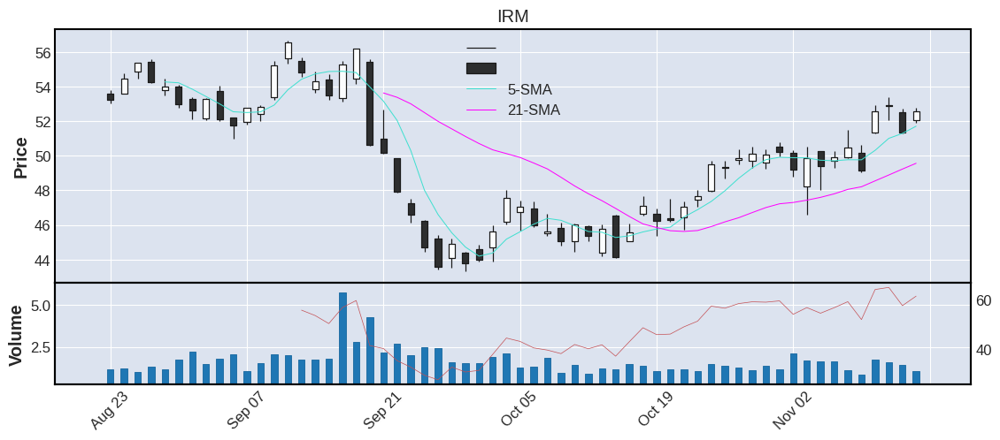



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
6    LEN  87.75  64.53  1.42    2.66  2.34  3.49  3.98  Real_Estate  0.0  United States    large


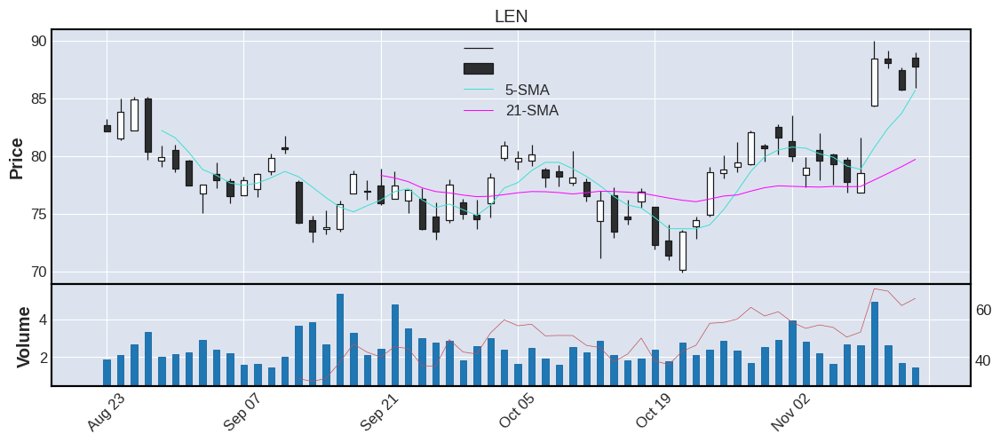



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
7    SPG  120.16  69.41  1.69    1.99  2.24  3.45  2.87  Real_Estate  0.0  United States    large


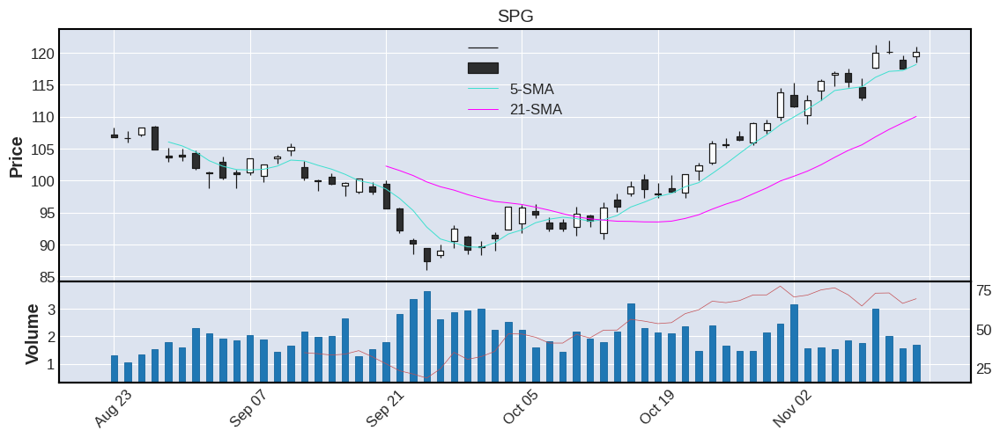



  TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
8    FRT  107.74  65.66  0.7    0.62  2.14  3.04  2.82  Real_Estate  0.0  United States   medium


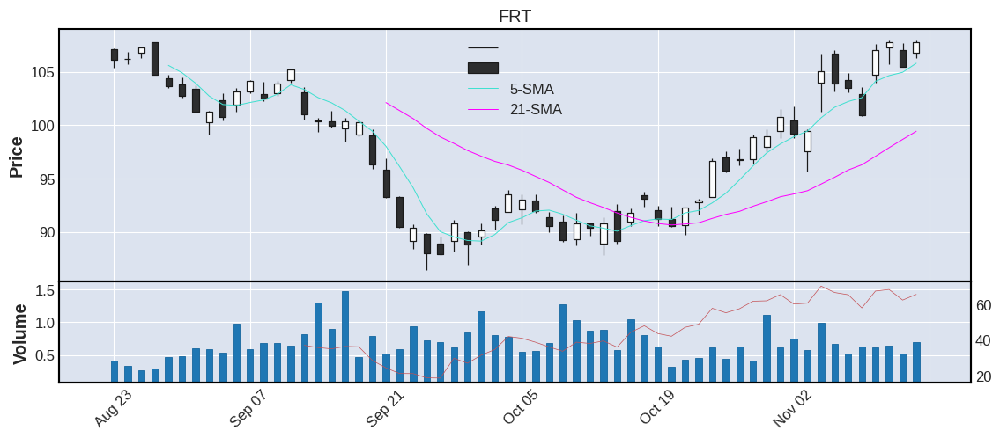



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
9   SBAC  295.18  62.09  0.53    0.81  1.99  9.62  3.26  Real_Estate  1999.0  United States    large


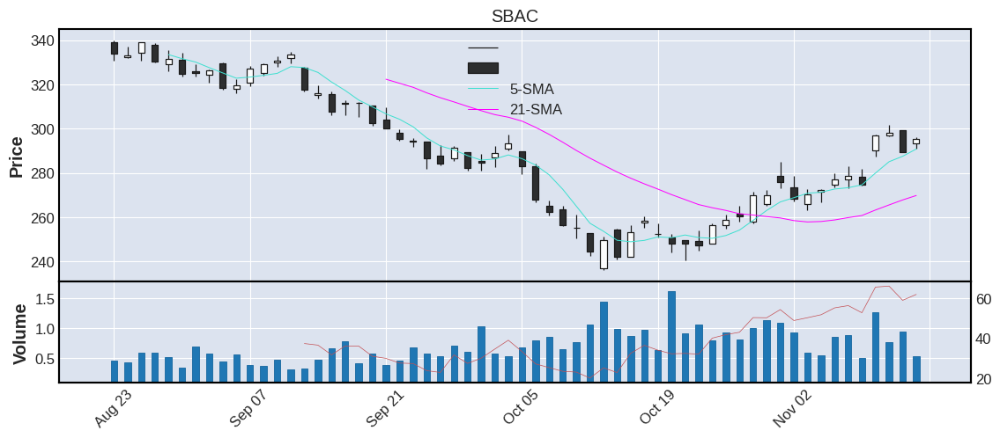



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
10    AMT  219.58  59.28  2.15     2.0  1.95  7.45  3.39  Real_Estate  0.0  United States    large


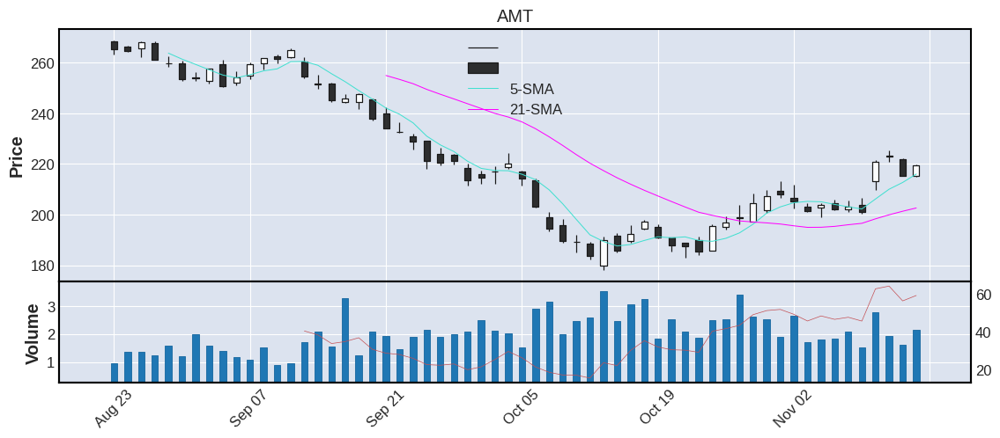



   TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
11   PEAK  25.2  62.32  3.85     4.1  1.78  0.72  2.86  Real_Estate  0.0  United States    large


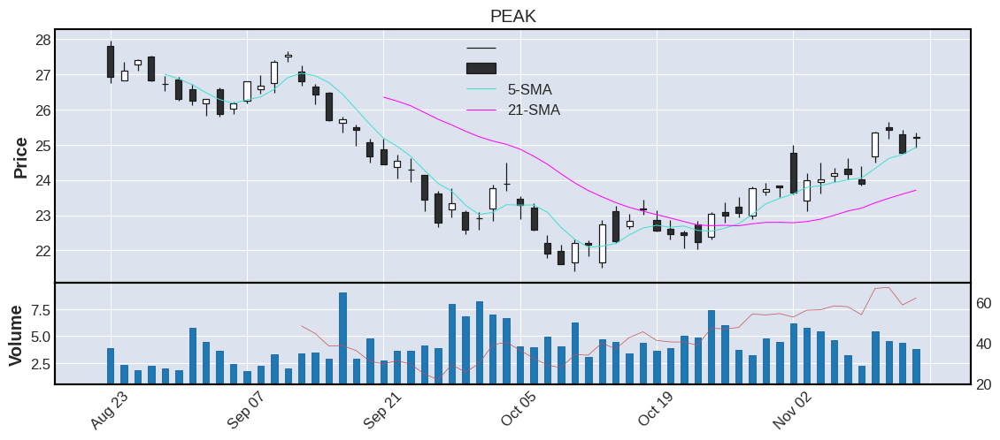



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
12    ARE  149.82  58.29  0.74    0.67  1.66  4.21  2.81  Real_Estate  0.0  United States    large


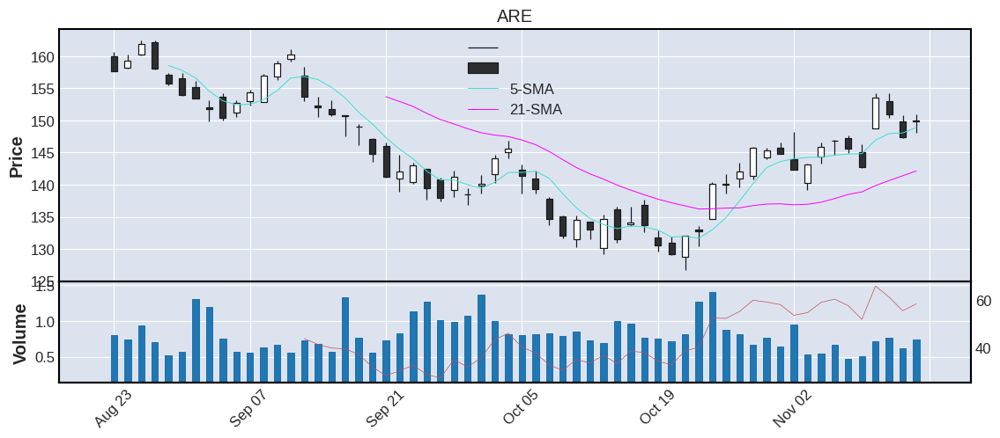



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
13    AVB  168.97  45.88  1.06    1.13  1.54  5.36  3.17  Real_Estate  0.0  United States    large


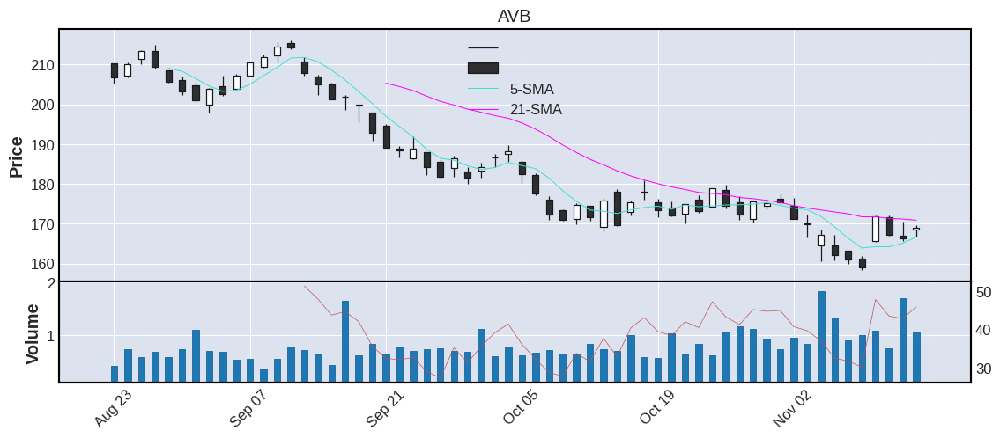



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
14    KIM  22.09  62.47  4.36     4.5  1.28  0.65  2.94  Real_Estate  0.0  United States    large


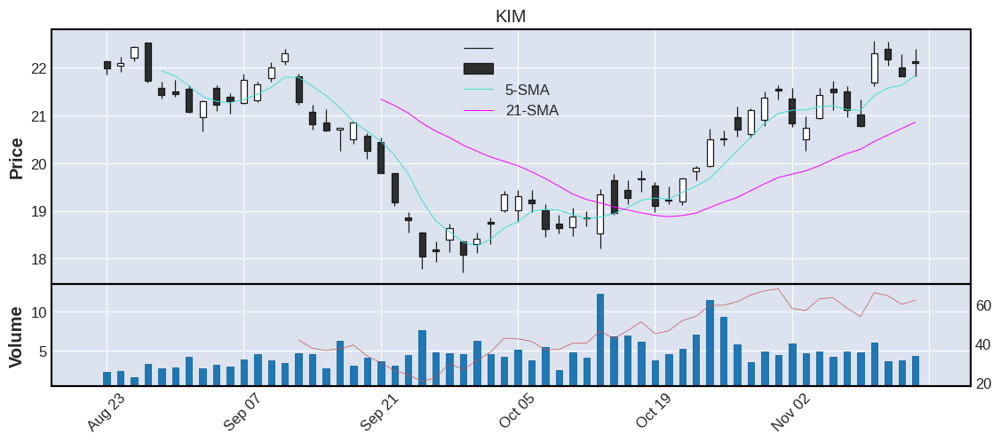



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
15     WY  32.74  61.24  4.17    3.54  1.24  0.99  3.02  Real_Estate  0.0  United States    large


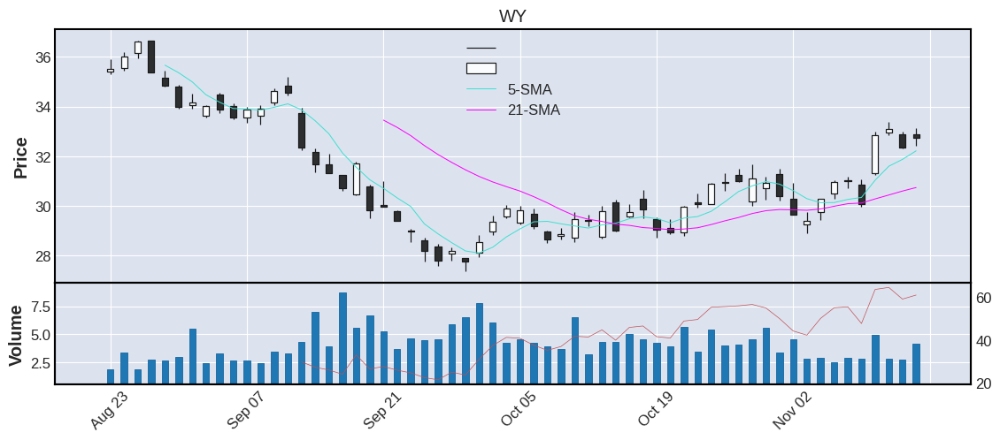



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
16    REG  65.48  66.57  0.6     0.8  1.22  1.75  2.67  Real_Estate  1993.0  United States    large


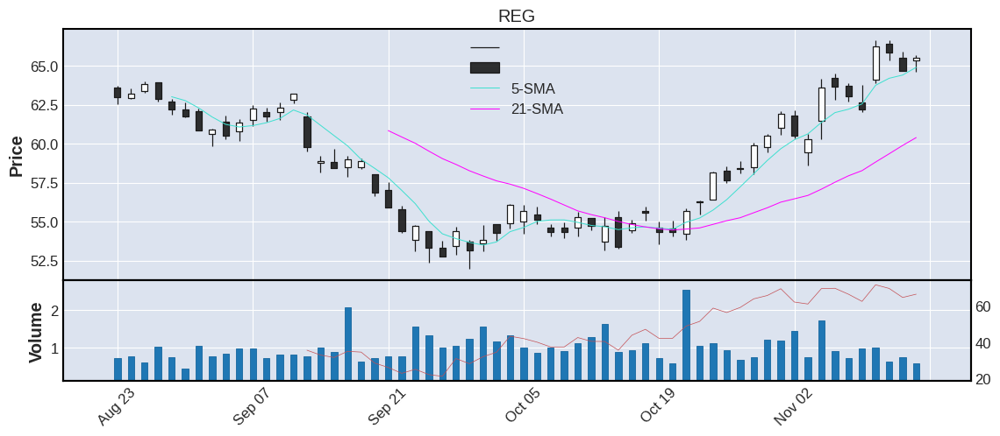



   TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
17    EQR  62.3  46.37  1.97    2.07  1.19  1.96  3.15  Real_Estate  0.0  United States    large


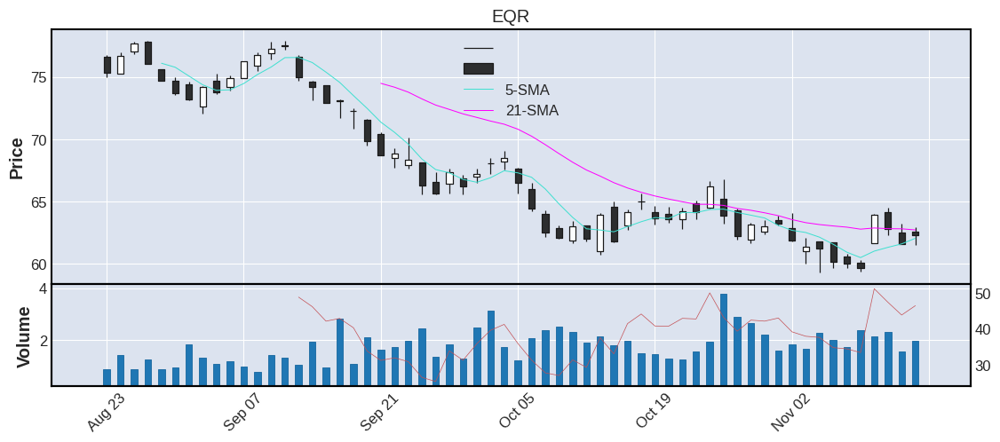



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
18   INVH  31.67  47.14  4.97    4.11  1.18  1.12  3.54  Real_Estate  2017.0  United States    large


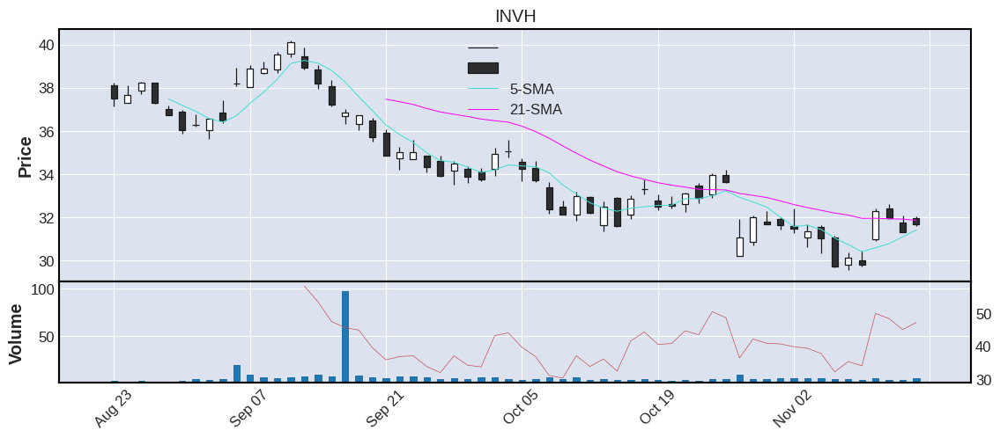



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
19    UDR  39.77  50.76  2.05    2.58  1.09  1.22  3.07  Real_Estate  0.0  United States    large


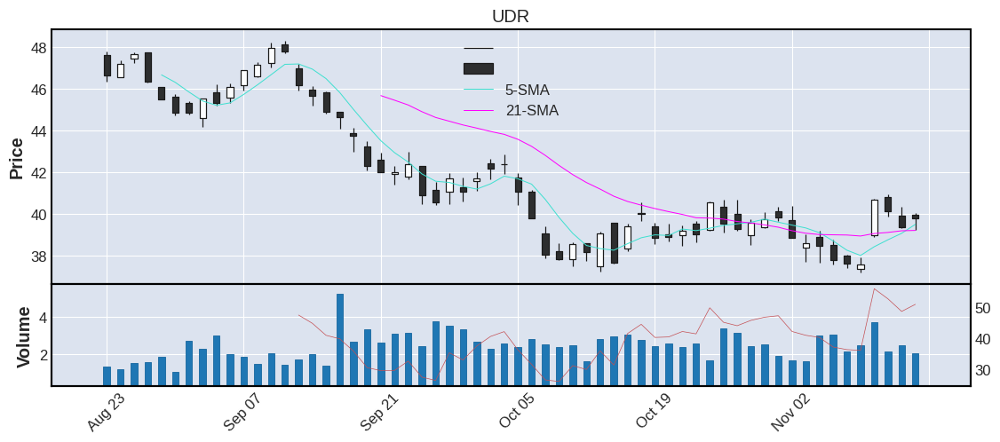



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
20      O  64.74  63.05  4.41    3.91  1.03  1.34  2.07  Real_Estate  0.0  United States    large


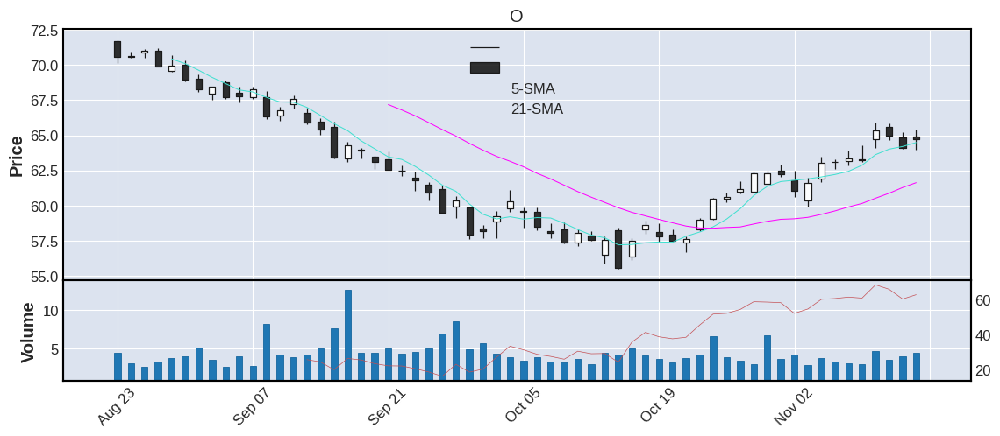



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
21    ESS  212.18  39.45  0.94    0.92  0.81  6.59  3.11  Real_Estate  1994.0  United States    large


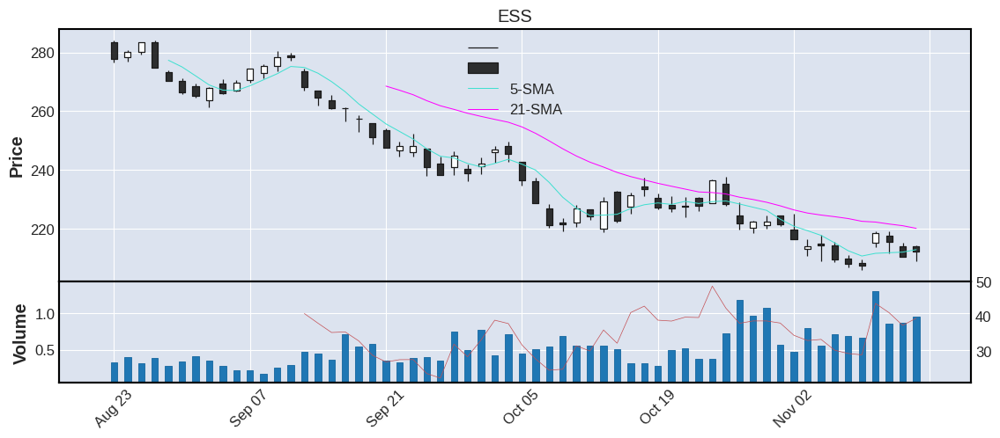



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
22    VNO  25.11  59.49  4.66    3.86  0.68  1.04  4.14  Real_Estate  0.0  United States   medium


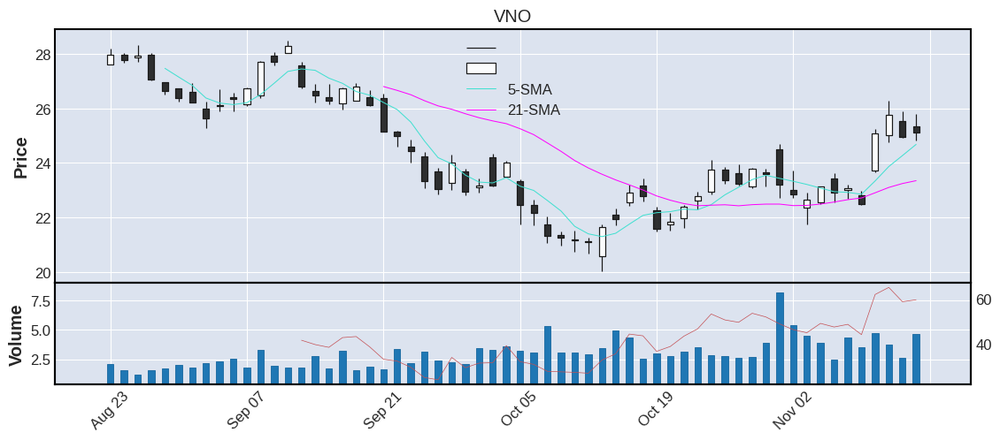



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
23    CCI  136.0  51.41  2.06    2.33  0.66  4.46  3.28  Real_Estate  0.0  United States    large


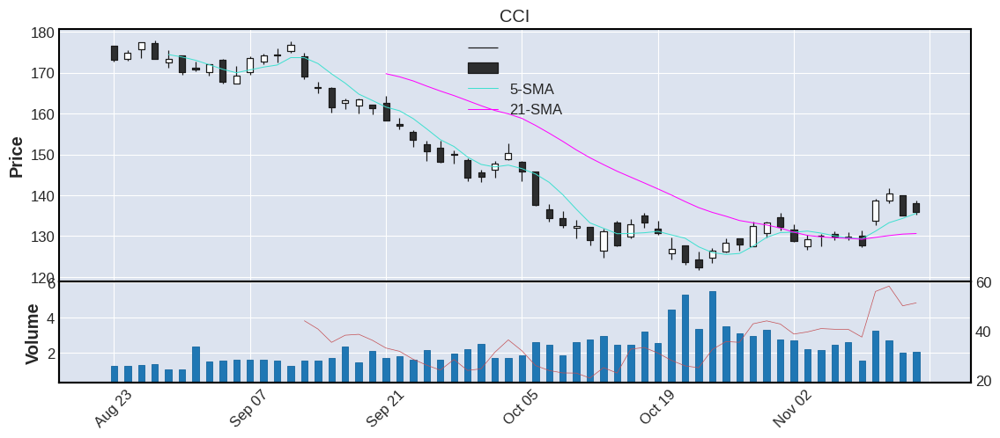



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO COUNTRY CATEGORY
24   VICI  31.85  52.71  8.68    7.18  0.63  0.81  2.54  Real_Estate  2018.0     N-A    large


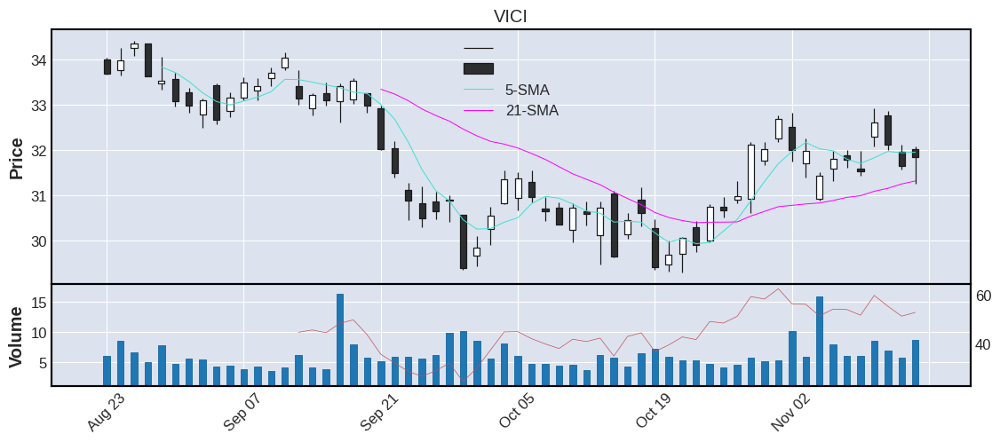



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
25    MAA  156.65  52.33  0.48    0.59  0.46  4.59  2.93  Real_Estate  1994.0  United States    large


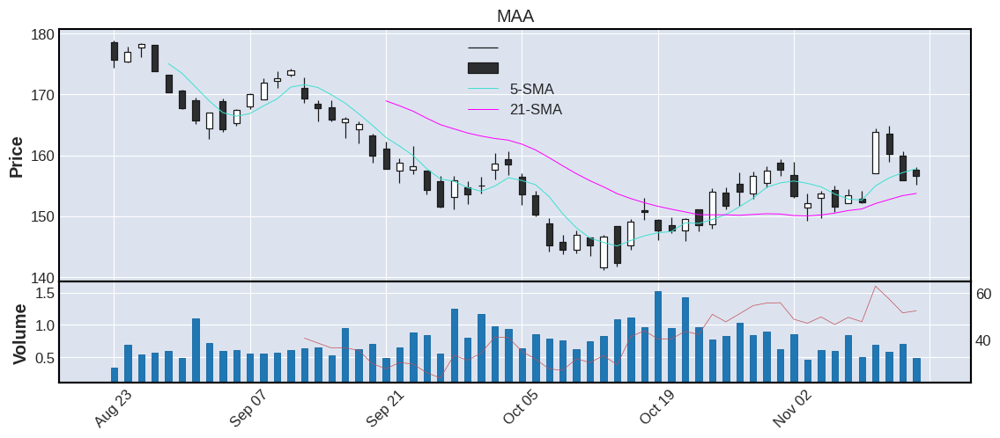



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
26    VTR  44.93  65.94  2.37    2.51  0.36  1.54  3.43  Real_Estate  0.0  United States    large


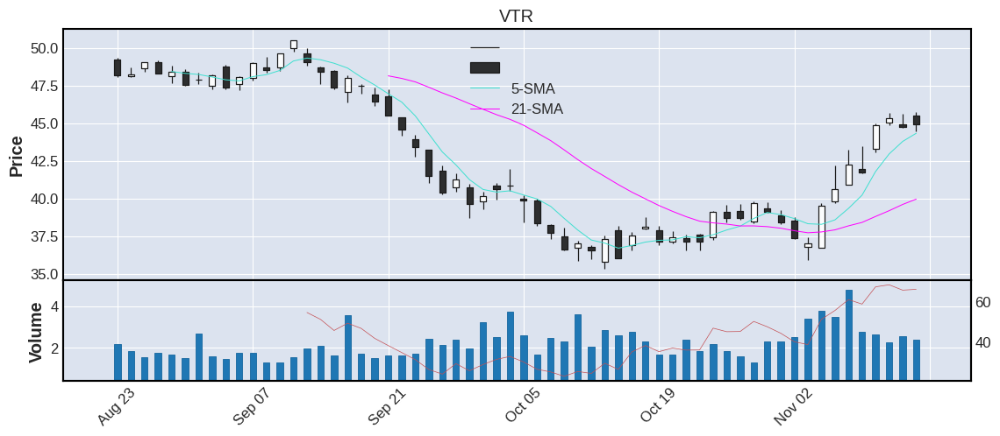



   TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
27    EXR  154.85  40.47  1.0    1.27  0.34  5.88   3.8  Real_Estate  2004.0  United States    large


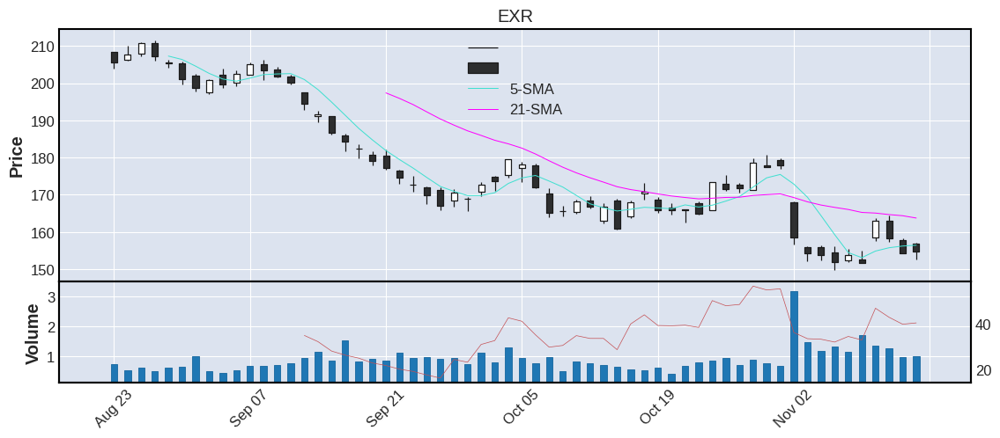



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
28    PLD  112.75  55.26  3.08    3.41  0.22  3.84  3.41  Real_Estate  0.0  United States    large


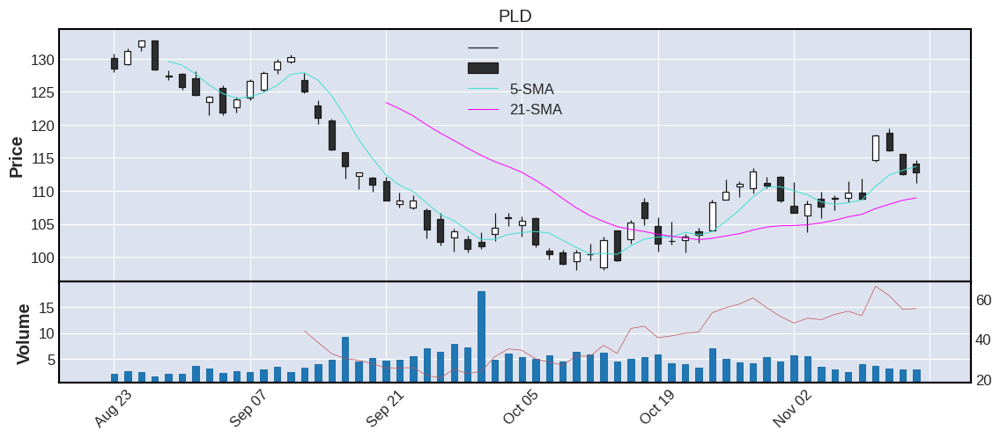



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
29    BXP  74.39  52.24  1.12    1.57 -0.04  2.17  2.92  Real_Estate  1997.0  United States    large


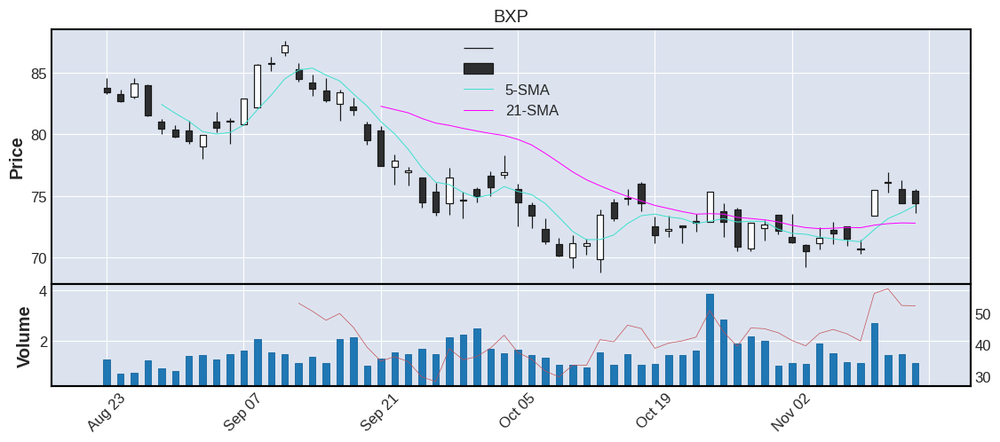



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
30   WELL  69.91  65.59  2.8    3.39 -0.54  2.24   3.2  Real_Estate  0.0  United States    large


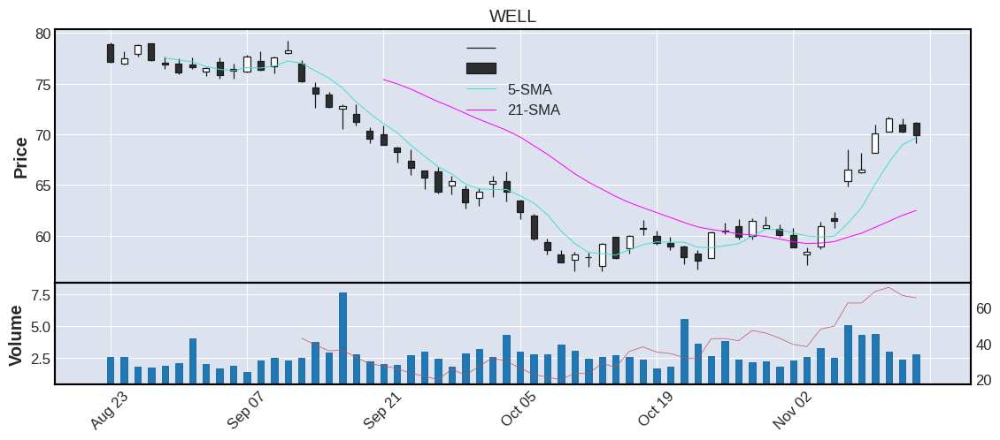



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
31    PSA  289.1  47.23  0.93    0.89 -0.56  9.96  3.45  Real_Estate  0.0  United States    large


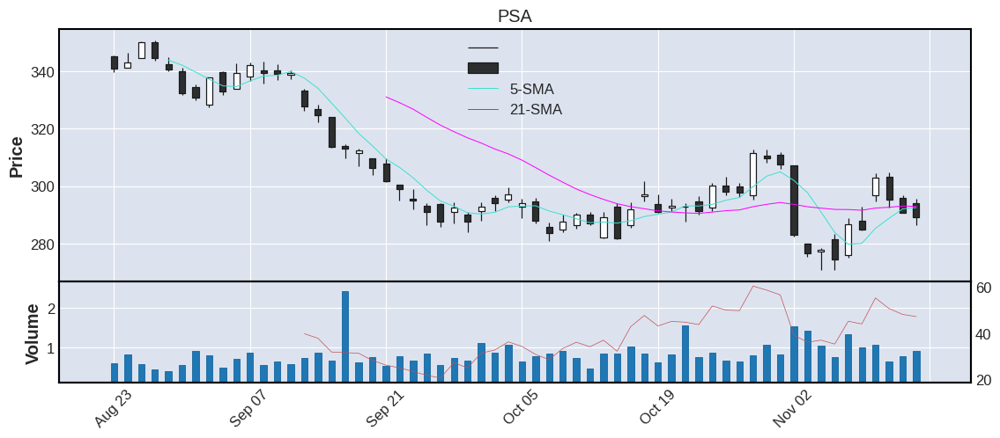



================================================== SECTOR 11: TELECOMMUNICATIONS [ %CHG ] ================================================== 

   TICKER      CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR              SECTOR     IPO        COUNTRY CATEGORY
1    HPE   15.51  73.43  14.10   13.11  1.24  0.40  2.58  Telecommunications  2015.0  United States    large
2   CSCO   44.90  57.19  19.31   22.57  0.36  1.09  2.43  Telecommunications  1990.0  United States    large
3   TMUS  145.00  51.29   6.35    6.35 -0.32  3.64  2.51  Telecommunications     0.0  United States    large
4    WBD   11.33  45.67  29.53   36.68 -1.39  0.86  7.59  Telecommunications     0.0  United States    large
5     VZ   37.70  49.51  21.24   21.57 -1.59  0.93  2.47  Telecommunications     0.0  United States    large
6   LUMN    6.08  36.56  27.55   25.52 -3.65  0.35  5.76  Telecommunications     0.0  United States   medium


  TICKER     CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR              SECTOR     IPO        

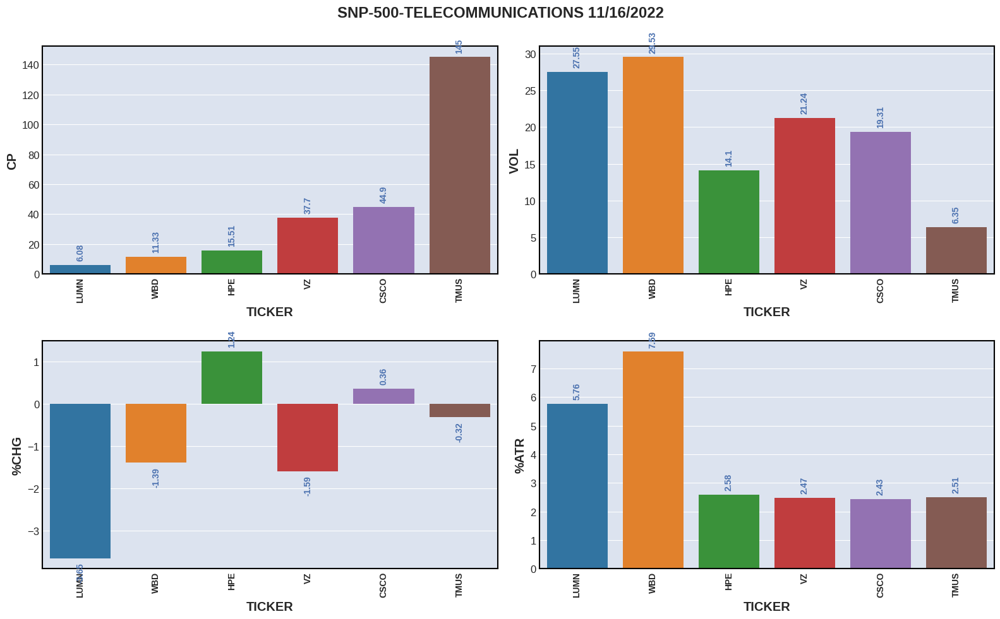

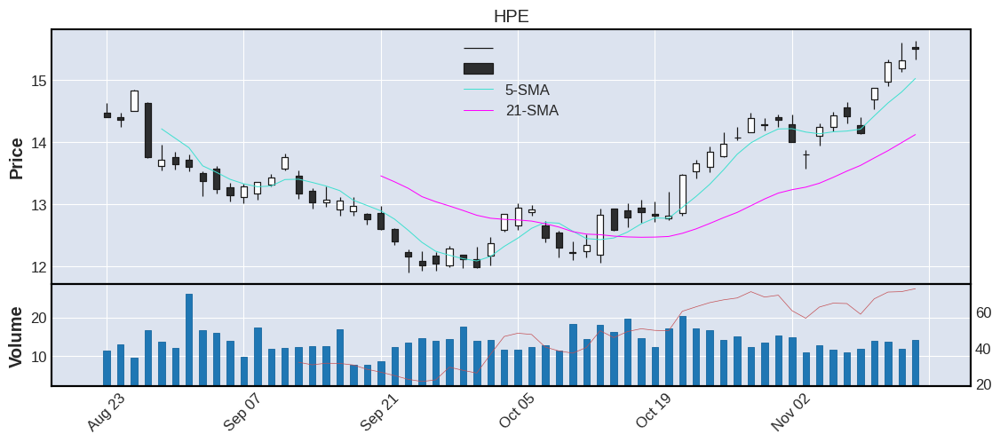



  TICKER    CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR              SECTOR     IPO        COUNTRY CATEGORY
2   CSCO  44.9  57.19  19.31   22.57  0.36  1.09  2.43  Telecommunications  1990.0  United States    large


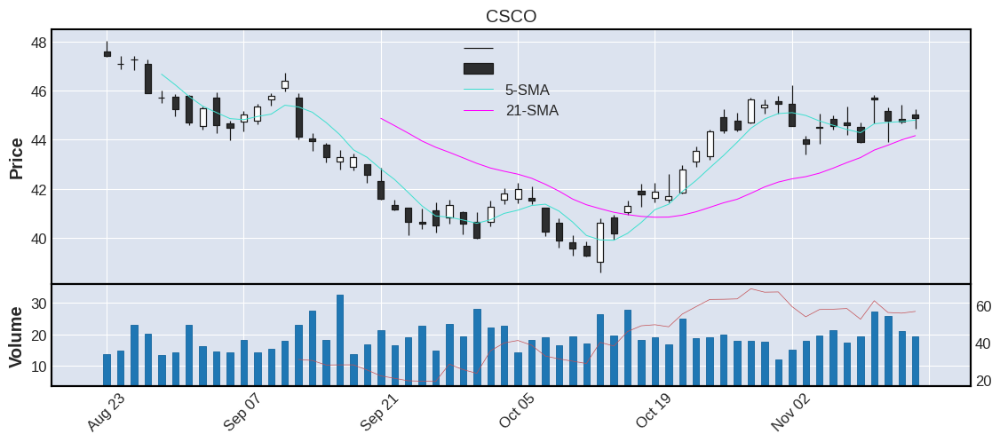



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR              SECTOR  IPO        COUNTRY CATEGORY
3   TMUS  145.0  51.29  6.35    6.35 -0.32  3.64  2.51  Telecommunications  0.0  United States    large


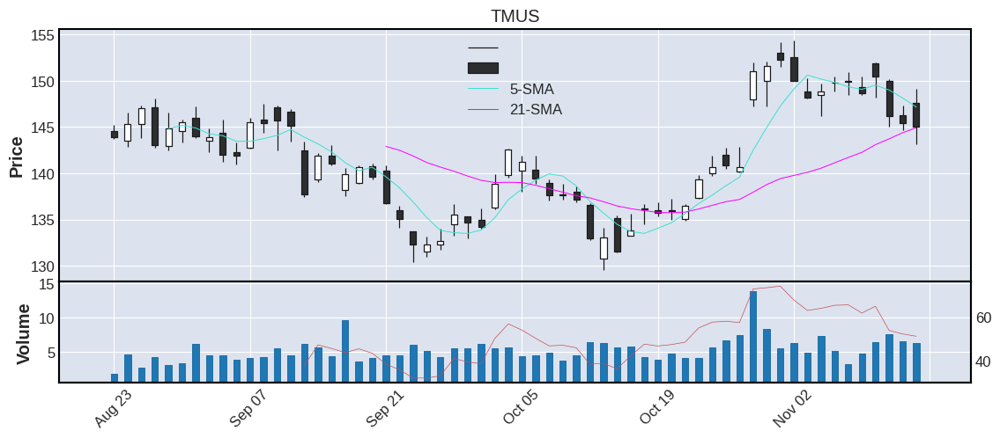



  TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR              SECTOR  IPO        COUNTRY CATEGORY
4    WBD  11.33  45.67  29.53   36.68 -1.39  0.86  7.59  Telecommunications  0.0  United States    large


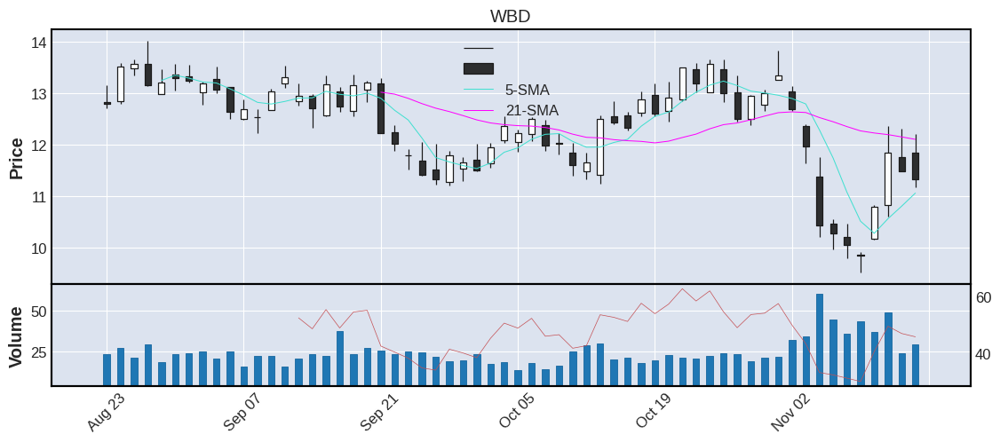



  TICKER    CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR              SECTOR  IPO        COUNTRY CATEGORY
5     VZ  37.7  49.51  21.24   21.57 -1.59  0.93  2.47  Telecommunications  0.0  United States    large


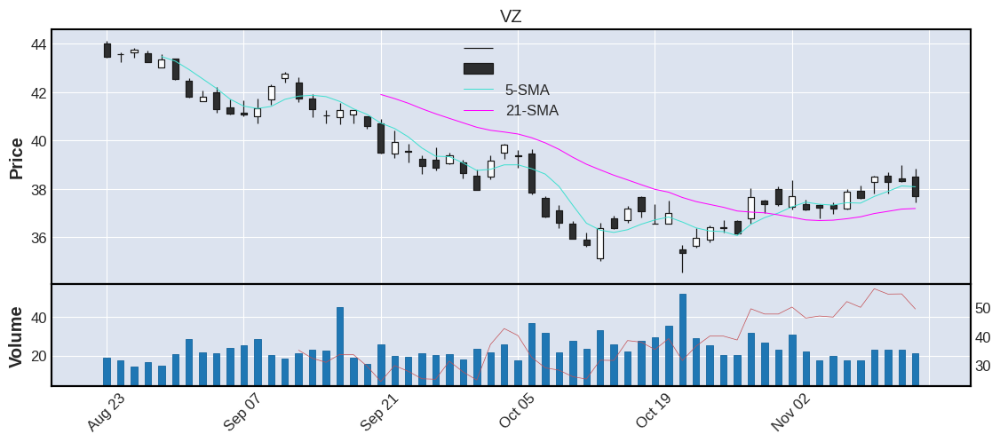



  TICKER    CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR              SECTOR  IPO        COUNTRY CATEGORY
6   LUMN  6.08  36.56  27.55   25.52 -3.65  0.35  5.76  Telecommunications  0.0  United States   medium


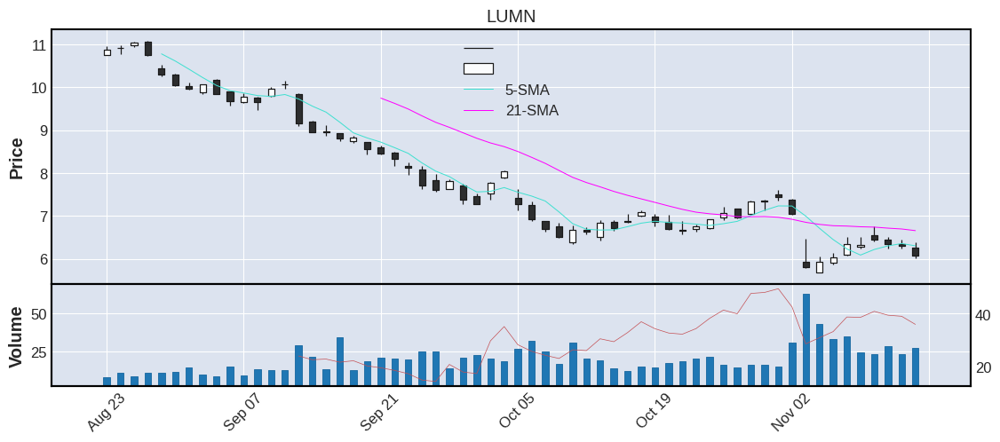



================================================== SECTOR 12: MISCELLANEOUS [ %CHG ] ================================================== 

   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR         SECTOR  IPO        COUNTRY CATEGORY
1    AVY  185.28  61.30  0.51    0.66  2.62  6.50  3.51  Miscellaneous  0.0  United States    large
2   BBWI   33.92  50.56  4.37    4.54   2.6  2.07  6.10  Miscellaneous  0.0  United States   medium


  TICKER      CP   RSI   VOL  AVGVOL  %CHG  ATR  %ATR         SECTOR  IPO        COUNTRY CATEGORY
1    AVY  185.28  61.3  0.51    0.66  2.62  6.5  3.51  Miscellaneous  0.0  United States    large


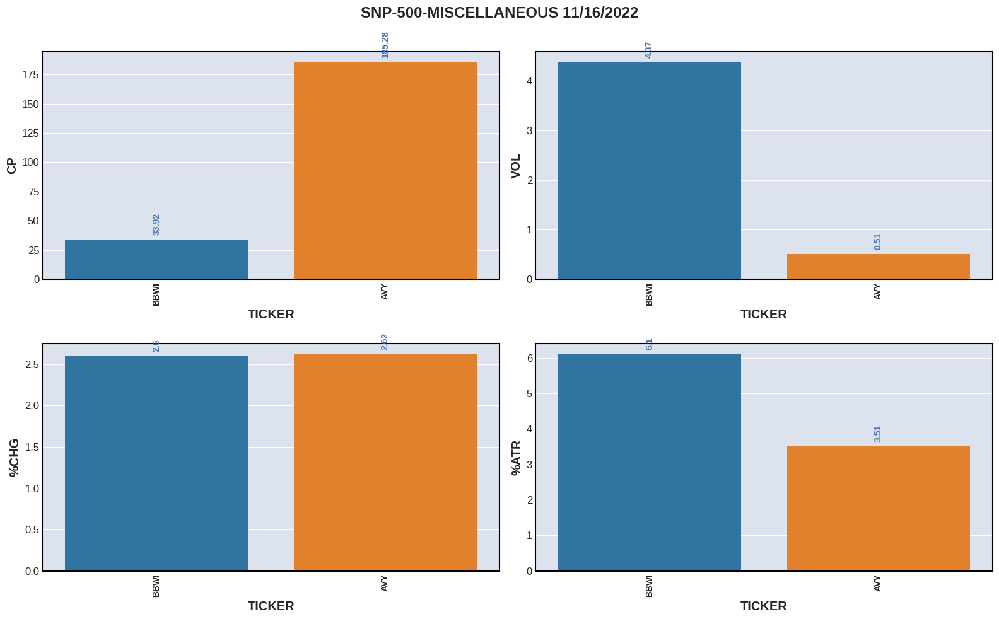

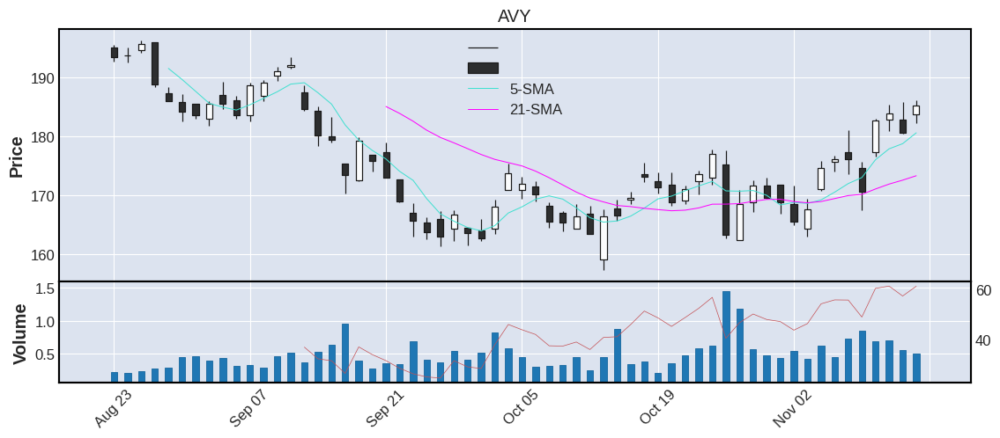



  TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR         SECTOR  IPO        COUNTRY CATEGORY
2   BBWI  33.92  50.56  4.37    4.54  2.6  2.07   6.1  Miscellaneous  0.0  United States   medium


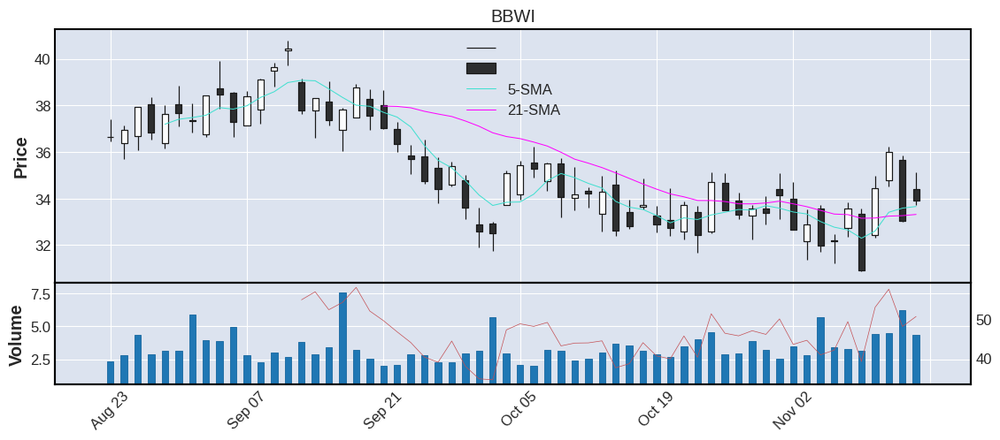



================================================== SECTOR 13: BASIC_MATERIALS [ %CHG ] ================================================== 

   TICKER      CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR           SECTOR     IPO        COUNTRY CATEGORY
1    FCX   38.09  67.26  15.08   17.28  0.53  1.91  5.01  Basic_Materials     0.0  United States    large
2    PKG  130.18  66.32   0.79    0.92  0.33  3.76  2.89  Basic_Materials  2000.0  United States    large
3   FAST   51.63  63.91   2.97    3.35  -0.1  1.30  2.52  Basic_Materials  1987.0  United States    large
4    NEM   45.69  59.71   9.16    8.65  -1.3  1.70  3.72  Basic_Materials     0.0  United States    large


  TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR           SECTOR  IPO        COUNTRY CATEGORY
1    FCX  38.09  67.26  15.08   17.28  0.53  1.91  5.01  Basic_Materials  0.0  United States    large


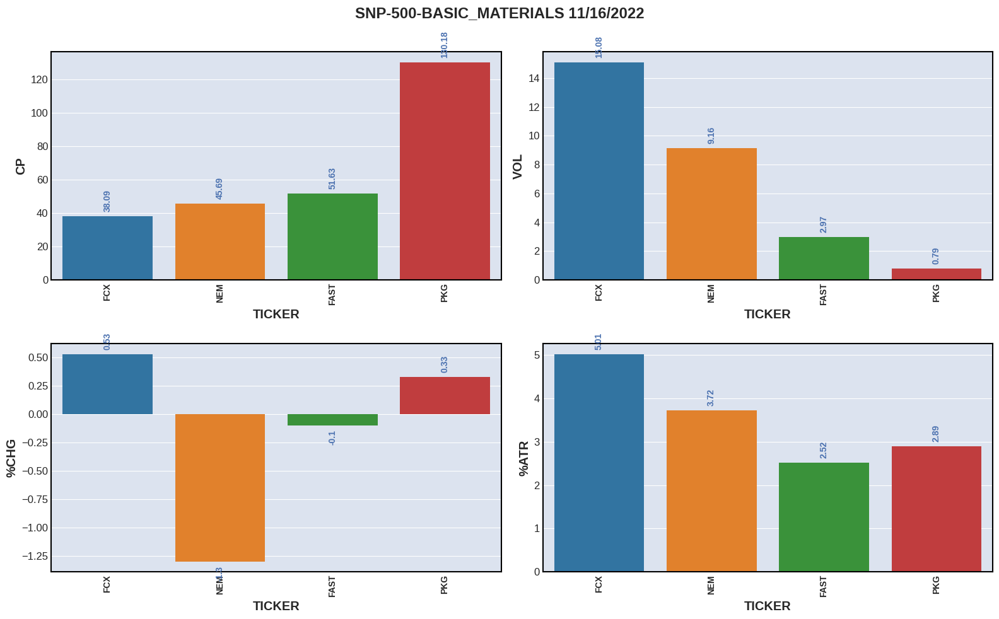

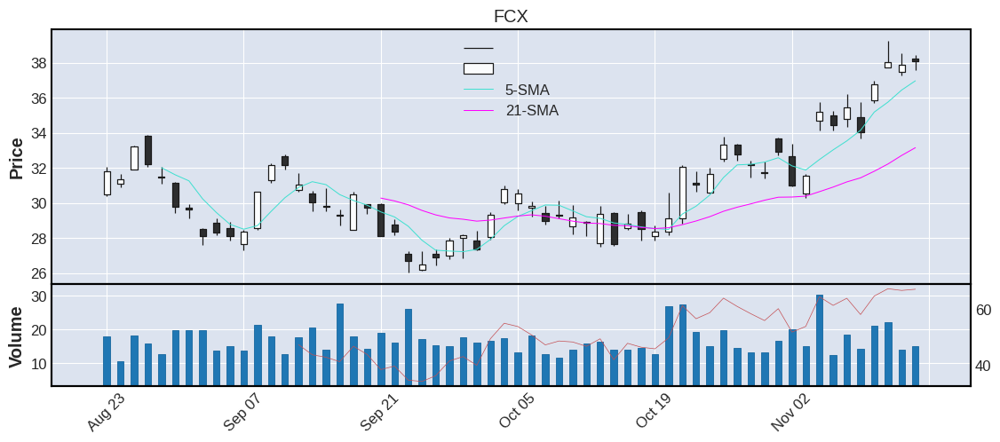



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR           SECTOR     IPO        COUNTRY CATEGORY
2    PKG  130.18  66.32  0.79    0.92  0.33  3.76  2.89  Basic_Materials  2000.0  United States    large


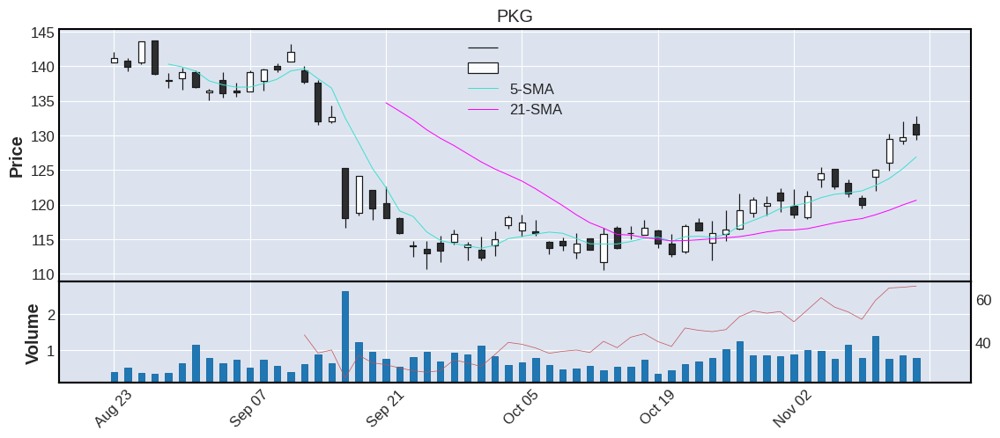



  TICKER     CP    RSI   VOL  AVGVOL %CHG  ATR  %ATR           SECTOR     IPO        COUNTRY CATEGORY
3   FAST  51.63  63.91  2.97    3.35 -0.1  1.3  2.52  Basic_Materials  1987.0  United States    large


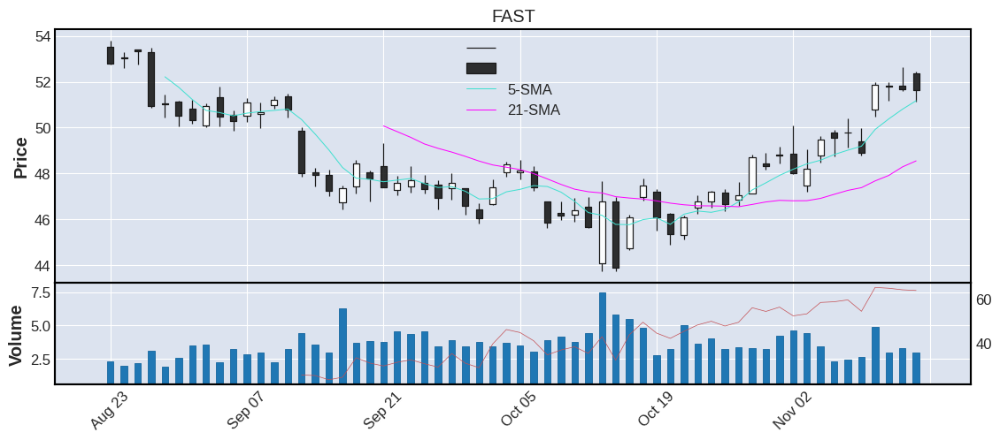



  TICKER     CP    RSI   VOL  AVGVOL %CHG  ATR  %ATR           SECTOR  IPO        COUNTRY CATEGORY
4    NEM  45.69  59.71  9.16    8.65 -1.3  1.7  3.72  Basic_Materials  0.0  United States    large


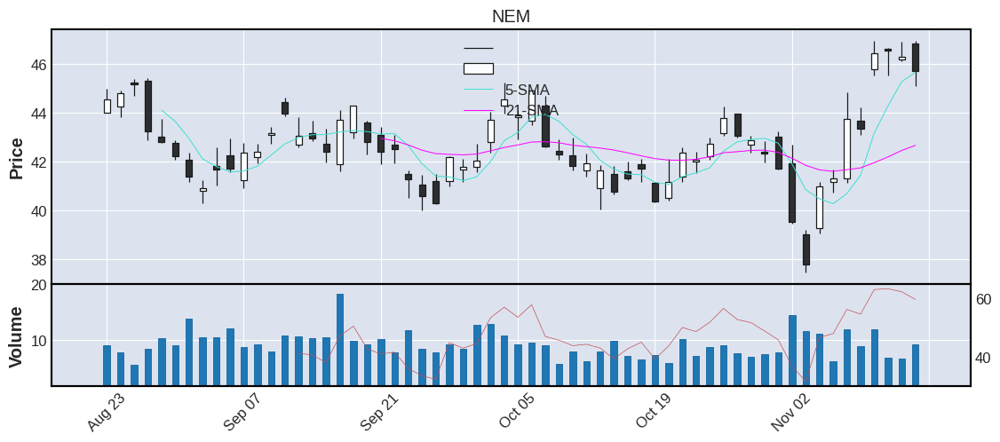

In [29]:
#%%script false --no-raise-error
#ignore_category=['nano','micro']
fmt=25*'=='
#fmt1=35*'**'
choose='%CHG'
how=False
plot=True
show_number=50

for c,country in enumerate(countries):
    if c!=0:continue
    #df_usa=df[(df.COUNTRY==country )]
    df_usa=df[df['TICKER'].isin(snp)].copy()
    #df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    #df_usa=df_usa.query('HH & HL & HC')
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
    
    sectors=list(df.SECTOR.unique())
    #print(f"sectors: {sectors}")
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for s,sector in enumerate(sectors,start=1):
        #print(f"sector: {sector}");
        temp_df=df_usa[df_usa['SECTOR']==sector].copy();#print(f"\n\n{temp_df.head(10).to_string()}")
        if temp_df.empty:continue
        temp_df=reset_index(temp_df)[columns_selected]
        temp_df=temp_df.sort_values(by=choose,ascending=how).head(show_number)
        temp_df=reset_index(temp_df)
#         temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
#         temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

#         temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        print(f"\n\n{fmt} SECTOR {s}: {sector.upper()} [ { choose } ] {fmt} \n\n {temp_df.to_string()}")
        compare_bars(temp_df,title="snp-500-"+sector)

        if plot:
            tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
            for c,i in enumerate(tick):
                print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')

# IPO



************************************************** COUNTRY: UNITED STATES ************************************************** 




================================================== SECTOR 1: TECHNOLOGY (IPO)================================================== 

    TICKER     CP    RSI    VOL  AVGVOL   %CHG   ATR  %ATR      SECTOR                                  INDUSTRY     IPO        COUNTRY CATEGORY
1    XMTR  44.86  35.56   0.55    1.35   3.44  4.25  9.47  Technology           Industrial Machinery/Components  2021.0  United States   medium
2    FOUR  52.47  66.25   2.80    1.93   9.47  3.65  6.96  Technology                              EDP Services  2020.0  United States   medium
3       U  36.04  63.49  23.52   23.92  10.25  2.75  7.63  Technology  Computer Software & Peripheral Equipment  2020.0  United States   medium
4     DNB  14.60  69.78   0.87    1.26   2.31  0.53  3.63  Technology         Internet and Information Services  2020.0  United States   medium
5    LYFT  13.07 

/tmp/ipykernel_14441/784690202.py:14: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]




================================================== SECTOR 2: HEALTH_CARE (IPO)================================================== 

    TICKER      CP    RSI   VOL  AVGVOL   %CHG   ATR   %ATR       SECTOR                                                       INDUSTRY     IPO        COUNTRY CATEGORY
1    VIGL   11.00  44.38  0.00    0.03   3.87  1.86  16.91  Health_Care                     Biotechnology: Pharmaceutical Preparations  2022.0  United States    small
2    CGEM   12.76  51.76  0.27    0.19   1.35  0.83   6.50  Health_Care                     Biotechnology: Pharmaceutical Preparations  2021.0  United States    small
3    ZNTL   22.94  49.87  0.71    1.34   1.68  1.88   8.20  Health_Care                    Medicinal Chemicals and Botanical Products   2020.0  United States    small
4    KNTE   10.11  59.13  0.08    0.13   1.51  0.65   6.43  Health_Care                     Biotechnology: Pharmaceutical Preparations  2020.0  United States    small
5    AKRO   44.78  68.20  0.50 

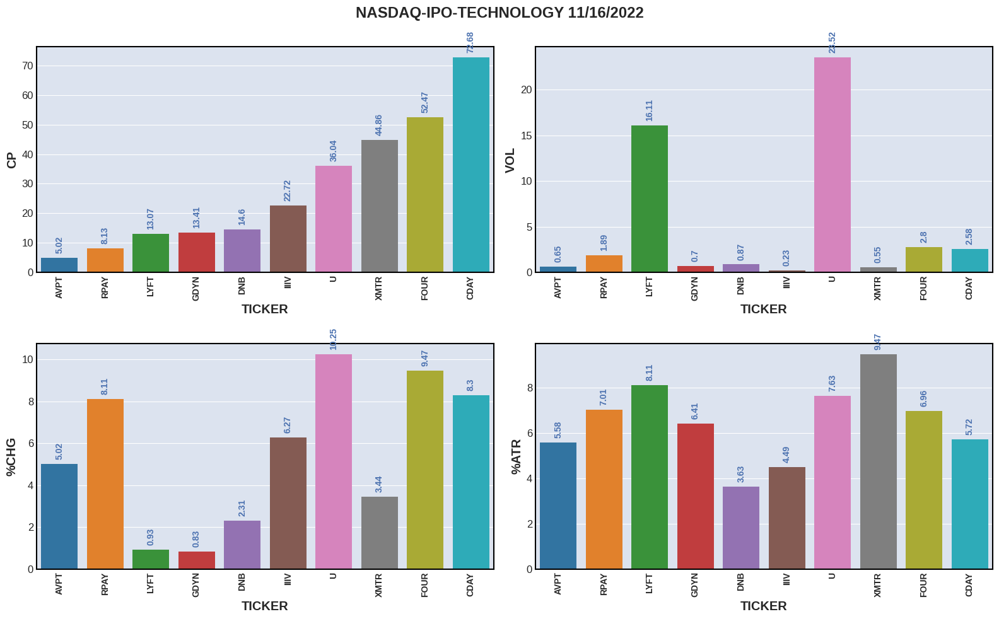

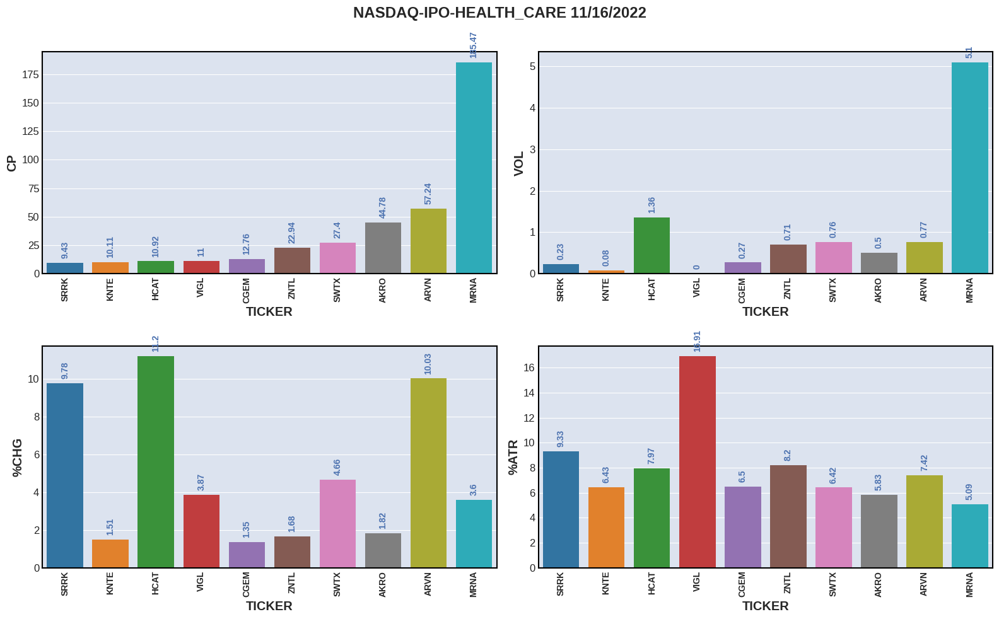

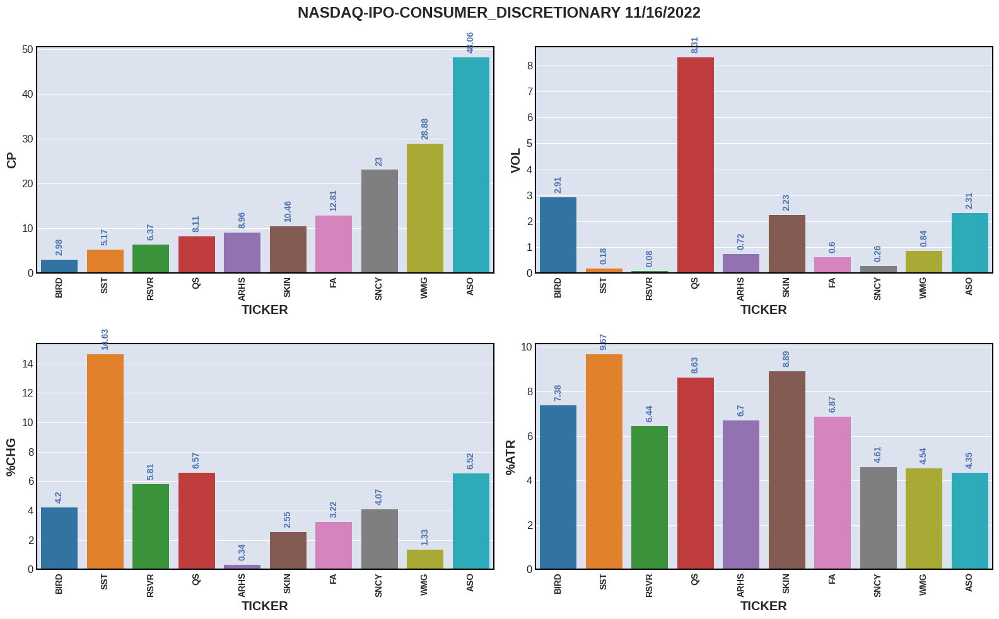

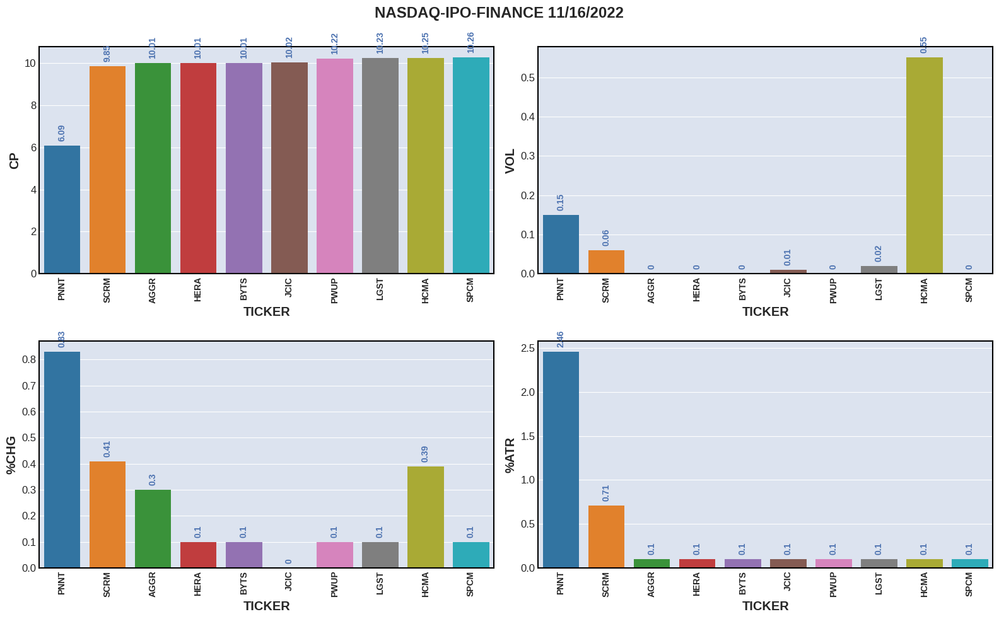

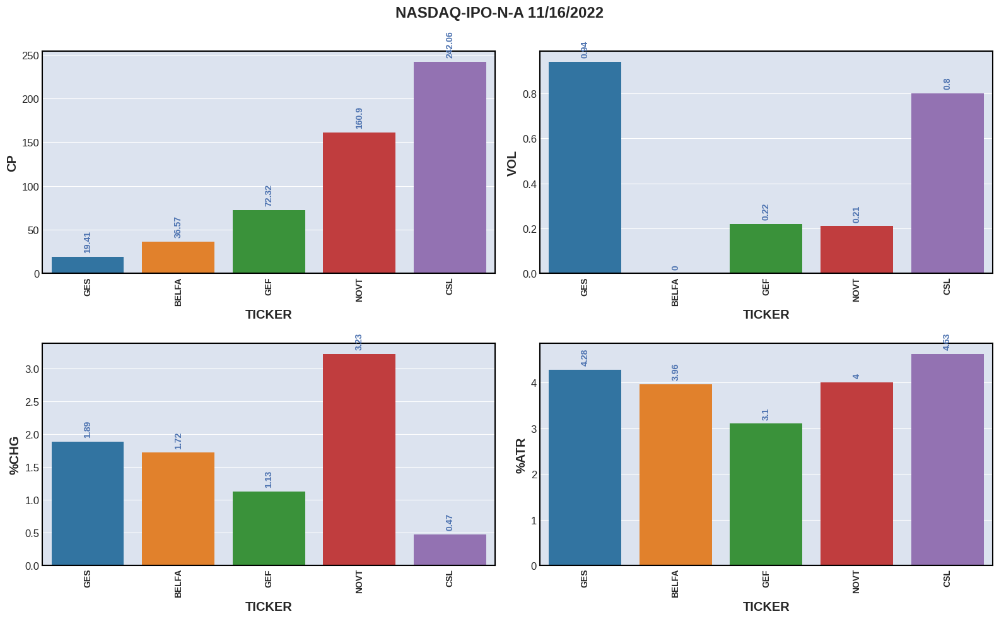

...

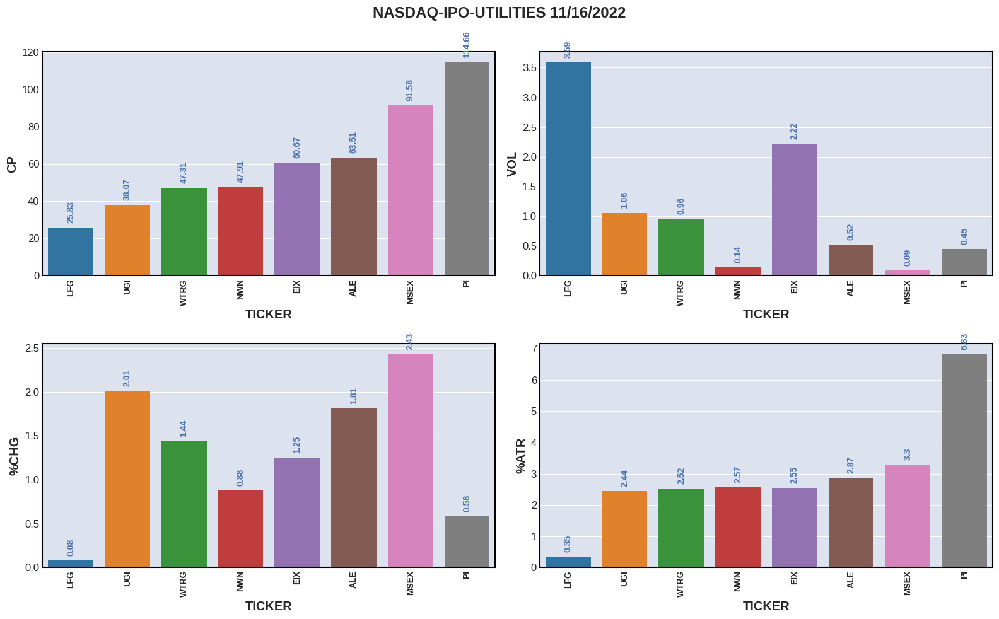

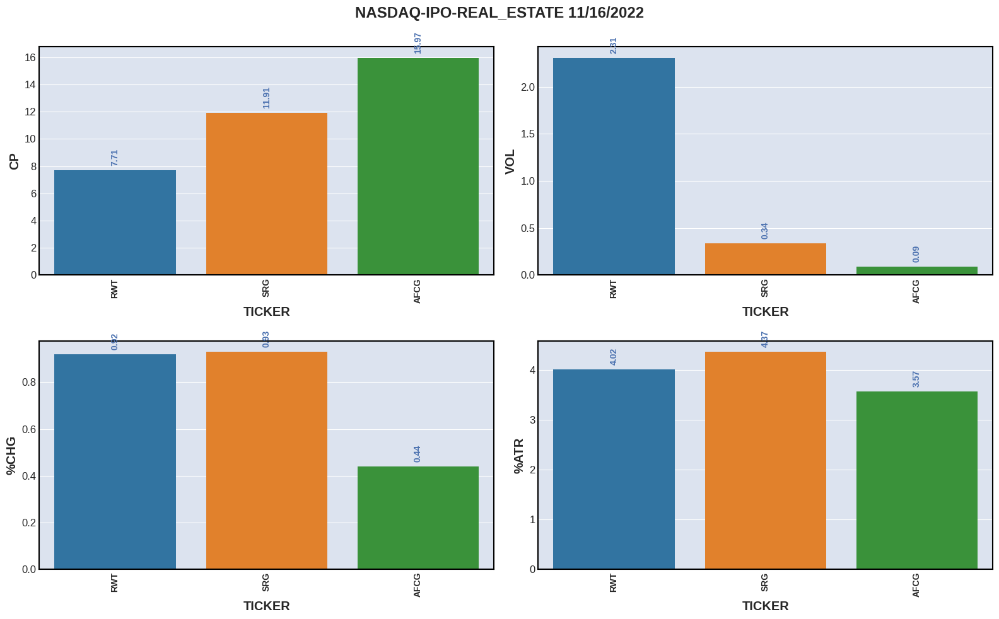

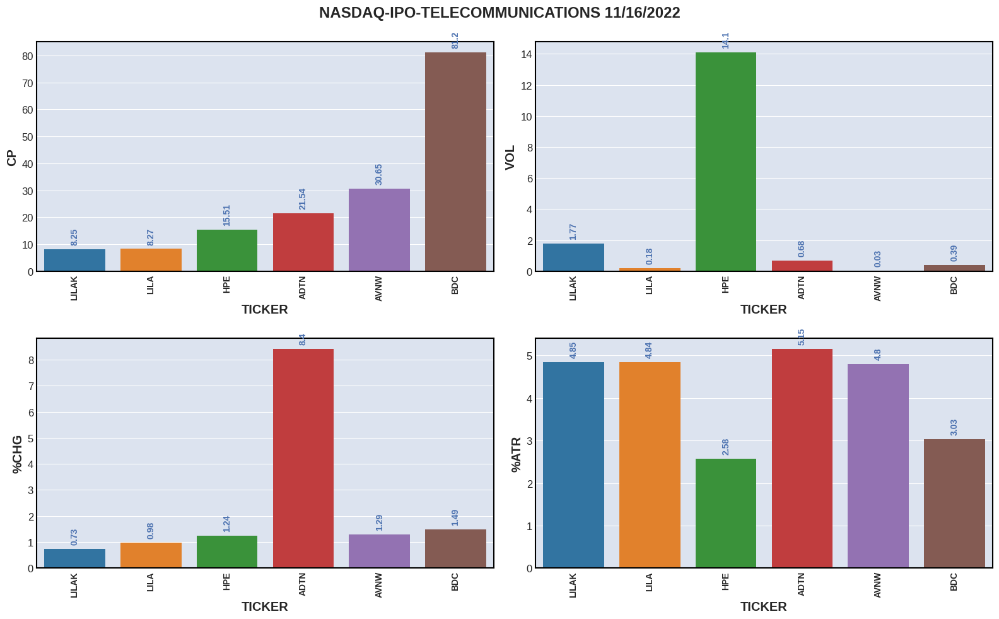

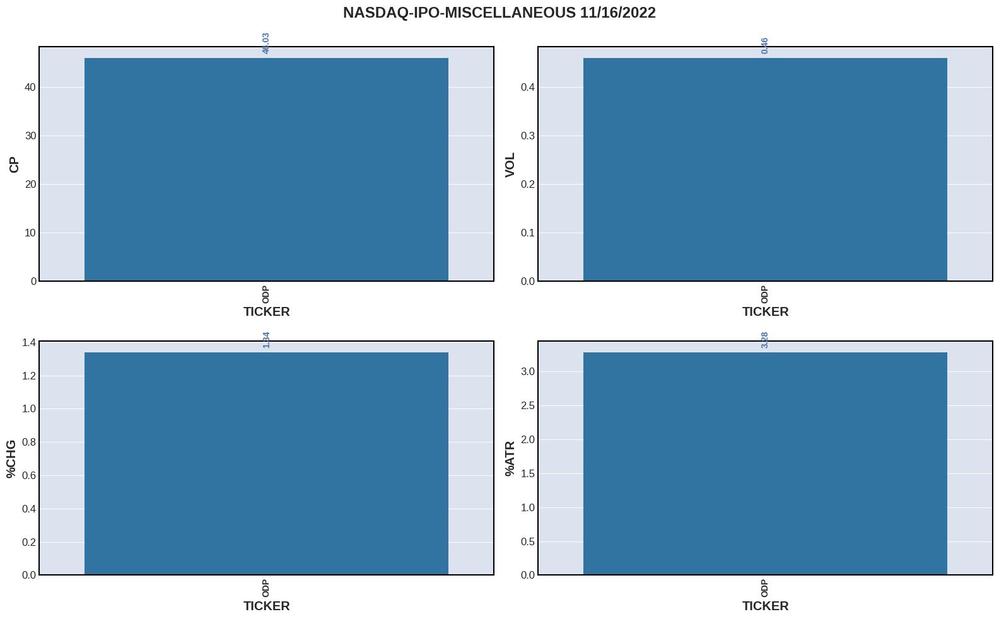

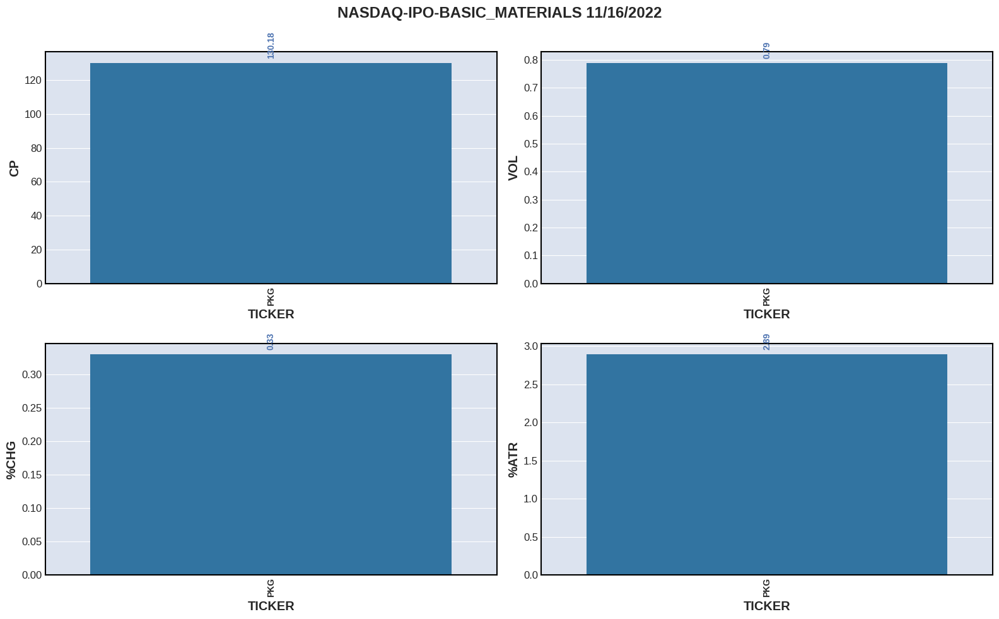

In [30]:
#%%script false --no-raise-error
ignore_category=['nano','micro']
fmt=25*'=='
fmt1=25*'**'
choose='IPO'
how=False
plot=False
show_number=10

for c,country in enumerate(countries):
    if c!=0:continue
    print(f"\n\n{fmt1} COUNTRY: {str(country).upper()} {fmt1} \n\n")
    df_usa=df[(df.COUNTRY==country )]
    df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    df_usa=df_usa.query('HH & HL & HC')#.sort_values(by='CP',ascending=False)
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
    sectors=list(df.SECTOR.unique())
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for s,sector in enumerate(sectors,start=1):
        temp_df=df_usa[df_usa.SECTOR==sector].sort_values(by='CP')
        if temp_df.empty:continue
        temp_df=reset_index(temp_df)[columns_selected]
        temp_df=temp_df.sort_values(by=choose,ascending=how).head(show_number)
        temp_df=reset_index(temp_df)
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        print(f"\n\n{fmt} SECTOR {s}: {sector.upper()} ({ choose }){fmt} \n\n {temp_df.to_string()}")
        #compare_bars(temp_df,sector)
        compare_bars(temp_df,title="nasdaq-ipo-"+sector)
        tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
        if plot:
            for c,i in enumerate(tick):
            #file=root.format(cat[c],i)
            #print(f"file: {file}")
                print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')
    # df_usa.shape
    # df_usa.head()
    # df_usa.columns

# CP



************************************************** COUNTRY: UNITED STATES ************************************************** 




================================================== SECTOR:1 TECHNOLOGY (CP)================================================== 

    TICKER      CP    RSI     VOL  AVGVOL   %CHG   ATR  %ATR      SECTOR                                  INDUSTRY     IPO        COUNTRY CATEGORY
1    MMAT    1.88  73.98   26.64   13.88  11.24  0.18  9.57  Technology                            Semiconductors     0.0  United States    small
2    AVPT    5.02  72.70    0.65    0.95   5.02  0.28  5.58  Technology                              EDP Services  2019.0  United States    small
3    NVTS    5.46  65.17    1.45    1.94   2.63  0.39  7.14  Technology                            Semiconductors     0.0  United States    small
4    RPAY    8.13  66.20    1.89    3.80   8.11  0.57  7.01  Technology                              EDP Services  2018.0  United States    small
5     DDD

/tmp/ipykernel_14441/684526863.py:14: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]




================================================== SECTOR:2 HEALTH_CARE (CP)================================================== 

    TICKER     CP    RSI    VOL  AVGVOL   %CHG   ATR   %ATR       SECTOR                                                       INDUSTRY     IPO        COUNTRY CATEGORY
1     OPK   1.76  47.69   2.05    3.03   3.53  0.10   5.68  Health_Care        Biotechnology: In Vitro & In Vivo Diagnostic Substances     0.0  United States    small
2    PGEN   1.95  57.80   1.05    0.95   3.17  0.14   7.18  Health_Care        Biotechnology: Commercial Physical & Biological Resarch     0.0  United States    small
3     INO   2.50  71.62   7.91    8.83   3.73  0.20   8.00  Health_Care  Biotechnology: Biological Products (No Diagnostic Substances)     0.0  United States    small
4    AGEN   3.17  67.47  10.32    9.17   8.19  0.24   7.57  Health_Care  Biotechnology: Biological Products (No Diagnostic Substances)  2000.0  United States    small
5    VKTX   4.47  66.41   0.79   

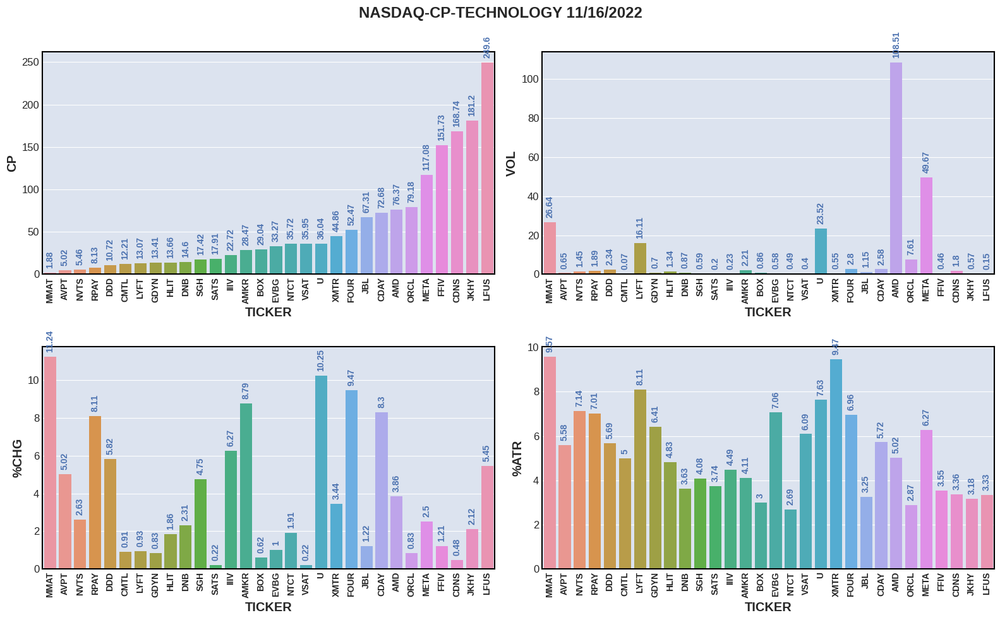

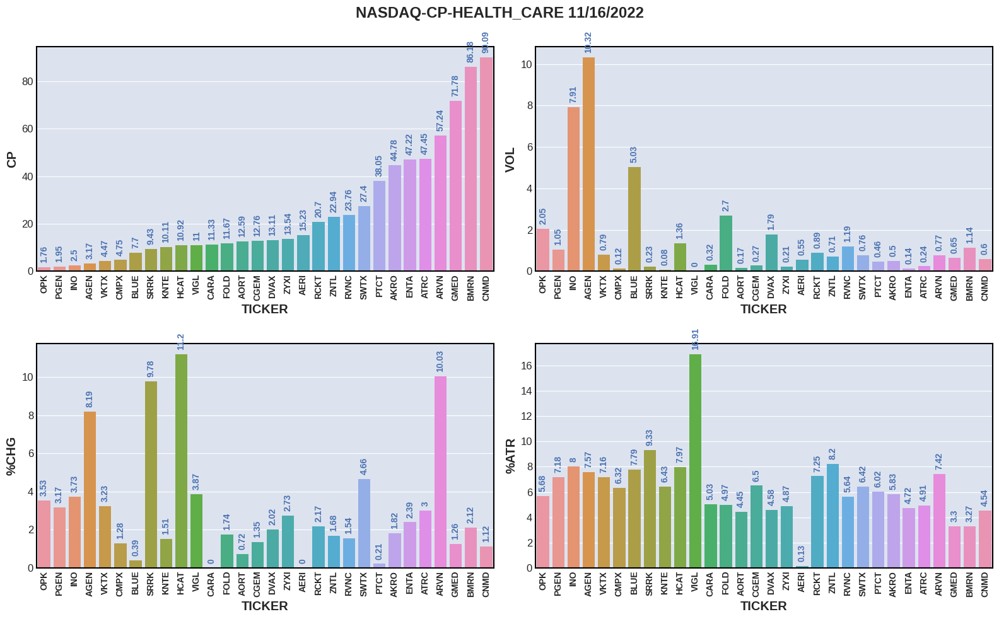

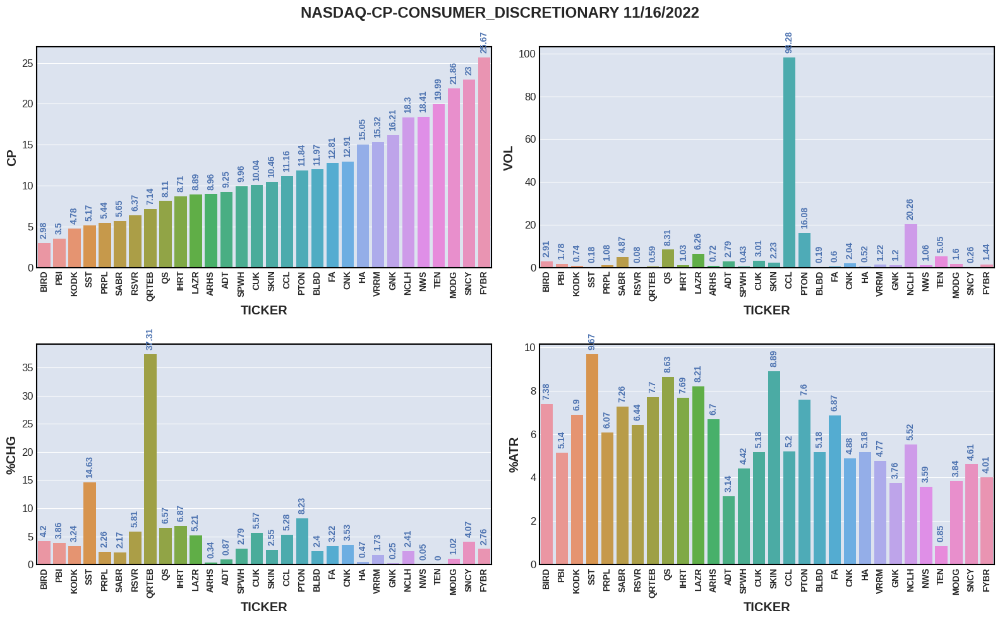

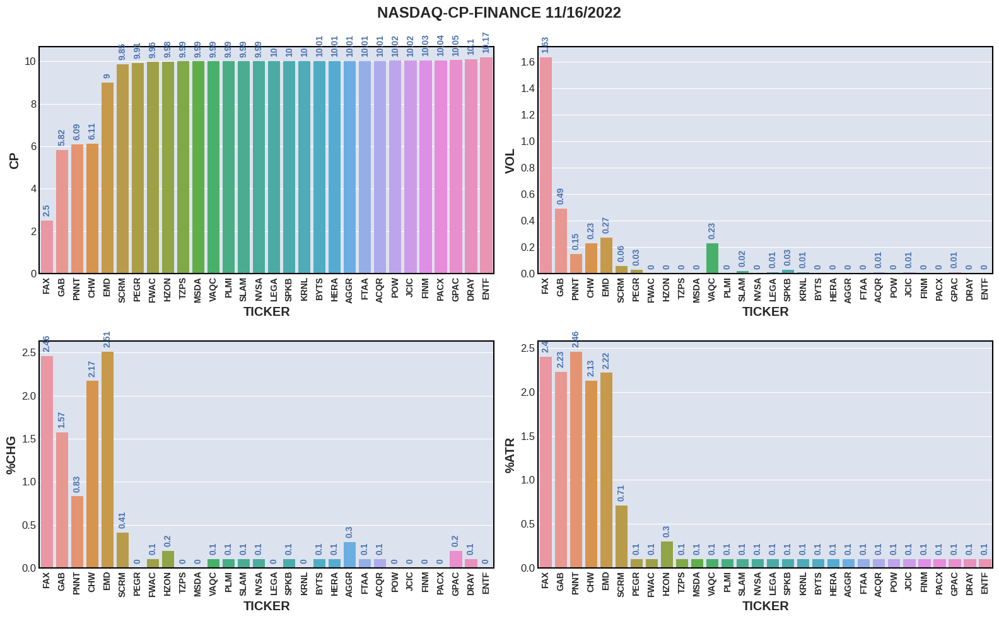

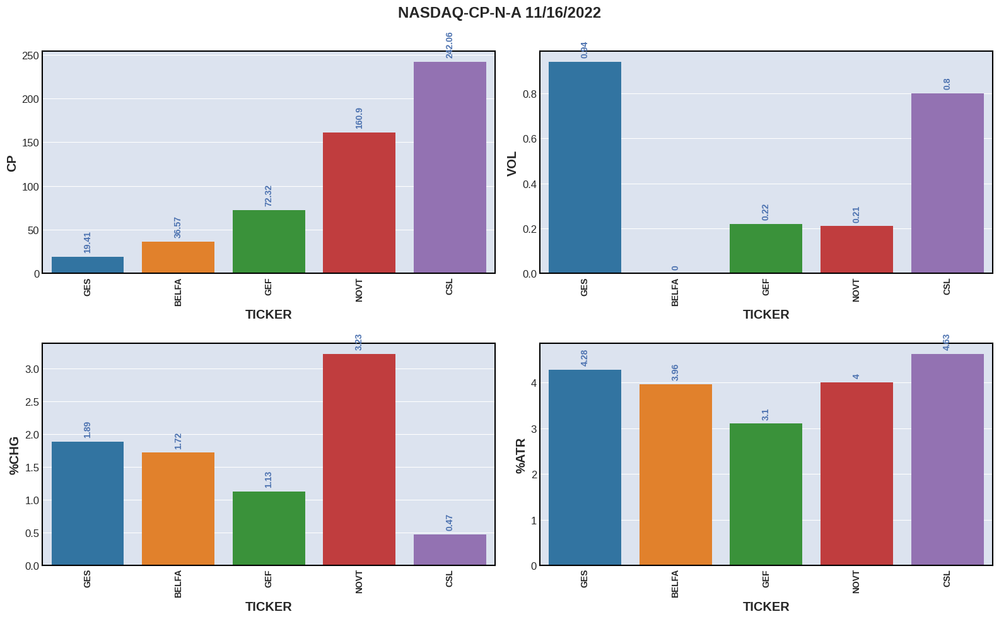

...

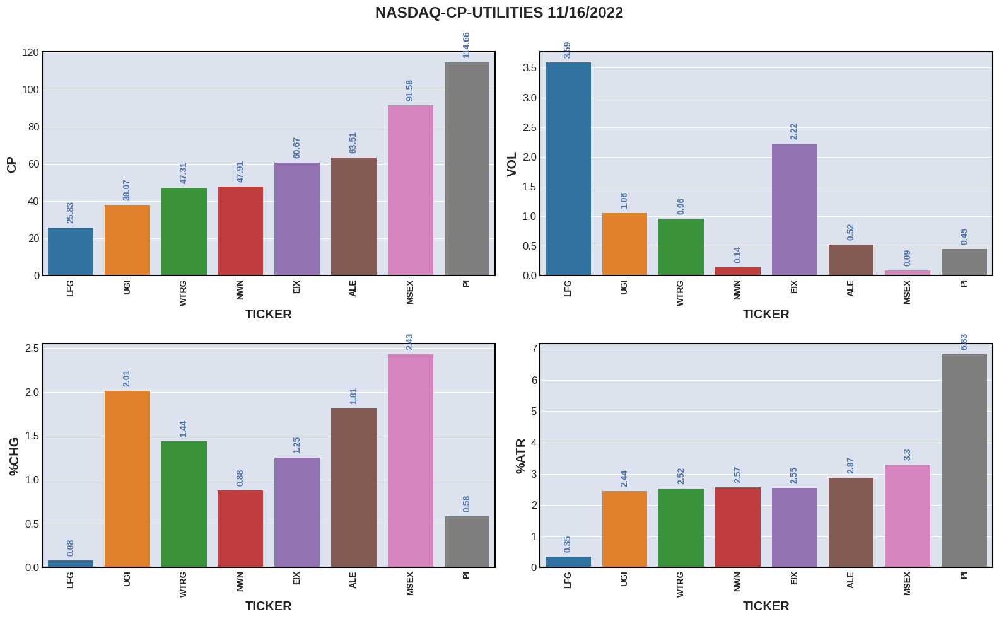

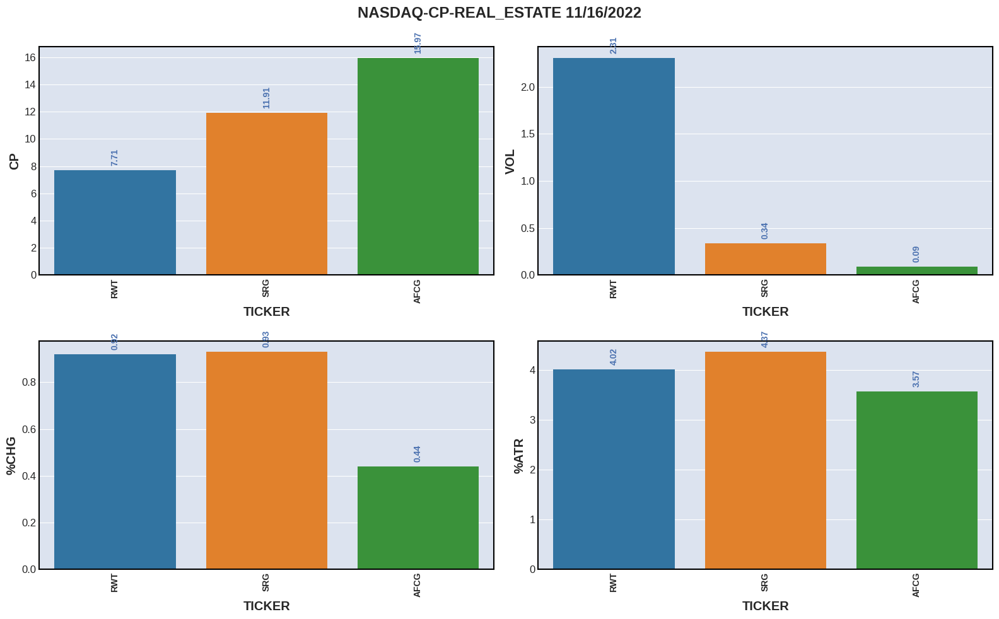

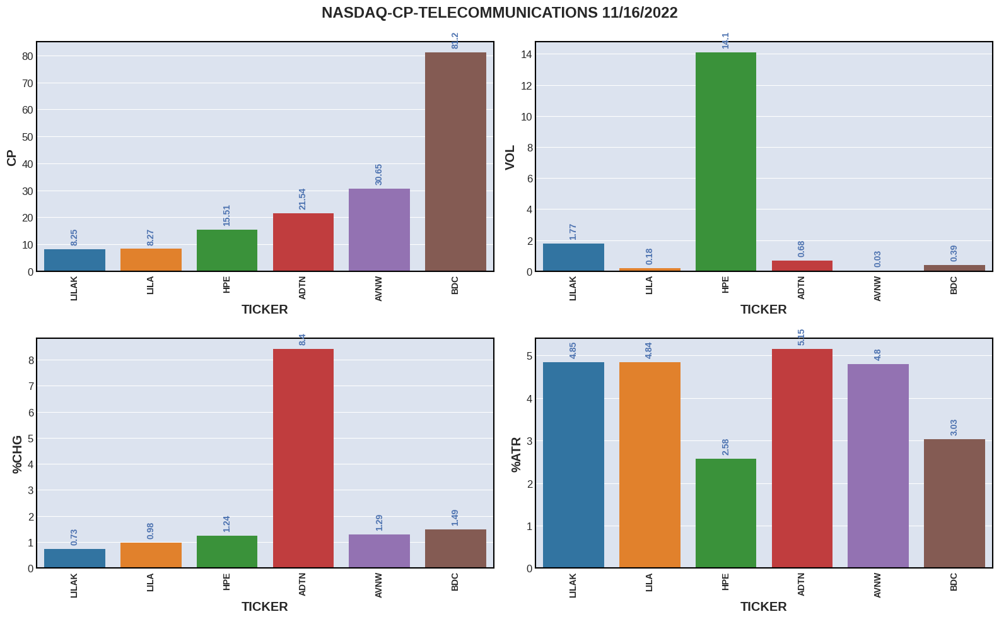

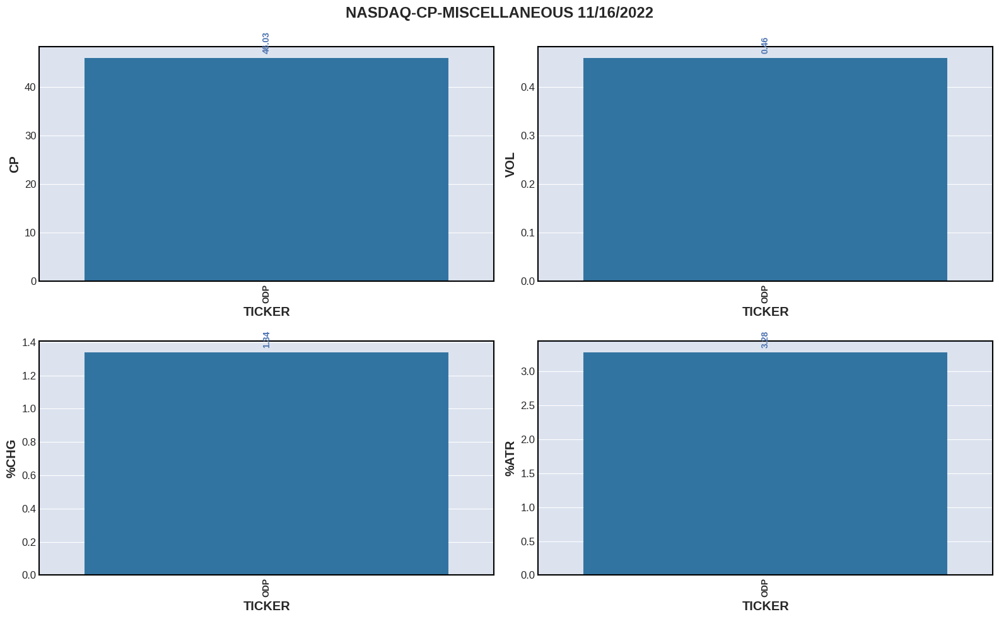

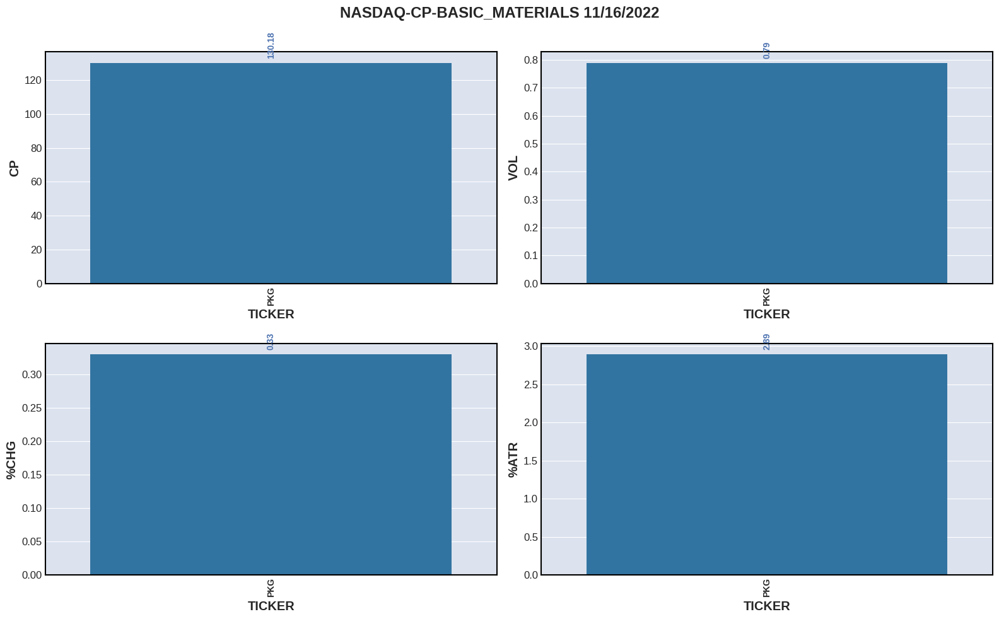

In [31]:
#%%script false --no-raise-error
ignore_category=['nano','micro']
fmt=25*'=='
fmt1=25*'**'
choose='CP'
how=True
plot=False
show_number=30

for c,country in enumerate(countries):
    if c!=0:continue
    print(f"\n\n{fmt1} COUNTRY: {country.upper()} {fmt1} \n\n")
    df_usa=df[(df.COUNTRY==country )]
    df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
    sectors=list(df.SECTOR.unique())
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for s,sector in enumerate(sectors,start=1):
        temp_df=df_usa[df_usa.SECTOR==sector]
        if temp_df.empty:continue
        temp_df=reset_index(temp_df)[columns_selected]
        temp_df=temp_df.sort_values(by=choose,ascending=how).head(show_number)
        temp_df=reset_index(temp_df)
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        print(f"\n\n{fmt} SECTOR:{s} {sector.upper()} ({ choose }){fmt} \n\n {temp_df.to_string()}")
        #compare_bars(temp_df,title="snp-500-"+sector)
        compare_bars(temp_df,title="nasdaq-cp-"+sector)
        tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
        for c,i in enumerate(tick):
            #file=root.format(cat[c],i)
            #print(f"file: {file}")
            
            if plot:print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')
    # df_usa.shape
    # df_usa.head()
    # df_usa.columns

# ALL NASDAQ BEST

In [ ]:
%%script false --no-raise-error
ignore_category=['nano','micro']
fmt=32*'=='
fmt1=35*'**'
choose=['VOL','%CHG','%ATR','IPO','CP']
how=False
show_number=2 #how many to show
plot=True
for c,country in enumerate(countries):
    if c!=0:continue
    print(f"\n\n{fmt1} COUNTRY: {country.upper()} {fmt1} \n\n")
    df_usa=df[(df.COUNTRY==country )]
    df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    #df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
    sectors=list(df.SECTOR.unique())
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for s,sector in enumerate(sectors):
        temp_df=df_usa[df_usa.SECTOR==sector].copy() #this line prints only limited output
        if temp_df.empty:continue
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        temp_df=reset_index(temp_df)[columns_selected]
        for c,cho in enumerate(choose,start=1):
            print(f"\n\n{c}: {sector.upper()} => {cho}\n")
            if cho=='CP':how=True
            temp_df=temp_df.sort_values(by=cho,ascending=how).head(show_number)
            how=False
            if cho=='%CHG':temp_df1
            temp_df=reset_index(temp_df)
            
            print(f"\n\n{fmt} SECTOR:{s+1} {sector.upper()} ({ cho }) {fmt} \n\n {temp_df.to_string()}")
            tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
            if (plot and (c==5)):
                for c,i in enumerate(tick):print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')
 

In [ ]:
%%script false --no-raise-error
ignore_category=['nano','micro']
fmt=32*'=='
fmt1=35*'**'
choose=['VOL','%CHG','%ATR','IPO','CP']
how=False
show_number=2 #how many to show
plot=True
for c,country in enumerate(countries):
    if c!=0:continue
    print(f"\n\n{fmt1} COUNTRY: {country.upper()} {fmt1} \n\n")
    df_usa=df[(df.COUNTRY==country )]
    df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    #df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
    sectors=list(df.SECTOR.unique())
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for s,sector in enumerate(sectors):
        temp_df=df_usa[df_usa.SECTOR==sector].copy() #this line prints only limited output
        if temp_df.empty:continue
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        temp_df=reset_index(temp_df)[columns_selected]
        for c,cho in enumerate(choose,start=1):
            print(f"\n\n{c}: {sector.upper()} => {cho}\n")
            if cho=='CP':how=True
            temp_df=temp_df.sort_values(by=cho,ascending=how).head(show_number)
            how=False
            if cho=='%CHG':temp_df1
            temp_df=reset_index(temp_df)
            
            print(f"\n\n{fmt} SECTOR:{s+1} {sector.upper()} ({ cho }) {fmt} \n\n {temp_df.to_string()}")
            tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
            if (plot and (c==5)):
                for c,i in enumerate(tick):print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')
 

In [ ]:
#%%script false --no-raise-error
ignore_category=['nano','micro']
fmt=35*'=='
fmt1=35*'**'
choose='VOL'
how=False
show_number=10 #how many to show
plot=False
for c,country in enumerate(countries):
    if c!=0:continue
    print(f"\n\n{fmt1} COUNTRY: {country.upper()} {fmt1} \n\n")
    df_usa=df[(df.COUNTRY==country )]
    df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    #df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
    sectors=list(df.SECTOR.unique())
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for s,sector in enumerate(sectors):
        temp_df=df_usa[df_usa.SECTOR==sector] #this line prints only limited output
        if temp_df.empty:continue
        temp_df=reset_index(temp_df)[columns_selected]
        temp_df=temp_df.sort_values(by=choose,ascending=how).head(show_number)
        temp_df=reset_index(temp_df)
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        print(f"\n\n{fmt} SECTOR:{s+1} {sector.upper()} ({ choose }) {fmt} \n\n {temp_df.to_string()}")
        tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
        if plot:
            for c,i in enumerate(tick):print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')
 

# HIGHEST +   %CHANGE

In [ ]:
%%script false --no-raise-error
ignore_category=['nano','micro']
fmt=35*'=='
fmt1=35*'**'
cor=10*'=='
choose='%CHG'
how=False
show_number=10 #how many to show
plot=False
for c,country in enumerate(countries):
    if c!=0:continue
    print(f"\n\n{fmt1} COUNTRY: {country.upper()} {fmt1} \n\n")
    df_usa=df[(df.COUNTRY==country )]
    df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    #df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
    sectors=list(df_sector.SECTOR.unique())
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for sector in sectors:
        temp_df=df_usa[df_usa.SECTOR==sector] #this line prints only limited output
        if temp_df.empty:continue
        temp_df=reset_index(temp_df)[columns_selected]
        temp_df=temp_df.sort_values(by=choose,ascending=how).head(show_number)
        temp_df=reset_index(temp_df)
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        print(f"\n\n{fmt} SECTOR: {sector.upper()} ( {choose} ){fmt} \n\n {temp_df.to_string()}")
        print(f"\n{fmt}{fmt}{cor}")
        tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
        for c,i in enumerate(tick):
            #file=root.format(cat[c],i)
            #print(f"file: {file}")
            
            
            if plot:print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')
    # df_usa.shape
    # df_usa.head()
    # df_usa.columns

# HIGHEST -VE %CHANGE

In [ ]:
%%script false --no-raise-error
ignore_category=['nano','micro']
fmt=35*'=='
fmt1=35*'**'
choose='%CHG'
how=True
show_number=10 #how many to show
plot=False
for c,country in enumerate(countries):
    if c!=0:continue
    print(f"\n\n{fmt1} COUNTRY: {country.upper()} {fmt1} \n\n")
    df_usa=df[(df.COUNTRY==country )]
    df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    #df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
    sectors=list(df_sector.SECTOR.unique())
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for sector in sectors:
        temp_df=df_usa[df_usa.SECTOR==sector] #this line prints only limited output
        if temp_df.empty:continue
        temp_df=reset_index(temp_df)[columns_selected]
        temp_df=temp_df.sort_values(by=choose,ascending=how).head(show_number)
        temp_df=reset_index(temp_df)
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        print(f"\n\n{fmt} SECTOR: {sector.upper()} (-{ choose }) {fmt} \n\n {temp_df.to_string()}");#print(f"\n{fmt}{fmt}")
        tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
        for c,i in enumerate(tick):
            #file=root.format(cat[c],i)
            #print(f"file: {file}")
            
            if plot:print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')
    # df_usa.shape
    # df_usa.head()
    # df_usa.columns

In [ ]:
%%script false --no-raise-error
ignore_category=['nano','micro']
fmt=35*'=='
fmt1=35*'**'
choose='%ATR'
how=False
show_number=10 #how many to show
plot=False
for c,country in enumerate(countries):
    if c!=0:continue
    print(f"\n\n{fmt1} COUNTRY: {country.upper()} {fmt1} \n\n")
    df_usa=df[(df.COUNTRY==country )]
    df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    #df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
    sectors=list(df_sector.SECTOR.unique())
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for sector in sectors:
        temp_df=df_usa[df_usa.SECTOR==sector] #this line prints only limited output
        if temp_df.empty:continue
        temp_df=reset_index(temp_df)[columns_selected]
        temp_df=temp_df.sort_values(by=choose,ascending=how).head(show_number)
        temp_df=reset_index(temp_df)
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        print(f"\n\n{fmt} SECTOR: {sector.upper()} ({ choose }) {fmt} \n\n {temp_df.to_string()}")
        tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
        for c,i in enumerate(tick):
            #file=root.format(cat[c],i)
            #print(f"file: {file}")
            
            if plot:print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')
    # df_usa.shape
    # df_usa.head()
    # df_usa.columns

In [ ]:
%%script false --no-raise-error
country='United States'
ignore_category=['nano']

df_usa=df[(df.COUNTRY==country )]
df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
df_usa=reset_index(df_usa)
df_usa.shape
df_usa.head()
df_usa.columns

In [ ]:
#print by sector
%%script false --no-raise-error
%matplotlib inline
root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
sectors=list(df_sector.SECTOR.unique())
columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
fmt=35*'=='
choose='CP'
how=True
for sector in sectors:
    temp_df=df_usa[df_usa.SECTOR==sector]
    if temp_df.empty:continue
    temp_df=reset_index(temp_df)[columns_selected]
   
    temp_df=temp_df.sort_values(by=choose,ascending=how)
    temp_df=reset_index(temp_df)
    temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
    temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))
    
    temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
    print(f"\n\n{fmt} SECTOR: {sector.upper()} {fmt} \n\n {temp_df.to_string()}")
    tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
    for c,i in enumerate(tick):
        #file=root.format(cat[c],i)
        #print(f"file: {file}")
        print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}")
        plot_with_mpl(root.format(cat[c]),i,sty='default')
        
        #print(f"tick: {i} {cat[c]}\n")

In [ ]:
#print by sector
%%script false --no-raise-error
%matplotlib inline
root='/home/thakur/test/{}'
sectors=list(df.SECTOR.unique())
columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
fmt=35*'=='
choose='CP'
how=True
for sector in sectors:
    temp_df=df_usa[df_usa.SECTOR==sector]
    if temp_df.empty:continue
    temp_df=reset_index(temp_df)[columns_selected]
   
    temp_df=temp_df.sort_values(by=choose,ascending=how)
    temp_df=reset_index(temp_df)
    temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
    temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))
    
    temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
    print(f"\n\n{fmt} SECTOR: {sector.upper()} {fmt} \n\n {temp_df.to_string()}")
    tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
    for c,i in enumerate(tick):
        #file=root.format(cat[c],i)
        #print(f"file: {file}")
        print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}")
        plot_with_mpl(root.format(cat[c]),i,sty='default')
        
        #print(f"tick: {i} {cat[c]}\n")

In [ ]:
#file location
file='/home/thakur/stock_information/nasdaq_all.csv'


In [ ]:
df.columns #name of columns

In [ ]:
%%script false --no-raise-error
df=pd.read_csv(file) #read the file in dataframe
df.fillna('N/A',inplace=True)
df['Market Cap']=df['Market Cap'].apply(lambda x:round(x*10**-6,2))
df['% Change']=df['% Change'].apply(lambda x:x.strip('%')).astype(float)
df['Last Sale']=df['Last Sale'].apply(lambda x:x.lstrip('$')).astype(float).round(2)
df['Name']=df['Name'].apply(lambda x: x.replace('Common Stock',''))
df['Name']=df['Name'].apply(lambda x: x.replace('Class A',''))

df.head()

In [ ]:
df.shape #shape of the dataframe

In [ ]:
#countries present
countries=list(df['Country'].unique())

In [ ]:

countries

In [ ]:
df['Country'].value_counts()

In [ ]:
#select a country 
country='India'
df_name='df_'+country
df_name=df[df.Country==country]

df_name=reset_index(df_name)
df_name

choose='% Change'
df_name=df_name.sort_values(by=choose,ascending=False)
df_name=reset_index(df_name)
df_name.dtypes

In [ ]:
#select a country 
%%script false --no-raise-error
choose='% Change'
for country in countries:
    #df_name='df_'+country
    df_name=df[df.Country==country]
    df_name=reset_index(df_name)
    #df_name
    df_name=df_name.sort_values(by=choose,ascending=False)
    df_name=reset_index(df_name)
    print(f"COUNTRY: {country}\n {df_name.head()}")
    #df_name.dtypes

In [ ]:
df_name.head(25)

In [ ]:
df_name.tail(25)[::-1]